# **MIT 6.5940 EfficientML.ai: Lab 1 Pruning**


This colab notebook provides code and a framework for ***Lab 1 Pruning***. You can work out your solutions here.



Please fill out this [feedback form](https://forms.gle/8gY5n9w1K3gddVoX9) when you finished this lab. We would love to hear your thoughts or feedback on how we can improve this lab!

## Goals

In this assignment, you will practice pruning a classical neural network model to reduce both model size and latency. The goals of this assignment are as follows:

- Understand the basic concept of **pruning**
- Implement and apply **fine-grained pruning**
- Implement and apply **channel pruning**
- Get a basic understanding of performance improvement (such as speedup) from pruning
- Understand the differences and tradeoffs between these pruning approaches

## Contents

There are two main sections in this lab: ***Fine-grained Pruning*** and ***Channel Pruning***.

There are ***9*** questions in total:
- For *Fine-grained Pruning*, there are ***5*** questions (Question 1-5).
- For *Channel Pruning*, there are ***3*** questions (Question 6-8).
- Question 9 compares fine-grained pruning and channel pruning.

# Setup

First, install the required packages and download the datasets and pretrained model. Here we use CIFAR10 dataset and VGG network which is the same as what we used in the Lab 0 tutorial.

In [1]:
import copy
import math
import random
import time
from collections import OrderedDict, defaultdict
from typing import Union, List

import numpy as np
import torch
from matplotlib import pyplot as plt
from torch import nn
from torch.optim import *
from torch.optim.lr_scheduler import *
from torch.utils.data import DataLoader
from torchprofile import profile_macs
from torchvision.datasets import *
from torchvision.transforms import *
from tqdm.auto import tqdm

from torchprofile import profile_macs

assert torch.cuda.is_available(), \
"The current runtime does not have CUDA support." \
"Please go to menu bar (Runtime - Change runtime type) and select GPU"

c:\Users\elmog\AppData\Local\Programs\Python\Python311\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
random.seed(0)
np.random.seed(0)
torch.manual_seed(0)

In [9]:
def download_url(url, model_dir='.\data', overwrite=False):
    import os, sys, ssl
    from urllib.request import urlretrieve
    ssl._create_default_https_context = ssl._create_unverified_context
    target_dir = url.split('/')[-1]
    model_dir = os.path.expanduser(model_dir)
    try:
        if not os.path.exists(model_dir):
            os.makedirs(model_dir)
        model_dir = os.path.join(model_dir, target_dir)
        cached_file = model_dir
        if not os.path.exists(cached_file) or overwrite:
            sys.stderr.write('Downloading: "{}" to {}\n'.format(url, cached_file))
            urlretrieve(url, cached_file)
        return cached_file
    except Exception as e:
        # remove lock file so download can be executed next time.
        os.remove(os.path.join(model_dir, 'download.lock'))
        sys.stderr.write('Failed to download from url %s' % url + '\n' + str(e) + '\n')
        return None

In [10]:
class VGG(nn.Module):
  ARCH = [64, 128, 'M', 256, 256, 'M', 512, 512, 'M', 512, 512, 'M']

  def __init__(self) -> None:
    super().__init__()

    layers = []
    counts = defaultdict(int)

    def add(name: str, layer: nn.Module) -> None:
      layers.append((f"{name}{counts[name]}", layer))
      counts[name] += 1

    in_channels = 3
    for x in self.ARCH:
      if x != 'M':
        # conv-bn-relu
        add("conv", nn.Conv2d(in_channels, x, 3, padding=1, bias=False))
        add("bn", nn.BatchNorm2d(x))
        add("relu", nn.ReLU(True))
        in_channels = x
      else:
        # maxpool
        add("pool", nn.MaxPool2d(2))

    self.backbone = nn.Sequential(OrderedDict(layers))
    self.classifier = nn.Linear(512, 10)

  def forward(self, x: torch.Tensor) -> torch.Tensor:
    # backbone: [N, 3, 32, 32] => [N, 512, 2, 2]
    x = self.backbone(x)

    # avgpool: [N, 512, 2, 2] => [N, 512]
    x = x.mean([2, 3])

    # classifier: [N, 512] => [N, 10]
    x = self.classifier(x)
    return x

In [11]:
def train(
  model: nn.Module,
  dataloader: DataLoader,
  criterion: nn.Module,
  optimizer: Optimizer,
  scheduler: LambdaLR,
  callbacks = None
) -> None:
  model.train()

  for inputs, targets in tqdm(dataloader, desc='train', leave=False):
    # Move the data from CPU to GPU
    inputs = inputs.cuda()
    targets = targets.cuda()

    # Reset the gradients (from the last iteration)
    optimizer.zero_grad()

    # Forward inference
    outputs = model(inputs)
    loss = criterion(outputs, targets)

    # Backward propagation
    loss.backward()

    # Update optimizer and LR scheduler
    optimizer.step()
    scheduler.step()

    if callbacks is not None:
        for callback in callbacks:
            callback()

In [12]:
@torch.inference_mode()
def evaluate(
  model: nn.Module,
  dataloader: DataLoader,
  verbose=True,
) -> float:
  model.eval()

  num_samples = 0
  num_correct = 0

  for inputs, targets in tqdm(dataloader, desc="eval", leave=False,
                              disable=not verbose):
    # Move the data from CPU to GPU
    inputs = inputs.cuda()
    targets = targets.cuda()

    # Inference
    outputs = model(inputs)

    # Convert logits to class indices
    outputs = outputs.argmax(dim=1)

    # Update metrics
    num_samples += targets.size(0)
    num_correct += (outputs == targets).sum()

  return (num_correct / num_samples * 100).item()

Helper Functions (Flops, Model Size calculation, etc.)

In [13]:
def get_model_macs(model, inputs) -> int:
    return profile_macs(model, inputs)


def get_sparsity(tensor: torch.Tensor) -> float:
    """
    calculate the sparsity of the given tensor
        sparsity = #zeros / #elements = 1 - #nonzeros / #elements
    """
    return 1 - float(tensor.count_nonzero()) / tensor.numel()


def get_model_sparsity(model: nn.Module) -> float:
    """
    calculate the sparsity of the given model
        sparsity = #zeros / #elements = 1 - #nonzeros / #elements
    """
    num_nonzeros, num_elements = 0, 0
    for param in model.parameters():
        num_nonzeros += param.count_nonzero()
        num_elements += param.numel()
    return 1 - float(num_nonzeros) / num_elements

def get_num_parameters(model: nn.Module, count_nonzero_only=False) -> int:
    """
    calculate the total number of parameters of model
    :param count_nonzero_only: only count nonzero weights
    """
    num_counted_elements = 0
    for param in model.parameters():
        if count_nonzero_only:
            num_counted_elements += param.count_nonzero()
        else:
            num_counted_elements += param.numel()
    return num_counted_elements


def get_model_size(model: nn.Module, data_width=32, count_nonzero_only=False) -> int:
    """
    calculate the model size in bits
    :param data_width: #bits per element
    :param count_nonzero_only: only count nonzero weights
    """
    return get_num_parameters(model, count_nonzero_only) * data_width

Byte = 8
KiB = 1024 * Byte
MiB = 1024 * KiB
GiB = 1024 * MiB

Define misc functions for verification.

In [14]:
def test_fine_grained_prune(
    test_tensor=torch.tensor([[-0.46, -0.40, 0.39, 0.19, 0.37],
                              [0.00, 0.40, 0.17, -0.15, 0.16],
                              [-0.20, -0.23, 0.36, 0.25, 0.03],
                              [0.24, 0.41, 0.07, 0.13, -0.15],
                              [0.48, -0.09, -0.36, 0.12, 0.45]]),
    test_mask=torch.tensor([[True, True, False, False, False],
                            [False, True, False, False, False],
                            [False, False, False, False, False],
                            [False, True, False, False, False],
                            [True, False, False, False, True]]),
    target_sparsity=0.75, target_nonzeros=None):
    def plot_matrix(tensor, ax, title):
        ax.imshow(tensor.cpu().numpy() == 0, vmin=0, vmax=1, cmap='tab20c')
        ax.set_title(title)
        ax.set_yticklabels([])
        ax.set_xticklabels([])
        for i in range(tensor.shape[1]):
            for j in range(tensor.shape[0]):
                text = ax.text(j, i, f'{tensor[i, j].item():.2f}',
                                ha="center", va="center", color="k")

    test_tensor = test_tensor.clone()
    fig, axes = plt.subplots(1,2, figsize=(6, 10))
    ax_left, ax_right = axes.ravel()
    plot_matrix(test_tensor, ax_left, 'dense tensor')

    sparsity_before_pruning = get_sparsity(test_tensor)
    mask = fine_grained_prune(test_tensor, target_sparsity)
    sparsity_after_pruning = get_sparsity(test_tensor)
    sparsity_of_mask = get_sparsity(mask)

    plot_matrix(test_tensor, ax_right, 'sparse tensor')
    fig.tight_layout()
    plt.show()

    print('* Test fine_grained_prune()')
    print(f'    target sparsity: {target_sparsity:.2f}')
    print(f'        sparsity before pruning: {sparsity_before_pruning:.2f}')
    print(f'        sparsity after pruning: {sparsity_after_pruning:.2f}')
    print(f'        sparsity of pruning mask: {sparsity_of_mask:.2f}')

    if target_nonzeros is None:
        if test_mask.equal(mask):
            print('* Test passed.')
        else:
            print('* Test failed.')
    else:
        if mask.count_nonzero() == target_nonzeros:
            print('* Test passed.')
        else:
            print('* Test failed.')

Load the pretrained model and the CIFAR-10 dataset.

In [15]:
checkpoint_url = "https://hanlab18.mit.edu/files/course/labs/vgg.cifar.pretrained.pth"
checkpoint = torch.load(download_url(checkpoint_url), map_location="cpu")
model = VGG().cuda()
print(f"=> loading checkpoint '{checkpoint_url}'")
model.load_state_dict(checkpoint['state_dict'])
recover_model = lambda: model.load_state_dict(checkpoint['state_dict'])

=> loading checkpoint 'https://hanlab18.mit.edu/files/course/labs/vgg.cifar.pretrained.pth'


In [16]:
image_size = 32
transforms = {
    "train": Compose([
        RandomCrop(image_size, padding=4),
        RandomHorizontalFlip(),
        ToTensor(),
    ]),
    "test": ToTensor(),
}
dataset = {}
for split in ["train", "test"]:
  dataset[split] = CIFAR10(
    root="data/cifar10",
    train=(split == "train"),
    download=True,
    transform=transforms[split],
  )
dataloader = {}
for split in ['train', 'test']:
  dataloader[split] = DataLoader(
    dataset[split],
    batch_size=512,
    shuffle=(split == 'train'),
    num_workers=0,
    pin_memory=True,
  )

Files already downloaded and verified
Files already downloaded and verified


# Let's First Evaluate the Accuracy and Model Size of Dense Model

Neural networks have become ubiquitous in many applications. Here we have loaded a pretrained VGG model for classifying images in CIFAR10 dataset.

Let's first evaluate the accuracy and model size of this model.

In [17]:
dense_model_accuracy = evaluate(model, dataloader['test'])
dense_model_size = get_model_size(model)
print(f"dense model has accuracy={dense_model_accuracy:.2f}%")
print(f"dense model has size={dense_model_size/MiB:.2f} MiB")

dense model has accuracy=92.95%
dense model has size=35.20 MiB


While large neural networks are very powerful, their size consumes considerable storage, memory bandwidth, and computational resources.
As we can see from the results above, a model for the task as simple as classifying $32\times32$ images into 10 classes can be as large as 35 MiB.
For embedded mobile applications, these resource demands become prohibitive.

Therefore, neural network pruning is exploited to facilitates storage and transmission of mobile applications incorporating DNNs.

The goal of pruning is to reduce the model size while maintaining the accuracy.

# Let's see the distribution of weight values

Before we jump into pruning, let's see the distribution of weight values in the dense model.

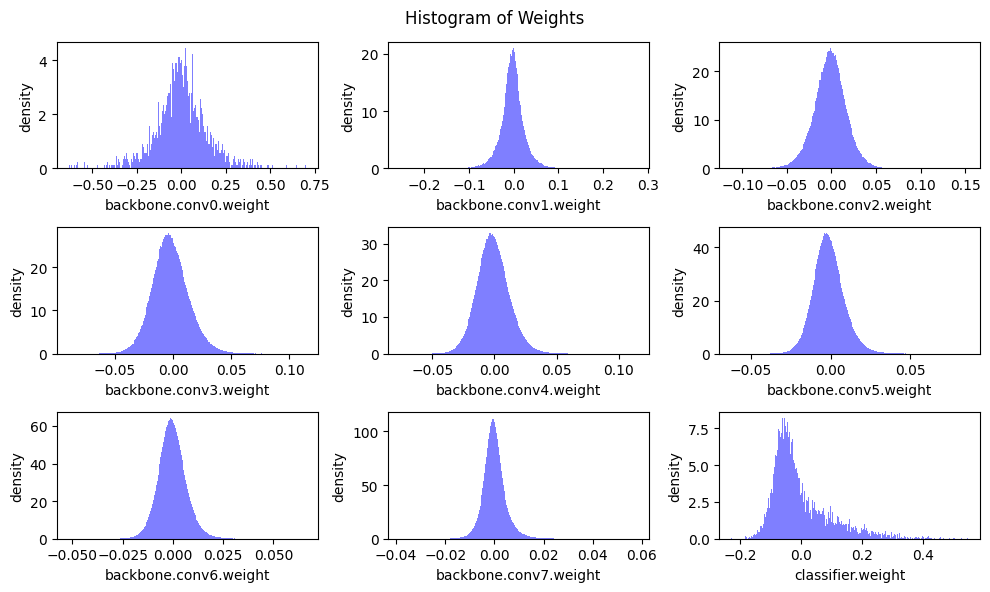

In [18]:
def plot_weight_distribution(model, bins=256, count_nonzero_only=False):
    fig, axes = plt.subplots(3,3, figsize=(10, 6))
    axes = axes.ravel()
    plot_index = 0
    for name, param in model.named_parameters():
        if param.dim() > 1:
            ax = axes[plot_index]
            if count_nonzero_only:
                param_cpu = param.detach().view(-1).cpu()
                param_cpu = param_cpu[param_cpu != 0].view(-1)
                ax.hist(param_cpu, bins=bins, density=True,
                        color = 'blue', alpha = 0.5)
            else:
                ax.hist(param.detach().view(-1).cpu(), bins=bins, density=True,
                        color = 'blue', alpha = 0.5)
            ax.set_xlabel(name)
            ax.set_ylabel('density')
            plot_index += 1
    fig.suptitle('Histogram of Weights')
    fig.tight_layout()
    fig.subplots_adjust(top=0.925)
    plt.show()

plot_weight_distribution(model)

## Question 1 (10 pts)

Please answer the following questions using the information in the above histograms of weights.


### Question 1.1 (5 pts)

What are the common characteristics of the weight distribution in the different layers?

**Your Answer:** distribution gets smaller when going from one layer to another

### Question 1.2  (5 pts)

How do these characteristics help pruning?

**Your Answer:** Since the distribution is centered more around zero, the pruning will result in more weight values to be pruned out.

# Fine-grained Pruning

In this section, we will implement and perform fine-grained pruning.

Fine-grained pruning removes the synapses with lowest importance. The weight tensor $W$ will become sparse after fine-grained pruning, which can be described with **sparsity**:

> $\mathrm{sparsity} := \#\mathrm{Zeros} / \#W = 1 - \#\mathrm{Nonzeros} / \#W$

where $\#W$ is the number of elements in $W$.

In practice, given the target sparsity $s$, the weight tensor $W$ is multiplied with a binary mask $M$ to disregard removed weight:

> $v_{\mathrm{thr}} = \texttt{kthvalue}(Importance, \#W \cdot s)$
>
> $M = Importance > v_{\mathrm{thr}}$
>
> $W = W \cdot M$

where $Importance$ is importance tensor with the same shape of $W$, $\texttt{kthvalue}(X, k)$ finds the $k$-th smallest value of tensor $X$, $v_{\mathrm{thr}}$ is the threshold value.

## Magnitude-based Pruning

For fine-grained pruning, a widely-used importance is the magnitude of weight value, *i.e.*,

$Importance=|W|$

This is known as **Magnitude-based Pruning** (see [Learning both Weights and Connections for Efficient
Neural Networks](https://arxiv.org/pdf/1506.02626.pdf)).

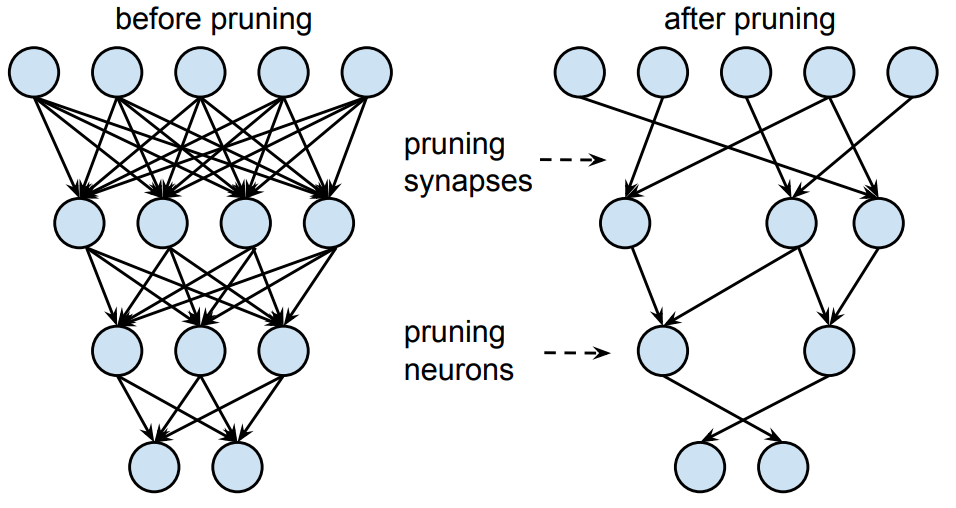

In [44]:
x = torch.tensor([  [1, 2, 3], 
                    [4, 5, 6]
                ])

print(x)
torch.kthvalue(x, 2, 1, False)


tensor([[1, 2, 3],
        [4, 5, 6]])


torch.return_types.kthvalue(
values=tensor([2, 5]),
indices=tensor([1, 1]))

### Question 2 (15 pts)

Please complete the following magnitude-based fine-grained pruning function.

**Hint**:
*   In step 1, we calculate the number of zeros (`num_zeros`) after pruning. Note that `num_zeros` should be an integer. You could use either `round()` or `int()` to convert a floating number into an integer. Here we use `round()`.
*   In step 2, we calculate the `importance` of weight tensor. Pytorch provides [`torch.abs()`](https://pytorch.org/docs/stable/generated/torch.abs.html#torch.abs), [`torch.Tensor.abs()`](https://pytorch.org/docs/stable/generated/torch.Tensor.abs.html#torch.Tensor.abs), [`torch.Tensor.abs_()`](https://pytorch.org/docs/stable/generated/torch.Tensor.abs_.html) APIs.
*   In step 3, we calculate the pruning `threshold` so that all synapses with importance smaller than `threshold` will be removed. Pytorch provides [`torch.kthvalue()`](https://pytorch.org/docs/stable/generated/torch.kthvalue.html), [`torch.Tensor.kthvalue()`](https://pytorch.org/docs/stable/generated/torch.Tensor.kthvalue.html), [`torch.topk()`](https://pytorch.org/docs/stable/generated/torch.topk.html) APIs.
*   In step 4, we calculate the pruning `mask` based on the `threshold`. **1** in the `mask` indicates the synapse will be kept, and **0** in the `mask` indicates the synapse will be removed. `mask = importance > threshold`. Pytorch provides [`torch.gt()`](https://pytorch.org/docs/stable/generated/torch.gt.html?highlight=torch%20gt#torch.gt) API.

In [78]:
def fine_grained_prune(tensor: torch.Tensor, sparsity : float) -> torch.Tensor:
    """
    magnitude-based pruning for single tensor
    :param tensor: torch.(cuda.)Tensor, weight of conv/fc layer
    :param sparsity: float, pruning sparsity
        sparsity = #zeros / #elements = 1 - #nonzeros / #elements
    :return:
        torch.(cuda.)Tensor, mask for zeros
    """
    sparsity = min(max(0.0, sparsity), 1.0)
    if sparsity == 1.0:
        tensor.zero_()
        return torch.zeros_like(tensor)
    elif sparsity == 0.0:
        return torch.ones_like(tensor)

    num_elements = tensor.numel()

    ##################### YOUR CODE STARTS HERE #####################
    # Step 1: calculate the #zeros (please use round())
    num_zeros = round(num_elements * sparsity)
    # Step 2: calculate the importance of weight
    importance = torch.abs(tensor)
    # Step 3: calculate the pruning threshold
    threshold = torch.kthvalue(importance.view(-1), num_zeros).values
    # Step 4: get binary mask (1 for nonzeros, 0 for zeros)
    mask = torch.gt(importance, threshold)
    ##################### YOUR CODE ENDS HERE #######################

    # Step 5: apply mask to prune the tensor
    tensor.mul_(mask)

    return mask

Let's verify the functionality of defined fine-grained pruning by applying the function above on a dummy tensor.

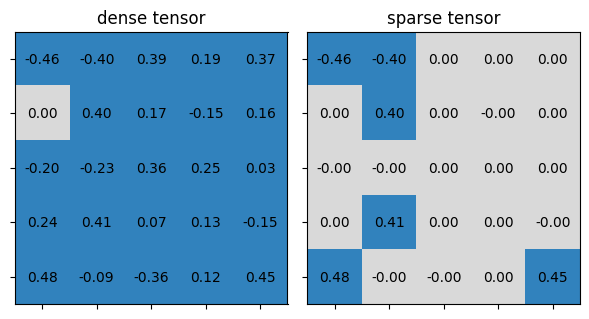

* Test fine_grained_prune()
    target sparsity: 0.75
        sparsity before pruning: 0.04
        sparsity after pruning: 0.76
        sparsity of pruning mask: 0.76
* Test passed.


In [79]:
test_fine_grained_prune()

### Question 3 (5 pts)

The last cell plots the tensor before and after pruning. Nonzeros are rendered in blue while zeros are rendered in gray. Please modify the value of `target_sparsity` in the following code cell so that there are only 10 nonzeros in the sparse tensor after pruning.

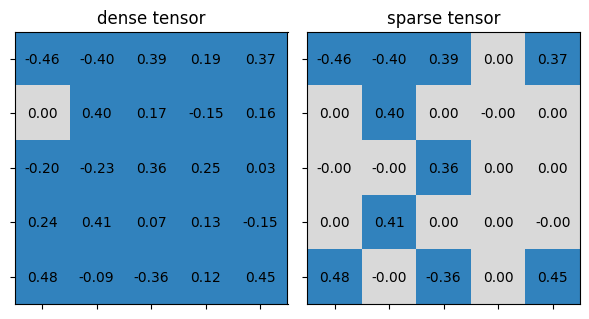

* Test fine_grained_prune()
    target sparsity: 0.60
        sparsity before pruning: 0.04
        sparsity after pruning: 0.60
        sparsity of pruning mask: 0.60
* Test passed.


In [92]:
##################### YOUR CODE STARTS HERE #####################
target_sparsity = .6 # please modify the value of target_sparsity
##################### YOUR CODE ENDS HERE #####################
test_fine_grained_prune(target_sparsity=target_sparsity, target_nonzeros=10)

We now wrap the fine-grained pruning function into a class for pruning the whole model. In class `FineGrainedPruner`, we have to keep a record of the pruning masks so that we could apply the masks whenever the model weights change to make sure the model keep sparse all the time.

In [ ]:
class FineGrainedPruner:
    def __init__(self, model, sparsity_dict):
        self.masks = FineGrainedPruner.prune(model, sparsity_dict)

    @torch.no_grad()
    def apply(self, model):
        for name, param in model.named_parameters():
            if name in self.masks:
                param *= self.masks[name]
                memory_usage = param.element_size() * param.numel() / 1000 / 1000 #MB
                print("name: ",name)
                print(f"param memory: {memory_usage:0.2f}")
                print("param dtype: ", param.dtype)
                print(f"param min {param.min()}, mean {param.mean()}, max {param.max()}")

    @staticmethod
    @torch.no_grad()
    def prune(model, sparsity_dict):
        masks = dict()
        for name, param in model.named_parameters():
            memory_usage = param.element_size() * param.numel()
            print("name prune: ",name)
            print(f"param memory: {memory_usage:0.2f}")
            print("param dtype: ", param.dtype)
            print(f"param min {param.min()}, mean {param.mean()}, max {param.max()}")
            if param.dim() > 1: # we only prune conv and fc weights
                masks[name] = fine_grained_prune(param, sparsity_dict[name])
                # print("mask[name] prune: ", masks[name])
        return masks

## Sensitivity Scan


Different layers contribute differently to the model performance. It is challenging to decide the proper sparsity for each layer. A widely used approach is sensitivity scan.

During the sensitivity scan, at each time, we will only prune one layer to see the accuracy degradation. By scanning different sparsities, we could draw the sensitivity curve (i.e., accuracy vs. sparsity) of the corresponding layer.

Here is an example figure for sensitivity curves. The x-axis is the sparsity or the percentage of #parameters dropped (*i.e.*, sparsity). The y-axis is the validation accuracy. (This is Figure 6 in [Learning both Weights and Connections for Efficient
Neural Networks](https://arxiv.org/pdf/1506.02626.pdf))


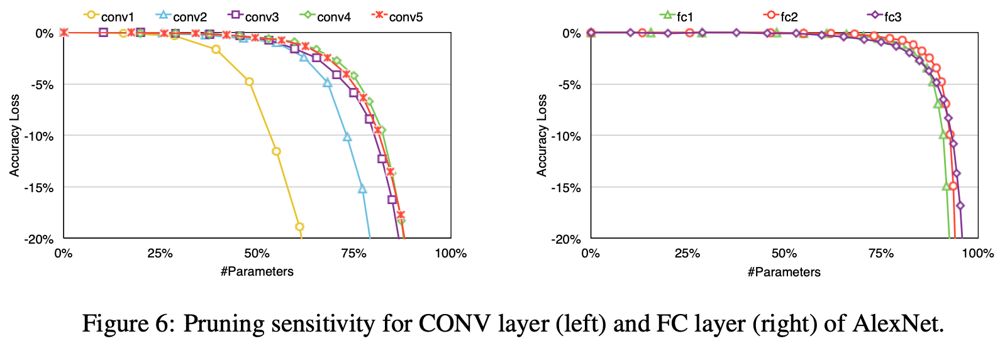

The following code cell defines the sensitivity scan function that returns the sparsities scanned, and a list of accuracies for each weight to be pruned.

In [104]:
@torch.no_grad()
def sensitivity_scan(model, dataloader, scan_step=0.1, scan_start=0.4, scan_end=1.0, verbose=True):
    sparsities = np.arange(start=scan_start, stop=scan_end, step=scan_step)
    accuracies = []
    named_conv_weights = [(name, param) for (name, param) \
                          in model.named_parameters() if param.dim() > 1]
    for i_layer, (name, param) in enumerate(named_conv_weights):
        param_clone = param.detach().clone()
        accuracy = []
        for sparsity in tqdm(sparsities, desc=f'scanning {i_layer}/{len(named_conv_weights)} weight - {name}'):
            fine_grained_prune(param.detach(), sparsity=sparsity)
            acc = evaluate(model, dataloader, verbose=False)
            if verbose:
                print(f'\r    sparsity={sparsity:.2f}: accuracy={acc:.2f}%', end='')
            # restore
            param.copy_(param_clone)
            accuracy.append(acc)
        if verbose:
            print(f'\r    sparsity=[{",".join(["{:.2f}".format(x) for x in sparsities])}]: accuracy=[{", ".join(["{:.2f}%".format(x) for x in accuracy])}]', end='')
        accuracies.append(accuracy)
    return sparsities, accuracies

Please run the following cells to plot the sensitivity curves. It should take around 2 minutes to finish.

In [105]:
sparsities, accuracies = sensitivity_scan(
    model, dataloader['test'], scan_step=0.1, scan_start=0.4, scan_end=1.0)

scanning 0/9 weight - backbone.conv0.weight:  17%|█▋        | 1/6 [00:02<00:14,  2.95s/it]

    sparsity=0.40: accuracy=92.42%

scanning 0/9 weight - backbone.conv0.weight:  33%|███▎      | 2/6 [00:05<00:11,  2.85s/it]

    sparsity=0.50: accuracy=91.19%

scanning 0/9 weight - backbone.conv0.weight:  50%|█████     | 3/6 [00:08<00:08,  2.84s/it]

    sparsity=0.60: accuracy=87.55%

scanning 0/9 weight - backbone.conv0.weight:  67%|██████▋   | 4/6 [00:11<00:05,  2.85s/it]

    sparsity=0.70: accuracy=83.39%

scanning 0/9 weight - backbone.conv0.weight:  83%|████████▎ | 5/6 [00:14<00:02,  2.90s/it]

    sparsity=0.80: accuracy=69.41%

scanning 0/9 weight - backbone.conv0.weight: 100%|██████████| 6/6 [00:17<00:00,  2.88s/it]


    sparsity=[0.40,0.50,0.60,0.70,0.80,0.90]: accuracy=[92.42%, 91.19%, 87.55%, 83.39%, 69.41%, 31.81%]

scanning 1/9 weight - backbone.conv1.weight:  17%|█▋        | 1/6 [00:02<00:14,  2.97s/it]

    sparsity=0.40: accuracy=92.93%

scanning 1/9 weight - backbone.conv1.weight:  33%|███▎      | 2/6 [00:05<00:11,  2.92s/it]

    sparsity=0.50: accuracy=92.88%

scanning 1/9 weight - backbone.conv1.weight:  50%|█████     | 3/6 [00:08<00:08,  2.87s/it]

    sparsity=0.60: accuracy=92.71%

scanning 1/9 weight - backbone.conv1.weight:  67%|██████▋   | 4/6 [00:11<00:05,  2.84s/it]

    sparsity=0.70: accuracy=92.40%

scanning 1/9 weight - backbone.conv1.weight:  83%|████████▎ | 5/6 [00:14<00:02,  2.83s/it]

    sparsity=0.80: accuracy=91.32%

scanning 1/9 weight - backbone.conv1.weight: 100%|██████████| 6/6 [00:17<00:00,  2.84s/it]


    sparsity=[0.40,0.50,0.60,0.70,0.80,0.90]: accuracy=[92.93%, 92.88%, 92.71%, 92.40%, 91.32%, 84.78%]

scanning 2/9 weight - backbone.conv2.weight:  17%|█▋        | 1/6 [00:02<00:13,  2.78s/it]

    sparsity=0.40: accuracy=92.94%

scanning 2/9 weight - backbone.conv2.weight:  33%|███▎      | 2/6 [00:05<00:11,  2.80s/it]

    sparsity=0.50: accuracy=92.64%

scanning 2/9 weight - backbone.conv2.weight:  50%|█████     | 3/6 [00:08<00:08,  2.93s/it]

    sparsity=0.60: accuracy=92.46%

scanning 2/9 weight - backbone.conv2.weight:  67%|██████▋   | 4/6 [00:11<00:05,  2.88s/it]

    sparsity=0.70: accuracy=91.77%

scanning 2/9 weight - backbone.conv2.weight:  83%|████████▎ | 5/6 [00:14<00:02,  2.85s/it]

    sparsity=0.80: accuracy=89.85%

scanning 2/9 weight - backbone.conv2.weight: 100%|██████████| 6/6 [00:17<00:00,  2.87s/it]


    sparsity=[0.40,0.50,0.60,0.70,0.80,0.90]: accuracy=[92.94%, 92.64%, 92.46%, 91.77%, 89.85%, 78.56%]

scanning 3/9 weight - backbone.conv3.weight:  17%|█▋        | 1/6 [00:02<00:14,  2.93s/it]

    sparsity=0.40: accuracy=92.86%

scanning 3/9 weight - backbone.conv3.weight:  33%|███▎      | 2/6 [00:05<00:11,  2.87s/it]

    sparsity=0.50: accuracy=92.72%

scanning 3/9 weight - backbone.conv3.weight:  50%|█████     | 3/6 [00:08<00:08,  2.85s/it]

    sparsity=0.60: accuracy=92.23%

scanning 3/9 weight - backbone.conv3.weight:  67%|██████▋   | 4/6 [00:11<00:05,  2.85s/it]

    sparsity=0.70: accuracy=91.09%

scanning 3/9 weight - backbone.conv3.weight:  83%|████████▎ | 5/6 [00:14<00:02,  2.86s/it]

    sparsity=0.80: accuracy=85.35%

scanning 3/9 weight - backbone.conv3.weight: 100%|██████████| 6/6 [00:17<00:00,  2.88s/it]


    sparsity=[0.40,0.50,0.60,0.70,0.80,0.90]: accuracy=[92.86%, 92.72%, 92.23%, 91.09%, 85.35%, 51.31%]

scanning 4/9 weight - backbone.conv4.weight:  17%|█▋        | 1/6 [00:02<00:14,  2.82s/it]

    sparsity=0.40: accuracy=92.88%

scanning 4/9 weight - backbone.conv4.weight:  33%|███▎      | 2/6 [00:05<00:11,  2.82s/it]

    sparsity=0.50: accuracy=92.68%

scanning 4/9 weight - backbone.conv4.weight:  50%|█████     | 3/6 [00:08<00:08,  2.82s/it]

    sparsity=0.60: accuracy=92.22%

scanning 4/9 weight - backbone.conv4.weight:  67%|██████▋   | 4/6 [00:11<00:05,  2.86s/it]

    sparsity=0.70: accuracy=89.47%

scanning 4/9 weight - backbone.conv4.weight:  83%|████████▎ | 5/6 [00:14<00:02,  2.86s/it]

    sparsity=0.80: accuracy=76.86%

scanning 4/9 weight - backbone.conv4.weight: 100%|██████████| 6/6 [00:17<00:00,  2.86s/it]


    sparsity=[0.40,0.50,0.60,0.70,0.80,0.90]: accuracy=[92.88%, 92.68%, 92.22%, 89.47%, 76.86%, 38.78%]

scanning 5/9 weight - backbone.conv5.weight:  17%|█▋        | 1/6 [00:02<00:14,  2.89s/it]

    sparsity=0.40: accuracy=92.92%

scanning 5/9 weight - backbone.conv5.weight:  33%|███▎      | 2/6 [00:05<00:11,  2.87s/it]

    sparsity=0.50: accuracy=92.71%

scanning 5/9 weight - backbone.conv5.weight:  50%|█████     | 3/6 [00:08<00:08,  2.92s/it]

    sparsity=0.60: accuracy=92.63%

scanning 5/9 weight - backbone.conv5.weight:  67%|██████▋   | 4/6 [00:12<00:06,  3.06s/it]

    sparsity=0.70: accuracy=91.88%

scanning 5/9 weight - backbone.conv5.weight:  83%|████████▎ | 5/6 [00:15<00:03,  3.05s/it]

    sparsity=0.80: accuracy=89.90%

scanning 5/9 weight - backbone.conv5.weight: 100%|██████████| 6/6 [00:17<00:00,  2.98s/it]


    sparsity=[0.40,0.50,0.60,0.70,0.80,0.90]: accuracy=[92.92%, 92.71%, 92.63%, 91.88%, 89.90%, 82.19%]

scanning 6/9 weight - backbone.conv6.weight:  17%|█▋        | 1/6 [00:02<00:14,  2.84s/it]

    sparsity=0.40: accuracy=92.94%

scanning 6/9 weight - backbone.conv6.weight:  33%|███▎      | 2/6 [00:05<00:11,  2.88s/it]

    sparsity=0.50: accuracy=92.86%

scanning 6/9 weight - backbone.conv6.weight:  50%|█████     | 3/6 [00:08<00:08,  2.89s/it]

    sparsity=0.60: accuracy=92.65%

scanning 6/9 weight - backbone.conv6.weight:  67%|██████▋   | 4/6 [00:11<00:05,  2.88s/it]

    sparsity=0.70: accuracy=92.10%

scanning 6/9 weight - backbone.conv6.weight:  83%|████████▎ | 5/6 [00:14<00:02,  2.92s/it]

    sparsity=0.80: accuracy=90.58%

scanning 6/9 weight - backbone.conv6.weight: 100%|██████████| 6/6 [00:17<00:00,  2.93s/it]


    sparsity=[0.40,0.50,0.60,0.70,0.80,0.90]: accuracy=[92.94%, 92.86%, 92.65%, 92.10%, 90.58%, 83.65%]

scanning 7/9 weight - backbone.conv7.weight:  17%|█▋        | 1/6 [00:02<00:14,  2.86s/it]

    sparsity=0.40: accuracy=92.94%

scanning 7/9 weight - backbone.conv7.weight:  33%|███▎      | 2/6 [00:05<00:11,  2.88s/it]

    sparsity=0.50: accuracy=92.92%

scanning 7/9 weight - backbone.conv7.weight:  50%|█████     | 3/6 [00:08<00:08,  2.90s/it]

    sparsity=0.60: accuracy=92.88%

scanning 7/9 weight - backbone.conv7.weight:  67%|██████▋   | 4/6 [00:11<00:05,  2.89s/it]

    sparsity=0.70: accuracy=92.81%

scanning 7/9 weight - backbone.conv7.weight:  83%|████████▎ | 5/6 [00:14<00:02,  2.91s/it]

    sparsity=0.80: accuracy=92.63%

scanning 7/9 weight - backbone.conv7.weight: 100%|██████████| 6/6 [00:17<00:00,  2.91s/it]


    sparsity=[0.40,0.50,0.60,0.70,0.80,0.90]: accuracy=[92.94%, 92.92%, 92.88%, 92.81%, 92.63%, 91.34%]

scanning 8/9 weight - classifier.weight:  17%|█▋        | 1/6 [00:02<00:14,  2.86s/it]

    sparsity=0.40: accuracy=92.91%

scanning 8/9 weight - classifier.weight:  33%|███▎      | 2/6 [00:05<00:11,  2.92s/it]

    sparsity=0.50: accuracy=92.83%

scanning 8/9 weight - classifier.weight:  50%|█████     | 3/6 [00:09<00:09,  3.09s/it]

    sparsity=0.60: accuracy=92.81%

scanning 8/9 weight - classifier.weight:  67%|██████▋   | 4/6 [00:11<00:06,  3.01s/it]

    sparsity=0.70: accuracy=92.97%

scanning 8/9 weight - classifier.weight:  83%|████████▎ | 5/6 [00:14<00:02,  2.95s/it]

    sparsity=0.80: accuracy=92.68%

scanning 8/9 weight - classifier.weight: 100%|██████████| 6/6 [00:17<00:00,  2.96s/it]

    sparsity=[0.40,0.50,0.60,0.70,0.80,0.90]: accuracy=[92.91%, 92.83%, 92.81%, 92.97%, 92.68%, 92.52%]

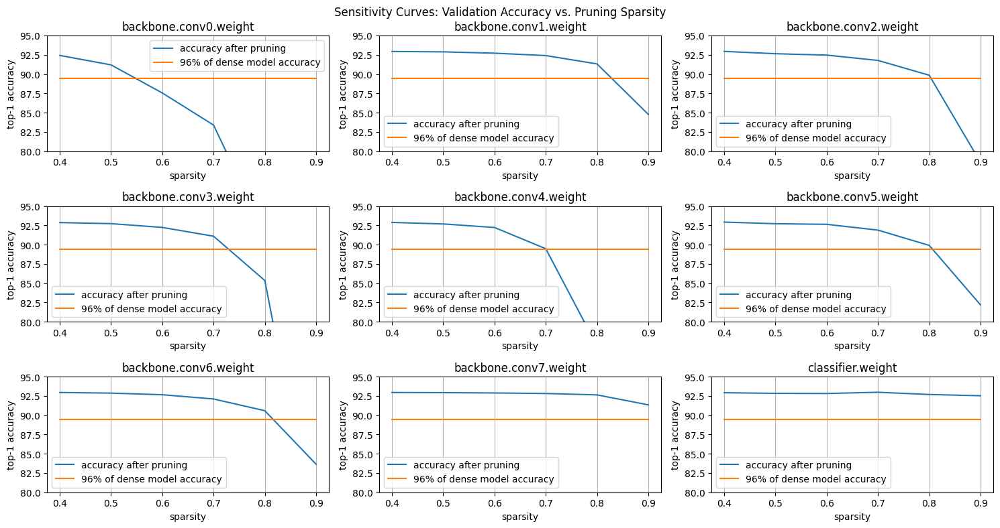

In [106]:
def plot_sensitivity_scan(sparsities, accuracies, dense_model_accuracy):
    lower_bound_accuracy = 100 - (100 - dense_model_accuracy) * 1.5
    fig, axes = plt.subplots(3, int(math.ceil(len(accuracies) / 3)),figsize=(15,8))
    axes = axes.ravel()
    plot_index = 0
    for name, param in model.named_parameters():
        if param.dim() > 1:
            ax = axes[plot_index]
            curve = ax.plot(sparsities, accuracies[plot_index])
            line = ax.plot(sparsities, [lower_bound_accuracy] * len(sparsities))
            ax.set_xticks(np.arange(start=0.4, stop=1.0, step=0.1))
            ax.set_ylim(80, 95)
            ax.set_title(name)
            ax.set_xlabel('sparsity')
            ax.set_ylabel('top-1 accuracy')
            ax.legend([
                'accuracy after pruning',
                f'{lower_bound_accuracy / dense_model_accuracy * 100:.0f}% of dense model accuracy'
            ])
            ax.grid(axis='x')
            plot_index += 1
    fig.suptitle('Sensitivity Curves: Validation Accuracy vs. Pruning Sparsity')
    fig.tight_layout()
    fig.subplots_adjust(top=0.925)
    plt.show()

plot_sensitivity_scan(sparsities, accuracies, dense_model_accuracy)

### Question 4 (15 pts)

Please answer the following questions using the information in the above sensitivity curves.

#### Question 4.1 (5 pts)

What's the relationship between pruning sparsity and model accuracy? (*i.e.*, does accuracy increase or decrease when sparsity becomes higher?)

**Your Answer:** accuracy decrease with the increase of sparsity

#### Question 4.2 (5 pts)

Do all the layers have the same sensitivity?

**Your Answer:** No

#### Question 4.3 (5 pts)

Which layer is the most sensitive to the pruning sparsity?

**Your Answer:** conv0

## \#Parameters of each layer
In addition to accuracy, the number of each layer's parameters also affects the decision on sparsity selection. Layers with more #parameters require larger sparsities.

Please run the following code cell to plot the distribution of #parameters in the whole model.

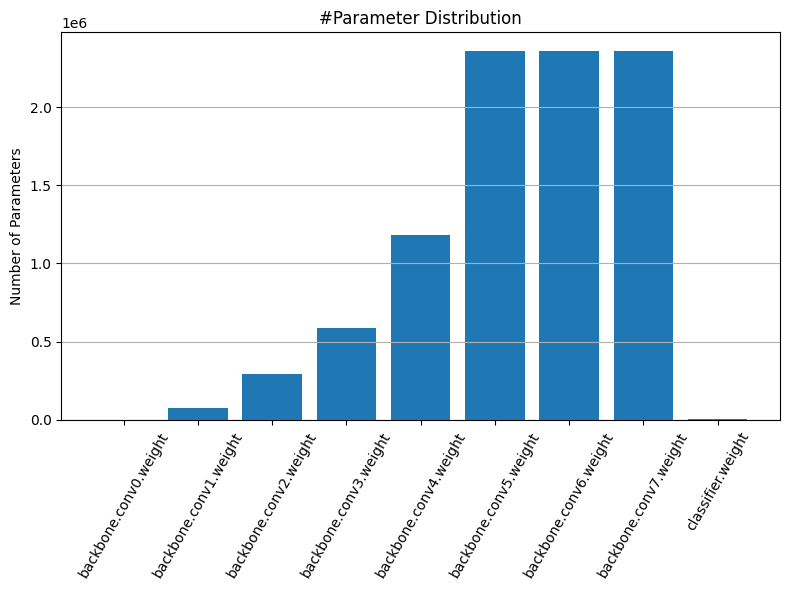

In [107]:
def plot_num_parameters_distribution(model):
    num_parameters = dict()
    for name, param in model.named_parameters():
        if param.dim() > 1:
            num_parameters[name] = param.numel()
    fig = plt.figure(figsize=(8, 6))
    plt.grid(axis='y')
    plt.bar(list(num_parameters.keys()), list(num_parameters.values()))
    plt.title('#Parameter Distribution')
    plt.ylabel('Number of Parameters')
    plt.xticks(rotation=60)
    plt.tight_layout()
    plt.show()

plot_num_parameters_distribution(model)

## Select Sparsity Based on Sensitivity Curves and \#Parameters Distribution



### Question 5 (10 pts)

Based on the sensitivity curves and the distribution of #parameters in the model, please select the sparsity for each layer.

Note that the overall compression ratio of pruned model mostly depends on the layers with larger #parameters, and different layers have different sensitivity to pruning (see Question 4).

Please make sure that after pruning, the sparse model is 25% of the size of the dense model, and validation accuracy is higher than 92.5 after finetuning.

**Hint**:
*   The layer with more #parameters should have larger sparsity. (see *Figure #Parameter Distribution*)
*   The layer that is sensitive to the pruning sparsity (i.e., the accuracy will drop quickly as sparsity becomes higher) should have smaller sparsity. (see *Figure Sensitivity Curves*)

In [108]:
recover_model()

sparsity_dict = {
##################### YOUR CODE STARTS HERE #####################
    # please modify the sparsity value of each layer
    # please DO NOT modify the key of sparsity_dict
    'backbone.conv0.weight': 0.5,
    'backbone.conv1.weight': 0.8,
    'backbone.conv2.weight': 0.8,
    'backbone.conv3.weight': 0.7,
    'backbone.conv4.weight': 0.7,
    'backbone.conv5.weight': 0.8,
    'backbone.conv6.weight': 0.8,
    'backbone.conv7.weight': 0.9,
    'classifier.weight': 0.95
##################### YOUR CODE ENDS HERE #######################
}

Please run the following cell to prune the model according to your defined `sparsity_dict`, and print the information of sparse model.

name prune:  backbone.conv0.weight
param prune:  Parameter containing:
tensor([[[[ 0.1103,  0.1988,  0.1813],
          [-0.0447, -0.0146, -0.0817],
          [-0.0636, -0.0664, -0.1033]],

         [[ 0.1178,  0.2228,  0.2112],
          [-0.0784, -0.0278, -0.1142],
          [-0.1931, -0.1863, -0.1862]],

         [[ 0.1092,  0.2307,  0.1956],
          [-0.0150, -0.0043, -0.0046],
          [-0.1780, -0.1288, -0.1732]]],


        [[[-0.0155,  0.1648,  0.1996],
          [ 0.0623,  0.0909,  0.0659],
          [ 0.0013,  0.0171, -0.0754]],

         [[-0.0849, -0.0121,  0.0122],
          [ 0.0015, -0.0926, -0.0989],
          [ 0.0686, -0.0463, -0.0929]],

         [[-0.0821, -0.0719, -0.0775],
          [-0.0619, -0.1631, -0.1287],
          [ 0.0049, -0.0272, -0.0887]]],


        [[[-0.2993, -0.4199, -0.1233],
          [-0.0393, -0.0801,  0.1251],
          [ 0.1654,  0.2652,  0.1521]],

         [[ 0.0589, -0.0089,  0.2017],
          [ 0.0887,  0.1471,  0.2403],
          [ 0.

Sparse model has accuracy=65.23% before fintuning


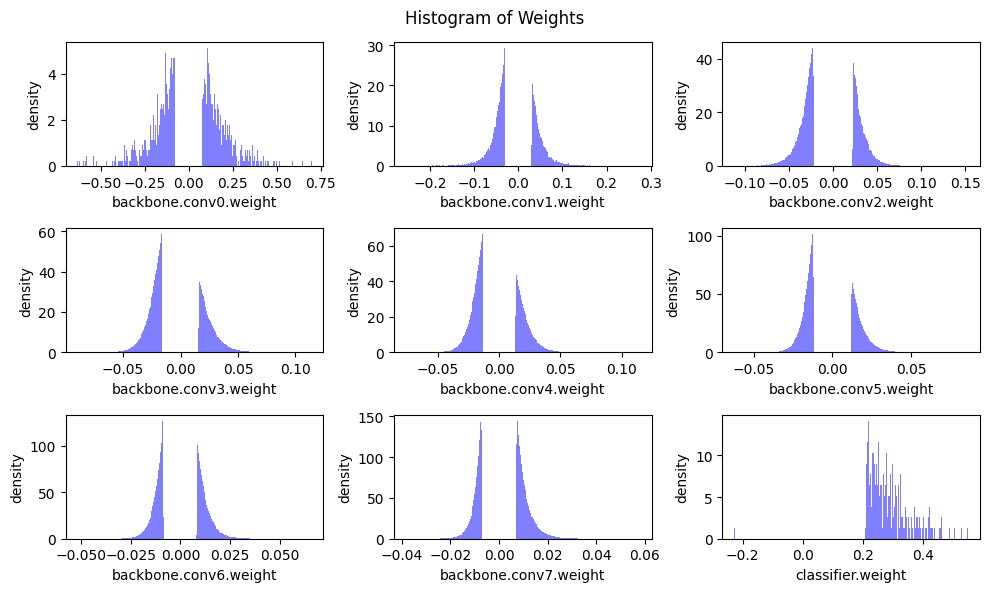

In [109]:
pruner = FineGrainedPruner(model, sparsity_dict)
print(f'After pruning with sparsity dictionary')
for name, sparsity in sparsity_dict.items():
    print(f'  {name}: {sparsity:.2f}')
print(f'The sparsity of each layer becomes')
for name, param in model.named_parameters():
    if name in sparsity_dict:
        print(f'  {name}: {get_sparsity(param):.2f}')

sparse_model_size = get_model_size(model, count_nonzero_only=True)
print(f"Sparse model has size={sparse_model_size / MiB:.2f} MiB = {sparse_model_size / dense_model_size * 100:.2f}% of dense model size")
sparse_model_accuracy = evaluate(model, dataloader['test'])
print(f"Sparse model has accuracy={sparse_model_accuracy:.2f}% before fintuning")

plot_weight_distribution(model, count_nonzero_only=True)

## Finetune the fine-grained pruned model

As we can see from the outputs of previous cell, even though fine-grained pruning reduces the most of model weights, the accuracy of model also dropped. Therefore, we have to finetune the sparse model to recover the accuracy.

Please run the following cell to finetune the sparse model. It should take around 3 minutes to finish.

In [110]:
num_finetune_epochs = 5
optimizer = torch.optim.SGD(model.parameters(), lr=0.01, momentum=0.9, weight_decay=1e-4)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, num_finetune_epochs)
criterion = nn.CrossEntropyLoss()

best_sparse_model_checkpoint = dict()
best_accuracy = 0
print(f'Finetuning Fine-grained Pruned Sparse Model')
for epoch in range(num_finetune_epochs):
    # At the end of each train iteration, we have to apply the pruning mask
    #    to keep the model sparse during the training
    train(model, dataloader['train'], criterion, optimizer, scheduler,
          callbacks=[lambda: pruner.apply(model)])
    accuracy = evaluate(model, dataloader['test'])
    is_best = accuracy > best_accuracy
    if is_best:
        best_sparse_model_checkpoint['state_dict'] = copy.deepcopy(model.state_dict())
        best_accuracy = accuracy
    print(f'    Epoch {epoch+1} Accuracy {accuracy:.2f}% / Best Accuracy: {best_accuracy:.2f}%')

Finetuning Fine-grained Pruned Sparse Model


train:   0%|          | 0/98 [00:00<?, ?it/s]

name:  backbone.conv0.weight
param:  

train:   1%|          | 1/98 [00:01<02:23,  1.48s/it]

Parameter containing:
tensor([[[[ 0.1102,  0.1988,  0.1812],
          [-0.0000, -0.0000, -0.0817],
          [-0.0000, -0.0000, -0.1034]],

         [[ 0.1178,  0.2228,  0.2112],
          [-0.0784, -0.0000, -0.1143],
          [-0.1931, -0.1864, -0.1863]],

         [[ 0.1092,  0.2306,  0.1956],
          [-0.0000, -0.0000, -0.0000],
          [-0.1781, -0.1288, -0.1732]]],


        [[[ 0.0000,  0.1648,  0.1996],
          [ 0.0000,  0.0909,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0849,  0.0000,  0.0000],
          [ 0.0000, -0.0926, -0.0988],
          [ 0.0000,  0.0000, -0.0929]],

         [[-0.0821,  0.0000, -0.0775],
          [ 0.0000, -0.1631, -0.1287],
          [ 0.0000,  0.0000, -0.0887]]],


        [[[-0.2993, -0.4199, -0.1233],
          [ 0.0000, -0.0801,  0.1251],
          [ 0.1654,  0.2652,  0.1521]],

         [[-0.0000,  0.0000,  0.2017],
          [ 0.0887,  0.1471,  0.2403],
          [ 0.0000,  0.1264,  0.0000]],

         [[ 0.2082,  0

train:   2%|▏         | 2/98 [00:02<01:45,  1.10s/it]

Parameter containing:
tensor([[[[ 0.1102,  0.1987,  0.1812],
          [-0.0000, -0.0000, -0.0818],
          [-0.0000, -0.0000, -0.1034]],

         [[ 0.1178,  0.2228,  0.2112],
          [-0.0784, -0.0000, -0.1143],
          [-0.1932, -0.1864, -0.1863]],

         [[ 0.1092,  0.2306,  0.1955],
          [-0.0000, -0.0000, -0.0000],
          [-0.1781, -0.1289, -0.1733]]],


        [[[ 0.0000,  0.1649,  0.1996],
          [ 0.0000,  0.0909,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0849,  0.0000,  0.0000],
          [ 0.0000, -0.0926, -0.0988],
          [ 0.0000,  0.0000, -0.0929]],

         [[-0.0821,  0.0000, -0.0775],
          [-0.0000, -0.1631, -0.1287],
          [-0.0000, -0.0000, -0.0887]]],


        [[[-0.2993, -0.4199, -0.1232],
          [ 0.0000, -0.0801,  0.1251],
          [ 0.1654,  0.2652,  0.1521]],

         [[ 0.0000,  0.0000,  0.2017],
          [ 0.0887,  0.1471,  0.2403],
          [-0.0000,  0.1263, -0.0000]],

         [[ 0.2081,  0

train:   3%|▎         | 3/98 [00:03<01:29,  1.06it/s]

Parameter containing:
tensor([[[[ 0.1101,  0.1987,  0.1811],
          [-0.0000, -0.0000, -0.0819],
          [-0.0000, -0.0000, -0.1035]],

         [[ 0.1177,  0.2227,  0.2111],
          [-0.0785, -0.0000, -0.1144],
          [-0.1932, -0.1865, -0.1863]],

         [[ 0.1091,  0.2306,  0.1955],
          [-0.0000, -0.0000, -0.0000],
          [-0.1782, -0.1289, -0.1733]]],


        [[[ 0.0000,  0.1649,  0.1997],
          [ 0.0000,  0.0909,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0848,  0.0000,  0.0000],
          [ 0.0000, -0.0926, -0.0988],
          [ 0.0000,  0.0000, -0.0929]],

         [[-0.0821,  0.0000, -0.0775],
          [ 0.0000, -0.1631, -0.1287],
          [ 0.0000,  0.0000, -0.0887]]],


        [[[-0.2993, -0.4199, -0.1232],
          [-0.0000, -0.0801,  0.1251],
          [ 0.1653,  0.2652,  0.1521]],

         [[-0.0000,  0.0000,  0.2017],
          [ 0.0887,  0.1471,  0.2403],
          [-0.0000,  0.1263, -0.0000]],

         [[ 0.2081,  0

train:   4%|▍         | 4/98 [00:03<01:24,  1.11it/s]

Parameter containing:
tensor([[[[ 0.1100,  0.1986,  0.1811],
          [-0.0000, -0.0000, -0.0819],
          [-0.0000, -0.0000, -0.1035]],

         [[ 0.1177,  0.2227,  0.2111],
          [-0.0785, -0.0000, -0.1144],
          [-0.1933, -0.1865, -0.1864]],

         [[ 0.1091,  0.2305,  0.1955],
          [-0.0000, -0.0000, -0.0000],
          [-0.1782, -0.1289, -0.1733]]],


        [[[ 0.0000,  0.1649,  0.1997],
          [ 0.0000,  0.0910,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0848,  0.0000,  0.0000],
          [ 0.0000, -0.0926, -0.0988],
          [ 0.0000,  0.0000, -0.0929]],

         [[-0.0821,  0.0000, -0.0775],
          [ 0.0000, -0.1631, -0.1286],
          [ 0.0000,  0.0000, -0.0887]]],


        [[[-0.2993, -0.4199, -0.1232],
          [ 0.0000, -0.0801,  0.1251],
          [ 0.1653,  0.2652,  0.1521]],

         [[ 0.0000,  0.0000,  0.2017],
          [ 0.0887,  0.1471,  0.2403],
          [-0.0000,  0.1263, -0.0000]],

         [[ 0.2081,  0

train:   5%|▌         | 5/98 [00:04<01:20,  1.15it/s]

Parameter containing:
tensor([[[[ 0.1100,  0.1986,  0.1811],
          [-0.0000, -0.0000, -0.0819],
          [-0.0000, -0.0000, -0.1035]],

         [[ 0.1177,  0.2227,  0.2111],
          [-0.0785, -0.0000, -0.1144],
          [-0.1933, -0.1865, -0.1864]],

         [[ 0.1091,  0.2305,  0.1955],
          [-0.0000, -0.0000, -0.0000],
          [-0.1782, -0.1289, -0.1733]]],


        [[[ 0.0000,  0.1649,  0.1997],
          [ 0.0000,  0.0910,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0848,  0.0000,  0.0000],
          [ 0.0000, -0.0926, -0.0988],
          [ 0.0000,  0.0000, -0.0929]],

         [[-0.0821,  0.0000, -0.0775],
          [ 0.0000, -0.1631, -0.1286],
          [ 0.0000,  0.0000, -0.0887]]],


        [[[-0.2993, -0.4199, -0.1232],
          [-0.0000, -0.0801,  0.1251],
          [ 0.1653,  0.2652,  0.1521]],

         [[ 0.0000,  0.0000,  0.2017],
          [ 0.0887,  0.1471,  0.2403],
          [-0.0000,  0.1263, -0.0000]],

         [[ 0.2081,  0

train:   6%|▌         | 6/98 [00:05<01:17,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1100,  0.1986,  0.1811],
          [-0.0000, -0.0000, -0.0819],
          [-0.0000, -0.0000, -0.1035]],

         [[ 0.1177,  0.2227,  0.2111],
          [-0.0785, -0.0000, -0.1144],
          [-0.1933, -0.1865, -0.1864]],

         [[ 0.1091,  0.2305,  0.1955],
          [-0.0000, -0.0000, -0.0000],
          [-0.1782, -0.1289, -0.1733]]],


        [[[ 0.0000,  0.1649,  0.1997],
          [ 0.0000,  0.0910,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0848,  0.0000,  0.0000],
          [ 0.0000, -0.0926, -0.0988],
          [ 0.0000,  0.0000, -0.0929]],

         [[-0.0821,  0.0000, -0.0775],
          [ 0.0000, -0.1631, -0.1286],
          [ 0.0000,  0.0000, -0.0887]]],


        [[[-0.2993, -0.4199, -0.1232],
          [ 0.0000, -0.0801,  0.1251],
          [ 0.1653,  0.2652,  0.1521]],

         [[ 0.0000,  0.0000,  0.2017],
          [ 0.0887,  0.1471,  0.2403],
          [ 0.0000,  0.1263, -0.0000]],

         [[ 0.2081,  0

train:   7%|▋         | 7/98 [00:06<01:14,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1100,  0.1986,  0.1811],
          [-0.0000, -0.0000, -0.0819],
          [-0.0000, -0.0000, -0.1036]],

         [[ 0.1177,  0.2227,  0.2111],
          [-0.0786, -0.0000, -0.1144],
          [-0.1933, -0.1865, -0.1864]],

         [[ 0.1091,  0.2305,  0.1955],
          [-0.0000, -0.0000, -0.0000],
          [-0.1782, -0.1289, -0.1734]]],


        [[[ 0.0000,  0.1649,  0.1997],
          [ 0.0000,  0.0910,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0848,  0.0000,  0.0000],
          [ 0.0000, -0.0925, -0.0988],
          [ 0.0000,  0.0000, -0.0929]],

         [[-0.0821,  0.0000, -0.0774],
          [ 0.0000, -0.1630, -0.1286],
          [ 0.0000,  0.0000, -0.0887]]],


        [[[-0.2993, -0.4198, -0.1232],
          [ 0.0000, -0.0801,  0.1251],
          [ 0.1653,  0.2652,  0.1521]],

         [[ 0.0000,  0.0000,  0.2017],
          [ 0.0887,  0.1471,  0.2403],
          [ 0.0000,  0.1263, -0.0000]],

         [[ 0.2081,  0

train:   8%|▊         | 8/98 [00:07<01:13,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1100,  0.1986,  0.1810],
          [-0.0000, -0.0000, -0.0820],
          [-0.0000, -0.0000, -0.1036]],

         [[ 0.1177,  0.2227,  0.2111],
          [-0.0786, -0.0000, -0.1144],
          [-0.1933, -0.1866, -0.1864]],

         [[ 0.1091,  0.2305,  0.1955],
          [-0.0000, -0.0000, -0.0000],
          [-0.1782, -0.1290, -0.1734]]],


        [[[ 0.0000,  0.1650,  0.1997],
          [ 0.0000,  0.0910,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0848,  0.0000,  0.0000],
          [ 0.0000, -0.0925, -0.0987],
          [ 0.0000,  0.0000, -0.0928]],

         [[-0.0821,  0.0000, -0.0774],
          [ 0.0000, -0.1630, -0.1286],
          [ 0.0000,  0.0000, -0.0886]]],


        [[[-0.2993, -0.4198, -0.1232],
          [ 0.0000, -0.0801,  0.1251],
          [ 0.1653,  0.2652,  0.1520]],

         [[ 0.0000,  0.0000,  0.2017],
          [ 0.0887,  0.1471,  0.2403],
          [ 0.0000,  0.1263, -0.0000]],

         [[ 0.2081,  0

train:   9%|▉         | 9/98 [00:07<01:11,  1.24it/s]

Parameter containing:
tensor([[[[ 0.1099,  0.1985,  0.1810],
          [-0.0000, -0.0000, -0.0820],
          [-0.0000, -0.0000, -0.1036]],

         [[ 0.1176,  0.2226,  0.2110],
          [-0.0787, -0.0000, -0.1145],
          [-0.1934, -0.1866, -0.1864]],

         [[ 0.1090,  0.2305,  0.1955],
          [-0.0000, -0.0000, -0.0000],
          [-0.1783, -0.1290, -0.1734]]],


        [[[ 0.0000,  0.1650,  0.1998],
          [ 0.0000,  0.0911,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0847,  0.0000,  0.0000],
          [ 0.0000, -0.0925, -0.0987],
          [ 0.0000,  0.0000, -0.0928]],

         [[-0.0821,  0.0000, -0.0774],
          [ 0.0000, -0.1630, -0.1286],
          [ 0.0000,  0.0000, -0.0886]]],


        [[[-0.2992, -0.4198, -0.1232],
          [ 0.0000, -0.0800,  0.1251],
          [ 0.1653,  0.2651,  0.1520]],

         [[ 0.0000,  0.0000,  0.2018],
          [ 0.0887,  0.1472,  0.2403],
          [-0.0000,  0.1263, -0.0000]],

         [[ 0.2081,  0

train:  10%|█         | 10/98 [00:08<01:11,  1.23it/s]

Parameter containing:
tensor([[[[ 0.1098,  0.1984,  0.1809],
          [-0.0000, -0.0000, -0.0821],
          [-0.0000, -0.0000, -0.1037]],

         [[ 0.1175,  0.2226,  0.2110],
          [-0.0787, -0.0000, -0.1145],
          [-0.1935, -0.1867, -0.1865]],

         [[ 0.1090,  0.2305,  0.1955],
          [-0.0000, -0.0000, -0.0000],
          [-0.1783, -0.1291, -0.1734]]],


        [[[ 0.0000,  0.1652,  0.1999],
          [ 0.0000,  0.0912,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0846,  0.0000,  0.0000],
          [ 0.0000, -0.0924, -0.0986],
          [ 0.0000,  0.0000, -0.0927]],

         [[-0.0820,  0.0000, -0.0773],
          [ 0.0000, -0.1630, -0.1286],
          [ 0.0000,  0.0000, -0.0886]]],


        [[[-0.2992, -0.4197, -0.1232],
          [ 0.0000, -0.0800,  0.1251],
          [ 0.1653,  0.2651,  0.1519]],

         [[ 0.0000,  0.0000,  0.2019],
          [ 0.0888,  0.1472,  0.2404],
          [ 0.0000,  0.1263, -0.0000]],

         [[ 0.2082,  0

train:  11%|█         | 11/98 [00:09<01:09,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1096,  0.1983,  0.1808],
          [-0.0000, -0.0000, -0.0822],
          [-0.0000, -0.0000, -0.1038]],

         [[ 0.1175,  0.2225,  0.2110],
          [-0.0788, -0.0000, -0.1145],
          [-0.1936, -0.1867, -0.1865]],

         [[ 0.1090,  0.2304,  0.1955],
          [-0.0000, -0.0000, -0.0000],
          [-0.1784, -0.1291, -0.1734]]],


        [[[ 0.0000,  0.1653,  0.2001],
          [ 0.0000,  0.0913,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0845,  0.0000,  0.0000],
          [ 0.0000, -0.0923, -0.0985],
          [ 0.0000,  0.0000, -0.0926]],

         [[-0.0820,  0.0000, -0.0773],
          [ 0.0000, -0.1629, -0.1285],
          [ 0.0000,  0.0000, -0.0885]]],


        [[[-0.2991, -0.4196, -0.1231],
          [ 0.0000, -0.0800,  0.1251],
          [ 0.1653,  0.2651,  0.1519]],

         [[ 0.0000,  0.0000,  0.2020],
          [ 0.0888,  0.1473,  0.2404],
          [ 0.0000,  0.1264, -0.0000]],

         [[ 0.2083,  0

train:  12%|█▏        | 12/98 [00:10<01:09,  1.24it/s]

Parameter containing:
tensor([[[[ 0.1095,  0.1981,  0.1807],
          [-0.0000, -0.0000, -0.0823],
          [-0.0000, -0.0000, -0.1039]],

         [[ 0.1173,  0.2224,  0.2109],
          [-0.0790, -0.0000, -0.1146],
          [-0.1937, -0.1869, -0.1866]],

         [[ 0.1089,  0.2304,  0.1954],
          [-0.0000, -0.0000, -0.0000],
          [-0.1785, -0.1292, -0.1735]]],


        [[[ 0.0000,  0.1654,  0.2002],
          [ 0.0000,  0.0914,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0845,  0.0000,  0.0000],
          [ 0.0000, -0.0922, -0.0985],
          [ 0.0000,  0.0000, -0.0926]],

         [[-0.0819,  0.0000, -0.0772],
          [ 0.0000, -0.1629, -0.1284],
          [ 0.0000,  0.0000, -0.0885]]],


        [[[-0.2990, -0.4195, -0.1230],
          [ 0.0000, -0.0799,  0.1251],
          [ 0.1653,  0.2651,  0.1519]],

         [[ 0.0000,  0.0000,  0.2021],
          [ 0.0889,  0.1474,  0.2404],
          [ 0.0000,  0.1264, -0.0000]],

         [[ 0.2084,  0

train:  13%|█▎        | 13/98 [00:11<01:07,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1093,  0.1980,  0.1806],
          [-0.0000, -0.0000, -0.0824],
          [-0.0000, -0.0000, -0.1040]],

         [[ 0.1172,  0.2223,  0.2109],
          [-0.0791, -0.0000, -0.1147],
          [-0.1938, -0.1869, -0.1867]],

         [[ 0.1088,  0.2303,  0.1954],
          [-0.0000, -0.0000, -0.0000],
          [-0.1786, -0.1292, -0.1735]]],


        [[[ 0.0000,  0.1655,  0.2003],
          [ 0.0000,  0.0915,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0844,  0.0000,  0.0000],
          [ 0.0000, -0.0922, -0.0984],
          [ 0.0000,  0.0000, -0.0925]],

         [[-0.0819,  0.0000, -0.0772],
          [ 0.0000, -0.1628, -0.1284],
          [ 0.0000,  0.0000, -0.0885]]],


        [[[-0.2989, -0.4193, -0.1229],
          [ 0.0000, -0.0798,  0.1252],
          [ 0.1654,  0.2652,  0.1519]],

         [[ 0.0000,  0.0000,  0.2021],
          [ 0.0889,  0.1474,  0.2405],
          [ 0.0000,  0.1264, -0.0000]],

         [[ 0.2084,  0

train:  14%|█▍        | 14/98 [00:11<01:07,  1.24it/s]

Parameter containing:
tensor([[[[ 0.1093,  0.1980,  0.1806],
          [-0.0000, -0.0000, -0.0824],
          [-0.0000, -0.0000, -0.1041]],

         [[ 0.1172,  0.2223,  0.2108],
          [-0.0791, -0.0000, -0.1147],
          [-0.1938, -0.1870, -0.1867]],

         [[ 0.1088,  0.2303,  0.1954],
          [-0.0000, -0.0000, -0.0000],
          [-0.1786, -0.1293, -0.1736]]],


        [[[ 0.0000,  0.1655,  0.2003],
          [ 0.0000,  0.0915,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0844,  0.0000,  0.0000],
          [ 0.0000, -0.0922, -0.0984],
          [ 0.0000,  0.0000, -0.0925]],

         [[-0.0819,  0.0000, -0.0772],
          [ 0.0000, -0.1628, -0.1284],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2988, -0.4193, -0.1229],
          [ 0.0000, -0.0798,  0.1252],
          [ 0.1654,  0.2652,  0.1518]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0889,  0.1475,  0.2405],
          [ 0.0000,  0.1264, -0.0000]],

         [[ 0.2084,  0

train:  15%|█▌        | 15/98 [00:12<01:06,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1093,  0.1980,  0.1806],
          [-0.0000, -0.0000, -0.0824],
          [-0.0000, -0.0000, -0.1041]],

         [[ 0.1172,  0.2223,  0.2108],
          [-0.0791, -0.0000, -0.1147],
          [-0.1938, -0.1870, -0.1867]],

         [[ 0.1088,  0.2303,  0.1954],
          [-0.0000, -0.0000, -0.0000],
          [-0.1786, -0.1293, -0.1736]]],


        [[[ 0.0000,  0.1655,  0.2003],
          [ 0.0000,  0.0915,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0844,  0.0000,  0.0000],
          [ 0.0000, -0.0922, -0.0984],
          [ 0.0000,  0.0000, -0.0925]],

         [[-0.0819,  0.0000, -0.0772],
          [ 0.0000, -0.1628, -0.1284],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2988, -0.4193, -0.1229],
          [ 0.0000, -0.0798,  0.1252],
          [ 0.1654,  0.2652,  0.1518]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0889,  0.1475,  0.2405],
          [ 0.0000,  0.1264, -0.0000]],

         [[ 0.2084,  0

train:  16%|█▋        | 16/98 [00:13<01:04,  1.27it/s]

Parameter containing:
tensor([[[[ 0.1093,  0.1980,  0.1806],
          [-0.0000, -0.0000, -0.0824],
          [-0.0000, -0.0000, -0.1041]],

         [[ 0.1172,  0.2223,  0.2108],
          [-0.0791, -0.0000, -0.1147],
          [-0.1938, -0.1870, -0.1867]],

         [[ 0.1088,  0.2303,  0.1954],
          [-0.0000, -0.0000, -0.0000],
          [-0.1786, -0.1293, -0.1736]]],


        [[[ 0.0000,  0.1655,  0.2003],
          [ 0.0000,  0.0915,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0844,  0.0000,  0.0000],
          [ 0.0000, -0.0922, -0.0984],
          [ 0.0000,  0.0000, -0.0925]],

         [[-0.0819,  0.0000, -0.0772],
          [ 0.0000, -0.1628, -0.1284],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2988, -0.4193, -0.1229],
          [ 0.0000, -0.0798,  0.1252],
          [ 0.1654,  0.2652,  0.1518]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0889,  0.1475,  0.2405],
          [ 0.0000,  0.1264, -0.0000]],

         [[ 0.2084,  0

train:  17%|█▋        | 17/98 [00:14<01:03,  1.27it/s]

Parameter containing:
tensor([[[[ 0.1092,  0.1980,  0.1806],
          [-0.0000, -0.0000, -0.0825],
          [-0.0000, -0.0000, -0.1041]],

         [[ 0.1172,  0.2223,  0.2108],
          [-0.0791, -0.0000, -0.1147],
          [-0.1939, -0.1870, -0.1867]],

         [[ 0.1088,  0.2303,  0.1954],
          [-0.0000, -0.0000, -0.0000],
          [-0.1786, -0.1293, -0.1736]]],


        [[[ 0.0000,  0.1655,  0.2003],
          [ 0.0000,  0.0915,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0844,  0.0000,  0.0000],
          [ 0.0000, -0.0922, -0.0984],
          [ 0.0000,  0.0000, -0.0925]],

         [[-0.0819,  0.0000, -0.0771],
          [ 0.0000, -0.1628, -0.1284],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2988, -0.4193, -0.1229],
          [ 0.0000, -0.0798,  0.1252],
          [ 0.1654,  0.2652,  0.1518]],

         [[-0.0000,  0.0000,  0.2022],
          [ 0.0889,  0.1475,  0.2405],
          [-0.0000,  0.1264, -0.0000]],

         [[ 0.2084,  0

train:  18%|█▊        | 18/98 [00:15<01:03,  1.27it/s]

Parameter containing:
tensor([[[[ 0.1092,  0.1979,  0.1805],
          [-0.0000, -0.0000, -0.0825],
          [-0.0000, -0.0000, -0.1042]],

         [[ 0.1171,  0.2222,  0.2108],
          [-0.0792, -0.0000, -0.1147],
          [-0.1939, -0.1871, -0.1868]],

         [[ 0.1087,  0.2303,  0.1953],
          [-0.0000, -0.0000, -0.0000],
          [-0.1787, -0.1293, -0.1736]]],


        [[[ 0.0000,  0.1655,  0.2003],
          [ 0.0000,  0.0916,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0844,  0.0000,  0.0000],
          [ 0.0000, -0.0922, -0.0984],
          [ 0.0000,  0.0000, -0.0925]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1628, -0.1284],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2988, -0.4193, -0.1229],
          [ 0.0000, -0.0798,  0.1252],
          [ 0.1654,  0.2652,  0.1518]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0890,  0.1475,  0.2405],
          [ 0.0000,  0.1264, -0.0000]],

         [[ 0.2084,  0

train:  19%|█▉        | 19/98 [00:15<01:03,  1.24it/s]

Parameter containing:
tensor([[[[ 0.1090,  0.1978,  0.1804],
          [-0.0000, -0.0000, -0.0827],
          [-0.0000, -0.0000, -0.1043]],

         [[ 0.1170,  0.2221,  0.2107],
          [-0.0793, -0.0000, -0.1148],
          [-0.1940, -0.1872, -0.1869]],

         [[ 0.1087,  0.2302,  0.1953],
          [-0.0000, -0.0000, -0.0000],
          [-0.1788, -0.1295, -0.1737]]],


        [[[ 0.0000,  0.1656,  0.2003],
          [ 0.0000,  0.0916,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0844,  0.0000,  0.0000],
          [ 0.0000, -0.0922, -0.0984],
          [ 0.0000,  0.0000, -0.0925]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1628, -0.1284],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2988, -0.4192, -0.1228],
          [ 0.0000, -0.0797,  0.1252],
          [ 0.1654,  0.2651,  0.1518]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0890,  0.1475,  0.2405],
          [-0.0000,  0.1263, -0.0000]],

         [[ 0.2084,  0

train:  20%|██        | 20/98 [00:16<01:02,  1.26it/s]

Parameter containing:
tensor([[[[ 0.1088,  0.1976,  0.1802],
          [-0.0000, -0.0000, -0.0829],
          [-0.0000, -0.0000, -0.1045]],

         [[ 0.1169,  0.2220,  0.2106],
          [-0.0795, -0.0000, -0.1150],
          [-0.1942, -0.1873, -0.1870]],

         [[ 0.1086,  0.2301,  0.1952],
          [-0.0000, -0.0000, -0.0000],
          [-0.1789, -0.1296, -0.1738]]],


        [[[ 0.0000,  0.1656,  0.2003],
          [ 0.0000,  0.0916,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0844, -0.0000, -0.0000],
          [ 0.0000, -0.0922, -0.0983],
          [-0.0000, -0.0000, -0.0925]],

         [[-0.0818, -0.0000, -0.0771],
          [ 0.0000, -0.1628, -0.1283],
          [-0.0000, -0.0000, -0.0884]]],


        [[[-0.2986, -0.4190, -0.1227],
          [ 0.0000, -0.0796,  0.1253],
          [ 0.1655,  0.2652,  0.1518]],

         [[ 0.0000,  0.0000,  0.2023],
          [ 0.0891,  0.1476,  0.2405],
          [ 0.0000,  0.1263, -0.0000]],

         [[ 0.2084,  0

train:  21%|██▏       | 21/98 [00:17<01:01,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1087,  0.1974,  0.1800],
          [-0.0000, -0.0000, -0.0831],
          [-0.0000, -0.0000, -0.1047]],

         [[ 0.1168,  0.2219,  0.2105],
          [-0.0796, -0.0000, -0.1151],
          [-0.1944, -0.1875, -0.1871]],

         [[ 0.1085,  0.2300,  0.1951],
          [-0.0000, -0.0000, -0.0000],
          [-0.1791, -0.1297, -0.1739]]],


        [[[ 0.0000,  0.1656,  0.2004],
          [ 0.0000,  0.0916,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0844, -0.0000, -0.0000],
          [ 0.0000, -0.0922, -0.0983],
          [ 0.0000,  0.0000, -0.0925]],

         [[-0.0819, -0.0000, -0.0772],
          [ 0.0000, -0.1628, -0.1283],
          [ 0.0000, -0.0000, -0.0884]]],


        [[[-0.2985, -0.4189, -0.1227],
          [ 0.0000, -0.0795,  0.1253],
          [ 0.1655,  0.2651,  0.1517]],

         [[ 0.0000,  0.0000,  0.2024],
          [ 0.0892,  0.1477,  0.2405],
          [ 0.0000,  0.1263, -0.0000]],

         [[ 0.2085,  0

train:  22%|██▏       | 22/98 [00:18<01:02,  1.23it/s]

Parameter containing:
tensor([[[[ 0.1085,  0.1972,  0.1798],
          [-0.0000, -0.0000, -0.0832],
          [-0.0000, -0.0000, -0.1048]],

         [[ 0.1167,  0.2218,  0.2104],
          [-0.0798, -0.0000, -0.1152],
          [-0.1945, -0.1876, -0.1872]],

         [[ 0.1084,  0.2299,  0.1950],
          [-0.0000, -0.0000, -0.0000],
          [-0.1792, -0.1298, -0.1740]]],


        [[[ 0.0000,  0.1656,  0.2004],
          [ 0.0000,  0.0916,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0843,  0.0000,  0.0000],
          [ 0.0000, -0.0921, -0.0983],
          [ 0.0000,  0.0000, -0.0925]],

         [[-0.0818, -0.0000, -0.0772],
          [ 0.0000, -0.1628, -0.1283],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2984, -0.4187, -0.1225],
          [ 0.0000, -0.0794,  0.1254],
          [ 0.1656,  0.2652,  0.1517]],

         [[ 0.0000,  0.0000,  0.2024],
          [ 0.0893,  0.1478,  0.2406],
          [ 0.0000,  0.1263, -0.0000]],

         [[ 0.2085,  0

train:  23%|██▎       | 23/98 [00:19<01:01,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1083,  0.1971,  0.1797],
          [-0.0000, -0.0000, -0.0834],
          [-0.0000, -0.0000, -0.1050]],

         [[ 0.1166,  0.2217,  0.2103],
          [-0.0799, -0.0000, -0.1153],
          [-0.1946, -0.1877, -0.1873]],

         [[ 0.1083,  0.2298,  0.1950],
          [-0.0000, -0.0000, -0.0000],
          [-0.1793, -0.1299, -0.1741]]],


        [[[ 0.0000,  0.1657,  0.2004],
          [ 0.0000,  0.0917,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0843,  0.0000,  0.0000],
          [ 0.0000, -0.0921, -0.0983],
          [ 0.0000,  0.0000, -0.0924]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1627, -0.1283],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2983, -0.4186, -0.1225],
          [ 0.0000, -0.0793,  0.1254],
          [ 0.1656,  0.2652,  0.1517]],

         [[ 0.0000,  0.0000,  0.2025],
          [ 0.0893,  0.1478,  0.2406],
          [ 0.0000,  0.1263, -0.0000]],

         [[ 0.2085,  0

train:  24%|██▍       | 24/98 [00:19<01:00,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1083,  0.1970,  0.1796],
          [-0.0000, -0.0000, -0.0835],
          [-0.0000, -0.0000, -0.1051]],

         [[ 0.1165,  0.2216,  0.2102],
          [-0.0799, -0.0000, -0.1154],
          [-0.1947, -0.1878, -0.1874]],

         [[ 0.1082,  0.2298,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1794, -0.1300, -0.1741]]],


        [[[ 0.0000,  0.1657,  0.2005],
          [ 0.0000,  0.0917,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0843,  0.0000,  0.0000],
          [ 0.0000, -0.0921, -0.0982],
          [ 0.0000,  0.0000, -0.0924]],

         [[-0.0818, -0.0000, -0.0771],
          [ 0.0000, -0.1627, -0.1283],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2982, -0.4186, -0.1225],
          [ 0.0000, -0.0793,  0.1254],
          [ 0.1657,  0.2652,  0.1517]],

         [[ 0.0000,  0.0000,  0.2025],
          [ 0.0894,  0.1479,  0.2407],
          [ 0.0000,  0.1263, -0.0000]],

         [[ 0.2085,  0

train:  26%|██▌       | 25/98 [00:20<00:59,  1.23it/s]

Parameter containing:
tensor([[[[ 0.1082,  0.1970,  0.1796],
          [-0.0000, -0.0000, -0.0835],
          [-0.0000, -0.0000, -0.1051]],

         [[ 0.1165,  0.2216,  0.2102],
          [-0.0800, -0.0000, -0.1154],
          [-0.1947, -0.1878, -0.1874]],

         [[ 0.1082,  0.2298,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1794, -0.1300, -0.1741]]],


        [[[ 0.0000,  0.1657,  0.2005],
          [ 0.0000,  0.0918,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0843,  0.0000,  0.0000],
          [ 0.0000, -0.0921, -0.0982],
          [ 0.0000,  0.0000, -0.0924]],

         [[-0.0818, -0.0000, -0.0771],
          [ 0.0000, -0.1627, -0.1283],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2982, -0.4186, -0.1224],
          [ 0.0000, -0.0793,  0.1254],
          [ 0.1657,  0.2652,  0.1517]],

         [[ 0.0000,  0.0000,  0.2025],
          [ 0.0894,  0.1479,  0.2407],
          [ 0.0000,  0.1263, -0.0000]],

         [[ 0.2085,  0

train:  27%|██▋       | 26/98 [00:21<00:58,  1.24it/s]

Parameter containing:
tensor([[[[ 0.1082,  0.1970,  0.1796],
          [-0.0000, -0.0000, -0.0835],
          [-0.0000, -0.0000, -0.1051]],

         [[ 0.1165,  0.2216,  0.2102],
          [-0.0800, -0.0000, -0.1154],
          [-0.1947, -0.1878, -0.1874]],

         [[ 0.1082,  0.2298,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1794, -0.1300, -0.1741]]],


        [[[ 0.0000,  0.1657,  0.2005],
          [ 0.0000,  0.0918,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0843,  0.0000,  0.0000],
          [ 0.0000, -0.0921, -0.0982],
          [ 0.0000,  0.0000, -0.0924]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1627, -0.1283],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2982, -0.4186, -0.1224],
          [ 0.0000, -0.0793,  0.1254],
          [ 0.1657,  0.2652,  0.1517]],

         [[ 0.0000,  0.0000,  0.2025],
          [ 0.0894,  0.1479,  0.2407],
          [ 0.0000,  0.1263, -0.0000]],

         [[ 0.2085,  0

train:  28%|██▊       | 27/98 [00:22<00:57,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1082,  0.1969,  0.1796],
          [-0.0000, -0.0000, -0.0835],
          [-0.0000, -0.0000, -0.1051]],

         [[ 0.1165,  0.2216,  0.2102],
          [-0.0800, -0.0000, -0.1154],
          [-0.1947, -0.1878, -0.1874]],

         [[ 0.1082,  0.2298,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1794, -0.1300, -0.1742]]],


        [[[ 0.0000,  0.1657,  0.2005],
          [ 0.0000,  0.0918,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0843,  0.0000,  0.0000],
          [ 0.0000, -0.0921, -0.0982],
          [ 0.0000,  0.0000, -0.0924]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1627, -0.1283],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2982, -0.4186, -0.1224],
          [ 0.0000, -0.0793,  0.1254],
          [ 0.1657,  0.2652,  0.1517]],

         [[ 0.0000,  0.0000,  0.2025],
          [ 0.0894,  0.1479,  0.2407],
          [-0.0000,  0.1263, -0.0000]],

         [[ 0.2085,  0

train:  29%|██▊       | 28/98 [00:23<00:56,  1.23it/s]

Parameter containing:
tensor([[[[ 0.1081,  0.1969,  0.1795],
          [-0.0000, -0.0000, -0.0836],
          [-0.0000, -0.0000, -0.1052]],

         [[ 0.1164,  0.2215,  0.2101],
          [-0.0801, -0.0000, -0.1155],
          [-0.1948, -0.1879, -0.1875]],

         [[ 0.1082,  0.2297,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1795, -0.1301, -0.1742]]],


        [[[ 0.0000,  0.1657,  0.2005],
          [ 0.0000,  0.0918,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0842,  0.0000,  0.0000],
          [ 0.0000, -0.0920, -0.0982],
          [ 0.0000,  0.0000, -0.0924]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1627, -0.1283],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2982, -0.4185, -0.1224],
          [ 0.0000, -0.0792,  0.1255],
          [ 0.1657,  0.2652,  0.1517]],

         [[-0.0000,  0.0000,  0.2025],
          [ 0.0894,  0.1479,  0.2407],
          [-0.0000,  0.1262, -0.0000]],

         [[ 0.2085,  0

train:  30%|██▉       | 29/98 [00:23<00:55,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1079,  0.1967,  0.1793],
          [-0.0000, -0.0000, -0.0838],
          [-0.0000, -0.0000, -0.1054]],

         [[ 0.1162,  0.2214,  0.2100],
          [-0.0803, -0.0000, -0.1156],
          [-0.1950, -0.1881, -0.1876]],

         [[ 0.1080,  0.2296,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1797, -0.1302, -0.1743]]],


        [[[ 0.0000,  0.1657,  0.2005],
          [ 0.0000,  0.0918,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0842,  0.0000, -0.0000],
          [ 0.0000, -0.0920, -0.0982],
          [ 0.0000,  0.0000, -0.0923]],

         [[-0.0818, -0.0000, -0.0772],
          [ 0.0000, -0.1627, -0.1283],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2981, -0.4185, -0.1224],
          [ 0.0000, -0.0792,  0.1255],
          [ 0.1657,  0.2652,  0.1517]],

         [[ 0.0000,  0.0000,  0.2026],
          [ 0.0894,  0.1479,  0.2406],
          [-0.0000,  0.1262, -0.0000]],

         [[ 0.2085,  0

train:  31%|███       | 30/98 [00:24<00:54,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1077,  0.1964,  0.1791],
          [-0.0000, -0.0000, -0.0840],
          [-0.0000, -0.0000, -0.1057]],

         [[ 0.1160,  0.2212,  0.2098],
          [-0.0805, -0.0000, -0.1158],
          [-0.1952, -0.1883, -0.1878]],

         [[ 0.1079,  0.2294,  0.1946],
          [-0.0000, -0.0000, -0.0000],
          [-0.1799, -0.1304, -0.1745]]],


        [[[ 0.0000,  0.1657,  0.2005],
          [ 0.0000,  0.0919,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0842,  0.0000, -0.0000],
          [ 0.0000, -0.0920, -0.0982],
          [ 0.0000,  0.0000, -0.0923]],

         [[-0.0818, -0.0000, -0.0772],
          [ 0.0000, -0.1627, -0.1283],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2981, -0.4184, -0.1224],
          [ 0.0000, -0.0792,  0.1255],
          [ 0.1657,  0.2652,  0.1517]],

         [[-0.0000,  0.0000,  0.2025],
          [ 0.0893,  0.1479,  0.2406],
          [-0.0000,  0.1261, -0.0000]],

         [[ 0.2084,  0

train:  32%|███▏      | 31/98 [00:25<00:52,  1.27it/s]

Parameter containing:
tensor([[[[ 0.1074,  0.1962,  0.1789],
          [-0.0000, -0.0000, -0.0842],
          [-0.0000, -0.0000, -0.1059]],

         [[ 0.1158,  0.2210,  0.2097],
          [-0.0807, -0.0000, -0.1160],
          [-0.1955, -0.1885, -0.1880]],

         [[ 0.1077,  0.2293,  0.1945],
          [-0.0000, -0.0000, -0.0000],
          [-0.1801, -0.1305, -0.1746]]],


        [[[ 0.0000,  0.1657,  0.2005],
          [ 0.0000,  0.0919,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0842, -0.0000, -0.0000],
          [ 0.0000, -0.0920, -0.0982],
          [ 0.0000,  0.0000, -0.0923]],

         [[-0.0818, -0.0000, -0.0772],
          [ 0.0000, -0.1627, -0.1283],
          [ 0.0000, -0.0000, -0.0884]]],


        [[[-0.2980, -0.4183, -0.1223],
          [ 0.0000, -0.0792,  0.1255],
          [ 0.1657,  0.2651,  0.1516]],

         [[ 0.0000,  0.0000,  0.2026],
          [ 0.0893,  0.1478,  0.2405],
          [-0.0000,  0.1259, -0.0000]],

         [[ 0.2083,  0

train:  33%|███▎      | 32/98 [00:26<00:52,  1.26it/s]

Parameter containing:
tensor([[[[ 0.1072,  0.1960,  0.1787],
          [-0.0000, -0.0000, -0.0844],
          [-0.0000, -0.0000, -0.1061]],

         [[ 0.1156,  0.2209,  0.2095],
          [-0.0809, -0.0000, -0.1161],
          [-0.1957, -0.1886, -0.1882]],

         [[ 0.1075,  0.2292,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1802, -0.1306, -0.1747]]],


        [[[ 0.0000,  0.1657,  0.2005],
          [ 0.0000,  0.0919,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0842,  0.0000,  0.0000],
          [ 0.0000, -0.0920, -0.0982],
          [ 0.0000,  0.0000, -0.0923]],

         [[-0.0819, -0.0000, -0.0772],
          [-0.0000, -0.1627, -0.1283],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2979, -0.4182, -0.1222],
          [ 0.0000, -0.0791,  0.1255],
          [ 0.1657,  0.2651,  0.1516]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0894,  0.1479,  0.2405],
          [-0.0000,  0.1259, -0.0000]],

         [[ 0.2083,  0

train:  34%|███▎      | 33/98 [00:27<00:52,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1070,  0.1959,  0.1785],
          [-0.0000, -0.0000, -0.0846],
          [-0.0000, -0.0000, -0.1063]],

         [[ 0.1155,  0.2207,  0.2094],
          [-0.0811, -0.0000, -0.1162],
          [-0.1958, -0.1888, -0.1883]],

         [[ 0.1074,  0.2291,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1803, -0.1307, -0.1748]]],


        [[[ 0.0000,  0.1657,  0.2005],
          [ 0.0000,  0.0920,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0842,  0.0000,  0.0000],
          [ 0.0000, -0.0919, -0.0981],
          [ 0.0000,  0.0000, -0.0922]],

         [[-0.0818,  0.0000, -0.0772],
          [ 0.0000, -0.1627, -0.1283],
          [ 0.0000,  0.0000, -0.0884]]],


        [[[-0.2978, -0.4181, -0.1221],
          [ 0.0000, -0.0790,  0.1256],
          [ 0.1657,  0.2651,  0.1516]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0894,  0.1479,  0.2405],
          [-0.0000,  0.1258, -0.0000]],

         [[ 0.2083,  0

train:  35%|███▍      | 34/98 [00:27<00:51,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1069,  0.1958,  0.1785],
          [-0.0000, -0.0000, -0.0847],
          [-0.0000, -0.0000, -0.1063]],

         [[ 0.1154,  0.2207,  0.2094],
          [-0.0811, -0.0000, -0.1163],
          [-0.1959, -0.1888, -0.1883]],

         [[ 0.1074,  0.2291,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1804, -0.1308, -0.1748]]],


        [[[ 0.0000,  0.1658,  0.2006],
          [ 0.0000,  0.0920,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0842,  0.0000,  0.0000],
          [ 0.0000, -0.0919, -0.0981],
          [ 0.0000,  0.0000, -0.0922]],

         [[-0.0818,  0.0000, -0.0772],
          [ 0.0000, -0.1627, -0.1282],
          [ 0.0000,  0.0000, -0.0883]]],


        [[[-0.2978, -0.4181, -0.1221],
          [ 0.0000, -0.0790,  0.1255],
          [ 0.1657,  0.2651,  0.1516]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0894,  0.1479,  0.2405],
          [-0.0000,  0.1258, -0.0000]],

         [[ 0.2083,  0

train:  36%|███▌      | 35/98 [00:28<00:50,  1.24it/s]

Parameter containing:
tensor([[[[ 0.1069,  0.1958,  0.1785],
          [-0.0000, -0.0000, -0.0847],
          [-0.0000, -0.0000, -0.1064]],

         [[ 0.1154,  0.2207,  0.2094],
          [-0.0812, -0.0000, -0.1163],
          [-0.1959, -0.1888, -0.1884]],

         [[ 0.1074,  0.2290,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1804, -0.1308, -0.1748]]],


        [[[ 0.0000,  0.1658,  0.2006],
          [ 0.0000,  0.0920,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0842,  0.0000,  0.0000],
          [ 0.0000, -0.0919, -0.0981],
          [ 0.0000,  0.0000, -0.0922]],

         [[-0.0818,  0.0000, -0.0772],
          [ 0.0000, -0.1627, -0.1282],
          [ 0.0000,  0.0000, -0.0883]]],


        [[[-0.2978, -0.4181, -0.1221],
          [ 0.0000, -0.0790,  0.1255],
          [ 0.1657,  0.2651,  0.1516]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0894,  0.1479,  0.2405],
          [-0.0000,  0.1257, -0.0000]],

         [[ 0.2083,  0

train:  37%|███▋      | 36/98 [00:29<00:50,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1069,  0.1958,  0.1785],
          [-0.0000, -0.0000, -0.0847],
          [-0.0000, -0.0000, -0.1064]],

         [[ 0.1154,  0.2207,  0.2094],
          [-0.0812, -0.0000, -0.1163],
          [-0.1959, -0.1888, -0.1884]],

         [[ 0.1074,  0.2290,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1804, -0.1308, -0.1748]]],


        [[[ 0.0000,  0.1658,  0.2006],
          [ 0.0000,  0.0920,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0842,  0.0000,  0.0000],
          [ 0.0000, -0.0919, -0.0981],
          [ 0.0000,  0.0000, -0.0922]],

         [[-0.0818,  0.0000, -0.0772],
          [ 0.0000, -0.1627, -0.1282],
          [ 0.0000,  0.0000, -0.0883]]],


        [[[-0.2978, -0.4181, -0.1221],
          [ 0.0000, -0.0790,  0.1255],
          [ 0.1657,  0.2651,  0.1516]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0894,  0.1479,  0.2405],
          [-0.0000,  0.1257, -0.0000]],

         [[ 0.2083,  0

train:  38%|███▊      | 37/98 [00:30<00:49,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1069,  0.1957,  0.1784],
          [-0.0000, -0.0000, -0.0847],
          [-0.0000, -0.0000, -0.1064]],

         [[ 0.1154,  0.2206,  0.2093],
          [-0.0812, -0.0000, -0.1163],
          [-0.1960, -0.1889, -0.1884]],

         [[ 0.1074,  0.2290,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1804, -0.1308, -0.1748]]],


        [[[ 0.0000,  0.1658,  0.2006],
          [ 0.0000,  0.0920,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0842,  0.0000,  0.0000],
          [ 0.0000, -0.0919, -0.0981],
          [ 0.0000,  0.0000, -0.0922]],

         [[-0.0818,  0.0000, -0.0772],
          [ 0.0000, -0.1627, -0.1282],
          [ 0.0000,  0.0000, -0.0883]]],


        [[[-0.2978, -0.4181, -0.1221],
          [ 0.0000, -0.0790,  0.1255],
          [ 0.1657,  0.2651,  0.1516]],

         [[-0.0000,  0.0000,  0.2027],
          [ 0.0894,  0.1479,  0.2405],
          [-0.0000,  0.1257, -0.0000]],

         [[ 0.2083,  0

train:  39%|███▉      | 38/98 [00:31<00:50,  1.20it/s]

Parameter containing:
tensor([[[[-0.0000,  0.0000,  0.0000],
          [-0.0000, -0.0000, -0.0078],
          [-0.0000, -0.0000, -0.0000]],

         [[ 0.0078, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0000,  0.0000, -0.0000],
          [-0.0000,  0.0088,  0.0117],
          [-0.0000, -0.0000, -0.0000]],

         ...,

         [[-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0000, -0.0000, -0.0098],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]]],


        [[[-0.0095, -0.0000,  0.0000],
          [-0.0096,  0.0000,  0.0000],
          [-0.0096,  0.0000,  0.0000]],

         [[ 0.0000,  0.0091,  0.0128],
          [ 0.0000,  0.0000,  0.0000],
          [ 0.0000,  0.0101,  0.0097]],

         

train:  40%|███▉      | 39/98 [00:32<00:51,  1.14it/s]

Parameter containing:
tensor([[[[ 0.1067,  0.1956,  0.1783],
          [-0.0000, -0.0000, -0.0848],
          [-0.0000, -0.0000, -0.1065]],

         [[ 0.1153,  0.2205,  0.2092],
          [-0.0813, -0.0000, -0.1164],
          [-0.1961, -0.1890, -0.1885]],

         [[ 0.1073,  0.2290,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1805, -0.1309, -0.1749]]],


        [[[ 0.0000,  0.1659,  0.2007],
          [ 0.0000,  0.0922,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0841,  0.0000,  0.0000],
          [ 0.0000, -0.0918, -0.0980],
          [ 0.0000,  0.0000, -0.0921]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1626, -0.1282],
          [ 0.0000,  0.0000, -0.0883]]],


        [[[-0.2977, -0.4180, -0.1220],
          [ 0.0000, -0.0790,  0.1255],
          [ 0.1658,  0.2650,  0.1515]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0893,  0.1478,  0.2404],
          [-0.0000,  0.1256, -0.0000]],

         [[ 0.2082,  0

train:  41%|████      | 40/98 [00:33<00:48,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1066,  0.1955,  0.1782],
          [-0.0000, -0.0000, -0.0849],
          [-0.0000, -0.0000, -0.1066]],

         [[ 0.1152,  0.2205,  0.2092],
          [-0.0814, -0.0000, -0.1165],
          [-0.1962, -0.1891, -0.1886]],

         [[ 0.1072,  0.2289,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1806, -0.1309, -0.1749]]],


        [[[ 0.0000,  0.1660,  0.2008],
          [ 0.0000,  0.0923,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0840,  0.0000,  0.0000],
          [ 0.0000, -0.0917, -0.0979],
          [ 0.0000,  0.0000, -0.0920]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1626, -0.1282],
          [ 0.0000,  0.0000, -0.0883]]],


        [[[-0.2977, -0.4180, -0.1220],
          [ 0.0000, -0.0790,  0.1255],
          [ 0.1658,  0.2650,  0.1514]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0893,  0.1477,  0.2404],
          [-0.0000,  0.1255, -0.0000]],

         [[ 0.2082,  0

train:  42%|████▏     | 41/98 [00:33<00:46,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1065,  0.1954,  0.1781],
          [-0.0000, -0.0000, -0.0850],
          [-0.0000, -0.0000, -0.1067]],

         [[ 0.1151,  0.2204,  0.2092],
          [-0.0815, -0.0000, -0.1165],
          [-0.1963, -0.1891, -0.1886]],

         [[ 0.1071,  0.2289,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1807, -0.1310, -0.1749]]],


        [[[ 0.0000,  0.1661,  0.2009],
          [ 0.0000,  0.0924,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0839,  0.0000,  0.0000],
          [ 0.0000, -0.0916, -0.0978],
          [ 0.0000,  0.0000, -0.0919]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1625, -0.1281],
          [ 0.0000,  0.0000, -0.0883]]],


        [[[-0.2977, -0.4180, -0.1220],
          [-0.0000, -0.0791,  0.1255],
          [ 0.1658,  0.2649,  0.1514]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0892,  0.1476,  0.2403],
          [-0.0000,  0.1253, -0.0000]],

         [[ 0.2081,  0

train:  43%|████▎     | 42/98 [00:34<00:46,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1064,  0.1953,  0.1781],
          [-0.0000, -0.0000, -0.0851],
          [-0.0000, -0.0000, -0.1068]],

         [[ 0.1150,  0.2204,  0.2091],
          [-0.0816, -0.0000, -0.1166],
          [-0.1963, -0.1892, -0.1887]],

         [[ 0.1071,  0.2289,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1807, -0.1310, -0.1750]]],


        [[[ 0.0000,  0.1661,  0.2010],
          [ 0.0000,  0.0925,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0839,  0.0000,  0.0000],
          [ 0.0000, -0.0915, -0.0978],
          [ 0.0000,  0.0000, -0.0918]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1625, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2977, -0.4180, -0.1220],
          [ 0.0000, -0.0791,  0.1254],
          [ 0.1658,  0.2649,  0.1513]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0891,  0.1476,  0.2402],
          [-0.0000,  0.1252, -0.0000]],

         [[ 0.2081,  0

train:  44%|████▍     | 43/98 [00:35<00:44,  1.24it/s]

Parameter containing:
tensor([[[[ 0.1064,  0.1953,  0.1780],
          [-0.0000, -0.0000, -0.0851],
          [-0.0000, -0.0000, -0.1068]],

         [[ 0.1150,  0.2203,  0.2091],
          [-0.0816, -0.0000, -0.1166],
          [-0.1964, -0.1892, -0.1887]],

         [[ 0.1070,  0.2288,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1808, -0.1310, -0.1750]]],


        [[[ 0.0000,  0.1662,  0.2010],
          [ 0.0000,  0.0926,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0838,  0.0000,  0.0000],
          [ 0.0000, -0.0915, -0.0977],
          [ 0.0000,  0.0000, -0.0918]],

         [[-0.0817,  0.0000, -0.0771],
          [ 0.0000, -0.1625, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2977, -0.4180, -0.1220],
          [ 0.0000, -0.0791,  0.1254],
          [ 0.1659,  0.2649,  0.1513]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0891,  0.1475,  0.2402],
          [-0.0000,  0.1252, -0.0000]],

         [[ 0.2080,  0

train:  45%|████▍     | 44/98 [00:36<00:44,  1.23it/s]

Parameter containing:
tensor([[[[ 0.1063,  0.1952,  0.1780],
          [-0.0000, -0.0000, -0.0852],
          [-0.0000, -0.0000, -0.1069]],

         [[ 0.1149,  0.2203,  0.2090],
          [-0.0817, -0.0000, -0.1167],
          [-0.1964, -0.1893, -0.1887]],

         [[ 0.1070,  0.2288,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1808, -0.1311, -0.1750]]],


        [[[ 0.0000,  0.1662,  0.2011],
          [ 0.0000,  0.0926,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0838,  0.0000,  0.0000],
          [ 0.0000, -0.0915, -0.0977],
          [ 0.0000,  0.0000, -0.0918]],

         [[-0.0817,  0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2977, -0.4180, -0.1220],
          [ 0.0000, -0.0791,  0.1255],
          [ 0.1659,  0.2649,  0.1513]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0891,  0.1475,  0.2402],
          [-0.0000,  0.1251, -0.0000]],

         [[ 0.2080,  0

train:  46%|████▌     | 45/98 [00:37<00:44,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1063,  0.1952,  0.1779],
          [-0.0000, -0.0000, -0.0852],
          [-0.0000, -0.0000, -0.1069]],

         [[ 0.1149,  0.2203,  0.2090],
          [-0.0817, -0.0000, -0.1167],
          [-0.1964, -0.1893, -0.1887]],

         [[ 0.1070,  0.2288,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1808, -0.1311, -0.1750]]],


        [[[ 0.0000,  0.1662,  0.2011],
          [ 0.0000,  0.0926,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0838,  0.0000,  0.0000],
          [ 0.0000, -0.0915, -0.0977],
          [ 0.0000,  0.0000, -0.0918]],

         [[-0.0817,  0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2977, -0.4180, -0.1220],
          [ 0.0000, -0.0791,  0.1255],
          [ 0.1659,  0.2649,  0.1513]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0891,  0.1475,  0.2402],
          [-0.0000,  0.1251, -0.0000]],

         [[ 0.2080,  0

train:  47%|████▋     | 46/98 [00:37<00:43,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1063,  0.1952,  0.1779],
          [-0.0000, -0.0000, -0.0852],
          [-0.0000, -0.0000, -0.1069]],

         [[ 0.1149,  0.2203,  0.2090],
          [-0.0817, -0.0000, -0.1167],
          [-0.1964, -0.1893, -0.1887]],

         [[ 0.1070,  0.2288,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1808, -0.1311, -0.1750]]],


        [[[ 0.0000,  0.1662,  0.2011],
          [ 0.0000,  0.0926,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0838,  0.0000,  0.0000],
          [ 0.0000, -0.0915, -0.0977],
          [ 0.0000,  0.0000, -0.0918]],

         [[-0.0817,  0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2977, -0.4180, -0.1220],
          [ 0.0000, -0.0791,  0.1255],
          [ 0.1659,  0.2649,  0.1513]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0891,  0.1475,  0.2402],
          [-0.0000,  0.1251, -0.0000]],

         [[ 0.2080,  0

train:  48%|████▊     | 47/98 [00:38<00:41,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1063,  0.1952,  0.1779],
          [-0.0000, -0.0000, -0.0852],
          [-0.0000, -0.0000, -0.1069]],

         [[ 0.1149,  0.2203,  0.2090],
          [-0.0817, -0.0000, -0.1167],
          [-0.1965, -0.1893, -0.1888]],

         [[ 0.1070,  0.2288,  0.1942],
          [-0.0000, -0.0000,  0.0000],
          [-0.1808, -0.1311, -0.1750]]],


        [[[ 0.0000,  0.1662,  0.2011],
          [ 0.0000,  0.0926,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0838,  0.0000,  0.0000],
          [ 0.0000, -0.0915, -0.0977],
          [ 0.0000,  0.0000, -0.0917]],

         [[-0.0817,  0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2977, -0.4180, -0.1220],
          [ 0.0000, -0.0791,  0.1255],
          [ 0.1659,  0.2649,  0.1513]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0891,  0.1475,  0.2402],
          [-0.0000,  0.1251, -0.0000]],

         [[ 0.2080,  0

train:  49%|████▉     | 48/98 [00:39<00:41,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1062,  0.1952,  0.1779],
          [-0.0000, -0.0000, -0.0852],
          [-0.0000, -0.0000, -0.1069]],

         [[ 0.1149,  0.2202,  0.2090],
          [-0.0817, -0.0000, -0.1167],
          [-0.1965, -0.1893, -0.1888]],

         [[ 0.1070,  0.2288,  0.1942],
          [-0.0000,  0.0000,  0.0000],
          [-0.1808, -0.1311, -0.1750]]],


        [[[ 0.0000,  0.1663,  0.2011],
          [ 0.0000,  0.0926,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0838,  0.0000,  0.0000],
          [ 0.0000, -0.0915, -0.0977],
          [ 0.0000,  0.0000, -0.0917]],

         [[-0.0817, -0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1281],
          [ 0.0000, -0.0000, -0.0882]]],


        [[[-0.2976, -0.4180, -0.1220],
          [ 0.0000, -0.0791,  0.1255],
          [ 0.1659,  0.2649,  0.1513]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0891,  0.1475,  0.2402],
          [-0.0000,  0.1251, -0.0000]],

         [[ 0.2080,  0

train:  50%|█████     | 49/98 [00:40<00:40,  1.20it/s]

name:  backbone.conv0.weight
param:  

train:  51%|█████     | 50/98 [00:41<00:39,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1060,  0.1950,  0.1778],
          [-0.0000, -0.0000, -0.0854],
          [-0.0000, -0.0000, -0.1071]],

         [[ 0.1147,  0.2202,  0.2090],
          [-0.0818, -0.0000, -0.1168],
          [-0.1966, -0.1894, -0.1888]],

         [[ 0.1070,  0.2288,  0.1942],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1808, -0.1311, -0.1750]]],


        [[[-0.0000,  0.1662,  0.2011],
          [-0.0000,  0.0926, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0838, -0.0000, -0.0000],
          [ 0.0000, -0.0914, -0.0977],
          [ 0.0000, -0.0000, -0.0917]],

         [[-0.0818, -0.0000, -0.0771],
          [-0.0000, -0.1624, -0.1281],
          [ 0.0000, -0.0000, -0.0882]]],


        [[[-0.2976, -0.4179, -0.1219],
          [ 0.0000, -0.0791,  0.1255],
          [ 0.1659,  0.2648,  0.1511]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0890,  0.1474,  0.2401],
          [-0.0000,  0.1248, -0.0000]],

         [[ 0.2079,  0

train:  52%|█████▏    | 51/98 [00:42<00:38,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1059,  0.1949,  0.1777],
          [-0.0000, -0.0000, -0.0855],
          [-0.0000, -0.0000, -0.1072]],

         [[ 0.1147,  0.2202,  0.2090],
          [-0.0819, -0.0000, -0.1168],
          [-0.1967, -0.1894, -0.1889]],

         [[ 0.1070,  0.2289,  0.1943],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1808, -0.1311, -0.1749]]],


        [[[-0.0000,  0.1662,  0.2011],
          [ 0.0000,  0.0926,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0838,  0.0000,  0.0000],
          [ 0.0000, -0.0914, -0.0977],
          [ 0.0000,  0.0000, -0.0917]],

         [[-0.0818, -0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2976, -0.4179, -0.1219],
          [ 0.0000, -0.0791,  0.1255],
          [ 0.1659,  0.2647,  0.1511]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0889,  0.1473,  0.2400],
          [-0.0000,  0.1247, -0.0000]],

         [[ 0.2078,  0

train:  53%|█████▎    | 52/98 [00:42<00:38,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1058,  0.1948,  0.1776],
          [-0.0000, -0.0000, -0.0856],
          [-0.0000, -0.0000, -0.1073]],

         [[ 0.1146,  0.2201,  0.2090],
          [-0.0819, -0.0000, -0.1168],
          [-0.1967, -0.1895, -0.1889]],

         [[ 0.1069,  0.2289,  0.1943],
          [-0.0000, -0.0000,  0.0000],
          [-0.1809, -0.1311, -0.1749]]],


        [[[ 0.0000,  0.1662,  0.2011],
          [ 0.0000,  0.0927,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0837,  0.0000,  0.0000],
          [ 0.0000, -0.0914, -0.0977],
          [ 0.0000,  0.0000, -0.0917]],

         [[-0.0818, -0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2976, -0.4179, -0.1219],
          [-0.0000, -0.0791,  0.1255],
          [ 0.1658,  0.2647,  0.1510]],

         [[-0.0000, -0.0000,  0.2025],
          [ 0.0889,  0.1473,  0.2400],
          [-0.0000,  0.1246, -0.0000]],

         [[ 0.2077,  0

train:  54%|█████▍    | 53/98 [00:43<00:36,  1.24it/s]

Parameter containing:
tensor([[[[ 0.1057,  0.1947,  0.1775],
          [-0.0000, -0.0000, -0.0856],
          [-0.0000, -0.0000, -0.1073]],

         [[ 0.1146,  0.2201,  0.2090],
          [-0.0820, -0.0000, -0.1168],
          [-0.1968, -0.1895, -0.1889]],

         [[ 0.1069,  0.2288,  0.1943],
          [-0.0000, -0.0000,  0.0000],
          [-0.1809, -0.1311, -0.1749]]],


        [[[ 0.0000,  0.1663,  0.2011],
          [ 0.0000,  0.0927,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0837,  0.0000,  0.0000],
          [ 0.0000, -0.0914, -0.0976],
          [ 0.0000,  0.0000, -0.0917]],

         [[-0.0818, -0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2976, -0.4179, -0.1219],
          [ 0.0000, -0.0790,  0.1255],
          [ 0.1658,  0.2646,  0.1510]],

         [[-0.0000, -0.0000,  0.2025],
          [ 0.0888,  0.1473,  0.2400],
          [-0.0000,  0.1245, -0.0000]],

         [[ 0.2077,  0

train:  55%|█████▌    | 54/98 [00:44<00:35,  1.23it/s]

Parameter containing:
tensor([[[[ 0.1057,  0.1947,  0.1775],
          [-0.0000, -0.0000, -0.0856],
          [-0.0000, -0.0000, -0.1073]],

         [[ 0.1146,  0.2201,  0.2090],
          [-0.0820, -0.0000, -0.1168],
          [-0.1968, -0.1896, -0.1889]],

         [[ 0.1069,  0.2289,  0.1943],
          [-0.0000,  0.0000,  0.0000],
          [-0.1809, -0.1311, -0.1749]]],


        [[[ 0.0000,  0.1663,  0.2011],
          [ 0.0000,  0.0927,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0837,  0.0000,  0.0000],
          [ 0.0000, -0.0914, -0.0976],
          [ 0.0000,  0.0000, -0.0916]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2976, -0.4179, -0.1219],
          [-0.0000, -0.0790,  0.1255],
          [ 0.1657,  0.2646,  0.1509]],

         [[-0.0000, -0.0000,  0.2025],
          [ 0.0888,  0.1473,  0.2399],
          [-0.0000,  0.1245, -0.0000]],

         [[ 0.2077,  0

train:  56%|█████▌    | 55/98 [00:45<00:34,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1056,  0.1947,  0.1775],
          [-0.0000, -0.0000, -0.0856],
          [-0.0000, -0.0000, -0.1074]],

         [[ 0.1145,  0.2201,  0.2090],
          [-0.0820, -0.0000, -0.1168],
          [-0.1968, -0.1896, -0.1889]],

         [[ 0.1069,  0.2289,  0.1943],
          [-0.0000,  0.0000,  0.0000],
          [-0.1809, -0.1311, -0.1749]]],


        [[[ 0.0000,  0.1663,  0.2011],
          [ 0.0000,  0.0927,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0837,  0.0000,  0.0000],
          [ 0.0000, -0.0913, -0.0976],
          [ 0.0000,  0.0000, -0.0916]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2976, -0.4179, -0.1219],
          [-0.0000, -0.0790,  0.1255],
          [ 0.1657,  0.2646,  0.1509]],

         [[-0.0000,  0.0000,  0.2025],
          [ 0.0888,  0.1473,  0.2399],
          [-0.0000,  0.1245, -0.0000]],

         [[ 0.2077,  0

train:  57%|█████▋    | 56/98 [00:46<00:33,  1.26it/s]

Parameter containing:
tensor([[[[ 0.1056,  0.1947,  0.1775],
          [-0.0000, -0.0000, -0.0856],
          [-0.0000, -0.0000, -0.1074]],

         [[ 0.1145,  0.2201,  0.2090],
          [-0.0820, -0.0000, -0.1168],
          [-0.1968, -0.1896, -0.1889]],

         [[ 0.1069,  0.2289,  0.1943],
          [-0.0000,  0.0000,  0.0000],
          [-0.1809, -0.1311, -0.1749]]],


        [[[ 0.0000,  0.1663,  0.2011],
          [ 0.0000,  0.0927,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0837,  0.0000,  0.0000],
          [ 0.0000, -0.0913, -0.0976],
          [ 0.0000,  0.0000, -0.0916]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2976, -0.4179, -0.1219],
          [-0.0000, -0.0790,  0.1255],
          [ 0.1657,  0.2646,  0.1509]],

         [[-0.0000,  0.0000,  0.2025],
          [ 0.0888,  0.1473,  0.2399],
          [-0.0000,  0.1245, -0.0000]],

         [[ 0.2077,  0

train:  58%|█████▊    | 57/98 [00:46<00:32,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1056,  0.1947,  0.1775],
          [-0.0000, -0.0000, -0.0857],
          [-0.0000, -0.0000, -0.1074]],

         [[ 0.1145,  0.2201,  0.2090],
          [-0.0820, -0.0000, -0.1168],
          [-0.1968, -0.1896, -0.1889]],

         [[ 0.1069,  0.2289,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1809, -0.1311, -0.1749]]],


        [[[ 0.0000,  0.1663,  0.2012],
          [ 0.0000,  0.0927,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0837,  0.0000,  0.0000],
          [ 0.0000, -0.0913, -0.0976],
          [ 0.0000,  0.0000, -0.0916]],

         [[-0.0818,  0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1281],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2976, -0.4179, -0.1219],
          [-0.0000, -0.0790,  0.1255],
          [ 0.1657,  0.2646,  0.1509]],

         [[-0.0000,  0.0000,  0.2025],
          [ 0.0888,  0.1473,  0.2399],
          [-0.0000,  0.1244, -0.0000]],

         [[ 0.2077,  0

train:  59%|█████▉    | 58/98 [00:47<00:31,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1056,  0.1946,  0.1775],
          [-0.0000, -0.0000, -0.0857],
          [-0.0000, -0.0000, -0.1074]],

         [[ 0.1145,  0.2200,  0.2089],
          [-0.0821, -0.0000, -0.1168],
          [-0.1969, -0.1896, -0.1889]],

         [[ 0.1069,  0.2288,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1810, -0.1311, -0.1749]]],


        [[[ 0.0000,  0.1664,  0.2012],
          [ 0.0000,  0.0928,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0836,  0.0000,  0.0000],
          [ 0.0000, -0.0913, -0.0976],
          [ 0.0000,  0.0000, -0.0916]],

         [[-0.0817,  0.0000, -0.0771],
          [ 0.0000, -0.1624, -0.1280],
          [ 0.0000,  0.0000, -0.0882]]],


        [[[-0.2976, -0.4179, -0.1218],
          [-0.0000, -0.0790,  0.1255],
          [ 0.1657,  0.2645,  0.1509]],

         [[-0.0000,  0.0000,  0.2025],
          [ 0.0888,  0.1473,  0.2399],
          [-0.0000,  0.1244, -0.0000]],

         [[ 0.2077,  0

train:  60%|██████    | 59/98 [00:48<00:30,  1.27it/s]

Parameter containing:
tensor([[[[ 0.1055,  0.1945,  0.1774],
          [-0.0000, -0.0000, -0.0858],
          [-0.0000, -0.0000, -0.1075]],

         [[ 0.1144,  0.2200,  0.2089],
          [-0.0821, -0.0000, -0.1169],
          [-0.1970, -0.1897, -0.1890]],

         [[ 0.1068,  0.2288,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1810, -0.1312, -0.1750]]],


        [[[ 0.0000,  0.1665,  0.2013],
          [ 0.0000,  0.0929,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0835,  0.0000,  0.0000],
          [ 0.0000, -0.0912, -0.0975],
          [ 0.0000,  0.0000, -0.0915]],

         [[-0.0817,  0.0000, -0.0770],
          [ 0.0000, -0.1623, -0.1280],
          [ 0.0000,  0.0000, -0.0881]]],


        [[[-0.2976, -0.4179, -0.1218],
          [-0.0000, -0.0791,  0.1255],
          [ 0.1656,  0.2645,  0.1509]],

         [[-0.0000,  0.0000,  0.2025],
          [ 0.0888,  0.1473,  0.2399],
          [-0.0000,  0.1244, -0.0000]],

         [[ 0.2077,  0

train:  61%|██████    | 60/98 [00:49<00:30,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1054,  0.1944,  0.1773],
          [-0.0000, -0.0000, -0.0858],
          [-0.0000, -0.0000, -0.1076]],

         [[ 0.1143,  0.2199,  0.2089],
          [-0.0822, -0.0000, -0.1169],
          [-0.1970, -0.1898, -0.1891]],

         [[ 0.1067,  0.2287,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1811, -0.1312, -0.1750]]],


        [[[ 0.0000,  0.1667,  0.2015],
          [ 0.0000,  0.0931,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0834,  0.0000,  0.0000],
          [ 0.0000, -0.0911, -0.0974],
          [ 0.0000,  0.0000, -0.0914]],

         [[-0.0816,  0.0000, -0.0769],
          [ 0.0000, -0.1623, -0.1279],
          [ 0.0000,  0.0000, -0.0881]]],


        [[[-0.2976, -0.4179, -0.1218],
          [-0.0000, -0.0790,  0.1255],
          [ 0.1656,  0.2645,  0.1508]],

         [[ 0.0000,  0.0000,  0.2025],
          [ 0.0887,  0.1473,  0.2400],
          [-0.0000,  0.1243, -0.0000]],

         [[ 0.2077,  0

train:  62%|██████▏   | 61/98 [00:50<00:29,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1053,  0.1943,  0.1772],
          [-0.0000, -0.0000, -0.0859],
          [-0.0000, -0.0000, -0.1076]],

         [[ 0.1143,  0.2199,  0.2088],
          [-0.0823, -0.0000, -0.1169],
          [-0.1971, -0.1898, -0.1891]],

         [[ 0.1067,  0.2287,  0.1943],
          [-0.0000, -0.0000,  0.0000],
          [-0.1811, -0.1313, -0.1750]]],


        [[[ 0.0000,  0.1668,  0.2017],
          [ 0.0000,  0.0932,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0833,  0.0000,  0.0000],
          [ 0.0000, -0.0910, -0.0972],
          [ 0.0000,  0.0000, -0.0913]],

         [[-0.0815,  0.0000, -0.0768],
          [ 0.0000, -0.1622, -0.1278],
          [ 0.0000,  0.0000, -0.0880]]],


        [[[-0.2975, -0.4178, -0.1218],
          [ 0.0000, -0.0790,  0.1255],
          [ 0.1655,  0.2644,  0.1508]],

         [[ 0.0000,  0.0000,  0.2025],
          [ 0.0887,  0.1473,  0.2400],
          [-0.0000,  0.1242, -0.0000]],

         [[ 0.2077,  0

train:  63%|██████▎   | 62/98 [00:50<00:28,  1.27it/s]

Parameter containing:
tensor([[[[ 0.1052,  0.1943,  0.1772],
          [-0.0000, -0.0000, -0.0859],
          [-0.0000, -0.0000, -0.1077]],

         [[ 0.1142,  0.2198,  0.2088],
          [-0.0823, -0.0000, -0.1170],
          [-0.1972, -0.1898, -0.1891]],

         [[ 0.1066,  0.2287,  0.1943],
          [-0.0000, -0.0000,  0.0000],
          [-0.1812, -0.1313, -0.1750]]],


        [[[ 0.0000,  0.1670,  0.2019],
          [ 0.0000,  0.0934,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0831,  0.0000,  0.0000],
          [ 0.0000, -0.0908, -0.0971],
          [ 0.0000,  0.0000, -0.0912]],

         [[-0.0814,  0.0000, -0.0767],
          [ 0.0000, -0.1621, -0.1278],
          [ 0.0000,  0.0000, -0.0880]]],


        [[[-0.2976, -0.4179, -0.1218],
          [-0.0000, -0.0791,  0.1255],
          [ 0.1654,  0.2643,  0.1508]],

         [[-0.0000, -0.0000,  0.2025],
          [ 0.0887,  0.1472,  0.2400],
          [-0.0000,  0.1241, -0.0000]],

         [[ 0.2077,  0

train:  64%|██████▍   | 63/98 [00:51<00:27,  1.26it/s]

Parameter containing:
tensor([[[[ 0.1051,  0.1942,  0.1771],
          [-0.0000, -0.0000, -0.0860],
          [-0.0000, -0.0000, -0.1077]],

         [[ 0.1141,  0.2198,  0.2088],
          [-0.0824, -0.0000, -0.1170],
          [-0.1972, -0.1899, -0.1892]],

         [[ 0.1066,  0.2287,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1812, -0.1313, -0.1751]]],


        [[[ 0.0000,  0.1672,  0.2020],
          [ 0.0000,  0.0935,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0830,  0.0000,  0.0000],
          [ 0.0000, -0.0907, -0.0970],
          [ 0.0000,  0.0000, -0.0912]],

         [[-0.0814,  0.0000, -0.0767],
          [ 0.0000, -0.1620, -0.1277],
          [ 0.0000,  0.0000, -0.0879]]],


        [[[-0.2975, -0.4179, -0.1218],
          [-0.0000, -0.0791,  0.1256],
          [ 0.1654,  0.2643,  0.1507]],

         [[ 0.0000,  0.0000,  0.2025],
          [ 0.0886,  0.1472,  0.2400],
          [-0.0000,  0.1241, -0.0000]],

         [[ 0.2077,  0

train:  65%|██████▌   | 64/98 [00:52<00:27,  1.23it/s]

Parameter containing:
tensor([[[[ 0.1050,  0.1942,  0.1771],
          [-0.0000, -0.0000, -0.0860],
          [-0.0000, -0.0000, -0.1078]],

         [[ 0.1141,  0.2198,  0.2088],
          [-0.0824, -0.0000, -0.1170],
          [-0.1972, -0.1899, -0.1892]],

         [[ 0.1066,  0.2287,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1812, -0.1314, -0.1751]]],


        [[[ 0.0000,  0.1672,  0.2021],
          [ 0.0000,  0.0936,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0830,  0.0000,  0.0000],
          [ 0.0000, -0.0907, -0.0970],
          [ 0.0000,  0.0000, -0.0911]],

         [[-0.0813,  0.0000, -0.0767],
          [ 0.0000, -0.1620, -0.1277],
          [ 0.0000,  0.0000, -0.0879]]],


        [[[-0.2975, -0.4178, -0.1218],
          [ 0.0000, -0.0791,  0.1256],
          [ 0.1654,  0.2643,  0.1507]],

         [[ 0.0000,  0.0000,  0.2026],
          [ 0.0886,  0.1472,  0.2400],
          [-0.0000,  0.1241, -0.0000]],

         [[ 0.2077,  0

train:  66%|██████▋   | 65/98 [00:53<00:26,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1050,  0.1941,  0.1771],
          [-0.0000, -0.0000, -0.0860],
          [-0.0000, -0.0000, -0.1078]],

         [[ 0.1141,  0.2198,  0.2088],
          [-0.0824, -0.0000, -0.1170],
          [-0.1973, -0.1899, -0.1892]],

         [[ 0.1066,  0.2287,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1812, -0.1314, -0.1751]]],


        [[[ 0.0000,  0.1672,  0.2021],
          [ 0.0000,  0.0936,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0830,  0.0000,  0.0000],
          [ 0.0000, -0.0907, -0.0970],
          [ 0.0000,  0.0000, -0.0911]],

         [[-0.0813,  0.0000, -0.0766],
          [ 0.0000, -0.1620, -0.1277],
          [ 0.0000,  0.0000, -0.0879]]],


        [[[-0.2975, -0.4178, -0.1218],
          [-0.0000, -0.0791,  0.1256],
          [ 0.1654,  0.2643,  0.1507]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0886,  0.1472,  0.2400],
          [-0.0000,  0.1240, -0.0000]],

         [[ 0.2077,  0

train:  67%|██████▋   | 66/98 [00:54<00:26,  1.23it/s]

Parameter containing:
tensor([[[[ 0.1050,  0.1941,  0.1771],
          [-0.0000, -0.0000, -0.0860],
          [-0.0000, -0.0000, -0.1078]],

         [[ 0.1141,  0.2198,  0.2088],
          [-0.0824, -0.0000, -0.1170],
          [-0.1973, -0.1899, -0.1892]],

         [[ 0.1066,  0.2287,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1812, -0.1314, -0.1751]]],


        [[[ 0.0000,  0.1672,  0.2021],
          [ 0.0000,  0.0936,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0830,  0.0000,  0.0000],
          [ 0.0000, -0.0907, -0.0970],
          [ 0.0000,  0.0000, -0.0911]],

         [[-0.0813,  0.0000, -0.0766],
          [ 0.0000, -0.1620, -0.1277],
          [ 0.0000,  0.0000, -0.0879]]],


        [[[-0.2975, -0.4178, -0.1218],
          [-0.0000, -0.0791,  0.1256],
          [ 0.1654,  0.2643,  0.1507]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0886,  0.1472,  0.2400],
          [-0.0000,  0.1240, -0.0000]],

         [[ 0.2077,  0

train:  68%|██████▊   | 67/98 [00:54<00:25,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1050,  0.1941,  0.1771],
          [-0.0000, -0.0000, -0.0860],
          [-0.0000, -0.0000, -0.1078]],

         [[ 0.1141,  0.2198,  0.2088],
          [-0.0824, -0.0000, -0.1170],
          [-0.1973, -0.1899, -0.1892]],

         [[ 0.1066,  0.2287,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1813, -0.1314, -0.1751]]],


        [[[ 0.0000,  0.1672,  0.2021],
          [ 0.0000,  0.0936,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0830,  0.0000,  0.0000],
          [ 0.0000, -0.0907, -0.0970],
          [ 0.0000,  0.0000, -0.0911]],

         [[-0.0813,  0.0000, -0.0766],
          [ 0.0000, -0.1620, -0.1277],
          [ 0.0000,  0.0000, -0.0879]]],


        [[[-0.2975, -0.4178, -0.1218],
          [ 0.0000, -0.0791,  0.1256],
          [ 0.1654,  0.2643,  0.1508]],

         [[ 0.0000,  0.0000,  0.2026],
          [ 0.0886,  0.1472,  0.2400],
          [-0.0000,  0.1240,  0.0000]],

         [[ 0.2077,  0

train:  69%|██████▉   | 68/98 [00:55<00:25,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1050,  0.1941,  0.1770],
          [-0.0000, -0.0000, -0.0861],
          [-0.0000, -0.0000, -0.1078]],

         [[ 0.1141,  0.2197,  0.2088],
          [-0.0825, -0.0000, -0.1170],
          [-0.1973, -0.1900, -0.1892]],

         [[ 0.1065,  0.2287,  0.1943],
          [-0.0000, -0.0000,  0.0000],
          [-0.1813, -0.1314, -0.1751]]],


        [[[ 0.0000,  0.1673,  0.2022],
          [ 0.0000,  0.0937,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0829,  0.0000,  0.0000],
          [ 0.0000, -0.0906, -0.0969],
          [ 0.0000,  0.0000, -0.0911]],

         [[-0.0813,  0.0000, -0.0766],
          [ 0.0000, -0.1620, -0.1277],
          [ 0.0000,  0.0000, -0.0879]]],


        [[[-0.2975, -0.4178, -0.1217],
          [ 0.0000, -0.0790,  0.1256],
          [ 0.1654,  0.2643,  0.1508]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0886,  0.1472,  0.2401],
          [-0.0000,  0.1240, -0.0000]],

         [[ 0.2077,  0

train:  70%|███████   | 69/98 [00:56<00:23,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1049,  0.1940,  0.1770],
          [-0.0000, -0.0000, -0.0861],
          [-0.0000, -0.0000, -0.1079]],

         [[ 0.1140,  0.2197,  0.2087],
          [-0.0825, -0.0000, -0.1171],
          [-0.1973, -0.1900, -0.1892]],

         [[ 0.1065,  0.2287,  0.1943],
          [-0.0000, -0.0000,  0.0000],
          [-0.1813, -0.1314, -0.1751]]],


        [[[ 0.0000,  0.1674,  0.2023],
          [ 0.0000,  0.0938,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0828,  0.0000,  0.0000],
          [ 0.0000, -0.0905, -0.0968],
          [ 0.0000,  0.0000, -0.0910]],

         [[-0.0812,  0.0000, -0.0765],
          [ 0.0000, -0.1619, -0.1276],
          [ 0.0000,  0.0000, -0.0878]]],


        [[[-0.2975, -0.4177, -0.1217],
          [ 0.0000, -0.0790,  0.1257],
          [ 0.1653,  0.2643,  0.1508]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0886,  0.1472,  0.2401],
          [-0.0000,  0.1240,  0.0000]],

         [[ 0.2076,  0

train:  71%|███████▏  | 70/98 [00:57<00:23,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1048,  0.1940,  0.1769],
          [-0.0000, -0.0000, -0.0862],
          [-0.0000, -0.0000, -0.1079]],

         [[ 0.1140,  0.2197,  0.2087],
          [-0.0826, -0.0000, -0.1171],
          [-0.1974, -0.1900, -0.1892]],

         [[ 0.1065,  0.2287,  0.1944],
          [-0.0000, -0.0000,  0.0000],
          [-0.1813, -0.1314, -0.1751]]],


        [[[ 0.0000,  0.1677,  0.2025],
          [ 0.0000,  0.0940,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0827,  0.0000,  0.0000],
          [ 0.0000, -0.0904, -0.0967],
          [ 0.0000,  0.0000, -0.0909]],

         [[-0.0811,  0.0000, -0.0765],
          [ 0.0000, -0.1618, -0.1275],
          [ 0.0000,  0.0000, -0.0878]]],


        [[[-0.2975, -0.4177, -0.1216],
          [ 0.0000, -0.0789,  0.1258],
          [ 0.1653,  0.2643,  0.1509]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0886,  0.1473,  0.2401],
          [-0.0000,  0.1240, -0.0000]],

         [[ 0.2076,  0

train:  72%|███████▏  | 71/98 [00:58<00:21,  1.23it/s]

Parameter containing:
tensor([[[[ 0.1047,  0.1939,  0.1769],
          [-0.0000, -0.0000, -0.0862],
          [-0.0000, -0.0000, -0.1080]],

         [[ 0.1139,  0.2196,  0.2087],
          [-0.0827, -0.0000, -0.1171],
          [-0.1975, -0.1901, -0.1893]],

         [[ 0.1065,  0.2287,  0.1944],
          [-0.0000, -0.0000,  0.0000],
          [-0.1814, -0.1314, -0.1751]]],


        [[[ 0.0000,  0.1679,  0.2027],
          [ 0.0000,  0.0942,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0825,  0.0000,  0.0000],
          [ 0.0000, -0.0902, -0.0965],
          [ 0.0000,  0.0000, -0.0907]],

         [[-0.0811,  0.0000, -0.0764],
          [ 0.0000, -0.1617, -0.1274],
          [ 0.0000,  0.0000, -0.0877]]],


        [[[-0.2975, -0.4177, -0.1216],
          [-0.0000, -0.0789,  0.1258],
          [ 0.1653,  0.2643,  0.1509]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0886,  0.1473,  0.2402],
          [-0.0000,  0.1239, -0.0000]],

         [[ 0.2075,  0

train:  73%|███████▎  | 72/98 [00:59<00:21,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1046,  0.1938,  0.1768],
          [-0.0000, -0.0000, -0.0863],
          [-0.0000, -0.0000, -0.1080]],

         [[ 0.1138,  0.2196,  0.2087],
          [-0.0828, -0.0000, -0.1172],
          [-0.1976, -0.1901, -0.1893]],

         [[ 0.1064,  0.2286,  0.1944],
          [-0.0000, -0.0000,  0.0000],
          [-0.1814, -0.1314, -0.1751]]],


        [[[ 0.0000,  0.1681,  0.2029],
          [ 0.0000,  0.0944,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0823,  0.0000,  0.0000],
          [ 0.0000, -0.0901, -0.0964],
          [ 0.0000,  0.0000, -0.0906]],

         [[-0.0810,  0.0000, -0.0763],
          [ 0.0000, -0.1616, -0.1274],
          [ 0.0000,  0.0000, -0.0876]]],


        [[[-0.2975, -0.4176, -0.1216],
          [ 0.0000, -0.0788,  0.1259],
          [ 0.1652,  0.2643,  0.1509]],

         [[-0.0000,  0.0000,  0.2027],
          [ 0.0886,  0.1473,  0.2402],
          [-0.0000,  0.1239, -0.0000]],

         [[ 0.2075,  0

train:  74%|███████▍  | 73/98 [00:59<00:20,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1045,  0.1937,  0.1768],
          [-0.0000, -0.0000, -0.0863],
          [-0.0000, -0.0000, -0.1080]],

         [[ 0.1138,  0.2195,  0.2087],
          [-0.0828, -0.0000, -0.1172],
          [-0.1976, -0.1902, -0.1893]],

         [[ 0.1064,  0.2286,  0.1944],
          [-0.0000, -0.0000,  0.0000],
          [-0.1814, -0.1314, -0.1751]]],


        [[[ 0.0000,  0.1682,  0.2031],
          [ 0.0000,  0.0946,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0822,  0.0000,  0.0000],
          [ 0.0000, -0.0900, -0.0963],
          [ 0.0000,  0.0000, -0.0905]],

         [[-0.0809,  0.0000, -0.0762],
          [ 0.0000, -0.1616, -0.1273],
          [ 0.0000,  0.0000, -0.0876]]],


        [[[-0.2975, -0.4176, -0.1215],
          [ 0.0000, -0.0788,  0.1259],
          [ 0.1652,  0.2643,  0.1509]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0886,  0.1474,  0.2402],
          [-0.0000,  0.1239, -0.0000]],

         [[ 0.2075,  0

train:  76%|███████▌  | 74/98 [01:00<00:20,  1.18it/s]

Parameter containing:
tensor([[[[ 0.1045,  0.1937,  0.1768],
          [-0.0000, -0.0000, -0.0863],
          [-0.0000, -0.0000, -0.1081]],

         [[ 0.1137,  0.2195,  0.2087],
          [-0.0828, -0.0000, -0.1172],
          [-0.1976, -0.1902, -0.1893]],

         [[ 0.1064,  0.2286,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1814, -0.1315, -0.1751]]],


        [[[ 0.0000,  0.1683,  0.2031],
          [ 0.0000,  0.0947,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0822,  0.0000,  0.0000],
          [ 0.0000, -0.0899, -0.0962],
          [ 0.0000,  0.0000, -0.0905]],

         [[-0.0809,  0.0000, -0.0762],
          [ 0.0000, -0.1615, -0.1273],
          [ 0.0000,  0.0000, -0.0876]]],


        [[[-0.2975, -0.4176, -0.1215],
          [-0.0000, -0.0788,  0.1260],
          [ 0.1652,  0.2643,  0.1509]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0886,  0.1474,  0.2402],
          [-0.0000,  0.1239, -0.0000]],

         [[ 0.2075,  0

train:  77%|███████▋  | 75/98 [01:01<00:19,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1044,  0.1937,  0.1767],
          [-0.0000, -0.0000, -0.0864],
          [-0.0000, -0.0000, -0.1081]],

         [[ 0.1137,  0.2195,  0.2087],
          [-0.0828, -0.0000, -0.1172],
          [-0.1977, -0.1902, -0.1893]],

         [[ 0.1064,  0.2286,  0.1944],
          [-0.0000, -0.0000,  0.0000],
          [-0.1815, -0.1315, -0.1751]]],


        [[[ 0.0000,  0.1683,  0.2032],
          [ 0.0000,  0.0947,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0822,  0.0000,  0.0000],
          [ 0.0000, -0.0899, -0.0962],
          [ 0.0000,  0.0000, -0.0905]],

         [[-0.0809,  0.0000, -0.0762],
          [ 0.0000, -0.1615, -0.1273],
          [ 0.0000,  0.0000, -0.0876]]],


        [[[-0.2975, -0.4176, -0.1215],
          [-0.0000, -0.0788,  0.1260],
          [ 0.1652,  0.2643,  0.1509]],

         [[-0.0000,  0.0000,  0.2027],
          [ 0.0886,  0.1474,  0.2402],
          [-0.0000,  0.1239, -0.0000]],

         [[ 0.2075,  0

train:  78%|███████▊  | 76/98 [01:02<00:18,  1.17it/s]

Parameter containing:
tensor([[[[ 0.1044,  0.1937,  0.1767],
          [-0.0000, -0.0000, -0.0864],
          [-0.0000, -0.0000, -0.1081]],

         [[ 0.1137,  0.2195,  0.2087],
          [-0.0828, -0.0000, -0.1172],
          [-0.1977, -0.1902, -0.1893]],

         [[ 0.1064,  0.2286,  0.1944],
          [-0.0000, -0.0000,  0.0000],
          [-0.1815, -0.1315, -0.1751]]],


        [[[ 0.0000,  0.1683,  0.2032],
          [ 0.0000,  0.0947,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0822,  0.0000,  0.0000],
          [ 0.0000, -0.0899, -0.0962],
          [ 0.0000,  0.0000, -0.0905]],

         [[-0.0809,  0.0000, -0.0762],
          [ 0.0000, -0.1615, -0.1273],
          [ 0.0000,  0.0000, -0.0876]]],


        [[[-0.2975, -0.4176, -0.1215],
          [-0.0000, -0.0788,  0.1260],
          [ 0.1652,  0.2643,  0.1509]],

         [[-0.0000,  0.0000,  0.2027],
          [ 0.0886,  0.1474,  0.2402],
          [-0.0000,  0.1239, -0.0000]],

         [[ 0.2075,  0

train:  79%|███████▊  | 77/98 [01:03<00:17,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1044,  0.1937,  0.1767],
          [-0.0000, -0.0000, -0.0864],
          [-0.0000, -0.0000, -0.1081]],

         [[ 0.1137,  0.2195,  0.2087],
          [-0.0829, -0.0000, -0.1172],
          [-0.1977, -0.1902, -0.1893]],

         [[ 0.1064,  0.2286,  0.1944],
          [-0.0000, -0.0000,  0.0000],
          [-0.1815, -0.1315, -0.1751]]],


        [[[ 0.0000,  0.1683,  0.2032],
          [ 0.0000,  0.0947,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0821,  0.0000,  0.0000],
          [ 0.0000, -0.0899, -0.0962],
          [ 0.0000,  0.0000, -0.0905]],

         [[-0.0809,  0.0000, -0.0762],
          [ 0.0000, -0.1615, -0.1273],
          [ 0.0000,  0.0000, -0.0876]]],


        [[[-0.2975, -0.4176, -0.1215],
          [-0.0000, -0.0788,  0.1260],
          [ 0.1652,  0.2643,  0.1509]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0886,  0.1474,  0.2402],
          [-0.0000,  0.1238, -0.0000]],

         [[ 0.2075,  0

train:  80%|███████▉  | 78/98 [01:04<00:16,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1044,  0.1937,  0.1767],
          [-0.0000, -0.0000, -0.0864],
          [-0.0000, -0.0000, -0.1081]],

         [[ 0.1137,  0.2195,  0.2087],
          [-0.0829, -0.0000, -0.1172],
          [-0.1977, -0.1902, -0.1893]],

         [[ 0.1064,  0.2286,  0.1944],
          [-0.0000, -0.0000,  0.0000],
          [-0.1815, -0.1315, -0.1751]]],


        [[[ 0.0000,  0.1683,  0.2032],
          [ 0.0000,  0.0947,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0821,  0.0000,  0.0000],
          [ 0.0000, -0.0899, -0.0962],
          [ 0.0000,  0.0000, -0.0904]],

         [[-0.0808,  0.0000, -0.0762],
          [ 0.0000, -0.1615, -0.1273],
          [ 0.0000,  0.0000, -0.0876]]],


        [[[-0.2975, -0.4175, -0.1215],
          [ 0.0000, -0.0787,  0.1260],
          [ 0.1652,  0.2643,  0.1509]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0886,  0.1474,  0.2403],
          [-0.0000,  0.1239,  0.0000]],

         [[ 0.2075,  0

train:  81%|████████  | 79/98 [01:04<00:15,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1044,  0.1937,  0.1767],
          [-0.0000, -0.0000, -0.0864],
          [-0.0000, -0.0000, -0.1081]],

         [[ 0.1137,  0.2195,  0.2087],
          [-0.0829, -0.0000, -0.1172],
          [-0.1977, -0.1902, -0.1893]],

         [[ 0.1063,  0.2286,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1815, -0.1315, -0.1751]]],


        [[[ 0.0000,  0.1684,  0.2032],
          [ 0.0000,  0.0947,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0821,  0.0000,  0.0000],
          [ 0.0000, -0.0898, -0.0962],
          [ 0.0000,  0.0000, -0.0904]],

         [[-0.0808,  0.0000, -0.0762],
          [ 0.0000, -0.1615, -0.1273],
          [ 0.0000,  0.0000, -0.0876]]],


        [[[-0.2974, -0.4174, -0.1214],
          [ 0.0000, -0.0786,  0.1261],
          [ 0.1652,  0.2644,  0.1510]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0886,  0.1475,  0.2403],
          [-0.0000,  0.1239,  0.0000]],

         [[ 0.2076,  0

train:  82%|████████▏ | 80/98 [01:05<00:15,  1.18it/s]

Parameter containing:
tensor([[[[ 0.1043,  0.1936,  0.1767],
          [-0.0000, -0.0000, -0.0864],
          [-0.0000, -0.0000, -0.1081]],

         [[ 0.1136,  0.2195,  0.2087],
          [-0.0830, -0.0000, -0.1172],
          [-0.1978, -0.1903, -0.1893]],

         [[ 0.1062,  0.2286,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1816, -0.1315, -0.1751]]],


        [[[ 0.0000,  0.1684,  0.2033],
          [ 0.0000,  0.0948,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0820,  0.0000,  0.0000],
          [ 0.0000, -0.0898, -0.0961],
          [ 0.0000,  0.0000, -0.0904]],

         [[-0.0808,  0.0000, -0.0762],
          [ 0.0000, -0.1615, -0.1272],
          [ 0.0000,  0.0000, -0.0876]]],


        [[[-0.2973, -0.4173, -0.1212],
          [ 0.0000, -0.0785,  0.1262],
          [ 0.1651,  0.2644,  0.1510]],

         [[ 0.0000,  0.0000,  0.2029],
          [ 0.0886,  0.1475,  0.2404],
          [-0.0000,  0.1239, -0.0000]],

         [[ 0.2076,  0

train:  83%|████████▎ | 81/98 [01:06<00:14,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1042,  0.1935,  0.1767],
          [-0.0000, -0.0000, -0.0864],
          [-0.0000, -0.0000, -0.1082]],

         [[ 0.1135,  0.2194,  0.2086],
          [-0.0831, -0.0000, -0.1172],
          [-0.1979, -0.1903, -0.1894]],

         [[ 0.1061,  0.2285,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1817, -0.1316, -0.1752]]],


        [[[ 0.0000,  0.1685,  0.2034],
          [ 0.0000,  0.0949,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0819,  0.0000,  0.0000],
          [ 0.0000, -0.0897, -0.0960],
          [ 0.0000,  0.0000, -0.0903]],

         [[-0.0808,  0.0000, -0.0761],
          [ 0.0000, -0.1615, -0.1272],
          [ 0.0000,  0.0000, -0.0875]]],


        [[[-0.2972, -0.4171, -0.1210],
          [ 0.0000, -0.0784,  0.1264],
          [ 0.1651,  0.2644,  0.1510]],

         [[ 0.0000,  0.0000,  0.2031],
          [ 0.0886,  0.1476,  0.2405],
          [-0.0000,  0.1238, -0.0000]],

         [[ 0.2077,  0

train:  84%|████████▎ | 82/98 [01:07<00:13,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1041,  0.1935,  0.1766],
          [-0.0000, -0.0000, -0.0865],
          [-0.0000, -0.0000, -0.1082]],

         [[ 0.1134,  0.2193,  0.2086],
          [-0.0832, -0.0000, -0.1173],
          [-0.1980, -0.1904, -0.1894]],

         [[ 0.1060,  0.2284,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1818, -0.1317, -0.1752]]],


        [[[ 0.0000,  0.1686,  0.2034],
          [ 0.0000,  0.0949,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0818,  0.0000,  0.0000],
          [ 0.0000, -0.0897, -0.0960],
          [ 0.0000,  0.0000, -0.0903]],

         [[-0.0807,  0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1272],
          [ 0.0000,  0.0000, -0.0875]]],


        [[[-0.2971, -0.4170, -0.1208],
          [ 0.0000, -0.0783,  0.1265],
          [ 0.1651,  0.2644,  0.1511]],

         [[ 0.0000,  0.0000,  0.2032],
          [ 0.0886,  0.1477,  0.2406],
          [-0.0000,  0.1238, -0.0000]],

         [[ 0.2077,  0

train:  85%|████████▍ | 83/98 [01:08<00:12,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1040,  0.1934,  0.1766],
          [-0.0000, -0.0000, -0.0865],
          [-0.0000, -0.0000, -0.1083]],

         [[ 0.1133,  0.2193,  0.2085],
          [-0.0833, -0.0000, -0.1173],
          [-0.1980, -0.1905, -0.1895]],

         [[ 0.1060,  0.2283,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1818, -0.1317, -0.1753]]],


        [[[ 0.0000,  0.1687,  0.2035],
          [ 0.0000,  0.0950,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0818,  0.0000,  0.0000],
          [ 0.0000, -0.0896, -0.0959],
          [ 0.0000,  0.0000, -0.0902]],

         [[-0.0807,  0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1272],
          [ 0.0000,  0.0000, -0.0875]]],


        [[[-0.2970, -0.4168, -0.1207],
          [ 0.0000, -0.0782,  0.1266],
          [ 0.1651,  0.2645,  0.1511]],

         [[ 0.0000,  0.0000,  0.2033],
          [ 0.0887,  0.1478,  0.2407],
          [-0.0000,  0.1238,  0.0000]],

         [[ 0.2078,  0

train:  86%|████████▌ | 84/98 [01:09<00:11,  1.18it/s]

Parameter containing:
tensor([[[[ 0.1040,  0.1934,  0.1766],
          [-0.0000, -0.0000, -0.0865],
          [-0.0000, -0.0000, -0.1083]],

         [[ 0.1133,  0.2192,  0.2085],
          [-0.0833, -0.0000, -0.1173],
          [-0.1981, -0.1905, -0.1895]],

         [[ 0.1059,  0.2283,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1819, -0.1318, -0.1753]]],


        [[[ 0.0000,  0.1687,  0.2035],
          [ 0.0000,  0.0950,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0818,  0.0000,  0.0000],
          [ 0.0000, -0.0896, -0.0959],
          [ 0.0000,  0.0000, -0.0902]],

         [[-0.0807,  0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1272],
          [ 0.0000, -0.0000, -0.0875]]],


        [[[-0.2970, -0.4167, -0.1206],
          [ 0.0000, -0.0781,  0.1266],
          [ 0.1651,  0.2645,  0.1511]],

         [[ 0.0000,  0.0000,  0.2034],
          [ 0.0887,  0.1478,  0.2407],
          [-0.0000,  0.1238,  0.0000]],

         [[ 0.2078,  0

train:  87%|████████▋ | 85/98 [01:10<00:10,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1040,  0.1934,  0.1765],
          [-0.0000, -0.0000, -0.0865],
          [-0.0000, -0.0000, -0.1083]],

         [[ 0.1133,  0.2192,  0.2085],
          [-0.0833, -0.0000, -0.1174],
          [-0.1981, -0.1905, -0.1895]],

         [[ 0.1059,  0.2283,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1819, -0.1318, -0.1753]]],


        [[[ 0.0000,  0.1687,  0.2035],
          [ 0.0000,  0.0950,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0817,  0.0000,  0.0000],
          [ 0.0000, -0.0896, -0.0959],
          [ 0.0000,  0.0000, -0.0902]],

         [[-0.0807, -0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1272],
          [ 0.0000, -0.0000, -0.0875]]],


        [[[-0.2969, -0.4167, -0.1206],
          [ 0.0000, -0.0781,  0.1267],
          [ 0.1651,  0.2645,  0.1511]],

         [[ 0.0000,  0.0000,  0.2034],
          [ 0.0887,  0.1478,  0.2407],
          [-0.0000,  0.1238,  0.0000]],

         [[ 0.2078,  0

train:  88%|████████▊ | 86/98 [01:10<00:10,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1040,  0.1934,  0.1765],
          [-0.0000, -0.0000, -0.0865],
          [-0.0000, -0.0000, -0.1083]],

         [[ 0.1133,  0.2192,  0.2085],
          [-0.0833, -0.0000, -0.1174],
          [-0.1981, -0.1905, -0.1895]],

         [[ 0.1059,  0.2283,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1819, -0.1318, -0.1753]]],


        [[[ 0.0000,  0.1687,  0.2035],
          [ 0.0000,  0.0950,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0817,  0.0000,  0.0000],
          [ 0.0000, -0.0896, -0.0959],
          [ 0.0000,  0.0000, -0.0902]],

         [[-0.0807, -0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1272],
          [ 0.0000,  0.0000, -0.0875]]],


        [[[-0.2969, -0.4167, -0.1206],
          [ 0.0000, -0.0781,  0.1267],
          [ 0.1651,  0.2645,  0.1511]],

         [[ 0.0000,  0.0000,  0.2034],
          [ 0.0887,  0.1478,  0.2407],
          [-0.0000,  0.1238,  0.0000]],

         [[ 0.2078,  0

train:  89%|████████▉ | 87/98 [01:11<00:09,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1040,  0.1934,  0.1765],
          [-0.0000, -0.0000, -0.0865],
          [-0.0000, -0.0000, -0.1083]],

         [[ 0.1133,  0.2192,  0.2085],
          [-0.0833, -0.0000, -0.1174],
          [-0.1981, -0.1905, -0.1895]],

         [[ 0.1059,  0.2283,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1819, -0.1318, -0.1753]]],


        [[[ 0.0000,  0.1687,  0.2035],
          [ 0.0000,  0.0950,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0817,  0.0000,  0.0000],
          [ 0.0000, -0.0896, -0.0959],
          [ 0.0000,  0.0000, -0.0902]],

         [[-0.0807, -0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1272],
          [ 0.0000, -0.0000, -0.0875]]],


        [[[-0.2969, -0.4167, -0.1206],
          [ 0.0000, -0.0781,  0.1267],
          [ 0.1651,  0.2645,  0.1511]],

         [[ 0.0000,  0.0000,  0.2034],
          [ 0.0887,  0.1478,  0.2407],
          [-0.0000,  0.1238, -0.0000]],

         [[ 0.2078,  0

train:  90%|████████▉ | 88/98 [01:12<00:08,  1.14it/s]

Parameter containing:
tensor([[[[ 0.1039,  0.1933,  0.1765],
          [-0.0000, -0.0000, -0.0866],
          [-0.0000, -0.0000, -0.1083]],

         [[ 0.1133,  0.2192,  0.2085],
          [-0.0834, -0.0000, -0.1174],
          [-0.1981, -0.1906, -0.1895]],

         [[ 0.1059,  0.2283,  0.1942],
          [-0.0000, -0.0000, -0.0000],
          [-0.1819, -0.1318, -0.1753]]],


        [[[ 0.0000,  0.1687,  0.2035],
          [ 0.0000,  0.0950,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0817,  0.0000,  0.0000],
          [ 0.0000, -0.0896, -0.0959],
          [ 0.0000,  0.0000, -0.0902]],

         [[-0.0807, -0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1272],
          [-0.0000, -0.0000, -0.0875]]],


        [[[-0.2969, -0.4167, -0.1206],
          [ 0.0000, -0.0781,  0.1267],
          [ 0.1651,  0.2645,  0.1511]],

         [[ 0.0000,  0.0000,  0.2034],
          [ 0.0888,  0.1479,  0.2408],
          [-0.0000,  0.1238, -0.0000]],

         [[ 0.2078,  0

train:  91%|█████████ | 89/98 [01:13<00:07,  1.17it/s]

Parameter containing:
tensor([[[[ 0.1038,  0.1933,  0.1765],
          [-0.0000, -0.0000, -0.0866],
          [-0.0000, -0.0000, -0.1084]],

         [[ 0.1132,  0.2191,  0.2084],
          [-0.0834, -0.0000, -0.1174],
          [-0.1982, -0.1906, -0.1896]],

         [[ 0.1058,  0.2282,  0.1941],
          [-0.0000, -0.0000, -0.0000],
          [-0.1820, -0.1319, -0.1753]]],


        [[[ 0.0000,  0.1687,  0.2036],
          [ 0.0000,  0.0951,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0817,  0.0000,  0.0000],
          [ 0.0000, -0.0896, -0.0959],
          [ 0.0000,  0.0000, -0.0901]],

         [[-0.0807, -0.0000, -0.0761],
          [-0.0000, -0.1614, -0.1271],
          [-0.0000, -0.0000, -0.0875]]],


        [[[-0.2969, -0.4166, -0.1205],
          [ 0.0000, -0.0780,  0.1267],
          [ 0.1650,  0.2645,  0.1511]],

         [[ 0.0000,  0.0000,  0.2035],
          [ 0.0888,  0.1479,  0.2408],
          [-0.0000,  0.1238, -0.0000]],

         [[ 0.2079,  0

train:  92%|█████████▏| 90/98 [01:14<00:06,  1.15it/s]

Parameter containing:
tensor([[[[ 0.1037,  0.1932,  0.1764],
          [-0.0000, -0.0000, -0.0867],
          [-0.0000, -0.0000, -0.1085]],

         [[ 0.1131,  0.2191,  0.2084],
          [-0.0835, -0.0000, -0.1175],
          [-0.1983, -0.1907, -0.1896]],

         [[ 0.1058,  0.2282,  0.1941],
          [-0.0000, -0.0000, -0.0000],
          [-0.1820, -0.1319, -0.1754]]],


        [[[ 0.0000,  0.1687,  0.2036],
          [ 0.0000,  0.0951,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0817,  0.0000,  0.0000],
          [ 0.0000, -0.0895, -0.0958],
          [ 0.0000,  0.0000, -0.0901]],

         [[-0.0807,  0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1271],
          [ 0.0000,  0.0000, -0.0875]]],


        [[[-0.2968, -0.4166, -0.1205],
          [ 0.0000, -0.0780,  0.1268],
          [ 0.1650,  0.2645,  0.1511]],

         [[ 0.0000,  0.0000,  0.2035],
          [ 0.0888,  0.1480,  0.2409],
          [-0.0000,  0.1238, -0.0000]],

         [[ 0.2080,  0

train:  93%|█████████▎| 91/98 [01:15<00:05,  1.17it/s]

Parameter containing:
tensor([[[[ 0.1036,  0.1931,  0.1763],
          [-0.0000, -0.0000, -0.0868],
          [-0.0000, -0.0000, -0.1085]],

         [[ 0.1130,  0.2190,  0.2083],
          [-0.0836, -0.0000, -0.1175],
          [-0.1983, -0.1907, -0.1897]],

         [[ 0.1057,  0.2281,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1821, -0.1320, -0.1754]]],


        [[[ 0.0000,  0.1688,  0.2037],
          [ 0.0000,  0.0951,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0816,  0.0000,  0.0000],
          [ 0.0000, -0.0895, -0.0958],
          [ 0.0000,  0.0000, -0.0901]],

         [[-0.0806,  0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1271],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2968, -0.4165, -0.1204],
          [ 0.0000, -0.0779,  0.1268],
          [ 0.1649,  0.2644,  0.1511]],

         [[ 0.0000,  0.0000,  0.2036],
          [ 0.0889,  0.1481,  0.2409],
          [-0.0000,  0.1238, -0.0000]],

         [[ 0.2080,  0

train:  94%|█████████▍| 92/98 [01:16<00:05,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1036,  0.1931,  0.1763],
          [-0.0000, -0.0000, -0.0868],
          [-0.0000, -0.0000, -0.1086]],

         [[ 0.1130,  0.2190,  0.2083],
          [-0.0837, -0.0000, -0.1175],
          [-0.1984, -0.1908, -0.1897]],

         [[ 0.1056,  0.2281,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1822, -0.1320, -0.1755]]],


        [[[ 0.0000,  0.1688,  0.2037],
          [ 0.0000,  0.0952,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0816,  0.0000,  0.0000],
          [ 0.0000, -0.0895, -0.0958],
          [ 0.0000,  0.0000, -0.0900]],

         [[-0.0806,  0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1271],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2967, -0.4163, -0.1203],
          [ 0.0000, -0.0778,  0.1269],
          [ 0.1649,  0.2644,  0.1511]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0889,  0.1481,  0.2410],
          [-0.0000,  0.1237, -0.0000]],

         [[ 0.2081,  0

train:  95%|█████████▍| 93/98 [01:16<00:04,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1035,  0.1930,  0.1763],
          [-0.0000, -0.0000, -0.0868],
          [-0.0000, -0.0000, -0.1086]],

         [[ 0.1129,  0.2190,  0.2083],
          [-0.0838, -0.0000, -0.1176],
          [-0.1984, -0.1908, -0.1897]],

         [[ 0.1056,  0.2280,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1822, -0.1321, -0.1755]]],


        [[[ 0.0000,  0.1689,  0.2037],
          [ 0.0000,  0.0952,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0816,  0.0000,  0.0000],
          [ 0.0000, -0.0895, -0.0957],
          [ 0.0000,  0.0000, -0.0900]],

         [[-0.0806,  0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1271],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2966, -0.4163, -0.1202],
          [ 0.0000, -0.0778,  0.1270],
          [ 0.1649,  0.2644,  0.1511]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0889,  0.1481,  0.2410],
          [-0.0000,  0.1237,  0.0000]],

         [[ 0.2081,  0

train:  96%|█████████▌| 94/98 [01:17<00:03,  1.18it/s]

Parameter containing:
tensor([[[[ 0.1035,  0.1930,  0.1763],
          [-0.0000, -0.0000, -0.0869],
          [-0.0000, -0.0000, -0.1086]],

         [[ 0.1129,  0.2189,  0.2083],
          [-0.0838, -0.0000, -0.1176],
          [-0.1984, -0.1908, -0.1897]],

         [[ 0.1056,  0.2280,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1822, -0.1321, -0.1755]]],


        [[[ 0.0000,  0.1689,  0.2037],
          [ 0.0000,  0.0952,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0816,  0.0000,  0.0000],
          [ 0.0000, -0.0895, -0.0957],
          [ 0.0000,  0.0000, -0.0900]],

         [[-0.0806,  0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1271],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2966, -0.4162, -0.1202],
          [ 0.0000, -0.0778,  0.1270],
          [ 0.1649,  0.2644,  0.1511]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0889,  0.1482,  0.2410],
          [-0.0000,  0.1237,  0.0000]],

         [[ 0.2081,  0

train:  97%|█████████▋| 95/98 [01:18<00:02,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1035,  0.1930,  0.1763],
          [-0.0000, -0.0000, -0.0869],
          [-0.0000, -0.0000, -0.1086]],

         [[ 0.1129,  0.2189,  0.2083],
          [-0.0838, -0.0000, -0.1176],
          [-0.1985, -0.1908, -0.1897]],

         [[ 0.1056,  0.2280,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1822, -0.1321, -0.1755]]],


        [[[ 0.0000,  0.1689,  0.2038],
          [ 0.0000,  0.0952,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0815,  0.0000,  0.0000],
          [ 0.0000, -0.0895, -0.0957],
          [ 0.0000,  0.0000, -0.0900]],

         [[-0.0806,  0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1271],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2966, -0.4162, -0.1202],
          [ 0.0000, -0.0777,  0.1270],
          [ 0.1649,  0.2644,  0.1511]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0890,  0.1482,  0.2411],
          [-0.0000,  0.1237,  0.0000]],

         [[ 0.2081,  0

train:  98%|█████████▊| 96/98 [01:19<00:01,  1.18it/s]

Parameter containing:
tensor([[[[ 0.1035,  0.1930,  0.1763],
          [-0.0000, -0.0000, -0.0869],
          [-0.0000, -0.0000, -0.1086]],

         [[ 0.1129,  0.2189,  0.2083],
          [-0.0838, -0.0000, -0.1176],
          [-0.1985, -0.1908, -0.1897]],

         [[ 0.1056,  0.2280,  0.1940],
          [-0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1321, -0.1755]]],


        [[[ 0.0000,  0.1689,  0.2038],
          [ 0.0000,  0.0952,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0815,  0.0000,  0.0000],
          [ 0.0000, -0.0895, -0.0957],
          [ 0.0000,  0.0000, -0.0900]],

         [[-0.0806,  0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1271],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2966, -0.4162, -0.1202],
          [ 0.0000, -0.0777,  0.1270],
          [ 0.1649,  0.2644,  0.1511]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0890,  0.1482,  0.2411],
          [ 0.0000,  0.1237,  0.0000]],

         [[ 0.2081,  0

train:  99%|█████████▉| 97/98 [01:20<00:00,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1035,  0.1930,  0.1763],
          [-0.0000, -0.0000, -0.0869],
          [-0.0000, -0.0000, -0.1086]],

         [[ 0.1129,  0.2189,  0.2083],
          [-0.0838, -0.0000, -0.1176],
          [-0.1985, -0.1908, -0.1897]],

         [[ 0.1056,  0.2280,  0.1940],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1321, -0.1755]]],


        [[[ 0.0000,  0.1689,  0.2038],
          [ 0.0000,  0.0952,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0815,  0.0000,  0.0000],
          [ 0.0000, -0.0895, -0.0957],
          [ 0.0000,  0.0000, -0.0900]],

         [[-0.0806, -0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1271],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2966, -0.4162, -0.1202],
          [ 0.0000, -0.0777,  0.1270],
          [ 0.1649,  0.2644,  0.1511]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0890,  0.1482,  0.2411],
          [ 0.0000,  0.1237,  0.0000]],

         [[ 0.2081,  0

Parameter containing:
tensor([[[[ 0.1035,  0.1930,  0.1762],
          [-0.0000, -0.0000, -0.0869],
          [-0.0000, -0.0000, -0.1086]],

         [[ 0.1129,  0.2189,  0.2083],
          [-0.0838, -0.0000, -0.1176],
          [-0.1985, -0.1908, -0.1897]],

         [[ 0.1056,  0.2280,  0.1940],
          [-0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1321, -0.1755]]],


        [[[-0.0000,  0.1689,  0.2037],
          [-0.0000,  0.0952, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0815, -0.0000, -0.0000],
          [ 0.0000, -0.0895, -0.0957],
          [-0.0000, -0.0000, -0.0900]],

         [[-0.0806, -0.0000, -0.0761],
          [-0.0000, -0.1614, -0.1271],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2966, -0.4162, -0.1202],
          [ 0.0000, -0.0777,  0.1270],
          [ 0.1649,  0.2644,  0.1511]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0890,  0.1482,  0.2411],
          [ 0.0000,  0.1237,  0.0000]],

         [[ 0.2081,  0

    Epoch 1 Accuracy 91.91% / Best Accuracy: 91.91%


train:   0%|          | 0/98 [00:00<?, ?it/s]

name:  backbone.conv0.weight
param:  

train:   1%|          | 1/98 [00:00<01:28,  1.10it/s]

Parameter containing:
tensor([[[[ 0.1034,  0.1929,  0.1762],
          [-0.0000, -0.0000, -0.0869],
          [-0.0000, -0.0000, -0.1087]],

         [[ 0.1128,  0.2189,  0.2083],
          [-0.0839, -0.0000, -0.1176],
          [-0.1985, -0.1909, -0.1898]],

         [[ 0.1056,  0.2280,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1822, -0.1321, -0.1755]]],


        [[[-0.0000,  0.1688,  0.2037],
          [ 0.0000,  0.0952, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0815, -0.0000, -0.0000],
          [ 0.0000, -0.0895, -0.0957],
          [ 0.0000, -0.0000, -0.0900]],

         [[-0.0806, -0.0000, -0.0761],
          [-0.0000, -0.1614, -0.1271],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2966, -0.4162, -0.1202],
          [-0.0000, -0.0777,  0.1270],
          [ 0.1649,  0.2644,  0.1511]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0890,  0.1482,  0.2411],
          [-0.0000,  0.1237, -0.0000]],

         [[ 0.2082,  0

train:   2%|▏         | 2/98 [00:01<01:19,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1033,  0.1929,  0.1762],
          [-0.0000, -0.0000, -0.0870],
          [-0.0000, -0.0000, -0.1087]],

         [[ 0.1128,  0.2188,  0.2082],
          [-0.0839, -0.0000, -0.1176],
          [-0.1986, -0.1909, -0.1898]],

         [[ 0.1056,  0.2280,  0.1940],
          [-0.0000, -0.0000,  0.0000],
          [-0.1822, -0.1321, -0.1755]]],


        [[[ 0.0000,  0.1688,  0.2037],
          [ 0.0000,  0.0952,  0.0000],
          [ 0.0000, -0.0000,  0.0000]],

         [[-0.0815, -0.0000,  0.0000],
          [ 0.0000, -0.0895, -0.0957],
          [ 0.0000,  0.0000, -0.0900]],

         [[-0.0806, -0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1271],
          [ 0.0000, -0.0000, -0.0874]]],


        [[[-0.2966, -0.4162, -0.1202],
          [ 0.0000, -0.0777,  0.1270],
          [ 0.1649,  0.2644,  0.1511]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0890,  0.1482,  0.2411],
          [-0.0000,  0.1237,  0.0000]],

         [[ 0.2082,  0

train:   3%|▎         | 3/98 [00:02<01:18,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1033,  0.1928,  0.1761],
          [-0.0000, -0.0000, -0.0870],
          [-0.0000, -0.0000, -0.1088]],

         [[ 0.1127,  0.2188,  0.2082],
          [-0.0840, -0.0000, -0.1177],
          [-0.1986, -0.1910, -0.1898]],

         [[ 0.1056,  0.2280,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1823, -0.1321, -0.1755]]],


        [[[ 0.0000,  0.1689,  0.2038],
          [ 0.0000,  0.0952,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0815,  0.0000,  0.0000],
          [ 0.0000, -0.0895, -0.0957],
          [ 0.0000,  0.0000, -0.0899]],

         [[-0.0806,  0.0000, -0.0761],
          [ 0.0000, -0.1614, -0.1271],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2966, -0.4162, -0.1203],
          [-0.0000, -0.0778,  0.1270],
          [ 0.1648,  0.2643,  0.1510]],

         [[-0.0000, -0.0000,  0.2037],
          [ 0.0890,  0.1482,  0.2411],
          [-0.0000,  0.1236, -0.0000]],

         [[ 0.2082,  0

train:   4%|▍         | 4/98 [00:03<01:21,  1.15it/s]

Parameter containing:
tensor([[[[ 0.0000, -0.0135, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000,  0.0000, -0.0000]],

         [[-0.0000, -0.0147, -0.0000],
          [-0.0000, -0.0141, -0.0000],
          [ 0.0000, -0.0117,  0.0083]],

         [[-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000, -0.0106, -0.0000]],

         ...,

         [[ 0.0093,  0.0094,  0.0000],
          [-0.0000,  0.0103,  0.0000],
          [-0.0000, -0.0000,  0.0000]],

         [[-0.0000, -0.0000, -0.0000],
          [ 0.0098,  0.0000, -0.0000],
          [-0.0000,  0.0000, -0.0000]],

         [[-0.0000, -0.0000, -0.0000],
          [-0.0000,  0.0000,  0.0000],
          [-0.0000, -0.0000,  0.0115]]],


        [[[-0.0000,  0.0000,  0.0218],
          [-0.0000,  0.0000,  0.0244],
          [-0.0000,  0.0000,  0.0104]],

         [[ 0.0000,  0.0098,  0.0000],
          [ 0.0000,  0.0000, -0.0091],
          [ 0.0000,  0.0000, -0.0000]],

         

train:   5%|▌         | 5/98 [00:04<01:20,  1.15it/s]

name:  backbone.conv0.weight
param:  

train:   6%|▌         | 6/98 [00:05<01:16,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1031,  0.1927,  0.1760],
          [-0.0000, -0.0000, -0.0871],
          [-0.0000, -0.0000, -0.1089]],

         [[ 0.1126,  0.2187,  0.2082],
          [-0.0841, -0.0000, -0.1177],
          [-0.1987, -0.1911, -0.1899]],

         [[ 0.1055,  0.2280,  0.1940],
          [-0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1321, -0.1755]]],


        [[[ 0.0000,  0.1690,  0.2040],
          [ 0.0000,  0.0953,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0814,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0805,  0.0000, -0.0760],
          [ 0.0000, -0.1613, -0.1270],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2967, -0.4164, -0.1205],
          [-0.0000, -0.0779,  0.1268],
          [ 0.1646,  0.2641,  0.1508]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0890,  0.1482,  0.2410],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2082,  0

train:   7%|▋         | 7/98 [00:05<01:16,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1031,  0.1927,  0.1760],
          [-0.0000, -0.0000, -0.0871],
          [-0.0000, -0.0000, -0.1089]],

         [[ 0.1126,  0.2187,  0.2082],
          [-0.0841, -0.0000, -0.1177],
          [-0.1987, -0.1911, -0.1899]],

         [[ 0.1055,  0.2280,  0.1940],
          [-0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1321, -0.1755]]],


        [[[ 0.0000,  0.1690,  0.2040],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0814,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0805,  0.0000, -0.0760],
          [ 0.0000, -0.1613, -0.1270],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2967, -0.4164, -0.1205],
          [-0.0000, -0.0779,  0.1268],
          [ 0.1646,  0.2641,  0.1508]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0890,  0.1481,  0.2410],
          [-0.0000,  0.1234, -0.0000]],

         [[ 0.2082,  0

train:   8%|▊         | 8/98 [00:06<01:15,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1031,  0.1927,  0.1760],
          [-0.0000, -0.0000, -0.0871],
          [-0.0000, -0.0000, -0.1089]],

         [[ 0.1126,  0.2187,  0.2082],
          [-0.0841, -0.0000, -0.1177],
          [-0.1987, -0.1911, -0.1899]],

         [[ 0.1055,  0.2280,  0.1940],
          [-0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1321, -0.1755]]],


        [[[ 0.0000,  0.1690,  0.2040],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0814,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0805,  0.0000, -0.0760],
          [ 0.0000, -0.1613, -0.1270],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2967, -0.4164, -0.1205],
          [-0.0000, -0.0779,  0.1268],
          [ 0.1646,  0.2641,  0.1508]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0890,  0.1481,  0.2410],
          [-0.0000,  0.1234, -0.0000]],

         [[ 0.2082,  0

train:   9%|▉         | 9/98 [00:07<01:14,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1031,  0.1927,  0.1760],
          [-0.0000, -0.0000, -0.0871],
          [-0.0000, -0.0000, -0.1089]],

         [[ 0.1126,  0.2187,  0.2081],
          [-0.0841, -0.0000, -0.1177],
          [-0.1987, -0.1911, -0.1899]],

         [[ 0.1055,  0.2280,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1823, -0.1321, -0.1755]]],


        [[[ 0.0000,  0.1690,  0.2040],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0814,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0805,  0.0000, -0.0760],
          [ 0.0000, -0.1613, -0.1270],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2967, -0.4164, -0.1205],
          [-0.0000, -0.0779,  0.1268],
          [ 0.1646,  0.2641,  0.1508]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0890,  0.1481,  0.2410],
          [-0.0000,  0.1234, -0.0000]],

         [[ 0.2082,  0

train:  10%|█         | 10/98 [00:08<01:17,  1.14it/s]

Parameter containing:
tensor([[[[ 0.1031,  0.1926,  0.1760],
          [-0.0000, -0.0000, -0.0871],
          [-0.0000, -0.0000, -0.1089]],

         [[ 0.1126,  0.2187,  0.2081],
          [-0.0841, -0.0000, -0.1177],
          [-0.1988, -0.1911, -0.1899]],

         [[ 0.1055,  0.2280,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1823, -0.1322, -0.1755]]],


        [[[ 0.0000,  0.1690,  0.2040],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0813,  0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0805,  0.0000, -0.0760],
          [ 0.0000, -0.1613, -0.1270],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2968, -0.4164, -0.1205],
          [-0.0000, -0.0779,  0.1268],
          [ 0.1646,  0.2640,  0.1508]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0890,  0.1481,  0.2410],
          [-0.0000,  0.1234, -0.0000]],

         [[ 0.2082,  0

train:  11%|█         | 11/98 [00:09<01:16,  1.13it/s]

Parameter containing:
tensor([[[[ 0.1030,  0.1926,  0.1759],
          [-0.0000, -0.0000, -0.0872],
          [-0.0000, -0.0000, -0.1090]],

         [[ 0.1125,  0.2186,  0.2081],
          [-0.0842, -0.0000, -0.1177],
          [-0.1988, -0.1912, -0.1899]],

         [[ 0.1055,  0.2279,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1824, -0.1322, -0.1755]]],


        [[[ 0.0000,  0.1690,  0.2041],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0813,  0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0805,  0.0000, -0.0759],
          [ 0.0000, -0.1613, -0.1269],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2968, -0.4164, -0.1205],
          [ 0.0000, -0.0779,  0.1268],
          [ 0.1646,  0.2640,  0.1508]],

         [[ 0.0000,  0.0000,  0.2036],
          [ 0.0890,  0.1482,  0.2410],
          [ 0.0000,  0.1235,  0.0000]],

         [[ 0.2082,  0

train:  12%|█▏        | 12/98 [00:10<01:15,  1.14it/s]

Parameter containing:
tensor([[[[ 0.1029,  0.1925,  0.1759],
          [-0.0000, -0.0000, -0.0872],
          [-0.0000, -0.0000, -0.1090]],

         [[ 0.1125,  0.2186,  0.2081],
          [-0.0842, -0.0000, -0.1178],
          [-0.1989, -0.1912, -0.1900]],

         [[ 0.1054,  0.2279,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1824, -0.1322, -0.1755]]],


        [[[ 0.0000,  0.1691,  0.2042],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0813,  0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0954],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0804,  0.0000, -0.0759],
          [ 0.0000, -0.1613, -0.1269],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2967, -0.4164, -0.1205],
          [ 0.0000, -0.0779,  0.1268],
          [ 0.1646,  0.2641,  0.1508]],

         [[ 0.0000,  0.0000,  0.2036],
          [ 0.0890,  0.1482,  0.2411],
          [ 0.0000,  0.1235,  0.0000]],

         [[ 0.2083,  0

train:  13%|█▎        | 13/98 [00:11<01:15,  1.13it/s]

Parameter containing:
tensor([[[[ 0.1028,  0.1924,  0.1758],
          [-0.0000, -0.0000, -0.0873],
          [-0.0000, -0.0000, -0.1091]],

         [[ 0.1124,  0.2186,  0.2081],
          [-0.0843, -0.0000, -0.1178],
          [-0.1990, -0.1913, -0.1900]],

         [[ 0.1054,  0.2279,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1323, -0.1755]]],


        [[[ 0.0000,  0.1691,  0.2043],
          [ 0.0000,  0.0955,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0812,  0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0954],
          [ 0.0000,  0.0000, -0.0897]],

         [[-0.0804,  0.0000, -0.0758],
          [ 0.0000, -0.1613, -0.1269],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2966, -0.4163, -0.1204],
          [ 0.0000, -0.0778,  0.1269],
          [ 0.1646,  0.2641,  0.1509]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0891,  0.1483,  0.2411],
          [ 0.0000,  0.1235,  0.0000]],

         [[ 0.2083,  0

train:  14%|█▍        | 14/98 [00:12<01:14,  1.13it/s]

Parameter containing:
tensor([[[[ 0.1027,  0.1923,  0.1758],
          [-0.0000, -0.0000, -0.0874],
          [-0.0000, -0.0000, -0.1092]],

         [[ 0.1124,  0.2185,  0.2081],
          [-0.0843, -0.0000, -0.1178],
          [-0.1990, -0.1913, -0.1900]],

         [[ 0.1054,  0.2279,  0.1940],
          [-0.0000, -0.0000,  0.0000],
          [-0.1825, -0.1323, -0.1755]]],


        [[[ 0.0000,  0.1692,  0.2043],
          [ 0.0000,  0.0955,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0812,  0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000,  0.0000, -0.0896]],

         [[-0.0803,  0.0000, -0.0758],
          [ 0.0000, -0.1613, -0.1268],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2965, -0.4162, -0.1204],
          [ 0.0000, -0.0778,  0.1269],
          [ 0.1647,  0.2641,  0.1509]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0891,  0.1484,  0.2412],
          [ 0.0000,  0.1236,  0.0000]],

         [[ 0.2084,  0

train:  15%|█▌        | 15/98 [00:12<01:11,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1026,  0.1922,  0.1757],
          [-0.0000, -0.0000, -0.0874],
          [-0.0000, -0.0000, -0.1092]],

         [[ 0.1124,  0.2185,  0.2080],
          [-0.0844, -0.0000, -0.1178],
          [-0.1991, -0.1914, -0.1900]],

         [[ 0.1054,  0.2279,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1323, -0.1755]]],


        [[[ 0.0000,  0.1692,  0.2044],
          [ 0.0000,  0.0956,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0811,  0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000,  0.0000, -0.0896]],

         [[-0.0803, -0.0000, -0.0758],
          [ 0.0000, -0.1613, -0.1268],
          [-0.0000, -0.0000, -0.0872]]],


        [[[-0.2965, -0.4162, -0.1204],
          [ 0.0000, -0.0777,  0.1269],
          [ 0.1647,  0.2641,  0.1509]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0892,  0.1484,  0.2412],
          [ 0.0000,  0.1236,  0.0000]],

         [[ 0.2085,  0

train:  16%|█▋        | 16/98 [00:13<01:12,  1.13it/s]

Parameter containing:
tensor([[[[ 0.1025,  0.1922,  0.1757],
          [-0.0000, -0.0000, -0.0874],
          [-0.0000, -0.0000, -0.1093]],

         [[ 0.1123,  0.2185,  0.2080],
          [-0.0844, -0.0000, -0.1178],
          [-0.1991, -0.1914, -0.1900]],

         [[ 0.1054,  0.2279,  0.1939],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1323, -0.1755]]],


        [[[ 0.0000,  0.1692,  0.2044],
          [ 0.0000,  0.0955, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0811, -0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000, -0.0000, -0.0896]],

         [[-0.0803, -0.0000, -0.0758],
          [-0.0000, -0.1613, -0.1268],
          [-0.0000, -0.0000, -0.0872]]],


        [[[-0.2964, -0.4161, -0.1203],
          [ 0.0000, -0.0777,  0.1269],
          [ 0.1647,  0.2641,  0.1509]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0892,  0.1484,  0.2412],
          [ 0.0000,  0.1236,  0.0000]],

         [[ 0.2085,  0

train:  17%|█▋        | 17/98 [00:14<01:10,  1.15it/s]

Parameter containing:
tensor([[[[ 0.1025,  0.1922,  0.1757],
          [-0.0000, -0.0000, -0.0874],
          [-0.0000, -0.0000, -0.1093]],

         [[ 0.1123,  0.2185,  0.2080],
          [-0.0844, -0.0000, -0.1178],
          [-0.1991, -0.1914, -0.1900]],

         [[ 0.1054,  0.2279,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1323, -0.1755]]],


        [[[ 0.0000,  0.1692,  0.2044],
          [ 0.0000,  0.0955,  0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0811, -0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000, -0.0000, -0.0896]],

         [[-0.0803,  0.0000, -0.0758],
          [ 0.0000, -0.1613, -0.1268],
          [-0.0000, -0.0000, -0.0872]]],


        [[[-0.2964, -0.4161, -0.1203],
          [ 0.0000, -0.0777,  0.1269],
          [ 0.1647,  0.2641,  0.1509]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0892,  0.1484,  0.2412],
          [ 0.0000,  0.1236,  0.0000]],

         [[ 0.2085,  0

train:  18%|█▊        | 18/98 [00:15<01:10,  1.14it/s]

Parameter containing:
tensor([[[[ 0.1025,  0.1922,  0.1757],
          [-0.0000, -0.0000, -0.0874],
          [-0.0000, -0.0000, -0.1093]],

         [[ 0.1123,  0.2185,  0.2080],
          [-0.0844, -0.0000, -0.1178],
          [-0.1991, -0.1914, -0.1900]],

         [[ 0.1054,  0.2279,  0.1940],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1323, -0.1755]]],


        [[[ 0.0000,  0.1692,  0.2044],
          [ 0.0000,  0.0955,  0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0811, -0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000, -0.0000, -0.0896]],

         [[-0.0803,  0.0000, -0.0758],
          [ 0.0000, -0.1613, -0.1268],
          [-0.0000, -0.0000, -0.0872]]],


        [[[-0.2964, -0.4161, -0.1203],
          [ 0.0000, -0.0777,  0.1269],
          [ 0.1647,  0.2641,  0.1509]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0892,  0.1484,  0.2412],
          [ 0.0000,  0.1236,  0.0000]],

         [[ 0.2085,  0

train:  19%|█▉        | 19/98 [00:16<01:08,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1025,  0.1922,  0.1756],
          [-0.0000, -0.0000, -0.0875],
          [-0.0000, -0.0000, -0.1093]],

         [[ 0.1123,  0.2185,  0.2080],
          [-0.0844, -0.0000, -0.1178],
          [-0.1991, -0.1914, -0.1900]],

         [[ 0.1053,  0.2279,  0.1939],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1323, -0.1755]]],


        [[[ 0.0000,  0.1692,  0.2044],
          [ 0.0000,  0.0955,  0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0811, -0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000, -0.0000, -0.0896]],

         [[-0.0803, -0.0000, -0.0758],
          [ 0.0000, -0.1613, -0.1268],
          [-0.0000, -0.0000, -0.0872]]],


        [[[-0.2964, -0.4161, -0.1203],
          [ 0.0000, -0.0777,  0.1270],
          [ 0.1647,  0.2641,  0.1509]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0892,  0.1484,  0.2412],
          [ 0.0000,  0.1236,  0.0000]],

         [[ 0.2085,  0

train:  20%|██        | 20/98 [00:17<01:07,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1025,  0.1921,  0.1756],
          [-0.0000, -0.0000, -0.0875],
          [-0.0000, -0.0000, -0.1093]],

         [[ 0.1123,  0.2185,  0.2080],
          [-0.0844, -0.0000, -0.1179],
          [-0.1991, -0.1914, -0.1901]],

         [[ 0.1053,  0.2278,  0.1939],
          [-0.0000, -0.0000, -0.0000],
          [-0.1826, -0.1324, -0.1756]]],


        [[[ 0.0000,  0.1692,  0.2044],
          [ 0.0000,  0.0955,  0.0000],
          [ 0.0000, -0.0000,  0.0000]],

         [[-0.0811,  0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000,  0.0000, -0.0896]],

         [[-0.0803,  0.0000, -0.0758],
          [ 0.0000, -0.1613, -0.1268],
          [ 0.0000, -0.0000, -0.0872]]],


        [[[-0.2964, -0.4161, -0.1203],
          [ 0.0000, -0.0777,  0.1270],
          [ 0.1647,  0.2641,  0.1509]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0892,  0.1484,  0.2412],
          [-0.0000,  0.1236, -0.0000]],

         [[ 0.2085,  0

train:  21%|██▏       | 21/98 [00:18<01:04,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1024,  0.1920,  0.1755],
          [-0.0000, -0.0000, -0.0875],
          [-0.0000, -0.0000, -0.1094]],

         [[ 0.1123,  0.2184,  0.2080],
          [-0.0845, -0.0000, -0.1179],
          [-0.1992, -0.1915, -0.1901]],

         [[ 0.1053,  0.2278,  0.1939],
          [-0.0000, -0.0000, -0.0000],
          [-0.1826, -0.1324, -0.1756]]],


        [[[ 0.0000,  0.1692,  0.2044],
          [ 0.0000,  0.0956,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0811,  0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000,  0.0000, -0.0896]],

         [[-0.0803,  0.0000, -0.0757],
          [ 0.0000, -0.1613, -0.1268],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2964, -0.4161, -0.1203],
          [-0.0000, -0.0777,  0.1270],
          [ 0.1646,  0.2641,  0.1509]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0892,  0.1485,  0.2413],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2085,  0

train:  22%|██▏       | 22/98 [00:18<01:05,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1023,  0.1919,  0.1755],
          [-0.0000, -0.0000, -0.0876],
          [-0.0000, -0.0000, -0.1095]],

         [[ 0.1122,  0.2184,  0.2080],
          [-0.0845, -0.0000, -0.1179],
          [-0.1992, -0.1915, -0.1901]],

         [[ 0.1052,  0.2278,  0.1939],
          [-0.0000, -0.0000, -0.0000],
          [-0.1827, -0.1325, -0.1756]]],


        [[[ 0.0000,  0.1693,  0.2045],
          [ 0.0000,  0.0956,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0810,  0.0000,  0.0000],
          [ 0.0000, -0.0892, -0.0953],
          [ 0.0000,  0.0000, -0.0896]],

         [[-0.0802,  0.0000, -0.0757],
          [ 0.0000, -0.1613, -0.1268],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2963, -0.4160, -0.1203],
          [ 0.0000, -0.0776,  0.1270],
          [ 0.1646,  0.2641,  0.1509]],

         [[ 0.0000,  0.0000,  0.2039],
          [ 0.0893,  0.1485,  0.2413],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2085,  0

train:  23%|██▎       | 23/98 [00:19<01:02,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1022,  0.1918,  0.1754],
          [-0.0000, -0.0000, -0.0877],
          [-0.0000, -0.0000, -0.1096]],

         [[ 0.1122,  0.2184,  0.2079],
          [-0.0846, -0.0000, -0.1179],
          [-0.1993, -0.1916, -0.1902]],

         [[ 0.1052,  0.2277,  0.1939],
          [-0.0000, -0.0000, -0.0000],
          [-0.1827, -0.1325, -0.1757]]],


        [[[ 0.0000,  0.1693,  0.2045],
          [ 0.0000,  0.0956,  0.0000],
          [ 0.0000, -0.0000,  0.0000]],

         [[-0.0810,  0.0000,  0.0000],
          [ 0.0000, -0.0892, -0.0952],
          [ 0.0000,  0.0000, -0.0896]],

         [[-0.0802,  0.0000, -0.0756],
          [ 0.0000, -0.1613, -0.1268],
          [ 0.0000, -0.0000, -0.0872]]],


        [[[-0.2963, -0.4160, -0.1202],
          [ 0.0000, -0.0776,  0.1270],
          [ 0.1645,  0.2640,  0.1509]],

         [[ 0.0000,  0.0000,  0.2039],
          [ 0.0893,  0.1485,  0.2413],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2085,  0

train:  24%|██▍       | 24/98 [00:20<01:01,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1021,  0.1917,  0.1753],
          [-0.0000, -0.0000, -0.0878],
          [-0.0000, -0.0000, -0.1097]],

         [[ 0.1121,  0.2183,  0.2079],
          [-0.0846, -0.0000, -0.1180],
          [-0.1993, -0.1916, -0.1902]],

         [[ 0.1051,  0.2277,  0.1938],
          [-0.0000, -0.0000, -0.0000],
          [-0.1828, -0.1326, -0.1757]]],


        [[[ 0.0000,  0.1693,  0.2045],
          [ 0.0000,  0.0956, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0809, -0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0952],
          [ 0.0000, -0.0000, -0.0896]],

         [[-0.0801,  0.0000, -0.0756],
          [ 0.0000, -0.1613, -0.1268],
          [ 0.0000, -0.0000, -0.0872]]],


        [[[-0.2963, -0.4160, -0.1202],
          [-0.0000, -0.0776,  0.1271],
          [ 0.1644,  0.2639,  0.1508]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0892,  0.1485,  0.2413],
          [-0.0000,  0.1234, -0.0000]],

         [[ 0.2084,  0

train:  26%|██▌       | 25/98 [00:21<01:01,  1.18it/s]

Parameter containing:
tensor([[[[ 0.1020,  0.1917,  0.1752],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1097]],

         [[ 0.1121,  0.2183,  0.2079],
          [-0.0847, -0.0000, -0.1180],
          [-0.1994, -0.1917, -0.1903]],

         [[ 0.1051,  0.2276,  0.1938],
          [-0.0000, -0.0000, -0.0000],
          [-0.1828, -0.1326, -0.1758]]],


        [[[-0.0000,  0.1693,  0.2045],
          [-0.0000,  0.0955, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0810, -0.0000, -0.0000],
          [-0.0000, -0.0893, -0.0953],
          [-0.0000, -0.0000, -0.0896]],

         [[-0.0801, -0.0000, -0.0756],
          [ 0.0000, -0.1613, -0.1268],
          [ 0.0000, -0.0000, -0.0872]]],


        [[[-0.2964, -0.4161, -0.1203],
          [-0.0000, -0.0777,  0.1271],
          [ 0.1644,  0.2639,  0.1508]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0892,  0.1484,  0.2413],
          [-0.0000,  0.1233, -0.0000]],

         [[ 0.2084,  0

train:  27%|██▋       | 26/98 [00:22<01:01,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1020,  0.1916,  0.1752],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1098]],

         [[ 0.1120,  0.2183,  0.2079],
          [-0.0847, -0.0000, -0.1180],
          [-0.1994, -0.1917, -0.1903]],

         [[ 0.1051,  0.2276,  0.1938],
          [-0.0000, -0.0000, -0.0000],
          [-0.1829, -0.1326, -0.1758]]],


        [[[ 0.0000,  0.1693,  0.2045],
          [ 0.0000,  0.0955, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0810, -0.0000, -0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000, -0.0000, -0.0896]],

         [[-0.0801, -0.0000, -0.0756],
          [ 0.0000, -0.1613, -0.1268],
          [ 0.0000, -0.0000, -0.0872]]],


        [[[-0.2964, -0.4161, -0.1203],
          [ 0.0000, -0.0777,  0.1271],
          [ 0.1643,  0.2638,  0.1508]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0892,  0.1484,  0.2413],
          [-0.0000,  0.1233, -0.0000]],

         [[ 0.2083,  0

train:  28%|██▊       | 27/98 [00:23<01:01,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1020,  0.1916,  0.1752],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1098]],

         [[ 0.1120,  0.2183,  0.2079],
          [-0.0847, -0.0000, -0.1180],
          [-0.1994, -0.1917, -0.1903]],

         [[ 0.1051,  0.2276,  0.1938],
          [-0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1326, -0.1758]]],


        [[[-0.0000,  0.1693,  0.2045],
          [ 0.0000,  0.0955, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0810, -0.0000, -0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000, -0.0000, -0.0896]],

         [[-0.0801, -0.0000, -0.0756],
          [ 0.0000, -0.1613, -0.1268],
          [ 0.0000, -0.0000, -0.0872]]],


        [[[-0.2964, -0.4161, -0.1203],
          [ 0.0000, -0.0777,  0.1271],
          [ 0.1643,  0.2638,  0.1508]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0892,  0.1484,  0.2413],
          [-0.0000,  0.1233, -0.0000]],

         [[ 0.2083,  0

train:  29%|██▊       | 28/98 [00:23<00:58,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1020,  0.1916,  0.1752],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1098]],

         [[ 0.1120,  0.2183,  0.2079],
          [-0.0847,  0.0000, -0.1180],
          [-0.1994, -0.1917, -0.1903]],

         [[ 0.1051,  0.2276,  0.1938],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1326, -0.1758]]],


        [[[-0.0000,  0.1693,  0.2045],
          [ 0.0000,  0.0955, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0810, -0.0000, -0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000, -0.0000, -0.0896]],

         [[-0.0801, -0.0000, -0.0756],
          [ 0.0000, -0.1613, -0.1268],
          [ 0.0000, -0.0000, -0.0872]]],


        [[[-0.2964, -0.4161, -0.1203],
          [ 0.0000, -0.0777,  0.1271],
          [ 0.1643,  0.2638,  0.1508]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0892,  0.1484,  0.2413],
          [-0.0000,  0.1233, -0.0000]],

         [[ 0.2083,  0

train:  30%|██▉       | 29/98 [00:24<00:57,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1020,  0.1916,  0.1752],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1098]],

         [[ 0.1120,  0.2183,  0.2079],
          [-0.0847,  0.0000, -0.1180],
          [-0.1994, -0.1917, -0.1903]],

         [[ 0.1051,  0.2276,  0.1938],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1326, -0.1758]]],


        [[[ 0.0000,  0.1693,  0.2045],
          [ 0.0000,  0.0955, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0810, -0.0000, -0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000, -0.0000, -0.0896]],

         [[-0.0801,  0.0000, -0.0756],
          [ 0.0000, -0.1613, -0.1268],
          [ 0.0000, -0.0000, -0.0872]]],


        [[[-0.2964, -0.4161, -0.1203],
          [ 0.0000, -0.0776,  0.1271],
          [ 0.1643,  0.2638,  0.1508]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0892,  0.1484,  0.2413],
          [-0.0000,  0.1233, -0.0000]],

         [[ 0.2083,  0

train:  31%|███       | 30/98 [00:25<00:56,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1019,  0.1916,  0.1752],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1098]],

         [[ 0.1121,  0.2183,  0.2079],
          [-0.0847,  0.0000, -0.1180],
          [-0.1994, -0.1917, -0.1903]],

         [[ 0.1051,  0.2277,  0.1938],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1828, -0.1326, -0.1758]]],


        [[[ 0.0000,  0.1693,  0.2045],
          [ 0.0000,  0.0955, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0809, -0.0000, -0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000, -0.0000, -0.0896]],

         [[-0.0801,  0.0000, -0.0756],
          [ 0.0000, -0.1613, -0.1268],
          [ 0.0000, -0.0000, -0.0872]]],


        [[[-0.2964, -0.4161, -0.1203],
          [ 0.0000, -0.0776,  0.1271],
          [ 0.1643,  0.2638,  0.1508]],

         [[ 0.0000, -0.0000,  0.2038],
          [ 0.0892,  0.1484,  0.2413],
          [-0.0000,  0.1232, -0.0000]],

         [[ 0.2083,  0

train:  32%|███▏      | 31/98 [00:26<00:53,  1.24it/s]

Parameter containing:
tensor([[[[ 0.1019,  0.1916,  0.1752],
          [-0.0000,  0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1098]],

         [[ 0.1121,  0.2183,  0.2079],
          [-0.0846,  0.0000, -0.1179],
          [-0.1994, -0.1916, -0.1902]],

         [[ 0.1052,  0.2277,  0.1939],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1828, -0.1326, -0.1757]]],


        [[[-0.0000,  0.1692,  0.2045],
          [-0.0000,  0.0955, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0809, -0.0000, -0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000, -0.0000, -0.0896]],

         [[-0.0801, -0.0000, -0.0756],
          [-0.0000, -0.1613, -0.1268],
          [ 0.0000, -0.0000, -0.0872]]],


        [[[-0.2963, -0.4160, -0.1202],
          [ 0.0000, -0.0776,  0.1271],
          [ 0.1644,  0.2639,  0.1508]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0893,  0.1485,  0.2413],
          [ 0.0000,  0.1233, -0.0000]],

         [[ 0.2083,  0

train:  33%|███▎      | 32/98 [00:27<00:55,  1.18it/s]

Parameter containing:
tensor([[[[ 0.1019,  0.1916,  0.1752],
          [-0.0000,  0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1098]],

         [[ 0.1121,  0.2184,  0.2080],
          [-0.0846,  0.0000, -0.1179],
          [-0.1993, -0.1916, -0.1902]],

         [[ 0.1052,  0.2278,  0.1940],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1827, -0.1325, -0.1756]]],


        [[[-0.0000,  0.1692,  0.2045],
          [-0.0000,  0.0955, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0810, -0.0000, -0.0000],
          [-0.0000, -0.0893, -0.0953],
          [-0.0000, -0.0000, -0.0897]],

         [[-0.0801, -0.0000, -0.0757],
          [-0.0000, -0.1613, -0.1268],
          [-0.0000, -0.0000, -0.0873]]],


        [[[-0.2962, -0.4159, -0.1202],
          [ 0.0000, -0.0775,  0.1272],
          [ 0.1645,  0.2639,  0.1508]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0893,  0.1485,  0.2413],
          [ 0.0000,  0.1232, -0.0000]],

         [[ 0.2083,  0

train:  34%|███▎      | 33/98 [00:28<00:53,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1019,  0.1916,  0.1752],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1098]],

         [[ 0.1121,  0.2184,  0.2081],
          [-0.0846,  0.0000, -0.1178],
          [-0.1993, -0.1916, -0.1901]],

         [[ 0.1053,  0.2279,  0.1941],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1827, -0.1324, -0.1756]]],


        [[[-0.0000,  0.1691,  0.2044],
          [-0.0000,  0.0954, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0810, -0.0000, -0.0000],
          [-0.0000, -0.0894, -0.0954],
          [-0.0000, -0.0000, -0.0897]],

         [[-0.0802, -0.0000, -0.0757],
          [-0.0000, -0.1613, -0.1269],
          [-0.0000, -0.0000, -0.0873]]],


        [[[-0.2961, -0.4158, -0.1202],
          [ 0.0000, -0.0774,  0.1272],
          [ 0.1645,  0.2640,  0.1509]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0894,  0.1486,  0.2413],
          [ 0.0000,  0.1232, -0.0000]],

         [[ 0.2083,  0

train:  35%|███▍      | 34/98 [00:28<00:52,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1019,  0.1916,  0.1752],
          [-0.0000,  0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1098]],

         [[ 0.1121,  0.2184,  0.2081],
          [-0.0845,  0.0000, -0.1177],
          [-0.1993, -0.1915, -0.1901]],

         [[ 0.1053,  0.2279,  0.1941],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1324, -0.1755]]],


        [[[-0.0000,  0.1690,  0.2043],
          [-0.0000,  0.0953, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0810, -0.0000, -0.0000],
          [-0.0000, -0.0894, -0.0954],
          [-0.0000, -0.0000, -0.0898]],

         [[-0.0802, -0.0000, -0.0757],
          [-0.0000, -0.1614, -0.1269],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2960, -0.4157, -0.1201],
          [ 0.0000, -0.0772,  0.1273],
          [ 0.1646,  0.2641,  0.1509]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0895,  0.1486,  0.2413],
          [ 0.0000,  0.1232, -0.0000]],

         [[ 0.2083,  0

train:  36%|███▌      | 35/98 [00:29<00:50,  1.25it/s]

Parameter containing:
tensor([[[[ 0.1018,  0.1916,  0.1752],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1099]],

         [[ 0.1121,  0.2184,  0.2081],
          [-0.0845,  0.0000, -0.1177],
          [-0.1993, -0.1915, -0.1901]],

         [[ 0.1053,  0.2279,  0.1942],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1324, -0.1755]]],


        [[[-0.0000,  0.1689,  0.2042],
          [-0.0000,  0.0953, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0811, -0.0000, -0.0000],
          [-0.0000, -0.0894, -0.0955],
          [-0.0000, -0.0000, -0.0898]],

         [[-0.0802, -0.0000, -0.0758],
          [-0.0000, -0.1614, -0.1269],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2959, -0.4156, -0.1201],
          [ 0.0000, -0.0772,  0.1274],
          [ 0.1647,  0.2641,  0.1509]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0895,  0.1486,  0.2413],
          [ 0.0000,  0.1232, -0.0000]],

         [[ 0.2083,  0

train:  37%|███▋      | 36/98 [00:30<00:51,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1018,  0.1916,  0.1751],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1099]],

         [[ 0.1121,  0.2184,  0.2081],
          [-0.0845,  0.0000, -0.1177],
          [-0.1993, -0.1915, -0.1901]],

         [[ 0.1053,  0.2279,  0.1942],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1324, -0.1755]]],


        [[[-0.0000,  0.1689,  0.2042],
          [-0.0000,  0.0953, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0811, -0.0000, -0.0000],
          [-0.0000, -0.0895, -0.0955],
          [-0.0000, -0.0000, -0.0898]],

         [[-0.0802, -0.0000, -0.0758],
          [-0.0000, -0.1614, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2959, -0.4156, -0.1201],
          [ 0.0000, -0.0771,  0.1274],
          [ 0.1647,  0.2641,  0.1510]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0896,  0.1487,  0.2413],
          [ 0.0000,  0.1232, -0.0000]],

         [[ 0.2083,  0

train:  38%|███▊      | 37/98 [00:31<00:49,  1.23it/s]

Parameter containing:
tensor([[[[ 0.1018,  0.1916,  0.1751],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1099]],

         [[ 0.1121,  0.2184,  0.2081],
          [-0.0845,  0.0000, -0.1177],
          [-0.1993, -0.1915, -0.1901]],

         [[ 0.1053,  0.2279,  0.1942],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1324, -0.1755]]],


        [[[-0.0000,  0.1689,  0.2042],
          [-0.0000,  0.0952, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0811, -0.0000, -0.0000],
          [-0.0000, -0.0895, -0.0955],
          [-0.0000, -0.0000, -0.0898]],

         [[-0.0802, -0.0000, -0.0758],
          [-0.0000, -0.1614, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2959, -0.4156, -0.1200],
          [ 0.0000, -0.0771,  0.1274],
          [ 0.1647,  0.2641,  0.1510]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0896,  0.1487,  0.2413],
          [ 0.0000,  0.1232,  0.0000]],

         [[ 0.2083,  0

train:  39%|███▉      | 38/98 [00:32<00:50,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1018,  0.1916,  0.1751],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1099]],

         [[ 0.1121,  0.2184,  0.2081],
          [-0.0845,  0.0000, -0.1177],
          [-0.1993, -0.1915, -0.1901]],

         [[ 0.1053,  0.2279,  0.1942],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1324, -0.1755]]],


        [[[-0.0000,  0.1689,  0.2042],
          [-0.0000,  0.0952, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0811, -0.0000, -0.0000],
          [-0.0000, -0.0895, -0.0955],
          [-0.0000, -0.0000, -0.0898]],

         [[-0.0802, -0.0000, -0.0758],
          [-0.0000, -0.1614, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2959, -0.4156, -0.1200],
          [ 0.0000, -0.0771,  0.1274],
          [ 0.1647,  0.2641,  0.1510]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0896,  0.1487,  0.2413],
          [ 0.0000,  0.1232,  0.0000]],

         [[ 0.2083,  0

train:  40%|███▉      | 39/98 [00:32<00:48,  1.23it/s]

Parameter containing:
tensor([[[[ 0.1018,  0.1916,  0.1751],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1099]],

         [[ 0.1121,  0.2184,  0.2081],
          [-0.0845, -0.0000, -0.1177],
          [-0.1993, -0.1915, -0.1901]],

         [[ 0.1053,  0.2279,  0.1942],
          [-0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1324, -0.1755]]],


        [[[-0.0000,  0.1689,  0.2042],
          [-0.0000,  0.0952, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0811, -0.0000, -0.0000],
          [-0.0000, -0.0895, -0.0955],
          [-0.0000, -0.0000, -0.0898]],

         [[-0.0802, -0.0000, -0.0758],
          [-0.0000, -0.1614, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2958, -0.4156, -0.1200],
          [ 0.0000, -0.0771,  0.1274],
          [ 0.1647,  0.2641,  0.1510]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0896,  0.1487,  0.2413],
          [ 0.0000,  0.1232,  0.0000]],

         [[ 0.2083,  0

train:  41%|████      | 40/98 [00:33<00:48,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1018,  0.1915,  0.1751],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1099]],

         [[ 0.1121,  0.2184,  0.2081],
          [-0.0846, -0.0000, -0.1177],
          [-0.1993, -0.1915, -0.1901]],

         [[ 0.1053,  0.2279,  0.1942],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1324, -0.1755]]],


        [[[-0.0000,  0.1689,  0.2041],
          [-0.0000,  0.0952, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0811, -0.0000, -0.0000],
          [-0.0000, -0.0895, -0.0955],
          [-0.0000, -0.0000, -0.0898]],

         [[-0.0802, -0.0000, -0.0758],
          [-0.0000, -0.1614, -0.1270],
          [-0.0000, -0.0000, -0.0875]]],


        [[[-0.2958, -0.4155, -0.1200],
          [ 0.0000, -0.0770,  0.1275],
          [ 0.1648,  0.2642,  0.1510]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0896,  0.1487,  0.2414],
          [ 0.0000,  0.1233,  0.0000]],

         [[ 0.2083,  0

train:  42%|████▏     | 41/98 [00:34<00:48,  1.17it/s]

Parameter containing:
tensor([[[[ 0.1017,  0.1915,  0.1751],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1099]],

         [[ 0.1121,  0.2184,  0.2081],
          [-0.0846,  0.0000, -0.1177],
          [-0.1993, -0.1915, -0.1901]],

         [[ 0.1053,  0.2280,  0.1942],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1323, -0.1754]]],


        [[[-0.0000,  0.1688,  0.2041],
          [-0.0000,  0.0952, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0811, -0.0000, -0.0000],
          [-0.0000, -0.0895, -0.0955],
          [-0.0000, -0.0000, -0.0899]],

         [[-0.0802, -0.0000, -0.0758],
          [-0.0000, -0.1615, -0.1270],
          [-0.0000, -0.0000, -0.0875]]],


        [[[-0.2957, -0.4154, -0.1199],
          [ 0.0000, -0.0769,  0.1275],
          [ 0.1649,  0.2643,  0.1510]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0897,  0.1488,  0.2414],
          [ 0.0000,  0.1233,  0.0000]],

         [[ 0.2084,  0

train:  43%|████▎     | 42/98 [00:35<00:48,  1.15it/s]

name:  backbone.conv0.weight
param:  

train:  44%|████▍     | 43/98 [00:36<00:46,  1.18it/s]

Parameter containing:
tensor([[[[ 0.1017,  0.1915,  0.1751],
          [ 0.0000,  0.0000, -0.0879],
          [ 0.0000,  0.0000, -0.1099]],

         [[ 0.1121,  0.2185,  0.2082],
          [-0.0845,  0.0000, -0.1176],
          [-0.1993, -0.1915, -0.1900]],

         [[ 0.1054,  0.2281,  0.1944],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1322, -0.1753]]],


        [[[ 0.0000,  0.1688,  0.2041],
          [ 0.0000,  0.0952,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0811,  0.0000, -0.0000],
          [ 0.0000, -0.0895, -0.0955],
          [ 0.0000,  0.0000, -0.0899]],

         [[-0.0802, -0.0000, -0.0759],
          [ 0.0000, -0.1615, -0.1270],
          [ 0.0000, -0.0000, -0.0875]]],


        [[[-0.2953, -0.4150, -0.1197],
          [ 0.0000, -0.0765,  0.1278],
          [ 0.1652,  0.2645,  0.1512]],

         [[ 0.0000,  0.0000,  0.2040],
          [ 0.0900,  0.1492,  0.2417],
          [ 0.0000,  0.1236,  0.0000]],

         [[ 0.2086,  0

train:  45%|████▍     | 44/98 [00:37<00:47,  1.15it/s]

Parameter containing:
tensor([[[[ 0.1017,  0.1915,  0.1751],
          [ 0.0000,  0.0000, -0.0879],
          [ 0.0000,  0.0000, -0.1099]],

         [[ 0.1121,  0.2185,  0.2082],
          [-0.0844,  0.0000, -0.1176],
          [-0.1992, -0.1914, -0.1900]],

         [[ 0.1055,  0.2282,  0.1944],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1322, -0.1753]]],


        [[[ 0.0000,  0.1688,  0.2041],
          [ 0.0000,  0.0952,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0810,  0.0000,  0.0000],
          [ 0.0000, -0.0895, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0802, -0.0000, -0.0759],
          [ 0.0000, -0.1615, -0.1270],
          [ 0.0000,  0.0000, -0.0875]]],


        [[[-0.2951, -0.4148, -0.1196],
          [ 0.0000, -0.0763,  0.1279],
          [ 0.1653,  0.2646,  0.1512]],

         [[ 0.0000,  0.0000,  0.2041],
          [ 0.0902,  0.1494,  0.2417],
          [ 0.0000,  0.1237,  0.0000]],

         [[ 0.2088,  0

train:  46%|████▌     | 45/98 [00:38<00:47,  1.12it/s]

Parameter containing:
tensor([[[[ 0.1017,  0.1915,  0.1751],
          [ 0.0000,  0.0000, -0.0879],
          [ 0.0000,  0.0000, -0.1099]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0844,  0.0000, -0.1175],
          [-0.1992, -0.1914, -0.1899]],

         [[ 0.1055,  0.2283,  0.1945],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1824, -0.1321, -0.1752]]],


        [[[ 0.0000,  0.1689,  0.2041],
          [ 0.0000,  0.0953,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0810,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0802,  0.0000, -0.0759],
          [ 0.0000, -0.1615, -0.1270],
          [ 0.0000,  0.0000, -0.0875]]],


        [[[-0.2950, -0.4148, -0.1196],
          [ 0.0000, -0.0762,  0.1279],
          [ 0.1654,  0.2647,  0.1512]],

         [[ 0.0000,  0.0000,  0.2041],
          [ 0.0903,  0.1494,  0.2418],
          [ 0.0000,  0.1237,  0.0000]],

         [[ 0.2089,  0

train:  47%|████▋     | 46/98 [00:39<00:45,  1.13it/s]

Parameter containing:
tensor([[[[ 0.1017,  0.1915,  0.1751],
          [ 0.0000,  0.0000, -0.0879],
          [ 0.0000,  0.0000, -0.1099]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0844,  0.0000, -0.1175],
          [-0.1992, -0.1914, -0.1899]],

         [[ 0.1056,  0.2283,  0.1945],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1824, -0.1321, -0.1752]]],


        [[[ 0.0000,  0.1689,  0.2041],
          [ 0.0000,  0.0953,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0810,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0802,  0.0000, -0.0759],
          [ 0.0000, -0.1615, -0.1270],
          [ 0.0000,  0.0000, -0.0875]]],


        [[[-0.2950, -0.4147, -0.1196],
          [ 0.0000, -0.0762,  0.1279],
          [ 0.1654,  0.2647,  0.1512]],

         [[ 0.0000,  0.0000,  0.2041],
          [ 0.0904,  0.1495,  0.2418],
          [ 0.0000,  0.1237,  0.0000]],

         [[ 0.2089,  0

train:  48%|████▊     | 47/98 [00:40<00:44,  1.15it/s]

Parameter containing:
tensor([[[[ 0.1017,  0.1915,  0.1751],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1099]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843,  0.0000, -0.1175],
          [-0.1992, -0.1914, -0.1899]],

         [[ 0.1056,  0.2283,  0.1945],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1824, -0.1321, -0.1752]]],


        [[[ 0.0000,  0.1689,  0.2041],
          [ 0.0000,  0.0953,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0810,  0.0000, -0.0000],
          [ 0.0000, -0.0894, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0802, -0.0000, -0.0759],
          [ 0.0000, -0.1615, -0.1270],
          [ 0.0000, -0.0000, -0.0875]]],


        [[[-0.2949, -0.4147, -0.1195],
          [ 0.0000, -0.0762,  0.1279],
          [ 0.1654,  0.2647,  0.1512]],

         [[ 0.0000,  0.0000,  0.2041],
          [ 0.0904,  0.1495,  0.2418],
          [ 0.0000,  0.1237,  0.0000]],

         [[ 0.2090,  0

train:  49%|████▉     | 48/98 [00:40<00:43,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1017,  0.1915,  0.1751],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1099]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843,  0.0000, -0.1175],
          [-0.1992, -0.1914, -0.1899]],

         [[ 0.1056,  0.2283,  0.1945],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1824, -0.1321, -0.1752]]],


        [[[ 0.0000,  0.1689,  0.2041],
          [ 0.0000,  0.0953,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0810,  0.0000, -0.0000],
          [ 0.0000, -0.0894, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0802, -0.0000, -0.0759],
          [ 0.0000, -0.1615, -0.1270],
          [ 0.0000, -0.0000, -0.0875]]],


        [[[-0.2949, -0.4147, -0.1195],
          [ 0.0000, -0.0762,  0.1279],
          [ 0.1654,  0.2647,  0.1512]],

         [[ 0.0000,  0.0000,  0.2041],
          [ 0.0904,  0.1495,  0.2418],
          [ 0.0000,  0.1237,  0.0000]],

         [[ 0.2090,  0

train:  50%|█████     | 49/98 [00:41<00:42,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1017,  0.1915,  0.1751],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1099]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843,  0.0000, -0.1175],
          [-0.1992, -0.1914, -0.1899]],

         [[ 0.1056,  0.2283,  0.1945],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1824, -0.1321, -0.1752]]],


        [[[ 0.0000,  0.1689,  0.2041],
          [ 0.0000,  0.0953,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0810,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0802,  0.0000, -0.0759],
          [ 0.0000, -0.1615, -0.1270],
          [ 0.0000, -0.0000, -0.0875]]],


        [[[-0.2949, -0.4147, -0.1195],
          [ 0.0000, -0.0762,  0.1279],
          [ 0.1654,  0.2647,  0.1512]],

         [[ 0.0000,  0.0000,  0.2041],
          [ 0.0904,  0.1495,  0.2418],
          [ 0.0000,  0.1237,  0.0000]],

         [[ 0.2090,  0

train:  51%|█████     | 50/98 [00:42<00:40,  1.18it/s]

Parameter containing:
tensor([[[[ 0.1017,  0.1915,  0.1751],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1099]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843,  0.0000, -0.1175],
          [-0.1992, -0.1914, -0.1899]],

         [[ 0.1056,  0.2283,  0.1946],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1824, -0.1321, -0.1752]]],


        [[[ 0.0000,  0.1689,  0.2041],
          [ 0.0000,  0.0953,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0809,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0801,  0.0000, -0.0759],
          [ 0.0000, -0.1615, -0.1270],
          [ 0.0000,  0.0000, -0.0875]]],


        [[[-0.2949, -0.4147, -0.1195],
          [ 0.0000, -0.0761,  0.1279],
          [ 0.1654,  0.2647,  0.1512]],

         [[ 0.0000,  0.0000,  0.2041],
          [ 0.0904,  0.1496,  0.2418],
          [ 0.0000,  0.1237, -0.0000]],

         [[ 0.2090,  0

train:  52%|█████▏    | 51/98 [00:43<00:40,  1.17it/s]

Parameter containing:
tensor([[[[ 0.1017,  0.1915,  0.1750],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1099]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843,  0.0000, -0.1174],
          [-0.1991, -0.1914, -0.1899]],

         [[ 0.1057,  0.2284,  0.1946],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1320, -0.1751]]],


        [[[ 0.0000,  0.1689,  0.2041],
          [ 0.0000,  0.0953,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0809,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0955],
          [ 0.0000,  0.0000, -0.0898]],

         [[-0.0801,  0.0000, -0.0759],
          [-0.0000, -0.1615, -0.1270],
          [ 0.0000, -0.0000, -0.0875]]],


        [[[-0.2949, -0.4146, -0.1195],
          [ 0.0000, -0.0761,  0.1280],
          [ 0.1654,  0.2647,  0.1512]],

         [[ 0.0000,  0.0000,  0.2042],
          [ 0.0904,  0.1496,  0.2419],
          [-0.0000,  0.1237, -0.0000]],

         [[ 0.2090,  0

train:  53%|█████▎    | 52/98 [00:44<00:39,  1.17it/s]

Parameter containing:
tensor([[[[ 0.1017,  0.1915,  0.1750],
          [-0.0000, -0.0000, -0.0879],
          [-0.0000, -0.0000, -0.1100]],

         [[ 0.1123,  0.2186,  0.2083],
          [-0.0843,  0.0000, -0.1174],
          [-0.1991, -0.1913, -0.1899]],

         [[ 0.1057,  0.2285,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1320, -0.1751]]],


        [[[ 0.0000,  0.1689,  0.2042],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0809,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0954],
          [ 0.0000,  0.0000, -0.0897]],

         [[-0.0801,  0.0000, -0.0759],
          [ 0.0000, -0.1614, -0.1270],
          [ 0.0000,  0.0000, -0.0875]]],


        [[[-0.2948, -0.4145, -0.1195],
          [ 0.0000, -0.0760,  0.1280],
          [ 0.1654,  0.2647,  0.1512]],

         [[ 0.0000,  0.0000,  0.2042],
          [ 0.0905,  0.1497,  0.2419],
          [-0.0000,  0.1237, -0.0000]],

         [[ 0.2090,  0

train:  54%|█████▍    | 53/98 [00:45<00:37,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1016,  0.1914,  0.1749],
          [-0.0000, -0.0000, -0.0880],
          [-0.0000, -0.0000, -0.1100]],

         [[ 0.1123,  0.2187,  0.2083],
          [-0.0842,  0.0000, -0.1174],
          [-0.1991, -0.1913, -0.1898]],

         [[ 0.1058,  0.2285,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1750]]],


        [[[ 0.0000,  0.1690,  0.2042],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0808,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0954],
          [ 0.0000,  0.0000, -0.0897]],

         [[-0.0801,  0.0000, -0.0758],
          [ 0.0000, -0.1614, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2948, -0.4145, -0.1194],
          [ 0.0000, -0.0759,  0.1280],
          [ 0.1654,  0.2647,  0.1511]],

         [[ 0.0000,  0.0000,  0.2042],
          [ 0.0905,  0.1497,  0.2419],
          [-0.0000,  0.1237, -0.0000]],

         [[ 0.2090,  0

train:  55%|█████▌    | 54/98 [00:45<00:36,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1016,  0.1914,  0.1749],
          [-0.0000, -0.0000, -0.0880],
          [-0.0000, -0.0000, -0.1101]],

         [[ 0.1123,  0.2187,  0.2084],
          [-0.0842,  0.0000, -0.1173],
          [-0.1991, -0.1913, -0.1898]],

         [[ 0.1058,  0.2285,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1750]]],


        [[[ 0.0000,  0.1690,  0.2042],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0808,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0954],
          [ 0.0000,  0.0000, -0.0897]],

         [[-0.0801,  0.0000, -0.0758],
          [ 0.0000, -0.1614, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2948, -0.4144, -0.1194],
          [-0.0000, -0.0759,  0.1280],
          [ 0.1654,  0.2647,  0.1511]],

         [[-0.0000, -0.0000,  0.2042],
          [ 0.0905,  0.1497,  0.2418],
          [-0.0000,  0.1236, -0.0000]],

         [[ 0.2090,  0

train:  56%|█████▌    | 55/98 [00:46<00:35,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1015,  0.1913,  0.1748],
          [-0.0000, -0.0000, -0.0880],
          [-0.0000, -0.0000, -0.1101]],

         [[ 0.1123,  0.2187,  0.2084],
          [-0.0842,  0.0000, -0.1173],
          [-0.1992, -0.1913, -0.1898]],

         [[ 0.1058,  0.2286,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1750]]],


        [[[ 0.0000,  0.1690,  0.2042],
          [ 0.0000,  0.0954, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0808,  0.0000, -0.0000],
          [ 0.0000, -0.0894, -0.0954],
          [ 0.0000,  0.0000, -0.0897]],

         [[-0.0801,  0.0000, -0.0758],
          [ 0.0000, -0.1614, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2948, -0.4144, -0.1194],
          [ 0.0000, -0.0759,  0.1280],
          [ 0.1653,  0.2647,  0.1510]],

         [[-0.0000, -0.0000,  0.2042],
          [ 0.0904,  0.1497,  0.2418],
          [-0.0000,  0.1236, -0.0000]],

         [[ 0.2090,  0

train:  57%|█████▋    | 56/98 [00:47<00:35,  1.18it/s]

Parameter containing:
tensor([[[[ 0.1015,  0.1913,  0.1748],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1123,  0.2186,  0.2083],
          [-0.0843, -0.0000, -0.1173],
          [-0.1992, -0.1914, -0.1899]],

         [[ 0.1058,  0.2286,  0.1948],
          [-0.0000, -0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1750]]],


        [[[ 0.0000,  0.1690,  0.2042],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0808,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0954],
          [ 0.0000,  0.0000, -0.0897]],

         [[-0.0801,  0.0000, -0.0758],
          [ 0.0000, -0.1614, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2948, -0.4144, -0.1194],
          [ 0.0000, -0.0759,  0.1280],
          [ 0.1653,  0.2646,  0.1510]],

         [[-0.0000, -0.0000,  0.2042],
          [ 0.0904,  0.1497,  0.2418],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2089,  0

train:  58%|█████▊    | 57/98 [00:48<00:34,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1015,  0.1913,  0.1748],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843, -0.0000, -0.1173],
          [-0.1992, -0.1914, -0.1899]],

         [[ 0.1058,  0.2286,  0.1948],
          [-0.0000, -0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1750]]],


        [[[ 0.0000,  0.1690,  0.2042],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0808,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0954],
          [ 0.0000,  0.0000, -0.0897]],

         [[-0.0801,  0.0000, -0.0758],
          [ 0.0000, -0.1614, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2948, -0.4144, -0.1194],
          [ 0.0000, -0.0759,  0.1280],
          [ 0.1653,  0.2646,  0.1510]],

         [[-0.0000,  0.0000,  0.2042],
          [ 0.0904,  0.1497,  0.2418],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2089,  0

train:  59%|█████▉    | 58/98 [00:49<00:34,  1.15it/s]

Parameter containing:
tensor([[[[ 0.1015,  0.1913,  0.1748],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843, -0.0000, -0.1173],
          [-0.1992, -0.1914, -0.1899]],

         [[ 0.1058,  0.2286,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1750]]],


        [[[ 0.0000,  0.1690,  0.2042],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0808,  0.0000,  0.0000],
          [ 0.0000, -0.0894, -0.0954],
          [ 0.0000,  0.0000, -0.0897]],

         [[-0.0801,  0.0000, -0.0758],
          [ 0.0000, -0.1614, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2948, -0.4144, -0.1194],
          [ 0.0000, -0.0759,  0.1280],
          [ 0.1653,  0.2646,  0.1510]],

         [[-0.0000,  0.0000,  0.2042],
          [ 0.0904,  0.1497,  0.2418],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2089,  0

train:  60%|██████    | 59/98 [00:50<00:32,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1015,  0.1913,  0.1748],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843, -0.0000, -0.1173],
          [-0.1992, -0.1914, -0.1899]],

         [[ 0.1058,  0.2286,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1750]]],


        [[[ 0.0000,  0.1690,  0.2042],
          [ 0.0000,  0.0954,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0808,  0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0954],
          [ 0.0000,  0.0000, -0.0897]],

         [[-0.0800,  0.0000, -0.0758],
          [ 0.0000, -0.1614, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2948, -0.4144, -0.1194],
          [ 0.0000, -0.0759,  0.1280],
          [ 0.1653,  0.2646,  0.1510]],

         [[ 0.0000,  0.0000,  0.2042],
          [ 0.0904,  0.1497,  0.2418],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2089,  0

train:  61%|██████    | 60/98 [00:51<00:32,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1015,  0.1912,  0.1747],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843, -0.0000, -0.1173],
          [-0.1992, -0.1914, -0.1899]],

         [[ 0.1058,  0.2286,  0.1948],
          [ 0.0000, -0.0000,  0.0000],
          [-0.1823, -0.1319, -0.1750]]],


        [[[ 0.0000,  0.1691,  0.2043],
          [ 0.0000,  0.0955,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0808,  0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0954],
          [ 0.0000,  0.0000, -0.0897]],

         [[-0.0800,  0.0000, -0.0758],
          [ 0.0000, -0.1614, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2948, -0.4144, -0.1194],
          [ 0.0000, -0.0759,  0.1280],
          [ 0.1653,  0.2646,  0.1510]],

         [[ 0.0000,  0.0000,  0.2041],
          [ 0.0904,  0.1497,  0.2418],
          [ 0.0000,  0.1235, -0.0000]],

         [[ 0.2089,  0

train:  62%|██████▏   | 61/98 [00:51<00:30,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1014,  0.1912,  0.1747],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843, -0.0000, -0.1173],
          [-0.1993, -0.1914, -0.1899]],

         [[ 0.1059,  0.2286,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1319, -0.1750]]],


        [[[ 0.0000,  0.1691,  0.2043],
          [ 0.0000,  0.0955,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0807,  0.0000,  0.0000],
          [ 0.0000, -0.0893, -0.0953],
          [ 0.0000,  0.0000, -0.0896]],

         [[-0.0800,  0.0000, -0.0757],
          [ 0.0000, -0.1614, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2948, -0.4144, -0.1194],
          [ 0.0000, -0.0759,  0.1279],
          [ 0.1653,  0.2646,  0.1509]],

         [[ 0.0000,  0.0000,  0.2041],
          [ 0.0905,  0.1497,  0.2417],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2090,  0

train:  63%|██████▎   | 62/98 [00:52<00:29,  1.22it/s]

Parameter containing:
tensor([[[[ 0.1014,  0.1912,  0.1747],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843,  0.0000, -0.1173],
          [-0.1993, -0.1914, -0.1899]],

         [[ 0.1059,  0.2286,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1750]]],


        [[[ 0.0000,  0.1693,  0.2044],
          [ 0.0000,  0.0956,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0806,  0.0000,  0.0000],
          [ 0.0000, -0.0892, -0.0953],
          [ 0.0000,  0.0000, -0.0896]],

         [[-0.0799,  0.0000, -0.0757],
          [ 0.0000, -0.1613, -0.1269],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2948, -0.4144, -0.1194],
          [-0.0000, -0.0759,  0.1279],
          [ 0.1653,  0.2646,  0.1508]],

         [[ 0.0000,  0.0000,  0.2041],
          [ 0.0905,  0.1497,  0.2417],
          [-0.0000,  0.1234, -0.0000]],

         [[ 0.2090,  0

train:  64%|██████▍   | 63/98 [00:53<00:29,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1014,  0.1912,  0.1747],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843,  0.0000, -0.1173],
          [-0.1993, -0.1914, -0.1898]],

         [[ 0.1059,  0.2286,  0.1949],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1749]]],


        [[[ 0.0000,  0.1694,  0.2046],
          [ 0.0000,  0.0957,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0805,  0.0000,  0.0000],
          [ 0.0000, -0.0891, -0.0952],
          [ 0.0000,  0.0000, -0.0895]],

         [[-0.0798,  0.0000, -0.0756],
          [ 0.0000, -0.1613, -0.1269],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2947, -0.4143, -0.1194],
          [ 0.0000, -0.0759,  0.1279],
          [ 0.1653,  0.2645,  0.1508]],

         [[ 0.0000,  0.0000,  0.2041],
          [ 0.0905,  0.1497,  0.2417],
          [ 0.0000,  0.1234, -0.0000]],

         [[ 0.2091,  0

train:  65%|██████▌   | 64/98 [00:54<00:28,  1.21it/s]

Parameter containing:
tensor([[[[ 0.1014,  0.1911,  0.1747],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843,  0.0000, -0.1173],
          [-0.1993, -0.1914, -0.1898]],

         [[ 0.1060,  0.2287,  0.1949],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1749]]],


        [[[ 0.0000,  0.1695,  0.2047],
          [ 0.0000,  0.0958,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0803,  0.0000,  0.0000],
          [ 0.0000, -0.0891, -0.0952],
          [ 0.0000,  0.0000, -0.0895]],

         [[-0.0797,  0.0000, -0.0756],
          [ 0.0000, -0.1612, -0.1268],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2947, -0.4143, -0.1194],
          [ 0.0000, -0.0758,  0.1279],
          [ 0.1653,  0.2645,  0.1507]],

         [[ 0.0000,  0.0000,  0.2042],
          [ 0.0906,  0.1497,  0.2417],
          [ 0.0000,  0.1234, -0.0000]],

         [[ 0.2092,  0

train:  66%|██████▋   | 65/98 [00:55<00:27,  1.20it/s]

Parameter containing:
tensor([[[[ 0.1014,  0.1911,  0.1747],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2084],
          [-0.0843, -0.0000, -0.1172],
          [-0.1993, -0.1914, -0.1898]],

         [[ 0.1060,  0.2287,  0.1949],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1749]]],


        [[[ 0.0000,  0.1696,  0.2047],
          [ 0.0000,  0.0959,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0803,  0.0000,  0.0000],
          [ 0.0000, -0.0890, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0796,  0.0000, -0.0755],
          [ 0.0000, -0.1612, -0.1268],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2946, -0.4142, -0.1195],
          [ 0.0000, -0.0758,  0.1278],
          [ 0.1653,  0.2645,  0.1507]],

         [[ 0.0000,  0.0000,  0.2042],
          [ 0.0906,  0.1498,  0.2417],
          [ 0.0000,  0.1234, -0.0000]],

         [[ 0.2092,  0

train:  67%|██████▋   | 66/98 [00:56<00:28,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0000, -0.0000, -0.0000],
          [-0.0000,  0.0139, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0150,  0.0000,  0.0000],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000,  0.0000, -0.0252]],

         [[ 0.0000, -0.0000,  0.0206],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         ...,

         [[-0.0141, -0.0000, -0.0000],
          [-0.0197, -0.0000, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0000, -0.0000,  0.0000],
          [ 0.0000, -0.0155,  0.0000],
          [ 0.0000,  0.0000, -0.0160]],

         [[ 0.0000, -0.0273, -0.0139],
          [ 0.0000,  0.0000, -0.0238],
          [ 0.0000,  0.0000,  0.0000]]],


        [[[-0.0000,  0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[ 0.0000,  0.0000, -0.0147],
          [-0.0000,  0.0000, -0.0000],
          [-0.0178, -0.0000, -0.0133]],

         

train:  68%|██████▊   | 67/98 [00:57<00:27,  1.12it/s]

Parameter containing:
tensor([[[[ 0.1014,  0.1911,  0.1747],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843, -0.0000, -0.1172],
          [-0.1993, -0.1914, -0.1898]],

         [[ 0.1060,  0.2287,  0.1949],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1749]]],


        [[[ 0.0000,  0.1697,  0.2048],
          [ 0.0000,  0.0960,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0802,  0.0000,  0.0000],
          [ 0.0000, -0.0890, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0796,  0.0000, -0.0755],
          [ 0.0000, -0.1611, -0.1268],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2946, -0.4142, -0.1195],
          [ 0.0000, -0.0758,  0.1278],
          [ 0.1653,  0.2645,  0.1507]],

         [[ 0.0000,  0.0000,  0.2042],
          [ 0.0906,  0.1498,  0.2417],
          [ 0.0000,  0.1234, -0.0000]],

         [[ 0.2092,  0

train:  69%|██████▉   | 68/98 [00:57<00:25,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1014,  0.1911,  0.1747],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0843, -0.0000, -0.1172],
          [-0.1993, -0.1914, -0.1898]],

         [[ 0.1060,  0.2287,  0.1949],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1319, -0.1749]]],


        [[[ 0.0000,  0.1697,  0.2048],
          [ 0.0000,  0.0960,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0802,  0.0000,  0.0000],
          [ 0.0000, -0.0890, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0796,  0.0000, -0.0755],
          [ 0.0000, -0.1611, -0.1268],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2946, -0.4142, -0.1195],
          [ 0.0000, -0.0758,  0.1278],
          [ 0.1653,  0.2645,  0.1507]],

         [[ 0.0000,  0.0000,  0.2042],
          [ 0.0906,  0.1498,  0.2417],
          [ 0.0000,  0.1234, -0.0000]],

         [[ 0.2092,  0

train:  70%|███████   | 69/98 [00:58<00:25,  1.14it/s]

name:  backbone.conv0.weight
param:  

train:  71%|███████▏  | 70/98 [00:59<00:25,  1.11it/s]

Parameter containing:
tensor([[[[ 0.1014,  0.1911,  0.1747],
          [ 0.0000,  0.0000, -0.0881],
          [-0.0000,  0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2084],
          [-0.0843,  0.0000, -0.1172],
          [-0.1993, -0.1914, -0.1898]],

         [[ 0.1060,  0.2287,  0.1949],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1318, -0.1749]]],


        [[[ 0.0000,  0.1697,  0.2048],
          [ 0.0000,  0.0960,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0802,  0.0000,  0.0000],
          [ 0.0000, -0.0890, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0795,  0.0000, -0.0755],
          [ 0.0000, -0.1611, -0.1268],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2946, -0.4142, -0.1194],
          [ 0.0000, -0.0758,  0.1278],
          [ 0.1653,  0.2645,  0.1507]],

         [[ 0.0000,  0.0000,  0.2042],
          [ 0.0906,  0.1498,  0.2417],
          [-0.0000,  0.1234, -0.0000]],

         [[ 0.2093,  0

train:  72%|███████▏  | 71/98 [01:00<00:24,  1.12it/s]

Parameter containing:
tensor([[[[ 0.1014,  0.1911,  0.1747],
          [ 0.0000,  0.0000, -0.0881],
          [ 0.0000,  0.0000, -0.1102]],

         [[ 0.1123,  0.2187,  0.2084],
          [-0.0843,  0.0000, -0.1172],
          [-0.1993, -0.1914, -0.1898]],

         [[ 0.1060,  0.2287,  0.1949],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1821, -0.1318, -0.1748]]],


        [[[ 0.0000,  0.1698,  0.2048],
          [ 0.0000,  0.0960,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0801,  0.0000,  0.0000],
          [ 0.0000, -0.0889, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0795,  0.0000, -0.0755],
          [ 0.0000, -0.1611, -0.1268],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2946, -0.4141, -0.1194],
          [ 0.0000, -0.0757,  0.1279],
          [ 0.1654,  0.2645,  0.1507]],

         [[ 0.0000,  0.0000,  0.2042],
          [ 0.0906,  0.1498,  0.2417],
          [ 0.0000,  0.1234,  0.0000]],

         [[ 0.2093,  0

train:  73%|███████▎  | 72/98 [01:01<00:22,  1.14it/s]

Parameter containing:
tensor([[[[ 0.1014,  0.1911,  0.1747],
          [ 0.0000,  0.0000, -0.0881],
          [ 0.0000,  0.0000, -0.1102]],

         [[ 0.1123,  0.2187,  0.2084],
          [-0.0843,  0.0000, -0.1172],
          [-0.1992, -0.1914, -0.1898]],

         [[ 0.1061,  0.2287,  0.1950],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1821, -0.1318, -0.1748]]],


        [[[ 0.0000,  0.1698,  0.2049],
          [ 0.0000,  0.0961,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0800,  0.0000,  0.0000],
          [ 0.0000, -0.0889, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0795,  0.0000, -0.0755],
          [ 0.0000, -0.1611, -0.1268],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2945, -0.4141, -0.1194],
          [ 0.0000, -0.0757,  0.1279],
          [ 0.1654,  0.2646,  0.1507]],

         [[ 0.0000,  0.0000,  0.2042],
          [ 0.0907,  0.1499,  0.2417],
          [ 0.0000,  0.1234, -0.0000]],

         [[ 0.2093,  0

train:  74%|███████▍  | 73/98 [01:02<00:21,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1013,  0.1911,  0.1746],
          [-0.0000, -0.0000, -0.0881],
          [-0.0000, -0.0000, -0.1102]],

         [[ 0.1122,  0.2186,  0.2084],
          [-0.0843, -0.0000, -0.1172],
          [-0.1993, -0.1914, -0.1898]],

         [[ 0.1061,  0.2287,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1821, -0.1318, -0.1748]]],


        [[[ 0.0000,  0.1699,  0.2049],
          [ 0.0000,  0.0961,  0.0000],
          [ 0.0000,  0.0000, -0.0000]],

         [[-0.0799,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0950],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794,  0.0000, -0.0755],
          [ 0.0000, -0.1611, -0.1268],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2943, -0.4139, -0.1193],
          [ 0.0000, -0.0756,  0.1279],
          [ 0.1655,  0.2646,  0.1507]],

         [[ 0.0000,  0.0000,  0.2043],
          [ 0.0907,  0.1500,  0.2417],
          [ 0.0000,  0.1235,  0.0000]],

         [[ 0.2094,  0

train:  76%|███████▌  | 74/98 [01:03<00:20,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1013,  0.1911,  0.1746],
          [-0.0000, -0.0000, -0.0882],
          [-0.0000, -0.0000, -0.1103]],

         [[ 0.1122,  0.2186,  0.2083],
          [-0.0844, -0.0000, -0.1173],
          [-0.1993, -0.1915, -0.1899]],

         [[ 0.1060,  0.2287,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1821, -0.1319, -0.1749]]],


        [[[ 0.0000,  0.1699,  0.2049],
          [ 0.0000,  0.0961,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0798,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0950],
          [ 0.0000,  0.0000, -0.0893]],

         [[-0.0794,  0.0000, -0.0755],
          [ 0.0000, -0.1611, -0.1268],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2943, -0.4139, -0.1193],
          [ 0.0000, -0.0755,  0.1279],
          [ 0.1655,  0.2647,  0.1507]],

         [[ 0.0000,  0.0000,  0.2043],
          [ 0.0908,  0.1500,  0.2418],
          [ 0.0000,  0.1235,  0.0000]],

         [[ 0.2095,  0

train:  77%|███████▋  | 75/98 [01:03<00:19,  1.17it/s]

Parameter containing:
tensor([[[[ 0.1013,  0.1910,  0.1746],
          [-0.0000, -0.0000, -0.0882],
          [ 0.0000, -0.0000, -0.1103]],

         [[ 0.1121,  0.2186,  0.2083],
          [-0.0844, -0.0000, -0.1173],
          [-0.1993, -0.1915, -0.1899]],

         [[ 0.1060,  0.2287,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1821, -0.1319, -0.1749]]],


        [[[ 0.0000,  0.1699,  0.2049],
          [ 0.0000,  0.0961, -0.0000],
          [ 0.0000,  0.0000, -0.0000]],

         [[-0.0798,  0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0950],
          [ 0.0000,  0.0000, -0.0893]],

         [[-0.0794, -0.0000, -0.0755],
          [ 0.0000, -0.1611, -0.1268],
          [ 0.0000, -0.0000, -0.0872]]],


        [[[-0.2943, -0.4138, -0.1193],
          [ 0.0000, -0.0755,  0.1279],
          [ 0.1655,  0.2647,  0.1507]],

         [[ 0.0000,  0.0000,  0.2043],
          [ 0.0908,  0.1500,  0.2418],
          [-0.0000,  0.1235,  0.0000]],

         [[ 0.2095,  0

train:  78%|███████▊  | 76/98 [01:04<00:18,  1.19it/s]

Parameter containing:
tensor([[[[ 0.1012,  0.1910,  0.1746],
          [-0.0000, -0.0000, -0.0882],
          [-0.0000, -0.0000, -0.1103]],

         [[ 0.1121,  0.2185,  0.2083],
          [-0.0844, -0.0000, -0.1173],
          [-0.1993, -0.1915, -0.1899]],

         [[ 0.1060,  0.2286,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1821, -0.1319, -0.1749]]],


        [[[ 0.0000,  0.1699,  0.2049],
          [ 0.0000,  0.0961, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0798,  0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0950],
          [ 0.0000,  0.0000, -0.0893]],

         [[-0.0794, -0.0000, -0.0755],
          [ 0.0000, -0.1611, -0.1268],
          [ 0.0000, -0.0000, -0.0873]]],


        [[[-0.2943, -0.4138, -0.1193],
          [-0.0000, -0.0755,  0.1279],
          [ 0.1655,  0.2647,  0.1507]],

         [[-0.0000,  0.0000,  0.2043],
          [ 0.0908,  0.1500,  0.2418],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2095,  0

train:  79%|███████▊  | 77/98 [01:05<00:17,  1.18it/s]

Parameter containing:
tensor([[[[ 0.1012,  0.1910,  0.1746],
          [-0.0000, -0.0000, -0.0882],
          [-0.0000, -0.0000, -0.1103]],

         [[ 0.1121,  0.2185,  0.2083],
          [-0.0844, -0.0000, -0.1173],
          [-0.1993, -0.1915, -0.1899]],

         [[ 0.1060,  0.2286,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1821, -0.1319, -0.1749]]],


        [[[-0.0000,  0.1699,  0.2049],
          [ 0.0000,  0.0961, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0798, -0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0950],
          [ 0.0000, -0.0000, -0.0893]],

         [[-0.0794, -0.0000, -0.0755],
          [ 0.0000, -0.1611, -0.1268],
          [-0.0000, -0.0000, -0.0873]]],


        [[[-0.2943, -0.4138, -0.1193],
          [-0.0000, -0.0755,  0.1279],
          [ 0.1655,  0.2647,  0.1507]],

         [[ 0.0000,  0.0000,  0.2043],
          [ 0.0908,  0.1500,  0.2418],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2095,  0

train:  80%|███████▉  | 78/98 [01:06<00:17,  1.14it/s]

Parameter containing:
tensor([[[[ 0.1012,  0.1910,  0.1746],
          [-0.0000, -0.0000, -0.0882],
          [-0.0000, -0.0000, -0.1103]],

         [[ 0.1121,  0.2185,  0.2083],
          [-0.0844, -0.0000, -0.1173],
          [-0.1993, -0.1915, -0.1899]],

         [[ 0.1060,  0.2286,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1821, -0.1319, -0.1749]]],


        [[[ 0.0000,  0.1699,  0.2049],
          [ 0.0000,  0.0961, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0798, -0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0950],
          [ 0.0000, -0.0000, -0.0893]],

         [[-0.0794, -0.0000, -0.0755],
          [ 0.0000, -0.1611, -0.1268],
          [-0.0000, -0.0000, -0.0873]]],


        [[[-0.2943, -0.4138, -0.1193],
          [-0.0000, -0.0755,  0.1279],
          [ 0.1655,  0.2647,  0.1507]],

         [[ 0.0000,  0.0000,  0.2043],
          [ 0.0908,  0.1500,  0.2418],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2095,  0

train:  81%|████████  | 79/98 [01:07<00:17,  1.10it/s]

Parameter containing:
tensor([[[[ 0.1012,  0.1910,  0.1746],
          [-0.0000, -0.0000, -0.0882],
          [-0.0000, -0.0000, -0.1103]],

         [[ 0.1121,  0.2185,  0.2083],
          [-0.0844, -0.0000, -0.1173],
          [-0.1993, -0.1915, -0.1899]],

         [[ 0.1060,  0.2286,  0.1949],
          [ 0.0000, -0.0000, -0.0000],
          [-0.1821, -0.1319, -0.1749]]],


        [[[ 0.0000,  0.1699,  0.2049],
          [ 0.0000,  0.0961, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0798, -0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0950],
          [-0.0000, -0.0000, -0.0893]],

         [[-0.0794, -0.0000, -0.0755],
          [ 0.0000, -0.1611, -0.1268],
          [-0.0000, -0.0000, -0.0873]]],


        [[[-0.2943, -0.4138, -0.1193],
          [-0.0000, -0.0755,  0.1279],
          [ 0.1655,  0.2647,  0.1507]],

         [[-0.0000, -0.0000,  0.2043],
          [ 0.0907,  0.1500,  0.2417],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2095,  0

train:  82%|████████▏ | 80/98 [01:08<00:16,  1.10it/s]

Parameter containing:
tensor([[[[ 0.1012,  0.1910,  0.1746],
          [-0.0000, -0.0000, -0.0882],
          [-0.0000, -0.0000, -0.1103]],

         [[ 0.1121,  0.2185,  0.2083],
          [-0.0844, -0.0000, -0.1173],
          [-0.1994, -0.1915, -0.1899]],

         [[ 0.1060,  0.2286,  0.1949],
          [ 0.0000, -0.0000, -0.0000],
          [-0.1821, -0.1319, -0.1749]]],


        [[[-0.0000,  0.1699,  0.2049],
          [-0.0000,  0.0961, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0798, -0.0000, -0.0000],
          [-0.0000, -0.0888, -0.0950],
          [-0.0000, -0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0755],
          [-0.0000, -0.1611, -0.1268],
          [-0.0000, -0.0000, -0.0873]]],


        [[[-0.2943, -0.4138, -0.1193],
          [-0.0000, -0.0755,  0.1279],
          [ 0.1655,  0.2646,  0.1507]],

         [[-0.0000, -0.0000,  0.2043],
          [ 0.0907,  0.1500,  0.2417],
          [-0.0000,  0.1235, -0.0000]],

         [[ 0.2095,  0

train:  83%|████████▎ | 81/98 [01:09<00:15,  1.11it/s]

Parameter containing:
tensor([[[[ 0.1012,  0.1910,  0.1745],
          [-0.0000, -0.0000, -0.0882],
          [-0.0000, -0.0000, -0.1104]],

         [[ 0.1121,  0.2185,  0.2082],
          [-0.0845, -0.0000, -0.1174],
          [-0.1994, -0.1916, -0.1900]],

         [[ 0.1060,  0.2286,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1822, -0.1319, -0.1750]]],


        [[[ 0.0000,  0.1699,  0.2048],
          [-0.0000,  0.0961, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0798, -0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0950],
          [ 0.0000, -0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0756],
          [ 0.0000, -0.1611, -0.1268],
          [-0.0000, -0.0000, -0.0873]]],


        [[[-0.2943, -0.4138, -0.1193],
          [-0.0000, -0.0755,  0.1279],
          [ 0.1654,  0.2646,  0.1507]],

         [[-0.0000, -0.0000,  0.2043],
          [ 0.0907,  0.1499,  0.2417],
          [-0.0000,  0.1234, -0.0000]],

         [[ 0.2094,  0

train:  84%|████████▎ | 82/98 [01:10<00:14,  1.12it/s]

Parameter containing:
tensor([[[[ 0.1011,  0.1909,  0.1745],
          [-0.0000, -0.0000, -0.0883],
          [-0.0000, -0.0000, -0.1104]],

         [[ 0.1120,  0.2184,  0.2082],
          [-0.0845, -0.0000, -0.1174],
          [-0.1995, -0.1916, -0.1900]],

         [[ 0.1060,  0.2286,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1822, -0.1319, -0.1750]]],


        [[[-0.0000,  0.1698,  0.2048],
          [-0.0000,  0.0961, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0798, -0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000, -0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0756],
          [ 0.0000, -0.1611, -0.1269],
          [ 0.0000, -0.0000, -0.0873]]],


        [[[-0.2943, -0.4138, -0.1193],
          [-0.0000, -0.0756,  0.1279],
          [ 0.1654,  0.2645,  0.1506]],

         [[-0.0000,  0.0000,  0.2043],
          [ 0.0906,  0.1499,  0.2417],
          [-0.0000,  0.1233, -0.0000]],

         [[ 0.2094,  0

train:  85%|████████▍ | 83/98 [01:11<00:13,  1.15it/s]

Parameter containing:
tensor([[[[ 0.1010,  0.1908,  0.1744],
          [-0.0000, -0.0000, -0.0883],
          [-0.0000, -0.0000, -0.1105]],

         [[ 0.1119,  0.2183,  0.2081],
          [-0.0846, -0.0000, -0.1175],
          [-0.1996, -0.1917, -0.1901]],

         [[ 0.1059,  0.2285,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1822, -0.1320, -0.1750]]],


        [[[ 0.0000,  0.1698,  0.2048],
          [ 0.0000,  0.0961, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0797,  0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0756],
          [ 0.0000, -0.1611, -0.1269],
          [ 0.0000, -0.0000, -0.0873]]],


        [[[-0.2943, -0.4138, -0.1193],
          [ 0.0000, -0.0755,  0.1279],
          [ 0.1653,  0.2645,  0.1506]],

         [[ 0.0000,  0.0000,  0.2043],
          [ 0.0906,  0.1499,  0.2417],
          [-0.0000,  0.1232, -0.0000]],

         [[ 0.2094,  0

train:  86%|████████▌ | 84/98 [01:11<00:12,  1.15it/s]

Parameter containing:
tensor([[[[ 0.1009,  0.1907,  0.1744],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1106]],

         [[ 0.1118,  0.2183,  0.2081],
          [-0.0847, -0.0000, -0.1175],
          [-0.1996, -0.1918, -0.1902]],

         [[ 0.1059,  0.2285,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1823, -0.1320, -0.1751]]],


        [[[ 0.0000,  0.1698,  0.2048],
          [ 0.0000,  0.0961, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0797,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000, -0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0756],
          [ 0.0000, -0.1611, -0.1269],
          [ 0.0000, -0.0000, -0.0873]]],


        [[[-0.2942, -0.4137, -0.1193],
          [-0.0000, -0.0755,  0.1279],
          [ 0.1653,  0.2644,  0.1506]],

         [[-0.0000,  0.0000,  0.2043],
          [ 0.0906,  0.1499,  0.2416],
          [-0.0000,  0.1231, -0.0000]],

         [[ 0.2094,  0

train:  87%|████████▋ | 85/98 [01:12<00:11,  1.14it/s]

Parameter containing:
tensor([[[[ 0.1009,  0.1907,  0.1743],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1106]],

         [[ 0.1118,  0.2182,  0.2080],
          [-0.0847, -0.0000, -0.1176],
          [-0.1996, -0.1918, -0.1902]],

         [[ 0.1059,  0.2285,  0.1947],
          [-0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1320, -0.1751]]],


        [[[ 0.0000,  0.1698,  0.2047],
          [-0.0000,  0.0960, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0797,  0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000, -0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0756],
          [-0.0000, -0.1611, -0.1269],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2942, -0.4137, -0.1192],
          [ 0.0000, -0.0755,  0.1279],
          [ 0.1653,  0.2644,  0.1505]],

         [[ 0.0000,  0.0000,  0.2043],
          [ 0.0906,  0.1499,  0.2416],
          [-0.0000,  0.1231, -0.0000]],

         [[ 0.2094,  0

train:  88%|████████▊ | 86/98 [01:13<00:10,  1.12it/s]

Parameter containing:
tensor([[[[ 0.1008,  0.1907,  0.1743],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1106]],

         [[ 0.1118,  0.2182,  0.2080],
          [-0.0847, -0.0000, -0.1176],
          [-0.1997, -0.1918, -0.1902]],

         [[ 0.1059,  0.2285,  0.1947],
          [-0.0000, -0.0000,  0.0000],
          [-0.1823, -0.1320, -0.1751]]],


        [[[ 0.0000,  0.1698,  0.2047],
          [ 0.0000,  0.0960, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0797,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0756],
          [ 0.0000, -0.1611, -0.1269],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2942, -0.4136, -0.1192],
          [ 0.0000, -0.0755,  0.1279],
          [ 0.1653,  0.2644,  0.1505]],

         [[-0.0000,  0.0000,  0.2043],
          [ 0.0905,  0.1499,  0.2416],
          [-0.0000,  0.1230, -0.0000]],

         [[ 0.2094,  0

train:  89%|████████▉ | 87/98 [01:14<00:09,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1008,  0.1907,  0.1743],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1106]],

         [[ 0.1118,  0.2182,  0.2080],
          [-0.0847, -0.0000, -0.1176],
          [-0.1997, -0.1918, -0.1902]],

         [[ 0.1059,  0.2285,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1823, -0.1320, -0.1751]]],


        [[[ 0.0000,  0.1698,  0.2047],
          [ 0.0000,  0.0960, -0.0000],
          [ 0.0000, -0.0000,  0.0000]],

         [[-0.0797,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0756],
          [-0.0000, -0.1611, -0.1269],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2942, -0.4136, -0.1192],
          [ 0.0000, -0.0755,  0.1279],
          [ 0.1652,  0.2644,  0.1505]],

         [[-0.0000, -0.0000,  0.2043],
          [ 0.0905,  0.1499,  0.2416],
          [-0.0000,  0.1230, -0.0000]],

         [[ 0.2094,  0

train:  90%|████████▉ | 88/98 [01:15<00:08,  1.12it/s]

Parameter containing:
tensor([[[[ 0.1008,  0.1907,  0.1743],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1106]],

         [[ 0.1118,  0.2182,  0.2080],
          [-0.0847, -0.0000, -0.1176],
          [-0.1997, -0.1918, -0.1902]],

         [[ 0.1059,  0.2285,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1823, -0.1320, -0.1751]]],


        [[[ 0.0000,  0.1698,  0.2047],
          [ 0.0000,  0.0960,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0797,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0756],
          [-0.0000, -0.1611, -0.1269],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2942, -0.4136, -0.1192],
          [ 0.0000, -0.0755,  0.1279],
          [ 0.1652,  0.2644,  0.1505]],

         [[-0.0000, -0.0000,  0.2043],
          [ 0.0905,  0.1499,  0.2416],
          [-0.0000,  0.1230, -0.0000]],

         [[ 0.2094,  0

train:  91%|█████████ | 89/98 [01:16<00:08,  1.12it/s]

Parameter containing:
tensor([[[[ 0.1008,  0.1907,  0.1743],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1106]],

         [[ 0.1118,  0.2182,  0.2080],
          [-0.0848, -0.0000, -0.1176],
          [-0.1997, -0.1918, -0.1902]],

         [[ 0.1058,  0.2285,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1823, -0.1320, -0.1751]]],


        [[[-0.0000,  0.1698,  0.2047],
          [ 0.0000,  0.0960, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0797, -0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0757],
          [-0.0000, -0.1611, -0.1269],
          [ 0.0000, -0.0000, -0.0874]]],


        [[[-0.2942, -0.4136, -0.1192],
          [ 0.0000, -0.0755,  0.1279],
          [ 0.1652,  0.2644,  0.1505]],

         [[ 0.0000,  0.0000,  0.2043],
          [ 0.0905,  0.1499,  0.2416],
          [-0.0000,  0.1230, -0.0000]],

         [[ 0.2094,  0

train:  92%|█████████▏| 90/98 [01:17<00:07,  1.08it/s]

Parameter containing:
tensor([[[[ 0.1008,  0.1907,  0.1743],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1117,  0.2182,  0.2080],
          [-0.0848, -0.0000, -0.1176],
          [-0.1997, -0.1919, -0.1902]],

         [[ 0.1058,  0.2285,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1823, -0.1320, -0.1751]]],


        [[[ 0.0000,  0.1698,  0.2047],
          [ 0.0000,  0.0960, -0.0000],
          [ 0.0000,  0.0000, -0.0000]],

         [[-0.0797, -0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0757],
          [ 0.0000, -0.1611, -0.1269],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2942, -0.4136, -0.1192],
          [ 0.0000, -0.0755,  0.1279],
          [ 0.1652,  0.2644,  0.1505]],

         [[-0.0000, -0.0000,  0.2043],
          [ 0.0905,  0.1499,  0.2416],
          [-0.0000,  0.1230, -0.0000]],

         [[ 0.2094,  0

train:  93%|█████████▎| 91/98 [01:18<00:06,  1.07it/s]

Parameter containing:
tensor([[[[ 0.1008,  0.1906,  0.1743],
          [-0.0000, -0.0000, -0.0885],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1117,  0.2182,  0.2080],
          [-0.0848, -0.0000, -0.1176],
          [-0.1997, -0.1919, -0.1903]],

         [[ 0.1058,  0.2284,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1823, -0.1320, -0.1751]]],


        [[[ 0.0000,  0.1698,  0.2047],
          [ 0.0000,  0.0960, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0797, -0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0757],
          [ 0.0000, -0.1612, -0.1269],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2942, -0.4136, -0.1192],
          [-0.0000, -0.0755,  0.1279],
          [ 0.1652,  0.2643,  0.1505]],

         [[-0.0000, -0.0000,  0.2043],
          [ 0.0905,  0.1498,  0.2416],
          [-0.0000,  0.1229, -0.0000]],

         [[ 0.2093,  0

train:  94%|█████████▍| 92/98 [01:19<00:05,  1.10it/s]

Parameter containing:
tensor([[[[ 0.1007,  0.1906,  0.1743],
          [-0.0000, -0.0000, -0.0885],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1117,  0.2181,  0.2079],
          [-0.0849, -0.0000, -0.1176],
          [-0.1998, -0.1919, -0.1903]],

         [[ 0.1058,  0.2284,  0.1947],
          [-0.0000, -0.0000,  0.0000],
          [-0.1823, -0.1320, -0.1751]]],


        [[[ 0.0000,  0.1698,  0.2047],
          [ 0.0000,  0.0960, -0.0000],
          [ 0.0000,  0.0000, -0.0000]],

         [[-0.0797, -0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0757],
          [ 0.0000, -0.1612, -0.1269],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2942, -0.4137, -0.1192],
          [-0.0000, -0.0755,  0.1279],
          [ 0.1652,  0.2642,  0.1504]],

         [[-0.0000, -0.0000,  0.2043],
          [ 0.0904,  0.1498,  0.2416],
          [-0.0000,  0.1228, -0.0000]],

         [[ 0.2093,  0

train:  95%|█████████▍| 93/98 [01:20<00:04,  1.10it/s]

Parameter containing:
tensor([[[[ 0.1007,  0.1906,  0.1742],
          [-0.0000, -0.0000, -0.0885],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1116,  0.2181,  0.2079],
          [-0.0850, -0.0000, -0.1177],
          [-0.1999, -0.1920, -0.1903]],

         [[ 0.1058,  0.2284,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1823, -0.1321, -0.1751]]],


        [[[ 0.0000,  0.1698,  0.2047],
          [ 0.0000,  0.0960, -0.0000],
          [ 0.0000,  0.0000, -0.0000]],

         [[-0.0796, -0.0000, -0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0757],
          [ 0.0000, -0.1612, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2942, -0.4137, -0.1192],
          [ 0.0000, -0.0756,  0.1279],
          [ 0.1651,  0.2642,  0.1504]],

         [[-0.0000, -0.0000,  0.2042],
          [ 0.0904,  0.1497,  0.2415],
          [-0.0000,  0.1227, -0.0000]],

         [[ 0.2092,  0

train:  96%|█████████▌| 94/98 [01:21<00:03,  1.08it/s]

name:  backbone.conv0.weight
param:  

train:  97%|█████████▋| 95/98 [01:22<00:02,  1.05it/s]

Parameter containing:
tensor([[[[ 0.1006,  0.1905,  0.1742],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1108]],

         [[ 0.1115,  0.2180,  0.2078],
          [-0.0851, -0.0000, -0.1177],
          [-0.2000, -0.1921, -0.1904]],

         [[ 0.1057,  0.2283,  0.1946],
          [-0.0000, -0.0000, -0.0000],
          [-0.1824, -0.1321, -0.1751]]],


        [[[-0.0000,  0.1697,  0.2046],
          [ 0.0000,  0.0960, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0797, -0.0000, -0.0000],
          [-0.0000, -0.0889, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0758],
          [ 0.0000, -0.1612, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2943, -0.4138, -0.1192],
          [-0.0000, -0.0756,  0.1279],
          [ 0.1651,  0.2641,  0.1503]],

         [[-0.0000, -0.0000,  0.2042],
          [ 0.0903,  0.1496,  0.2415],
          [-0.0000,  0.1226, -0.0000]],

         [[ 0.2092,  0

train:  98%|█████████▊| 96/98 [01:22<00:01,  1.07it/s]

Parameter containing:
tensor([[[[ 0.1006,  0.1905,  0.1742],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1108]],

         [[ 0.1115,  0.2180,  0.2078],
          [-0.0851, -0.0000, -0.1177],
          [-0.2000, -0.1921, -0.1904]],

         [[ 0.1057,  0.2283,  0.1946],
          [-0.0000,  0.0000,  0.0000],
          [-0.1824, -0.1321, -0.1751]]],


        [[[-0.0000,  0.1697,  0.2046],
          [ 0.0000,  0.0960, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0797, -0.0000, -0.0000],
          [-0.0000, -0.0889, -0.0952],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0758],
          [ 0.0000, -0.1612, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2943, -0.4138, -0.1193],
          [-0.0000, -0.0756,  0.1279],
          [ 0.1651,  0.2641,  0.1503]],

         [[-0.0000, -0.0000,  0.2042],
          [ 0.0903,  0.1496,  0.2415],
          [-0.0000,  0.1225, -0.0000]],

         [[ 0.2092,  0

train:  99%|█████████▉| 97/98 [01:23<00:00,  1.10it/s]

Parameter containing:
tensor([[[[ 0.1006,  0.1905,  0.1742],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1108]],

         [[ 0.1114,  0.2179,  0.2078],
          [-0.0851, -0.0000, -0.1177],
          [-0.2000, -0.1921, -0.1904]],

         [[ 0.1057,  0.2283,  0.1946],
          [-0.0000, -0.0000, -0.0000],
          [-0.1824, -0.1321, -0.1751]]],


        [[[ 0.0000,  0.1697,  0.2046],
          [ 0.0000,  0.0960,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0797, -0.0000, -0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0758],
          [ 0.0000, -0.1612, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2943, -0.4138, -0.1193],
          [-0.0000, -0.0756,  0.1279],
          [ 0.1651,  0.2641,  0.1503]],

         [[-0.0000, -0.0000,  0.2042],
          [ 0.0903,  0.1496,  0.2415],
          [-0.0000,  0.1225, -0.0000]],

         [[ 0.2092,  0

Parameter containing:
tensor([[[[ 0.1006,  0.1905,  0.1742],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1108]],

         [[ 0.1114,  0.2179,  0.2078],
          [-0.0851, -0.0000, -0.1177],
          [-0.2000, -0.1921, -0.1904]],

         [[ 0.1057,  0.2283,  0.1946],
          [-0.0000, -0.0000, -0.0000],
          [-0.1824, -0.1321, -0.1751]]],


        [[[ 0.0000,  0.1697,  0.2046],
          [ 0.0000,  0.0960,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0797, -0.0000, -0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0758],
          [ 0.0000, -0.1612, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2943, -0.4138, -0.1193],
          [-0.0000, -0.0756,  0.1279],
          [ 0.1651,  0.2641,  0.1503]],

         [[-0.0000, -0.0000,  0.2042],
          [ 0.0903,  0.1496,  0.2415],
          [-0.0000,  0.1225, -0.0000]],

         [[ 0.2092,  0

    Epoch 2 Accuracy 92.08% / Best Accuracy: 92.08%


train:   0%|          | 0/98 [00:00<?, ?it/s]

name:  backbone.conv0.weight
param:  

train:   1%|          | 1/98 [00:00<01:32,  1.05it/s]

Parameter containing:
tensor([[[[ 0.1006,  0.1905,  0.1741],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1108]],

         [[ 0.1114,  0.2179,  0.2078],
          [-0.0851, -0.0000, -0.1177],
          [-0.2000, -0.1921, -0.1904]],

         [[ 0.1057,  0.2283,  0.1946],
          [-0.0000, -0.0000, -0.0000],
          [-0.1824, -0.1321, -0.1751]]],


        [[[-0.0000,  0.1697,  0.2046],
          [-0.0000,  0.0960, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0797, -0.0000, -0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0758],
          [ 0.0000, -0.1612, -0.1270],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2943, -0.4138, -0.1193],
          [-0.0000, -0.0756,  0.1279],
          [ 0.1651,  0.2641,  0.1503]],

         [[-0.0000, -0.0000,  0.2042],
          [ 0.0903,  0.1496,  0.2415],
          [-0.0000,  0.1225, -0.0000]],

         [[ 0.2091,  0

train:   2%|▏         | 2/98 [00:01<01:28,  1.09it/s]

Parameter containing:
tensor([[[[ 0.1005,  0.1904,  0.1741],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1108]],

         [[ 0.1114,  0.2179,  0.2078],
          [-0.0852, -0.0000, -0.1178],
          [-0.2000, -0.1921, -0.1904]],

         [[ 0.1056,  0.2283,  0.1946],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1322, -0.1751]]],


        [[[ 0.0000,  0.1697,  0.2046],
          [-0.0000,  0.0960, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0797, -0.0000, -0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [ 0.0000, -0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0758],
          [ 0.0000, -0.1612, -0.1270],
          [ 0.0000, -0.0000, -0.0874]]],


        [[[-0.2943, -0.4138, -0.1193],
          [-0.0000, -0.0756,  0.1279],
          [ 0.1650,  0.2641,  0.1503]],

         [[-0.0000, -0.0000,  0.2041],
          [ 0.0903,  0.1496,  0.2415],
          [-0.0000,  0.1225, -0.0000]],

         [[ 0.2091,  0

train:   3%|▎         | 3/98 [00:02<01:26,  1.09it/s]

Parameter containing:
tensor([[[[ 0.1005,  0.1904,  0.1741],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1114,  0.2179,  0.2077],
          [-0.0852, -0.0000, -0.1178],
          [-0.2001, -0.1922, -0.1904]],

         [[ 0.1056,  0.2283,  0.1946],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1322, -0.1751]]],


        [[[ 0.0000,  0.1697,  0.2046],
          [ 0.0000,  0.0960, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0797,  0.0000, -0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [ 0.0000, -0.0000, -0.0894]],

         [[-0.0794,  0.0000, -0.0758],
          [ 0.0000, -0.1612, -0.1270],
          [ 0.0000, -0.0000, -0.0874]]],


        [[[-0.2943, -0.4138, -0.1193],
          [ 0.0000, -0.0756,  0.1279],
          [ 0.1650,  0.2640,  0.1502]],

         [[-0.0000, -0.0000,  0.2041],
          [ 0.0903,  0.1496,  0.2414],
          [-0.0000,  0.1224, -0.0000]],

         [[ 0.2091,  0

train:   4%|▍         | 4/98 [00:03<01:27,  1.07it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1903,  0.1741],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1113,  0.2178,  0.2077],
          [-0.0853, -0.0000, -0.1178],
          [-0.2001, -0.1922, -0.1905]],

         [[ 0.1056,  0.2283,  0.1946],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1322, -0.1752]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [ 0.0000,  0.0960, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0796, -0.0000, -0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [ 0.0000, -0.0000, -0.0894]],

         [[-0.0794, -0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1270],
          [ 0.0000, -0.0000, -0.0874]]],


        [[[-0.2943, -0.4138, -0.1194],
          [ 0.0000, -0.0756,  0.1278],
          [ 0.1650,  0.2640,  0.1502]],

         [[-0.0000, -0.0000,  0.2040],
          [ 0.0903,  0.1495,  0.2414],
          [-0.0000,  0.1224, -0.0000]],

         [[ 0.2091,  0

train:   5%|▌         | 5/98 [00:04<01:24,  1.10it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1903,  0.1741],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1113,  0.2178,  0.2077],
          [-0.0853, -0.0000, -0.1178],
          [-0.2002, -0.1922, -0.1905]],

         [[ 0.1056,  0.2283,  0.1946],
          [-0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1322, -0.1751]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [-0.0000,  0.0959, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0796, -0.0000, -0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [ 0.0000, -0.0000, -0.0895]],

         [[-0.0794, -0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1271],
          [ 0.0000, -0.0000, -0.0874]]],


        [[[-0.2943, -0.4138, -0.1194],
          [ 0.0000, -0.0756,  0.1278],
          [ 0.1651,  0.2640,  0.1501]],

         [[-0.0000, -0.0000,  0.2040],
          [ 0.0903,  0.1495,  0.2413],
          [ 0.0000,  0.1223, -0.0000]],

         [[ 0.2090,  0

train:   6%|▌         | 6/98 [00:05<01:25,  1.07it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1903,  0.1741],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1112,  0.2178,  0.2077],
          [-0.0853, -0.0000, -0.1178],
          [-0.2002, -0.1922, -0.1905]],

         [[ 0.1056,  0.2283,  0.1946],
          [-0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1322, -0.1751]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [-0.0000,  0.0959, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0796, -0.0000, -0.0000],
          [-0.0000, -0.0889, -0.0952],
          [-0.0000, -0.0000, -0.0895]],

         [[-0.0793,  0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1271],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2943, -0.4139, -0.1195],
          [ 0.0000, -0.0756,  0.1278],
          [ 0.1651,  0.2640,  0.1501]],

         [[-0.0000, -0.0000,  0.2039],
          [ 0.0902,  0.1495,  0.2413],
          [-0.0000,  0.1223, -0.0000]],

         [[ 0.2090,  0

train:   7%|▋         | 7/98 [00:06<01:24,  1.08it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1903,  0.1741],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1112,  0.2178,  0.2077],
          [-0.0854, -0.0000, -0.1178],
          [-0.2002, -0.1923, -0.1905]],

         [[ 0.1056,  0.2283,  0.1947],
          [-0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1322, -0.1751]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [ 0.0000,  0.0959, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0796, -0.0000, -0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [-0.0000, -0.0000, -0.0895]],

         [[-0.0793,  0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1271],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2943, -0.4139, -0.1195],
          [ 0.0000, -0.0756,  0.1278],
          [ 0.1651,  0.2640,  0.1501]],

         [[-0.0000, -0.0000,  0.2039],
          [ 0.0902,  0.1495,  0.2413],
          [-0.0000,  0.1223, -0.0000]],

         [[ 0.2090,  0

train:   8%|▊         | 8/98 [00:07<01:24,  1.06it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1903,  0.1740],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1112,  0.2178,  0.2077],
          [-0.0854, -0.0000, -0.1178],
          [-0.2002, -0.1923, -0.1905]],

         [[ 0.1056,  0.2283,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1322, -0.1751]]],


        [[[-0.0000,  0.1696,  0.2045],
          [-0.0000,  0.0959, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0796, -0.0000, -0.0000],
          [-0.0000, -0.0889, -0.0953],
          [-0.0000, -0.0000, -0.0895]],

         [[-0.0793, -0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1271],
          [-0.0000, -0.0000, -0.0875]]],


        [[[-0.2943, -0.4138, -0.1195],
          [ 0.0000, -0.0756,  0.1278],
          [ 0.1651,  0.2640,  0.1501]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0902,  0.1495,  0.2413],
          [ 0.0000,  0.1223, -0.0000]],

         [[ 0.2089,  0

train:   9%|▉         | 9/98 [00:08<01:22,  1.08it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1903,  0.1740],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1112,  0.2178,  0.2077],
          [-0.0854, -0.0000, -0.1178],
          [-0.2002, -0.1923, -0.1905]],

         [[ 0.1056,  0.2283,  0.1947],
          [-0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1322, -0.1751]]],


        [[[ 0.0000,  0.1696,  0.2045],
          [-0.0000,  0.0959, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0796,  0.0000, -0.0000],
          [-0.0000, -0.0889, -0.0953],
          [-0.0000, -0.0000, -0.0895]],

         [[-0.0793,  0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1271],
          [-0.0000, -0.0000, -0.0875]]],


        [[[-0.2943, -0.4138, -0.1195],
          [ 0.0000, -0.0756,  0.1278],
          [ 0.1651,  0.2640,  0.1501]],

         [[ 0.0000, -0.0000,  0.2038],
          [ 0.0902,  0.1495,  0.2413],
          [ 0.0000,  0.1223, -0.0000]],

         [[ 0.2089,  0

train:  10%|█         | 10/98 [00:09<01:22,  1.07it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1903,  0.1740],
          [-0.0000,  0.0000, -0.0886],
          [ 0.0000,  0.0000, -0.1109]],

         [[ 0.1112,  0.2178,  0.2077],
          [-0.0854,  0.0000, -0.1178],
          [-0.2002, -0.1923, -0.1905]],

         [[ 0.1056,  0.2283,  0.1947],
          [-0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1322, -0.1751]]],


        [[[ 0.0000,  0.1696,  0.2045],
          [-0.0000,  0.0959, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0796,  0.0000, -0.0000],
          [-0.0000, -0.0889, -0.0953],
          [-0.0000, -0.0000, -0.0895]],

         [[-0.0793,  0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1271],
          [-0.0000, -0.0000, -0.0875]]],


        [[[-0.2943, -0.4138, -0.1195],
          [ 0.0000, -0.0756,  0.1278],
          [ 0.1651,  0.2640,  0.1501]],

         [[ 0.0000, -0.0000,  0.2038],
          [ 0.0902,  0.1495,  0.2413],
          [ 0.0000,  0.1223, -0.0000]],

         [[ 0.2089,  0

train:  11%|█         | 11/98 [00:10<01:19,  1.09it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1903,  0.1740],
          [-0.0000,  0.0000, -0.0886],
          [ 0.0000,  0.0000, -0.1109]],

         [[ 0.1112,  0.2178,  0.2077],
          [-0.0854,  0.0000, -0.1178],
          [-0.2002, -0.1923, -0.1905]],

         [[ 0.1056,  0.2283,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1322, -0.1751]]],


        [[[ 0.0000,  0.1696,  0.2045],
          [-0.0000,  0.0959, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0796,  0.0000,  0.0000],
          [ 0.0000, -0.0889, -0.0953],
          [-0.0000, -0.0000, -0.0895]],

         [[-0.0793,  0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1271],
          [-0.0000, -0.0000, -0.0875]]],


        [[[-0.2942, -0.4138, -0.1195],
          [ 0.0000, -0.0756,  0.1278],
          [ 0.1651,  0.2640,  0.1501]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0902,  0.1495,  0.2413],
          [-0.0000,  0.1223,  0.0000]],

         [[ 0.2089,  0

train:  12%|█▏        | 12/98 [00:11<01:19,  1.09it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1903,  0.1741],
          [ 0.0000,  0.0000, -0.0886],
          [ 0.0000,  0.0000, -0.1109]],

         [[ 0.1112,  0.2178,  0.2077],
          [-0.0854,  0.0000, -0.1178],
          [-0.2002, -0.1923, -0.1905]],

         [[ 0.1056,  0.2283,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1322, -0.1751]]],


        [[[-0.0000,  0.1696,  0.2045],
          [-0.0000,  0.0959, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0796,  0.0000, -0.0000],
          [-0.0000, -0.0889, -0.0953],
          [-0.0000, -0.0000, -0.0895]],

         [[-0.0793,  0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1271],
          [-0.0000, -0.0000, -0.0875]]],


        [[[-0.2942, -0.4138, -0.1195],
          [ 0.0000, -0.0756,  0.1278],
          [ 0.1651,  0.2640,  0.1501]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0902,  0.1495,  0.2413],
          [-0.0000,  0.1223,  0.0000]],

         [[ 0.2090,  0

train:  13%|█▎        | 13/98 [00:12<01:19,  1.07it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1903,  0.1741],
          [ 0.0000,  0.0000, -0.0886],
          [ 0.0000,  0.0000, -0.1108]],

         [[ 0.1112,  0.2178,  0.2077],
          [-0.0854,  0.0000, -0.1178],
          [-0.2002, -0.1922, -0.1905]],

         [[ 0.1056,  0.2283,  0.1947],
          [-0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1321, -0.1751]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [ 0.0000,  0.0959,  0.0000],
          [-0.0000,  0.0000,  0.0000]],

         [[-0.0796,  0.0000,  0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [ 0.0000,  0.0000, -0.0895]],

         [[-0.0793,  0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1271],
          [-0.0000, -0.0000, -0.0875]]],


        [[[-0.2942, -0.4138, -0.1195],
          [ 0.0000, -0.0756,  0.1278],
          [ 0.1651,  0.2640,  0.1502]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0903,  0.1495,  0.2412],
          [-0.0000,  0.1223, -0.0000]],

         [[ 0.2090,  0

train:  14%|█▍        | 14/98 [00:12<01:16,  1.10it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1903,  0.1741],
          [ 0.0000,  0.0000, -0.0885],
          [ 0.0000,  0.0000, -0.1108]],

         [[ 0.1112,  0.2178,  0.2077],
          [-0.0854,  0.0000, -0.1178],
          [-0.2002, -0.1922, -0.1904]],

         [[ 0.1056,  0.2283,  0.1947],
          [-0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1321, -0.1751]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [ 0.0000,  0.0959,  0.0000],
          [-0.0000,  0.0000,  0.0000]],

         [[-0.0796,  0.0000,  0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [ 0.0000,  0.0000, -0.0895]],

         [[-0.0793,  0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2941, -0.4137, -0.1194],
          [ 0.0000, -0.0755,  0.1278],
          [ 0.1651,  0.2640,  0.1502]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0903,  0.1495,  0.2412],
          [-0.0000,  0.1222, -0.0000]],

         [[ 0.2090,  0

train:  15%|█▌        | 15/98 [00:13<01:17,  1.07it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1904,  0.1742],
          [ 0.0000,  0.0000, -0.0885],
          [ 0.0000,  0.0000, -0.1108]],

         [[ 0.1112,  0.2178,  0.2078],
          [-0.0854,  0.0000, -0.1177],
          [-0.2002, -0.1922, -0.1904]],

         [[ 0.1056,  0.2283,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1321, -0.1750]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [ 0.0000,  0.0959,  0.0000],
          [-0.0000, -0.0000,  0.0000]],

         [[-0.0796,  0.0000,  0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0793,  0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2940, -0.4136, -0.1194],
          [ 0.0000, -0.0755,  0.1279],
          [ 0.1652,  0.2640,  0.1502]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0903,  0.1494,  0.2412],
          [-0.0000,  0.1222, -0.0000]],

         [[ 0.2090,  0

train:  16%|█▋        | 16/98 [00:14<01:17,  1.06it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1904,  0.1742],
          [ 0.0000,  0.0000, -0.0885],
          [ 0.0000,  0.0000, -0.1107]],

         [[ 0.1112,  0.2178,  0.2078],
          [-0.0854,  0.0000, -0.1177],
          [-0.2001, -0.1922, -0.1904]],

         [[ 0.1056,  0.2283,  0.1948],
          [-0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1321, -0.1750]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [ 0.0000,  0.0959,  0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0795,  0.0000,  0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [-0.0000, -0.0000, -0.0894]],

         [[-0.0793,  0.0000, -0.0759],
          [ 0.0000, -0.1612, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2939, -0.4135, -0.1193],
          [ 0.0000, -0.0754,  0.1279],
          [ 0.1652,  0.2641,  0.1502]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0903,  0.1494,  0.2412],
          [-0.0000,  0.1221, -0.0000]],

         [[ 0.2089,  0

train:  17%|█▋        | 17/98 [00:15<01:16,  1.06it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1904,  0.1742],
          [ 0.0000,  0.0000, -0.0884],
          [ 0.0000,  0.0000, -0.1107]],

         [[ 0.1112,  0.2178,  0.2078],
          [-0.0853,  0.0000, -0.1177],
          [-0.2001, -0.1921, -0.1904]],

         [[ 0.1056,  0.2283,  0.1948],
          [-0.0000, -0.0000,  0.0000],
          [-0.1825, -0.1321, -0.1750]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [-0.0000,  0.0959, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0795, -0.0000, -0.0000],
          [-0.0000, -0.0889, -0.0952],
          [-0.0000, -0.0000, -0.0894]],

         [[-0.0793,  0.0000, -0.0758],
          [-0.0000, -0.1612, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2938, -0.4135, -0.1193],
          [ 0.0000, -0.0754,  0.1280],
          [ 0.1653,  0.2641,  0.1503]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0903,  0.1494,  0.2412],
          [-0.0000,  0.1221, -0.0000]],

         [[ 0.2089,  0

train:  18%|█▊        | 18/98 [00:16<01:14,  1.07it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1904,  0.1742],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1112,  0.2178,  0.2078],
          [-0.0854, -0.0000, -0.1177],
          [-0.2001, -0.1922, -0.1904]],

         [[ 0.1056,  0.2283,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1321, -0.1750]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [-0.0000,  0.0959, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0795,  0.0000, -0.0000],
          [-0.0000, -0.0889, -0.0952],
          [-0.0000, -0.0000, -0.0895]],

         [[-0.0793,  0.0000, -0.0758],
          [-0.0000, -0.1612, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2937, -0.4134, -0.1192],
          [ 0.0000, -0.0753,  0.1280],
          [ 0.1653,  0.2641,  0.1503]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0903,  0.1494,  0.2412],
          [ 0.0000,  0.1221,  0.0000]],

         [[ 0.2089,  0

train:  19%|█▉        | 19/98 [00:17<01:13,  1.08it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1904,  0.1742],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1112,  0.2178,  0.2078],
          [-0.0854, -0.0000, -0.1177],
          [-0.2001, -0.1922, -0.1904]],

         [[ 0.1055,  0.2283,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1321, -0.1750]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [-0.0000,  0.0959, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0795,  0.0000, -0.0000],
          [-0.0000, -0.0889, -0.0952],
          [-0.0000, -0.0000, -0.0895]],

         [[-0.0793,  0.0000, -0.0758],
          [-0.0000, -0.1612, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2937, -0.4134, -0.1192],
          [ 0.0000, -0.0753,  0.1280],
          [ 0.1653,  0.2642,  0.1503]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0903,  0.1494,  0.2412],
          [-0.0000,  0.1221, -0.0000]],

         [[ 0.2089,  0

train:  20%|██        | 20/98 [00:18<01:09,  1.13it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1904,  0.1742],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1112,  0.2178,  0.2078],
          [-0.0854, -0.0000, -0.1177],
          [-0.2001, -0.1922, -0.1904]],

         [[ 0.1055,  0.2283,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1321, -0.1750]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [-0.0000,  0.0959, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0795,  0.0000,  0.0000],
          [-0.0000, -0.0889, -0.0952],
          [-0.0000, -0.0000, -0.0895]],

         [[-0.0793,  0.0000, -0.0758],
          [ 0.0000, -0.1612, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2937, -0.4134, -0.1192],
          [ 0.0000, -0.0753,  0.1280],
          [ 0.1653,  0.2642,  0.1503]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0903,  0.1494,  0.2412],
          [-0.0000,  0.1221, -0.0000]],

         [[ 0.2089,  0

train:  21%|██▏       | 21/98 [00:19<01:08,  1.13it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1904,  0.1742],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1112,  0.2178,  0.2078],
          [-0.0854, -0.0000, -0.1177],
          [-0.2001, -0.1922, -0.1904]],

         [[ 0.1055,  0.2283,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1321, -0.1750]]],


        [[[ 0.0000,  0.1697,  0.2045],
          [ 0.0000,  0.0959,  0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0795,  0.0000,  0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [-0.0000, -0.0000, -0.0895]],

         [[-0.0792,  0.0000, -0.0758],
          [ 0.0000, -0.1612, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2937, -0.4133, -0.1192],
          [ 0.0000, -0.0753,  0.1280],
          [ 0.1653,  0.2642,  0.1503]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0903,  0.1494,  0.2412],
          [-0.0000,  0.1221, -0.0000]],

         [[ 0.2089,  0

train:  22%|██▏       | 22/98 [00:20<01:06,  1.15it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1904,  0.1742],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1112,  0.2178,  0.2078],
          [-0.0854, -0.0000, -0.1177],
          [-0.2002, -0.1922, -0.1904]],

         [[ 0.1055,  0.2283,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1321, -0.1750]]],


        [[[ 0.0000,  0.1697,  0.2046],
          [ 0.0000,  0.0959,  0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0795,  0.0000,  0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [-0.0000, -0.0000, -0.0895]],

         [[-0.0792,  0.0000, -0.0758],
          [ 0.0000, -0.1612, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2937, -0.4133, -0.1191],
          [ 0.0000, -0.0753,  0.1281],
          [ 0.1654,  0.2642,  0.1504]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0903,  0.1494,  0.2412],
          [-0.0000,  0.1221, -0.0000]],

         [[ 0.2089,  0

train:  23%|██▎       | 23/98 [00:20<01:04,  1.17it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1904,  0.1742],
          [-0.0000,  0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1112,  0.2178,  0.2078],
          [-0.0854, -0.0000, -0.1177],
          [-0.2002, -0.1922, -0.1904]],

         [[ 0.1055,  0.2283,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1321, -0.1750]]],


        [[[ 0.0000,  0.1698,  0.2046],
          [ 0.0000,  0.0959,  0.0000],
          [-0.0000, -0.0000,  0.0000]],

         [[-0.0795,  0.0000,  0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [-0.0000, -0.0000, -0.0894]],

         [[-0.0792,  0.0000, -0.0758],
          [ 0.0000, -0.1611, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2936, -0.4133, -0.1191],
          [ 0.0000, -0.0752,  0.1281],
          [ 0.1654,  0.2642,  0.1504]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0903,  0.1494,  0.2412],
          [-0.0000,  0.1221, -0.0000]],

         [[ 0.2088,  0

train:  24%|██▍       | 24/98 [00:21<01:03,  1.16it/s]

Parameter containing:
tensor([[[[ 0.1004,  0.1904,  0.1742],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1111,  0.2177,  0.2078],
          [-0.0854, -0.0000, -0.1177],
          [-0.2002, -0.1922, -0.1904]],

         [[ 0.1055,  0.2282,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1826, -0.1322, -0.1750]]],


        [[[ 0.0000,  0.1698,  0.2047],
          [ 0.0000,  0.0959,  0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0794,  0.0000,  0.0000],
          [ 0.0000, -0.0889, -0.0952],
          [-0.0000, -0.0000, -0.0894]],

         [[-0.0791,  0.0000, -0.0757],
          [ 0.0000, -0.1611, -0.1270],
          [-0.0000, -0.0000, -0.0874]]],


        [[[-0.2936, -0.4132, -0.1190],
          [ 0.0000, -0.0751,  0.1282],
          [ 0.1654,  0.2642,  0.1505]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0902,  0.1494,  0.2412],
          [-0.0000,  0.1220, -0.0000]],

         [[ 0.2087,  0

train:  26%|██▌       | 25/98 [00:22<01:01,  1.18it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1904,  0.1742],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1111,  0.2177,  0.2077],
          [-0.0855, -0.0000, -0.1177],
          [-0.2003, -0.1923, -0.1904]],

         [[ 0.1054,  0.2282,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1826, -0.1322, -0.1750]]],


        [[[ 0.0000,  0.1699,  0.2047],
          [ 0.0000,  0.0960,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0794,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0791,  0.0000, -0.0757],
          [ 0.0000, -0.1611, -0.1269],
          [ 0.0000, -0.0000, -0.0874]]],


        [[[-0.2935, -0.4131, -0.1189],
          [ 0.0000, -0.0751,  0.1283],
          [ 0.1654,  0.2643,  0.1506]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0901,  0.1494,  0.2412],
          [-0.0000,  0.1220, -0.0000]],

         [[ 0.2085,  0

train:  27%|██▋       | 26/98 [00:23<01:01,  1.17it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1903,  0.1742],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1110,  0.2177,  0.2077],
          [-0.0856, -0.0000, -0.1178],
          [-0.2003, -0.1923, -0.1904]],

         [[ 0.1053,  0.2281,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1827, -0.1323, -0.1751]]],


        [[[ 0.0000,  0.1699,  0.2048],
          [ 0.0000,  0.0960,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0793,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0790,  0.0000, -0.0756],
          [ 0.0000, -0.1611, -0.1269],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2935, -0.4131, -0.1188],
          [ 0.0000, -0.0750,  0.1284],
          [ 0.1654,  0.2643,  0.1506]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0901,  0.1493,  0.2412],
          [-0.0000,  0.1219, -0.0000]],

         [[ 0.2084,  0

train:  28%|██▊       | 27/98 [00:24<01:01,  1.16it/s]

Parameter containing:
tensor([[[[-0.0000,  0.0000, -0.0000],
          [-0.0000,  0.0000, -0.0084],
          [-0.0000, -0.0000, -0.0000]],

         [[ 0.0080,  0.0000, -0.0000],
          [ 0.0000, -0.0000, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[ 0.0000,  0.0000,  0.0000],
          [ 0.0000,  0.0077,  0.0106],
          [ 0.0000, -0.0000, -0.0000]],

         ...,

         [[-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0000, -0.0000, -0.0099],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000, -0.0000, -0.0000]]],


        [[[-0.0094,  0.0000,  0.0000],
          [-0.0094,  0.0000,  0.0000],
          [-0.0094,  0.0000,  0.0000]],

         [[ 0.0000,  0.0098,  0.0133],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000,  0.0107,  0.0100]],

         

train:  29%|██▊       | 28/98 [00:25<01:01,  1.14it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1903,  0.1742],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1110,  0.2176,  0.2077],
          [-0.0856, -0.0000, -0.1178],
          [-0.2004, -0.1923, -0.1904]],

         [[ 0.1053,  0.2281,  0.1947],
          [-0.0000, -0.0000,  0.0000],
          [-0.1827, -0.1323, -0.1751]]],


        [[[ 0.0000,  0.1700,  0.2049],
          [ 0.0000,  0.0960,  0.0000],
          [-0.0000, -0.0000,  0.0000]],

         [[-0.0793,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [-0.0000, -0.0000, -0.0894]],

         [[-0.0790,  0.0000, -0.0756],
          [ 0.0000, -0.1611, -0.1269],
          [ 0.0000, -0.0000, -0.0874]]],


        [[[-0.2935, -0.4130, -0.1188],
          [ 0.0000, -0.0750,  0.1285],
          [ 0.1654,  0.2643,  0.1507]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0900,  0.1493,  0.2412],
          [-0.0000,  0.1219, -0.0000]],

         [[ 0.2084,  0

train:  30%|██▉       | 29/98 [00:26<01:02,  1.11it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1903,  0.1742],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1110,  0.2176,  0.2077],
          [-0.0856, -0.0000, -0.1178],
          [-0.2004, -0.1923, -0.1904]],

         [[ 0.1053,  0.2281,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1827, -0.1323, -0.1751]]],


        [[[ 0.0000,  0.1700,  0.2049],
          [ 0.0000,  0.0960,  0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0793,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [-0.0000, -0.0000, -0.0894]],

         [[-0.0790,  0.0000, -0.0756],
          [ 0.0000, -0.1611, -0.1269],
          [ 0.0000, -0.0000, -0.0874]]],


        [[[-0.2935, -0.4130, -0.1188],
          [ 0.0000, -0.0750,  0.1285],
          [ 0.1654,  0.2643,  0.1507]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0900,  0.1493,  0.2412],
          [-0.0000,  0.1219, -0.0000]],

         [[ 0.2084,  0

train:  31%|███       | 30/98 [00:27<01:03,  1.07it/s]

Parameter containing:
tensor([[[[ 0.1003,  0.1903,  0.1742],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1110,  0.2176,  0.2077],
          [-0.0856, -0.0000, -0.1178],
          [-0.2004, -0.1923, -0.1904]],

         [[ 0.1053,  0.2281,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1827, -0.1323, -0.1751]]],


        [[[ 0.0000,  0.1700,  0.2049],
          [ 0.0000,  0.0960,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0793,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0790,  0.0000, -0.0756],
          [ 0.0000, -0.1611, -0.1269],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2935, -0.4130, -0.1188],
          [ 0.0000, -0.0750,  0.1285],
          [ 0.1654,  0.2643,  0.1507]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0900,  0.1493,  0.2412],
          [ 0.0000,  0.1219,  0.0000]],

         [[ 0.2084,  0

train:  32%|███▏      | 31/98 [00:28<01:03,  1.05it/s]

Parameter containing:
tensor([[[[ 0.1002,  0.1903,  0.1741],
          [-0.0000, -0.0000, -0.0884],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1110,  0.2176,  0.2077],
          [-0.0856, -0.0000, -0.1178],
          [-0.2004, -0.1924, -0.1904]],

         [[ 0.1053,  0.2281,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1827, -0.1323, -0.1751]]],


        [[[ 0.0000,  0.1700,  0.2049],
          [ 0.0000,  0.0960,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0793,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0790,  0.0000, -0.0756],
          [ 0.0000, -0.1611, -0.1269],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2935, -0.4130, -0.1188],
          [ 0.0000, -0.0750,  0.1285],
          [ 0.1654,  0.2643,  0.1507]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0900,  0.1493,  0.2412],
          [-0.0000,  0.1219,  0.0000]],

         [[ 0.2084,  0

train:  33%|███▎      | 32/98 [00:29<01:02,  1.06it/s]

Parameter containing:
tensor([[[[ 0.1002,  0.1902,  0.1741],
          [-0.0000, -0.0000, -0.0885],
          [-0.0000, -0.0000, -0.1107]],

         [[ 0.1109,  0.2176,  0.2077],
          [-0.0856, -0.0000, -0.1178],
          [-0.2004, -0.1924, -0.1905]],

         [[ 0.1053,  0.2281,  0.1946],
          [-0.0000, -0.0000, -0.0000],
          [-0.1827, -0.1323, -0.1751]]],


        [[[ 0.0000,  0.1700,  0.2049],
          [ 0.0000,  0.0960,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0793,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0951],
          [ 0.0000,  0.0000, -0.0894]],

         [[-0.0790,  0.0000, -0.0756],
          [ 0.0000, -0.1610, -0.1268],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2935, -0.4130, -0.1188],
          [-0.0000, -0.0750,  0.1285],
          [ 0.1654,  0.2643,  0.1507]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0900,  0.1493,  0.2412],
          [-0.0000,  0.1218,  0.0000]],

         [[ 0.2084,  0

train:  34%|███▎      | 33/98 [00:30<01:00,  1.07it/s]

Parameter containing:
tensor([[[[ 0.1002,  0.1902,  0.1741],
          [-0.0000, -0.0000, -0.0885],
          [-0.0000, -0.0000, -0.1108]],

         [[ 0.1109,  0.2175,  0.2076],
          [-0.0857, -0.0000, -0.1179],
          [-0.2005, -0.1924, -0.1905]],

         [[ 0.1052,  0.2280,  0.1946],
          [-0.0000, -0.0000, -0.0000],
          [-0.1828, -0.1324, -0.1751]]],


        [[[ 0.0000,  0.1701,  0.2049],
          [ 0.0000,  0.0961,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0792,  0.0000,  0.0000],
          [ 0.0000, -0.0888, -0.0950],
          [ 0.0000,  0.0000, -0.0893]],

         [[-0.0789,  0.0000, -0.0755],
          [ 0.0000, -0.1610, -0.1268],
          [ 0.0000,  0.0000, -0.0874]]],


        [[[-0.2935, -0.4131, -0.1188],
          [-0.0000, -0.0750,  0.1285],
          [ 0.1654,  0.2643,  0.1507]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0900,  0.1493,  0.2412],
          [-0.0000,  0.1218,  0.0000]],

         [[ 0.2084,  0

train:  35%|███▍      | 34/98 [00:31<00:59,  1.07it/s]

Parameter containing:
tensor([[[[ 0.1001,  0.1902,  0.1740],
          [-0.0000, -0.0000, -0.0885],
          [-0.0000, -0.0000, -0.1108]],

         [[ 0.1108,  0.2175,  0.2076],
          [-0.0858, -0.0000, -0.1179],
          [-0.2006, -0.1925, -0.1906]],

         [[ 0.1051,  0.2279,  0.1945],
          [-0.0000, -0.0000, -0.0000],
          [-0.1829, -0.1324, -0.1752]]],


        [[[ 0.0000,  0.1701,  0.2050],
          [ 0.0000,  0.0961,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0792,  0.0000,  0.0000],
          [ 0.0000, -0.0887, -0.0950],
          [ 0.0000,  0.0000, -0.0893]],

         [[-0.0789,  0.0000, -0.0755],
          [ 0.0000, -0.1610, -0.1268],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2935, -0.4131, -0.1188],
          [-0.0000, -0.0750,  0.1285],
          [ 0.1654,  0.2643,  0.1507]],

         [[-0.0000, -0.0000,  0.2037],
          [ 0.0900,  0.1493,  0.2412],
          [-0.0000,  0.1218,  0.0000]],

         [[ 0.2084,  0

train:  36%|███▌      | 35/98 [00:31<00:57,  1.09it/s]

Parameter containing:
tensor([[[[ 0.1001,  0.1901,  0.1740],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1108]],

         [[ 0.1107,  0.2174,  0.2075],
          [-0.0859, -0.0000, -0.1180],
          [-0.2006, -0.1926, -0.1906]],

         [[ 0.1051,  0.2279,  0.1945],
          [-0.0000, -0.0000, -0.0000],
          [-0.1829, -0.1325, -0.1752]]],


        [[[ 0.0000,  0.1702,  0.2051],
          [ 0.0000,  0.0962,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0791,  0.0000,  0.0000],
          [ 0.0000, -0.0887, -0.0950],
          [ 0.0000,  0.0000, -0.0893]],

         [[-0.0789,  0.0000, -0.0755],
          [ 0.0000, -0.1610, -0.1268],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2936, -0.4131, -0.1188],
          [-0.0000, -0.0750,  0.1285],
          [ 0.1653,  0.2643,  0.1508]],

         [[-0.0000, -0.0000,  0.2037],
          [ 0.0899,  0.1493,  0.2412],
          [-0.0000,  0.1218,  0.0000]],

         [[ 0.2083,  0

train:  37%|███▋      | 36/98 [00:32<00:59,  1.05it/s]

Parameter containing:
tensor([[[[ 0.1000,  0.1901,  0.1740],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1108]],

         [[ 0.1107,  0.2173,  0.2075],
          [-0.0859, -0.0000, -0.1180],
          [-0.2007, -0.1926, -0.1906]],

         [[ 0.1050,  0.2278,  0.1945],
          [-0.0000, -0.0000, -0.0000],
          [-0.1829, -0.1325, -0.1753]]],


        [[[ 0.0000,  0.1703,  0.2051],
          [ 0.0000,  0.0963,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0791,  0.0000,  0.0000],
          [ 0.0000, -0.0886, -0.0949],
          [ 0.0000,  0.0000, -0.0892]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1609, -0.1267],
          [ 0.0000,  0.0000, -0.0873]]],


        [[[-0.2936, -0.4132, -0.1188],
          [-0.0000, -0.0750,  0.1285],
          [ 0.1653,  0.2643,  0.1508]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0898,  0.1492,  0.2411],
          [-0.0000,  0.1217, -0.0000]],

         [[ 0.2083,  0

train:  38%|███▊      | 37/98 [00:33<00:57,  1.05it/s]

Parameter containing:
tensor([[[[ 0.1000,  0.1900,  0.1740],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1108]],

         [[ 0.1106,  0.2173,  0.2075],
          [-0.0860, -0.0000, -0.1180],
          [-0.2007, -0.1927, -0.1907]],

         [[ 0.1050,  0.2278,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1830, -0.1326, -0.1753]]],


        [[[ 0.0000,  0.1703,  0.2052],
          [ 0.0000,  0.0964,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790,  0.0000,  0.0000],
          [ 0.0000, -0.0886, -0.0948],
          [ 0.0000,  0.0000, -0.0891]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1609, -0.1267],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2937, -0.4132, -0.1189],
          [-0.0000, -0.0750,  0.1285],
          [ 0.1653,  0.2643,  0.1508]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0898,  0.1492,  0.2411],
          [-0.0000,  0.1217, -0.0000]],

         [[ 0.2083,  0

train:  39%|███▉      | 38/98 [00:35<00:59,  1.01it/s]

Parameter containing:
tensor([[[[ 0.0999,  0.1900,  0.1740],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1106,  0.2173,  0.2074],
          [-0.0860, -0.0000, -0.1181],
          [-0.2008, -0.1927, -0.1907]],

         [[ 0.1049,  0.2278,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1830, -0.1326, -0.1753]]],


        [[[ 0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0964,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790,  0.0000,  0.0000],
          [ 0.0000, -0.0886, -0.0948],
          [ 0.0000,  0.0000, -0.0891]],

         [[-0.0788,  0.0000, -0.0754],
          [ 0.0000, -0.1609, -0.1267],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2937, -0.4133, -0.1189],
          [-0.0000, -0.0751,  0.1285],
          [ 0.1652,  0.2643,  0.1508]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0898,  0.1491,  0.2411],
          [-0.0000,  0.1217, -0.0000]],

         [[ 0.2083,  0

train:  40%|███▉      | 39/98 [00:35<00:56,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0999,  0.1900,  0.1740],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1106,  0.2173,  0.2074],
          [-0.0860, -0.0000, -0.1181],
          [-0.2008, -0.1927, -0.1907]],

         [[ 0.1049,  0.2278,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1830, -0.1326, -0.1753]]],


        [[[ 0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0964,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790,  0.0000,  0.0000],
          [ 0.0000, -0.0886, -0.0948],
          [ 0.0000,  0.0000, -0.0891]],

         [[-0.0788,  0.0000, -0.0754],
          [ 0.0000, -0.1609, -0.1267],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2937, -0.4133, -0.1189],
          [-0.0000, -0.0751,  0.1285],
          [ 0.1652,  0.2642,  0.1508]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0897,  0.1491,  0.2411],
          [-0.0000,  0.1216, -0.0000]],

         [[ 0.2083,  0

train:  41%|████      | 40/98 [00:36<00:56,  1.03it/s]

Parameter containing:
tensor([[[[ 0.0999,  0.1900,  0.1740],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1106,  0.2173,  0.2074],
          [-0.0860, -0.0000, -0.1181],
          [-0.2008, -0.1927, -0.1907]],

         [[ 0.1049,  0.2278,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1830, -0.1326, -0.1753]]],


        [[[ 0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0964,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790,  0.0000,  0.0000],
          [ 0.0000, -0.0886, -0.0948],
          [ 0.0000,  0.0000, -0.0891]],

         [[-0.0788,  0.0000, -0.0754],
          [ 0.0000, -0.1609, -0.1267],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2937, -0.4133, -0.1189],
          [-0.0000, -0.0751,  0.1285],
          [ 0.1652,  0.2642,  0.1508]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0897,  0.1491,  0.2411],
          [-0.0000,  0.1216, -0.0000]],

         [[ 0.2083,  0

train:  42%|████▏     | 41/98 [00:37<00:53,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0999,  0.1900,  0.1740],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1106,  0.2173,  0.2074],
          [-0.0861, -0.0000, -0.1181],
          [-0.2008, -0.1927, -0.1907]],

         [[ 0.1049,  0.2277,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1830, -0.1326, -0.1753]]],


        [[[ 0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0964,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790,  0.0000,  0.0000],
          [ 0.0000, -0.0886, -0.0948],
          [ 0.0000,  0.0000, -0.0891]],

         [[-0.0788,  0.0000, -0.0754],
          [ 0.0000, -0.1609, -0.1267],
          [ 0.0000,  0.0000, -0.0872]]],


        [[[-0.2937, -0.4133, -0.1189],
          [ 0.0000, -0.0751,  0.1285],
          [ 0.1652,  0.2642,  0.1508]],

         [[ 0.0000, -0.0000,  0.2036],
          [ 0.0897,  0.1491,  0.2411],
          [-0.0000,  0.1216, -0.0000]],

         [[ 0.2083,  0

train:  43%|████▎     | 42/98 [00:38<00:50,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0999,  0.1900,  0.1739],
          [-0.0000, -0.0000, -0.0886],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1106,  0.2172,  0.2074],
          [-0.0861, -0.0000, -0.1181],
          [-0.2008, -0.1927, -0.1907]],

         [[ 0.1049,  0.2277,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1830, -0.1326, -0.1753]]],


        [[[ 0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0964,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790,  0.0000,  0.0000],
          [ 0.0000, -0.0885, -0.0948],
          [ 0.0000,  0.0000, -0.0891]],

         [[-0.0788,  0.0000, -0.0754],
          [ 0.0000, -0.1609, -0.1267],
          [-0.0000,  0.0000, -0.0872]]],


        [[[-0.2937, -0.4133, -0.1189],
          [ 0.0000, -0.0751,  0.1285],
          [ 0.1652,  0.2642,  0.1508]],

         [[ 0.0000, -0.0000,  0.2036],
          [ 0.0898,  0.1491,  0.2411],
          [-0.0000,  0.1216, -0.0000]],

         [[ 0.2083,  0

train:  44%|████▍     | 43/98 [00:39<00:50,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0999,  0.1899,  0.1739],
          [-0.0000, -0.0000, -0.0887],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1105,  0.2172,  0.2074],
          [-0.0861, -0.0000, -0.1181],
          [-0.2008, -0.1928, -0.1907]],

         [[ 0.1049,  0.2277,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1326, -0.1753]]],


        [[[ 0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0964,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790,  0.0000,  0.0000],
          [ 0.0000, -0.0885, -0.0948],
          [ 0.0000,  0.0000, -0.0890]],

         [[-0.0788,  0.0000, -0.0754],
          [-0.0000, -0.1609, -0.1267],
          [-0.0000,  0.0000, -0.0872]]],


        [[[-0.2936, -0.4133, -0.1189],
          [ 0.0000, -0.0751,  0.1285],
          [ 0.1652,  0.2642,  0.1508]],

         [[ 0.0000,  0.0000,  0.2036],
          [ 0.0898,  0.1491,  0.2411],
          [-0.0000,  0.1216, -0.0000]],

         [[ 0.2084,  0

train:  45%|████▍     | 44/98 [00:40<00:47,  1.13it/s]

Parameter containing:
tensor([[[[ 0.0998,  0.1899,  0.1739],
          [-0.0000, -0.0000, -0.0887],
          [-0.0000, -0.0000, -0.1109]],

         [[ 0.1105,  0.2172,  0.2074],
          [-0.0862, -0.0000, -0.1181],
          [-0.2009, -0.1928, -0.1907]],

         [[ 0.1049,  0.2277,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1326, -0.1753]]],


        [[[-0.0000,  0.1704,  0.2053],
          [-0.0000,  0.0964,  0.0000],
          [-0.0000,  0.0000,  0.0000]],

         [[-0.0790, -0.0000,  0.0000],
          [-0.0000, -0.0885, -0.0947],
          [-0.0000,  0.0000, -0.0890]],

         [[-0.0788, -0.0000, -0.0754],
          [-0.0000, -0.1609, -0.1266],
          [-0.0000, -0.0000, -0.0872]]],


        [[[-0.2936, -0.4132, -0.1188],
          [ 0.0000, -0.0750,  0.1285],
          [ 0.1652,  0.2642,  0.1508]],

         [[ 0.0000,  0.0000,  0.2036],
          [ 0.0898,  0.1492,  0.2411],
          [ 0.0000,  0.1216,  0.0000]],

         [[ 0.2085,  0

train:  46%|████▌     | 45/98 [00:41<00:47,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0998,  0.1899,  0.1739],
          [-0.0000, -0.0000, -0.0887],
          [-0.0000, -0.0000, -0.1110]],

         [[ 0.1105,  0.2171,  0.2074],
          [-0.0862, -0.0000, -0.1182],
          [-0.2009, -0.1928, -0.1908]],

         [[ 0.1049,  0.2277,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1326, -0.1753]]],


        [[[ 0.0000,  0.1704,  0.2054],
          [ 0.0000,  0.0965,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790,  0.0000,  0.0000],
          [ 0.0000, -0.0885, -0.0947],
          [ 0.0000,  0.0000, -0.0889]],

         [[-0.0788,  0.0000, -0.0754],
          [-0.0000, -0.1609, -0.1266],
          [-0.0000,  0.0000, -0.0871]]],


        [[[-0.2934, -0.4131, -0.1188],
          [ 0.0000, -0.0749,  0.1286],
          [ 0.1653,  0.2643,  0.1509]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0900,  0.1492,  0.2412],
          [ 0.0000,  0.1217,  0.0000]],

         [[ 0.2087,  0

train:  47%|████▋     | 46/98 [00:42<00:45,  1.14it/s]

Parameter containing:
tensor([[[[ 0.0998,  0.1898,  0.1738],
          [-0.0000, -0.0000, -0.0888],
          [-0.0000, -0.0000, -0.1110]],

         [[ 0.1104,  0.2171,  0.2073],
          [-0.0863, -0.0000, -0.1182],
          [-0.2009, -0.1929, -0.1908]],

         [[ 0.1048,  0.2276,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1327, -0.1754]]],


        [[[ 0.0000,  0.1705,  0.2054],
          [ 0.0000,  0.0965,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790,  0.0000,  0.0000],
          [ 0.0000, -0.0885, -0.0947],
          [ 0.0000,  0.0000, -0.0889]],

         [[-0.0788, -0.0000, -0.0754],
          [-0.0000, -0.1609, -0.1266],
          [-0.0000,  0.0000, -0.0871]]],


        [[[-0.2933, -0.4130, -0.1187],
          [ 0.0000, -0.0748,  0.1287],
          [ 0.1654,  0.2644,  0.1509]],

         [[ 0.0000,  0.0000,  0.2037],
          [ 0.0900,  0.1493,  0.2412],
          [ 0.0000,  0.1217,  0.0000]],

         [[ 0.2088,  0

train:  48%|████▊     | 47/98 [00:43<00:45,  1.13it/s]

Parameter containing:
tensor([[[[ 0.0997,  0.1898,  0.1738],
          [-0.0000, -0.0000, -0.0888],
          [-0.0000, -0.0000, -0.1110]],

         [[ 0.1104,  0.2170,  0.2073],
          [-0.0863, -0.0000, -0.1182],
          [-0.2010, -0.1929, -0.1908]],

         [[ 0.1048,  0.2276,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1327, -0.1754]]],


        [[[ 0.0000,  0.1705,  0.2055],
          [ 0.0000,  0.0966,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0789,  0.0000,  0.0000],
          [ 0.0000, -0.0884, -0.0946],
          [ 0.0000,  0.0000, -0.0888]],

         [[-0.0788, -0.0000, -0.0754],
          [-0.0000, -0.1609, -0.1266],
          [-0.0000,  0.0000, -0.0871]]],


        [[[-0.2932, -0.4129, -0.1186],
          [ 0.0000, -0.0747,  0.1287],
          [ 0.1655,  0.2645,  0.1510]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0901,  0.1494,  0.2412],
          [ 0.0000,  0.1218,  0.0000]],

         [[ 0.2088,  0

train:  49%|████▉     | 48/98 [00:43<00:43,  1.14it/s]

Parameter containing:
tensor([[[[ 0.0997,  0.1898,  0.1738],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1111]],

         [[ 0.1104,  0.2170,  0.2073],
          [-0.0863, -0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1909]],

         [[ 0.1048,  0.2276,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1327, -0.1754]]],


        [[[-0.0000,  0.1705,  0.2055],
          [ 0.0000,  0.0966,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0789,  0.0000,  0.0000],
          [ 0.0000, -0.0884, -0.0946],
          [ 0.0000,  0.0000, -0.0888]],

         [[-0.0788, -0.0000, -0.0754],
          [-0.0000, -0.1609, -0.1266],
          [-0.0000, -0.0000, -0.0871]]],


        [[[-0.2931, -0.4128, -0.1186],
          [ 0.0000, -0.0747,  0.1288],
          [ 0.1655,  0.2645,  0.1511]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0902,  0.1494,  0.2413],
          [ 0.0000,  0.1218,  0.0000]],

         [[ 0.2089,  0

train:  50%|█████     | 49/98 [00:44<00:41,  1.18it/s]

Parameter containing:
tensor([[[[ 0.0997,  0.1897,  0.1738],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1111]],

         [[ 0.1103,  0.2170,  0.2073],
          [-0.0863, -0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1909]],

         [[ 0.1048,  0.2276,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1327, -0.1754]]],


        [[[ 0.0000,  0.1705,  0.2055],
          [ 0.0000,  0.0966,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0789,  0.0000,  0.0000],
          [ 0.0000, -0.0884, -0.0946],
          [ 0.0000,  0.0000, -0.0888]],

         [[-0.0788, -0.0000, -0.0754],
          [-0.0000, -0.1609, -0.1266],
          [-0.0000,  0.0000, -0.0871]]],


        [[[-0.2931, -0.4128, -0.1186],
          [ 0.0000, -0.0746,  0.1288],
          [ 0.1655,  0.2645,  0.1511]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0902,  0.1495,  0.2413],
          [ 0.0000,  0.1218,  0.0000]],

         [[ 0.2089,  0

train:  51%|█████     | 50/98 [00:45<00:41,  1.15it/s]

Parameter containing:
tensor([[[[ 0.0997,  0.1897,  0.1738],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1111]],

         [[ 0.1103,  0.2170,  0.2073],
          [-0.0863, -0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1909]],

         [[ 0.1048,  0.2276,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1327, -0.1754]]],


        [[[ 0.0000,  0.1705,  0.2055],
          [ 0.0000,  0.0966,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0789,  0.0000,  0.0000],
          [ 0.0000, -0.0884, -0.0946],
          [ 0.0000,  0.0000, -0.0888]],

         [[-0.0788, -0.0000, -0.0754],
          [-0.0000, -0.1609, -0.1266],
          [-0.0000,  0.0000, -0.0871]]],


        [[[-0.2931, -0.4128, -0.1186],
          [ 0.0000, -0.0746,  0.1288],
          [ 0.1655,  0.2645,  0.1511]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0902,  0.1495,  0.2413],
          [ 0.0000,  0.1218,  0.0000]],

         [[ 0.2089,  0

train:  52%|█████▏    | 51/98 [00:46<00:39,  1.18it/s]

Parameter containing:
tensor([[[[ 0.0997,  0.1897,  0.1738],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1111]],

         [[ 0.1103,  0.2170,  0.2073],
          [-0.0863, -0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1909]],

         [[ 0.1048,  0.2276,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1327, -0.1754]]],


        [[[-0.0000,  0.1705,  0.2055],
          [ 0.0000,  0.0966,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0789, -0.0000, -0.0000],
          [ 0.0000, -0.0884, -0.0946],
          [ 0.0000,  0.0000, -0.0888]],

         [[-0.0788, -0.0000, -0.0754],
          [-0.0000, -0.1609, -0.1266],
          [-0.0000,  0.0000, -0.0871]]],


        [[[-0.2931, -0.4128, -0.1186],
          [ 0.0000, -0.0746,  0.1288],
          [ 0.1655,  0.2646,  0.1511]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0902,  0.1495,  0.2413],
          [ 0.0000,  0.1218,  0.0000]],

         [[ 0.2089,  0

train:  53%|█████▎    | 52/98 [00:47<00:37,  1.22it/s]

Parameter containing:
tensor([[[[ 0.0997,  0.1897,  0.1737],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1111]],

         [[ 0.1103,  0.2170,  0.2073],
          [-0.0864, -0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1909]],

         [[ 0.1047,  0.2275,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1328, -0.1754]]],


        [[[-0.0000,  0.1705,  0.2054],
          [-0.0000,  0.0966, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0789, -0.0000, -0.0000],
          [-0.0000, -0.0884, -0.0946],
          [ 0.0000,  0.0000, -0.0888]],

         [[-0.0789, -0.0000, -0.0754],
          [-0.0000, -0.1609, -0.1266],
          [-0.0000, -0.0000, -0.0871]]],


        [[[-0.2931, -0.4128, -0.1185],
          [ 0.0000, -0.0746,  0.1288],
          [ 0.1655,  0.2646,  0.1511]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0902,  0.1495,  0.2413],
          [ 0.0000,  0.1219,  0.0000]],

         [[ 0.2089,  0

train:  54%|█████▍    | 53/98 [00:48<00:38,  1.18it/s]

Parameter containing:
tensor([[[[ 0.0996,  0.1897,  0.1737],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1111]],

         [[ 0.1103,  0.2170,  0.2073],
          [-0.0864, -0.0000, -0.1183],
          [-0.2010, -0.1930, -0.1909]],

         [[ 0.1047,  0.2275,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1328, -0.1754]]],


        [[[-0.0000,  0.1704,  0.2054],
          [-0.0000,  0.0965, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0790, -0.0000, -0.0000],
          [-0.0000, -0.0884, -0.0946],
          [-0.0000, -0.0000, -0.0888]],

         [[-0.0789, -0.0000, -0.0755],
          [-0.0000, -0.1609, -0.1266],
          [-0.0000, -0.0000, -0.0871]]],


        [[[-0.2930, -0.4127, -0.1185],
          [ 0.0000, -0.0746,  0.1288],
          [ 0.1656,  0.2646,  0.1511]],

         [[ 0.0000,  0.0000,  0.2038],
          [ 0.0902,  0.1495,  0.2413],
          [ 0.0000,  0.1219,  0.0000]],

         [[ 0.2089,  0

train:  55%|█████▌    | 54/98 [00:48<00:35,  1.24it/s]

Parameter containing:
tensor([[[[ 0.0996,  0.1896,  0.1737],
          [-0.0000, -0.0000, -0.0890],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1103,  0.2170,  0.2073],
          [-0.0864, -0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1909]],

         [[ 0.1047,  0.2275,  0.1943],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1328, -0.1754]]],


        [[[-0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0965, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790, -0.0000, -0.0000],
          [ 0.0000, -0.0885, -0.0947],
          [ 0.0000,  0.0000, -0.0888]],

         [[-0.0789, -0.0000, -0.0755],
          [-0.0000, -0.1609, -0.1267],
          [ 0.0000,  0.0000, -0.0871]]],


        [[[-0.2930, -0.4127, -0.1185],
          [ 0.0000, -0.0745,  0.1288],
          [ 0.1656,  0.2646,  0.1511]],

         [[ 0.0000,  0.0000,  0.2039],
          [ 0.0903,  0.1496,  0.2413],
          [ 0.0000,  0.1219,  0.0000]],

         [[ 0.2090,  0

train:  56%|█████▌    | 55/98 [00:49<00:34,  1.26it/s]

Parameter containing:
tensor([[[[ 0.0996,  0.1896,  0.1736],
          [-0.0000, -0.0000, -0.0890],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1104,  0.2170,  0.2073],
          [-0.0864,  0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1909]],

         [[ 0.1047,  0.2275,  0.1943],
          [-0.0000,  0.0000,  0.0000],
          [-0.1832, -0.1327, -0.1754]]],


        [[[-0.0000,  0.1703,  0.2053],
          [ 0.0000,  0.0965,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790, -0.0000, -0.0000],
          [ 0.0000, -0.0884, -0.0947],
          [ 0.0000,  0.0000, -0.0888]],

         [[-0.0789, -0.0000, -0.0756],
          [ 0.0000, -0.1609, -0.1267],
          [ 0.0000,  0.0000, -0.0871]]],


        [[[-0.2930, -0.4127, -0.1185],
          [-0.0000, -0.0745,  0.1288],
          [ 0.1656,  0.2646,  0.1510]],

         [[ 0.0000,  0.0000,  0.2039],
          [ 0.0903,  0.1496,  0.2413],
          [ 0.0000,  0.1220,  0.0000]],

         [[ 0.2090,  0

train:  57%|█████▋    | 56/98 [00:50<00:33,  1.24it/s]

Parameter containing:
tensor([[[[ 0.0995,  0.1896,  0.1736],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1104,  0.2170,  0.2073],
          [-0.0864,  0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1909]],

         [[ 0.1048,  0.2276,  0.1943],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1832, -0.1327, -0.1754]]],


        [[[ 0.0000,  0.1703,  0.2053],
          [ 0.0000,  0.0966,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790,  0.0000,  0.0000],
          [ 0.0000, -0.0884, -0.0946],
          [ 0.0000,  0.0000, -0.0888]],

         [[-0.0789, -0.0000, -0.0756],
          [ 0.0000, -0.1609, -0.1267],
          [ 0.0000,  0.0000, -0.0871]]],


        [[[-0.2930, -0.4127, -0.1185],
          [-0.0000, -0.0746,  0.1287],
          [ 0.1655,  0.2646,  0.1510]],

         [[ 0.0000,  0.0000,  0.2039],
          [ 0.0903,  0.1496,  0.2413],
          [ 0.0000,  0.1220, -0.0000]],

         [[ 0.2090,  0

train:  58%|█████▊    | 57/98 [00:51<00:32,  1.28it/s]

Parameter containing:
tensor([[[[ 0.0995,  0.1895,  0.1736],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1104,  0.2170,  0.2073],
          [-0.0864,  0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1908]],

         [[ 0.1048,  0.2276,  0.1944],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1832, -0.1327, -0.1754]]],


        [[[ 0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0966,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0790,  0.0000,  0.0000],
          [ 0.0000, -0.0884, -0.0946],
          [ 0.0000,  0.0000, -0.0887]],

         [[-0.0789, -0.0000, -0.0756],
          [ 0.0000, -0.1609, -0.1267],
          [ 0.0000,  0.0000, -0.0871]]],


        [[[-0.2930, -0.4127, -0.1185],
          [-0.0000, -0.0746,  0.1287],
          [ 0.1655,  0.2646,  0.1510]],

         [[ 0.0000,  0.0000,  0.2040],
          [ 0.0903,  0.1497,  0.2413],
          [-0.0000,  0.1220, -0.0000]],

         [[ 0.2091,  0

train:  59%|█████▉    | 58/98 [00:51<00:31,  1.26it/s]

Parameter containing:
tensor([[[[ 0.0995,  0.1895,  0.1736],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1104,  0.2171,  0.2073],
          [-0.0864,  0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1908]],

         [[ 0.1048,  0.2276,  0.1944],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1327, -0.1753]]],


        [[[ 0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0966,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0789,  0.0000,  0.0000],
          [ 0.0000, -0.0884, -0.0946],
          [ 0.0000,  0.0000, -0.0887]],

         [[-0.0789,  0.0000, -0.0756],
          [ 0.0000, -0.1609, -0.1267],
          [ 0.0000,  0.0000, -0.0871]]],


        [[[-0.2930, -0.4127, -0.1185],
          [-0.0000, -0.0746,  0.1287],
          [ 0.1655,  0.2645,  0.1509]],

         [[ 0.0000,  0.0000,  0.2040],
          [ 0.0903,  0.1497,  0.2413],
          [ 0.0000,  0.1220, -0.0000]],

         [[ 0.2091,  0

train:  60%|██████    | 59/98 [00:52<00:31,  1.25it/s]

Parameter containing:
tensor([[[[ 0.0995,  0.1895,  0.1735],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1104,  0.2171,  0.2073],
          [-0.0864, -0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1908]],

         [[ 0.1048,  0.2276,  0.1944],
          [-0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1327, -0.1753]]],


        [[[-0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0966,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0789,  0.0000,  0.0000],
          [ 0.0000, -0.0884, -0.0946],
          [ 0.0000,  0.0000, -0.0887]],

         [[-0.0789, -0.0000, -0.0756],
          [-0.0000, -0.1609, -0.1267],
          [-0.0000, -0.0000, -0.0871]]],


        [[[-0.2930, -0.4127, -0.1185],
          [-0.0000, -0.0746,  0.1287],
          [ 0.1655,  0.2645,  0.1509]],

         [[-0.0000, -0.0000,  0.2040],
          [ 0.0903,  0.1497,  0.2413],
          [-0.0000,  0.1220, -0.0000]],

         [[ 0.2091,  0

train:  61%|██████    | 60/98 [00:53<00:31,  1.22it/s]

Parameter containing:
tensor([[[[ 0.0995,  0.1895,  0.1735],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1104,  0.2171,  0.2073],
          [-0.0864,  0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1908]],

         [[ 0.1048,  0.2276,  0.1944],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1327, -0.1753]]],


        [[[ 0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0966,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0789,  0.0000,  0.0000],
          [ 0.0000, -0.0884, -0.0946],
          [ 0.0000,  0.0000, -0.0887]],

         [[-0.0789, -0.0000, -0.0756],
          [ 0.0000, -0.1609, -0.1267],
          [-0.0000, -0.0000, -0.0871]]],


        [[[-0.2930, -0.4127, -0.1185],
          [-0.0000, -0.0746,  0.1287],
          [ 0.1655,  0.2645,  0.1509]],

         [[-0.0000, -0.0000,  0.2040],
          [ 0.0903,  0.1497,  0.2413],
          [-0.0000,  0.1220, -0.0000]],

         [[ 0.2091,  0

train:  62%|██████▏   | 61/98 [00:54<00:31,  1.19it/s]

Parameter containing:
tensor([[[[ 0.0995,  0.1895,  0.1735],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1104,  0.2171,  0.2073],
          [-0.0864,  0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1908]],

         [[ 0.1048,  0.2276,  0.1944],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1327, -0.1753]]],


        [[[ 0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0966,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0789,  0.0000,  0.0000],
          [ 0.0000, -0.0884, -0.0946],
          [ 0.0000,  0.0000, -0.0887]],

         [[-0.0789,  0.0000, -0.0756],
          [ 0.0000, -0.1609, -0.1267],
          [-0.0000,  0.0000, -0.0871]]],


        [[[-0.2930, -0.4127, -0.1185],
          [-0.0000, -0.0746,  0.1287],
          [ 0.1655,  0.2645,  0.1509]],

         [[-0.0000, -0.0000,  0.2040],
          [ 0.0903,  0.1497,  0.2413],
          [-0.0000,  0.1220, -0.0000]],

         [[ 0.2091,  0

train:  63%|██████▎   | 62/98 [00:55<00:30,  1.18it/s]

Parameter containing:
tensor([[[[ 0.0995,  0.1895,  0.1735],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1104,  0.2171,  0.2073],
          [-0.0864, -0.0000, -0.1183],
          [-0.2010, -0.1929, -0.1908]],

         [[ 0.1048,  0.2276,  0.1944],
          [-0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1327, -0.1753]]],


        [[[ 0.0000,  0.1704,  0.2053],
          [ 0.0000,  0.0967,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0789,  0.0000,  0.0000],
          [ 0.0000, -0.0883, -0.0946],
          [ 0.0000,  0.0000, -0.0887]],

         [[-0.0789, -0.0000, -0.0756],
          [ 0.0000, -0.1609, -0.1267],
          [ 0.0000,  0.0000, -0.0871]]],


        [[[-0.2930, -0.4127, -0.1186],
          [-0.0000, -0.0746,  0.1286],
          [ 0.1655,  0.2645,  0.1509]],

         [[-0.0000, -0.0000,  0.2039],
          [ 0.0903,  0.1496,  0.2413],
          [-0.0000,  0.1220, -0.0000]],

         [[ 0.2090,  0

train:  64%|██████▍   | 63/98 [00:56<00:32,  1.09it/s]

Parameter containing:
tensor([[[[-0.0000, -0.0000,  0.0000],
          [-0.0000,  0.0136, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0151, -0.0000,  0.0000],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0251]],

         [[ 0.0000, -0.0000,  0.0203],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         ...,

         [[-0.0141, -0.0000,  0.0000],
          [-0.0198, -0.0000,  0.0000],
          [-0.0000, -0.0000,  0.0000]],

         [[-0.0000,  0.0000,  0.0000],
          [-0.0000, -0.0156,  0.0000],
          [-0.0000, -0.0000, -0.0159]],

         [[ 0.0000, -0.0271, -0.0136],
          [-0.0000,  0.0000, -0.0235],
          [-0.0000,  0.0000, -0.0000]]],


        [[[ 0.0000,  0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000,  0.0000, -0.0000]],

         [[ 0.0000, -0.0000, -0.0147],
          [-0.0000, -0.0000, -0.0000],
          [-0.0177, -0.0000, -0.0134]],

         

train:  65%|██████▌   | 64/98 [00:57<00:29,  1.16it/s]

Parameter containing:
tensor([[[[ 0.0994,  0.1894,  0.1735],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1104,  0.2171,  0.2074],
          [-0.0864,  0.0000, -0.1182],
          [-0.2011, -0.1929, -0.1908]],

         [[ 0.1048,  0.2276,  0.1944],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1327, -0.1753]]],


        [[[ 0.0000,  0.1705,  0.2055],
          [ 0.0000,  0.0968,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0788,  0.0000,  0.0000],
          [ 0.0000, -0.0882, -0.0945],
          [ 0.0000,  0.0000, -0.0886]],

         [[-0.0789,  0.0000, -0.0756],
          [ 0.0000, -0.1608, -0.1266],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2932, -0.4129, -0.1188],
          [-0.0000, -0.0748,  0.1285],
          [ 0.1653,  0.2643,  0.1507]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0902,  0.1496,  0.2412],
          [-0.0000,  0.1219, -0.0000]],

         [[ 0.2090,  0

train:  66%|██████▋   | 65/98 [00:57<00:28,  1.17it/s]

Parameter containing:
tensor([[[[ 0.0994,  0.1894,  0.1735],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1104,  0.2171,  0.2074],
          [-0.0864, -0.0000, -0.1182],
          [-0.2011, -0.1929, -0.1908]],

         [[ 0.1048,  0.2276,  0.1945],
          [-0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1752]]],


        [[[ 0.0000,  0.1706,  0.2055],
          [ 0.0000,  0.0969,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0788,  0.0000,  0.0000],
          [ 0.0000, -0.0882, -0.0944],
          [ 0.0000,  0.0000, -0.0886]],

         [[-0.0788,  0.0000, -0.0756],
          [ 0.0000, -0.1608, -0.1266],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2934, -0.4130, -0.1189],
          [-0.0000, -0.0749,  0.1283],
          [ 0.1652,  0.2642,  0.1506]],

         [[-0.0000, -0.0000,  0.2038],
          [ 0.0901,  0.1496,  0.2412],
          [-0.0000,  0.1218, -0.0000]],

         [[ 0.2089,  0

train:  67%|██████▋   | 66/98 [00:58<00:27,  1.17it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1735],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1103,  0.2171,  0.2074],
          [-0.0864, -0.0000, -0.1182],
          [-0.2011, -0.1929, -0.1908]],

         [[ 0.1048,  0.2277,  0.1945],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1752]]],


        [[[ 0.0000,  0.1706,  0.2056],
          [ 0.0000,  0.0969,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0756],
          [ 0.0000, -0.1608, -0.1266],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2936, -0.4132, -0.1190],
          [-0.0000, -0.0750,  0.1282],
          [ 0.1650,  0.2641,  0.1504]],

         [[-0.0000, -0.0000,  0.2037],
          [ 0.0900,  0.1495,  0.2411],
          [-0.0000,  0.1218, -0.0000]],

         [[ 0.2089,  0

train:  68%|██████▊   | 67/98 [00:59<00:26,  1.18it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1735],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1103,  0.2171,  0.2074],
          [-0.0864, -0.0000, -0.1182],
          [-0.2011, -0.1929, -0.1908]],

         [[ 0.1048,  0.2277,  0.1945],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1752]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0970,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0756],
          [ 0.0000, -0.1608, -0.1266],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2937, -0.4133, -0.1192],
          [-0.0000, -0.0751,  0.1281],
          [ 0.1649,  0.2640,  0.1503]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0899,  0.1494,  0.2410],
          [-0.0000,  0.1217, -0.0000]],

         [[ 0.2088,  0

train:  69%|██████▉   | 68/98 [01:00<00:25,  1.16it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1735],
          [ 0.0000,  0.0000, -0.0892],
          [ 0.0000,  0.0000, -0.1114]],

         [[ 0.1104,  0.2171,  0.2074],
          [-0.0864,  0.0000, -0.1182],
          [-0.2011, -0.1929, -0.1908]],

         [[ 0.1048,  0.2277,  0.1946],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1752]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0970,  0.0000],
          [-0.0000, -0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000, -0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1608, -0.1266],
          [ 0.0000, -0.0000, -0.0870]]],


        [[[-0.2938, -0.4134, -0.1192],
          [-0.0000, -0.0752,  0.1281],
          [ 0.1649,  0.2640,  0.1503]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0899,  0.1494,  0.2410],
          [-0.0000,  0.1217, -0.0000]],

         [[ 0.2088,  0

train:  70%|███████   | 69/98 [01:01<00:24,  1.17it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1735],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1103,  0.2171,  0.2074],
          [-0.0864, -0.0000, -0.1182],
          [-0.2011, -0.1929, -0.1908]],

         [[ 0.1049,  0.2277,  0.1946],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1752]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0970,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1608, -0.1265],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2938, -0.4134, -0.1192],
          [-0.0000, -0.0752,  0.1280],
          [ 0.1648,  0.2640,  0.1503]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0899,  0.1494,  0.2410],
          [-0.0000,  0.1217, -0.0000]],

         [[ 0.2088,  0

train:  71%|███████▏  | 70/98 [01:02<00:24,  1.14it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1735],
          [-0.0000,  0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1103,  0.2171,  0.2074],
          [-0.0864,  0.0000, -0.1182],
          [-0.2011, -0.1929, -0.1908]],

         [[ 0.1049,  0.2277,  0.1946],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1752]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0970,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1608, -0.1265],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2938, -0.4134, -0.1192],
          [-0.0000, -0.0752,  0.1280],
          [ 0.1648,  0.2640,  0.1503]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0899,  0.1494,  0.2410],
          [-0.0000,  0.1217, -0.0000]],

         [[ 0.2088,  0

train:  72%|███████▏  | 71/98 [01:03<00:23,  1.17it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1735],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2171,  0.2074],
          [-0.0864,  0.0000, -0.1182],
          [-0.2011, -0.1929, -0.1908]],

         [[ 0.1049,  0.2277,  0.1946],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1751]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0970,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1608, -0.1265],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2938, -0.4134, -0.1192],
          [-0.0000, -0.0752,  0.1280],
          [ 0.1648,  0.2640,  0.1503]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0899,  0.1494,  0.2410],
          [-0.0000,  0.1217, -0.0000]],

         [[ 0.2087,  0

train:  73%|███████▎  | 72/98 [01:03<00:22,  1.18it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1893,  0.1735],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1103,  0.2171,  0.2074],
          [-0.0864, -0.0000, -0.1182],
          [-0.2011, -0.1929, -0.1908]],

         [[ 0.1049,  0.2277,  0.1946],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1751]]],


        [[[-0.0000,  0.1707,  0.2056],
          [-0.0000,  0.0970,  0.0000],
          [ 0.0000, -0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788, -0.0000, -0.0755],
          [ 0.0000, -0.1608, -0.1265],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2939, -0.4134, -0.1193],
          [-0.0000, -0.0752,  0.1280],
          [ 0.1648,  0.2639,  0.1502]],

         [[-0.0000, -0.0000,  0.2036],
          [ 0.0898,  0.1494,  0.2410],
          [-0.0000,  0.1216, -0.0000]],

         [[ 0.2087,  0

train:  74%|███████▍  | 73/98 [01:04<00:21,  1.17it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1893,  0.1735],
          [-0.0000,  0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1103,  0.2171,  0.2074],
          [-0.0864,  0.0000, -0.1182],
          [-0.2011, -0.1929, -0.1907]],

         [[ 0.1049,  0.2277,  0.1946],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1751]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0970,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788, -0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1265],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2941, -0.4136, -0.1194],
          [-0.0000, -0.0753,  0.1279],
          [ 0.1647,  0.2638,  0.1502]],

         [[-0.0000, -0.0000,  0.2035],
          [ 0.0897,  0.1493,  0.2409],
          [-0.0000,  0.1216, -0.0000]],

         [[ 0.2087,  0

train:  76%|███████▌  | 74/98 [01:05<00:21,  1.14it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1893,  0.1735],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1113]],

         [[ 0.1103,  0.2171,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1907]],

         [[ 0.1049,  0.2277,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1325, -0.1751]]],


        [[[ 0.0000,  0.1707,  0.2057],
          [ 0.0000,  0.0971,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0786,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1265],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2942, -0.4137, -0.1195],
          [-0.0000, -0.0754,  0.1278],
          [ 0.1645,  0.2637,  0.1500]],

         [[-0.0000, -0.0000,  0.2034],
          [ 0.0897,  0.1492,  0.2409],
          [-0.0000,  0.1215, -0.0000]],

         [[ 0.2086,  0

train:  77%|███████▋  | 75/98 [01:06<00:19,  1.15it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1735],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1113]],

         [[ 0.1103,  0.2171,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1907]],

         [[ 0.1049,  0.2277,  0.1947],
          [-0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1325, -0.1750]]],


        [[[ 0.0000,  0.1707,  0.2057],
          [ 0.0000,  0.0971,  0.0000],
          [ 0.0000,  0.0000, -0.0000]],

         [[-0.0786,  0.0000,  0.0000],
          [ 0.0000, -0.0880, -0.0943],
          [ 0.0000, -0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1265],
          [ 0.0000, -0.0000, -0.0870]]],


        [[[-0.2944, -0.4138, -0.1196],
          [-0.0000, -0.0756,  0.1277],
          [ 0.1644,  0.2636,  0.1498]],

         [[-0.0000, -0.0000,  0.2034],
          [ 0.0896,  0.1492,  0.2408],
          [-0.0000,  0.1214, -0.0000]],

         [[ 0.2086,  0

train:  78%|███████▊  | 76/98 [01:07<00:19,  1.13it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1736],
          [ 0.0000,  0.0000, -0.0890],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1104,  0.2171,  0.2075],
          [-0.0864,  0.0000, -0.1180],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1049,  0.2278,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1325, -0.1750]]],


        [[[-0.0000,  0.1707,  0.2057],
          [ 0.0000,  0.0971,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0786,  0.0000,  0.0000],
          [ 0.0000, -0.0880, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1265],
          [ 0.0000, -0.0000, -0.0870]]],


        [[[-0.2946, -0.4139, -0.1197],
          [-0.0000, -0.0756,  0.1276],
          [ 0.1643,  0.2635,  0.1497]],

         [[-0.0000, -0.0000,  0.2033],
          [ 0.0895,  0.1491,  0.2407],
          [-0.0000,  0.1213, -0.0000]],

         [[ 0.2085,  0

train:  79%|███████▊  | 77/98 [01:08<00:18,  1.13it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1736],
          [ 0.0000,  0.0000, -0.0890],
          [ 0.0000,  0.0000, -0.1111]],

         [[ 0.1104,  0.2171,  0.2076],
          [-0.0864,  0.0000, -0.1180],
          [-0.2011, -0.1928, -0.1906]],

         [[ 0.1050,  0.2278,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1325, -0.1749]]],


        [[[-0.0000,  0.1707,  0.2057],
          [ 0.0000,  0.0971,  0.0000],
          [ 0.0000,  0.0000, -0.0000]],

         [[-0.0786,  0.0000, -0.0000],
          [ 0.0000, -0.0880, -0.0943],
          [ 0.0000, -0.0000, -0.0885]],

         [[-0.0788, -0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1265],
          [ 0.0000, -0.0000, -0.0870]]],


        [[[-0.2946, -0.4139, -0.1198],
          [-0.0000, -0.0756,  0.1276],
          [ 0.1643,  0.2635,  0.1497]],

         [[-0.0000, -0.0000,  0.2033],
          [ 0.0895,  0.1491,  0.2407],
          [-0.0000,  0.1213, -0.0000]],

         [[ 0.2085,  0

train:  80%|███████▉  | 78/98 [01:09<00:17,  1.13it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1736],
          [ 0.0000,  0.0000, -0.0889],
          [ 0.0000,  0.0000, -0.1111]],

         [[ 0.1104,  0.2172,  0.2076],
          [-0.0864,  0.0000, -0.1180],
          [-0.2011, -0.1928, -0.1905]],

         [[ 0.1050,  0.2278,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1325, -0.1749]]],


        [[[-0.0000,  0.1707,  0.2057],
          [-0.0000,  0.0971,  0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0786,  0.0000, -0.0000],
          [ 0.0000, -0.0880, -0.0943],
          [-0.0000, -0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1265],
          [-0.0000, -0.0000, -0.0870]]],


        [[[-0.2947, -0.4140, -0.1198],
          [-0.0000, -0.0756,  0.1276],
          [ 0.1643,  0.2635,  0.1497]],

         [[-0.0000, -0.0000,  0.2033],
          [ 0.0895,  0.1491,  0.2407],
          [-0.0000,  0.1213, -0.0000]],

         [[ 0.2085,  0

train:  81%|████████  | 79/98 [01:10<00:17,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1736],
          [ 0.0000,  0.0000, -0.0889],
          [ 0.0000,  0.0000, -0.1111]],

         [[ 0.1104,  0.2172,  0.2076],
          [-0.0864,  0.0000, -0.1180],
          [-0.2011, -0.1928, -0.1905]],

         [[ 0.1050,  0.2278,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1325, -0.1749]]],


        [[[-0.0000,  0.1707,  0.2057],
          [-0.0000,  0.0971,  0.0000],
          [-0.0000, -0.0000,  0.0000]],

         [[-0.0786,  0.0000,  0.0000],
          [-0.0000, -0.0880, -0.0943],
          [-0.0000, -0.0000, -0.0885]],

         [[-0.0788, -0.0000, -0.0755],
          [-0.0000, -0.1607, -0.1265],
          [-0.0000, -0.0000, -0.0870]]],


        [[[-0.2947, -0.4140, -0.1198],
          [-0.0000, -0.0756,  0.1276],
          [ 0.1643,  0.2635,  0.1497]],

         [[-0.0000,  0.0000,  0.2033],
          [ 0.0895,  0.1491,  0.2407],
          [-0.0000,  0.1213, -0.0000]],

         [[ 0.2085,  0

train:  82%|████████▏ | 80/98 [01:11<00:16,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1736],
          [ 0.0000,  0.0000, -0.0889],
          [ 0.0000,  0.0000, -0.1111]],

         [[ 0.1104,  0.2172,  0.2076],
          [-0.0864,  0.0000, -0.1180],
          [-0.2011, -0.1928, -0.1905]],

         [[ 0.1050,  0.2278,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1325, -0.1749]]],


        [[[-0.0000,  0.1707,  0.2057],
          [-0.0000,  0.0971,  0.0000],
          [-0.0000, -0.0000,  0.0000]],

         [[-0.0786,  0.0000,  0.0000],
          [-0.0000, -0.0880, -0.0943],
          [-0.0000, -0.0000, -0.0885]],

         [[-0.0788, -0.0000, -0.0755],
          [-0.0000, -0.1607, -0.1265],
          [-0.0000, -0.0000, -0.0870]]],


        [[[-0.2947, -0.4140, -0.1198],
          [-0.0000, -0.0756,  0.1276],
          [ 0.1643,  0.2635,  0.1497]],

         [[-0.0000,  0.0000,  0.2033],
          [ 0.0895,  0.1491,  0.2407],
          [-0.0000,  0.1213, -0.0000]],

         [[ 0.2085,  0

train:  83%|████████▎ | 81/98 [01:12<00:15,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1736],
          [ 0.0000,  0.0000, -0.0889],
          [ 0.0000,  0.0000, -0.1111]],

         [[ 0.1104,  0.2172,  0.2076],
          [-0.0864,  0.0000, -0.1179],
          [-0.2011, -0.1928, -0.1905]],

         [[ 0.1050,  0.2278,  0.1948],
          [-0.0000, -0.0000,  0.0000],
          [-0.1831, -0.1325, -0.1749]]],


        [[[-0.0000,  0.1707,  0.2056],
          [-0.0000,  0.0971, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0786, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0943],
          [-0.0000, -0.0000, -0.0885]],

         [[-0.0788, -0.0000, -0.0756],
          [-0.0000, -0.1607, -0.1265],
          [-0.0000, -0.0000, -0.0870]]],


        [[[-0.2947, -0.4140, -0.1198],
          [-0.0000, -0.0756,  0.1275],
          [ 0.1643,  0.2635,  0.1497]],

         [[-0.0000, -0.0000,  0.2033],
          [ 0.0895,  0.1491,  0.2407],
          [-0.0000,  0.1213, -0.0000]],

         [[ 0.2085,  0

train:  84%|████████▎ | 82/98 [01:13<00:14,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1736],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1111]],

         [[ 0.1104,  0.2172,  0.2076],
          [-0.0864, -0.0000, -0.1180],
          [-0.2011, -0.1928, -0.1905]],

         [[ 0.1050,  0.2278,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1325, -0.1749]]],


        [[[-0.0000,  0.1707,  0.2056],
          [-0.0000,  0.0971, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0786, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0943],
          [-0.0000, -0.0000, -0.0886]],

         [[-0.0788, -0.0000, -0.0756],
          [-0.0000, -0.1607, -0.1265],
          [-0.0000, -0.0000, -0.0870]]],


        [[[-0.2947, -0.4140, -0.1198],
          [-0.0000, -0.0756,  0.1275],
          [ 0.1643,  0.2635,  0.1497]],

         [[-0.0000,  0.0000,  0.2033],
          [ 0.0895,  0.1492,  0.2407],
          [-0.0000,  0.1213, -0.0000]],

         [[ 0.2085,  0

train:  85%|████████▍ | 83/98 [01:14<00:14,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1736],
          [ 0.0000, -0.0000, -0.0889],
          [ 0.0000, -0.0000, -0.1111]],

         [[ 0.1104,  0.2171,  0.2076],
          [-0.0864, -0.0000, -0.1180],
          [-0.2011, -0.1928, -0.1905]],

         [[ 0.1050,  0.2278,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1325, -0.1749]]],


        [[[-0.0000,  0.1707,  0.2056],
          [-0.0000,  0.0971, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0787, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0944],
          [-0.0000, -0.0000, -0.0886]],

         [[-0.0788, -0.0000, -0.0756],
          [-0.0000, -0.1607, -0.1265],
          [-0.0000, -0.0000, -0.0870]]],


        [[[-0.2947, -0.4139, -0.1198],
          [ 0.0000, -0.0756,  0.1276],
          [ 0.1643,  0.2635,  0.1497]],

         [[-0.0000,  0.0000,  0.2033],
          [ 0.0895,  0.1492,  0.2407],
          [-0.0000,  0.1213, -0.0000]],

         [[ 0.2085,  0

train:  86%|████████▌ | 84/98 [01:14<00:13,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1894,  0.1736],
          [-0.0000, -0.0000, -0.0890],
          [ 0.0000, -0.0000, -0.1111]],

         [[ 0.1104,  0.2171,  0.2076],
          [-0.0864, -0.0000, -0.1180],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1049,  0.2277,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1326, -0.1750]]],


        [[[-0.0000,  0.1706,  0.2055],
          [-0.0000,  0.0970, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0787, -0.0000, -0.0000],
          [-0.0000, -0.0881, -0.0944],
          [-0.0000, -0.0000, -0.0886]],

         [[-0.0788, -0.0000, -0.0756],
          [-0.0000, -0.1607, -0.1265],
          [-0.0000, -0.0000, -0.0870]]],


        [[[-0.2947, -0.4139, -0.1198],
          [-0.0000, -0.0756,  0.1275],
          [ 0.1642,  0.2635,  0.1496]],

         [[-0.0000,  0.0000,  0.2033],
          [ 0.0894,  0.1492,  0.2407],
          [-0.0000,  0.1213, -0.0000]],

         [[ 0.2085,  0

train:  87%|████████▋ | 85/98 [01:15<00:11,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0993,  0.1893,  0.1735],
          [-0.0000, -0.0000, -0.0890],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1104,  0.2170,  0.2075],
          [-0.0864, -0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1049,  0.2277,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1326, -0.1751]]],


        [[[-0.0000,  0.1706,  0.2055],
          [-0.0000,  0.0970, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0787, -0.0000, -0.0000],
          [-0.0000, -0.0881, -0.0944],
          [-0.0000, -0.0000, -0.0886]],

         [[-0.0788,  0.0000, -0.0756],
          [-0.0000, -0.1607, -0.1265],
          [-0.0000, -0.0000, -0.0870]]],


        [[[-0.2948, -0.4140, -0.1198],
          [-0.0000, -0.0757,  0.1275],
          [ 0.1641,  0.2634,  0.1495]],

         [[-0.0000, -0.0000,  0.2033],
          [ 0.0894,  0.1492,  0.2407],
          [-0.0000,  0.1213, -0.0000]],

         [[ 0.2085,  0

train:  88%|████████▊ | 86/98 [01:16<00:11,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0992,  0.1893,  0.1734],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1103,  0.2170,  0.2075],
          [-0.0865, -0.0000, -0.1181],
          [-0.2011, -0.1930, -0.1906]],

         [[ 0.1049,  0.2276,  0.1946],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1327, -0.1751]]],


        [[[ 0.0000,  0.1706,  0.2055],
          [-0.0000,  0.0970,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [-0.0000, -0.0881, -0.0944],
          [-0.0000,  0.0000, -0.0886]],

         [[-0.0788,  0.0000, -0.0756],
          [-0.0000, -0.1608, -0.1265],
          [-0.0000,  0.0000, -0.0870]]],


        [[[-0.2949, -0.4140, -0.1199],
          [-0.0000, -0.0757,  0.1274],
          [ 0.1640,  0.2633,  0.1494]],

         [[-0.0000, -0.0000,  0.2032],
          [ 0.0893,  0.1492,  0.2406],
          [-0.0000,  0.1212, -0.0000]],

         [[ 0.2084,  0

train:  89%|████████▉ | 87/98 [01:17<00:09,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0992,  0.1893,  0.1735],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000,  0.0000, -0.1112]],

         [[ 0.1103,  0.2170,  0.2075],
          [-0.0865,  0.0000, -0.1181],
          [-0.2012, -0.1930, -0.1906]],

         [[ 0.1049,  0.2276,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1832, -0.1327, -0.1751]]],


        [[[ 0.0000,  0.1706,  0.2056],
          [ 0.0000,  0.0970,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000,  0.0000, -0.0886]],

         [[-0.0788,  0.0000, -0.0755],
          [-0.0000, -0.1607, -0.1265],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2950, -0.4141, -0.1200],
          [-0.0000, -0.0757,  0.1273],
          [ 0.1639,  0.2632,  0.1493]],

         [[-0.0000, -0.0000,  0.2032],
          [ 0.0893,  0.1491,  0.2406],
          [-0.0000,  0.1212, -0.0000]],

         [[ 0.2084,  0

train:  90%|████████▉ | 88/98 [01:18<00:09,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0992,  0.1893,  0.1735],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1104,  0.2170,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1049,  0.2277,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1832, -0.1327, -0.1750]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0970,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [-0.0000, -0.1607, -0.1265],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2950, -0.4141, -0.1200],
          [-0.0000, -0.0758,  0.1273],
          [ 0.1638,  0.2632,  0.1493]],

         [[-0.0000, -0.0000,  0.2032],
          [ 0.0893,  0.1491,  0.2406],
          [-0.0000,  0.1212, -0.0000]],

         [[ 0.2084,  0

train:  91%|█████████ | 89/98 [01:19<00:08,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0992,  0.1893,  0.1735],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1104,  0.2170,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1049,  0.2277,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1832, -0.1327, -0.1750]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0970,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1265],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2950, -0.4141, -0.1200],
          [-0.0000, -0.0758,  0.1273],
          [ 0.1638,  0.2632,  0.1493]],

         [[-0.0000, -0.0000,  0.2032],
          [ 0.0892,  0.1491,  0.2406],
          [-0.0000,  0.1212, -0.0000]],

         [[ 0.2084,  0

train:  92%|█████████▏| 90/98 [01:20<00:07,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0992,  0.1893,  0.1735],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1104,  0.2170,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1049,  0.2277,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1832, -0.1327, -0.1750]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0970,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1265],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2950, -0.4141, -0.1200],
          [-0.0000, -0.0758,  0.1273],
          [ 0.1638,  0.2632,  0.1493]],

         [[-0.0000, -0.0000,  0.2032],
          [ 0.0892,  0.1491,  0.2406],
          [-0.0000,  0.1212, -0.0000]],

         [[ 0.2084,  0

train:  93%|█████████▎| 91/98 [01:21<00:06,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0992,  0.1893,  0.1735],
          [ 0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1104,  0.2170,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1049,  0.2277,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1327, -0.1750]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0970,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1265],
          [ 0.0000,  0.0000, -0.0870]]],


        [[[-0.2951, -0.4141, -0.1200],
          [-0.0000, -0.0758,  0.1273],
          [ 0.1638,  0.2632,  0.1493]],

         [[-0.0000, -0.0000,  0.2032],
          [ 0.0892,  0.1491,  0.2406],
          [-0.0000,  0.1211, -0.0000]],

         [[ 0.2084,  0

train:  94%|█████████▍| 92/98 [01:22<00:05,  1.15it/s]

Parameter containing:
tensor([[[[ 0.0992,  0.1893,  0.1735],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1104,  0.2170,  0.2075],
          [-0.0864, -0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1049,  0.2276,  0.1947],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1327, -0.1751]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0971,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0787,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0944],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [-0.0000, -0.1607, -0.1265],
          [-0.0000,  0.0000, -0.0870]]],


        [[[-0.2951, -0.4142, -0.1201],
          [-0.0000, -0.0758,  0.1272],
          [ 0.1638,  0.2631,  0.1493]],

         [[-0.0000, -0.0000,  0.2031],
          [ 0.0892,  0.1491,  0.2405],
          [-0.0000,  0.1211, -0.0000]],

         [[ 0.2084,  0

train:  95%|█████████▍| 93/98 [01:23<00:04,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0992,  0.1893,  0.1734],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1104,  0.2170,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1930, -0.1906]],

         [[ 0.1049,  0.2276,  0.1946],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1327, -0.1751]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0971,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0786,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [-0.0000, -0.1607, -0.1265],
          [-0.0000,  0.0000, -0.0869]]],


        [[[-0.2952, -0.4142, -0.1201],
          [-0.0000, -0.0758,  0.1272],
          [ 0.1637,  0.2631,  0.1492]],

         [[-0.0000, -0.0000,  0.2031],
          [ 0.0892,  0.1491,  0.2405],
          [-0.0000,  0.1211, -0.0000]],

         [[ 0.2083,  0

train:  96%|█████████▌| 94/98 [01:24<00:03,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0992,  0.1892,  0.1734],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1104,  0.2170,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1930, -0.1906]],

         [[ 0.1049,  0.2276,  0.1946],
          [ 0.0000,  0.0000, -0.0000],
          [-0.1832, -0.1327, -0.1751]]],


        [[[ 0.0000,  0.1708,  0.2057],
          [ 0.0000,  0.0971,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0786,  0.0000,  0.0000],
          [ 0.0000, -0.0880, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0788,  0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1265],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2953, -0.4143, -0.1202],
          [-0.0000, -0.0759,  0.1271],
          [ 0.1636,  0.2630,  0.1491]],

         [[-0.0000, -0.0000,  0.2029],
          [ 0.0891,  0.1490,  0.2404],
          [-0.0000,  0.1210, -0.0000]],

         [[ 0.2082,  0

train:  97%|█████████▋| 95/98 [01:25<00:03,  1.00s/it]

Parameter containing:
tensor([[[[ 0.0992,  0.1892,  0.1734],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1104,  0.2171,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1049,  0.2277,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1750]]],


        [[[ 0.0000,  0.1708,  0.2057],
          [ 0.0000,  0.0972,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0785,  0.0000,  0.0000],
          [ 0.0000, -0.0880, -0.0942],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0787,  0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1265],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2954, -0.4144, -0.1203],
          [-0.0000, -0.0759,  0.1271],
          [ 0.1635,  0.2630,  0.1491]],

         [[-0.0000, -0.0000,  0.2029],
          [ 0.0891,  0.1490,  0.2404],
          [-0.0000,  0.1210, -0.0000]],

         [[ 0.2082,  0

train:  98%|█████████▊| 96/98 [01:26<00:01,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1104,  0.2171,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1050,  0.2277,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1750]]],


        [[[ 0.0000,  0.1709,  0.2058],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0785,  0.0000,  0.0000],
          [ 0.0000, -0.0879, -0.0942],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0787,  0.0000, -0.0754],
          [ 0.0000, -0.1607, -0.1264],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2955, -0.4145, -0.1204],
          [-0.0000, -0.0759,  0.1271],
          [ 0.1634,  0.2629,  0.1490]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0890,  0.1490,  0.2404],
          [-0.0000,  0.1209, -0.0000]],

         [[ 0.2081,  0

train:  99%|█████████▉| 97/98 [01:26<00:00,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2171,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1050,  0.2278,  0.1947],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1750]]],


        [[[ 0.0000,  0.1709,  0.2058],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0879, -0.0942],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0787,  0.0000, -0.0754],
          [ 0.0000, -0.1607, -0.1264],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2955, -0.4145, -0.1204],
          [-0.0000, -0.0759,  0.1271],
          [ 0.1634,  0.2629,  0.1490]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0890,  0.1490,  0.2404],
          [-0.0000,  0.1209, -0.0000]],

         [[ 0.2081,  0

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2171,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1050,  0.2278,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1749]]],


        [[[ 0.0000,  0.1710,  0.2058],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0879, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0787,  0.0000, -0.0754],
          [ 0.0000, -0.1607, -0.1264],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2955, -0.4145, -0.1204],
          [-0.0000, -0.0759,  0.1271],
          [ 0.1634,  0.2629,  0.1490]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0890,  0.1490,  0.2404],
          [-0.0000,  0.1209, -0.0000]],

         [[ 0.2081,  0

    Epoch 3 Accuracy 92.32% / Best Accuracy: 92.32%


train:   0%|          | 0/98 [00:00<?, ?it/s]

name:  backbone.conv0.weight
param:  

train:   1%|          | 1/98 [00:00<01:23,  1.16it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [ 0.0000,  0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2171,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1050,  0.2278,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1749]]],


        [[[ 0.0000,  0.1710,  0.2058],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0879, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0787,  0.0000, -0.0754],
          [ 0.0000, -0.1607, -0.1264],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2955, -0.4145, -0.1204],
          [-0.0000, -0.0759,  0.1271],
          [ 0.1634,  0.2629,  0.1490]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0890,  0.1490,  0.2404],
          [-0.0000,  0.1209,  0.0000]],

         [[ 0.2081,  0

train:   2%|▏         | 2/98 [00:01<01:25,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [ 0.0000,  0.0000, -0.0892],
          [ 0.0000,  0.0000, -0.1114]],

         [[ 0.1104,  0.2171,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1050,  0.2278,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1749]]],


        [[[ 0.0000,  0.1710,  0.2058],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0879, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0787,  0.0000, -0.0754],
          [ 0.0000, -0.1607, -0.1264],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2955, -0.4145, -0.1204],
          [-0.0000, -0.0759,  0.1271],
          [ 0.1634,  0.2629,  0.1490]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0890,  0.1490,  0.2404],
          [-0.0000,  0.1209,  0.0000]],

         [[ 0.2081,  0

train:   3%|▎         | 3/98 [00:02<01:25,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [ 0.0000,  0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2171,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1050,  0.2278,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1326, -0.1749]]],


        [[[ 0.0000,  0.1710,  0.2058],
          [-0.0000,  0.0973, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0784, -0.0000,  0.0000],
          [-0.0000, -0.0879, -0.0941],
          [-0.0000, -0.0000, -0.0883]],

         [[-0.0787,  0.0000, -0.0754],
          [-0.0000, -0.1607, -0.1264],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2955, -0.4145, -0.1204],
          [-0.0000, -0.0759,  0.1271],
          [ 0.1634,  0.2629,  0.1490]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0890,  0.1490,  0.2404],
          [-0.0000,  0.1209,  0.0000]],

         [[ 0.2080,  0

train:   4%|▍         | 4/98 [00:03<01:22,  1.13it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [ 0.0000, -0.0000, -0.0892],
          [ 0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2171,  0.2075],
          [-0.0864,  0.0000, -0.1181],
          [-0.2011, -0.1929, -0.1906]],

         [[ 0.1050,  0.2278,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1326, -0.1749]]],


        [[[-0.0000,  0.1710,  0.2058],
          [-0.0000,  0.0973, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [-0.0000, -0.0879, -0.0941],
          [-0.0000, -0.0000, -0.0883]],

         [[-0.0787, -0.0000, -0.0754],
          [-0.0000, -0.1607, -0.1264],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2955, -0.4145, -0.1204],
          [-0.0000, -0.0759,  0.1271],
          [ 0.1633,  0.2629,  0.1490]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0890,  0.1490,  0.2404],
          [-0.0000,  0.1209,  0.0000]],

         [[ 0.2080,  0

train:   5%|▌         | 5/98 [00:04<01:21,  1.14it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [ 0.0000,  0.0000, -0.0892],
          [ 0.0000,  0.0000, -0.1114]],

         [[ 0.1105,  0.2171,  0.2075],
          [-0.0863,  0.0000, -0.1180],
          [-0.2010, -0.1929, -0.1906]],

         [[ 0.1051,  0.2279,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1325, -0.1749]]],


        [[[-0.0000,  0.1710,  0.2058],
          [-0.0000,  0.0973, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [-0.0000, -0.0879, -0.0942],
          [-0.0000, -0.0000, -0.0883]],

         [[-0.0787,  0.0000, -0.0754],
          [-0.0000, -0.1607, -0.1264],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2956, -0.4146, -0.1204],
          [-0.0000, -0.0760,  0.1271],
          [ 0.1633,  0.2628,  0.1490]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0889,  0.1489,  0.2404],
          [-0.0000,  0.1208, -0.0000]],

         [[ 0.2080,  0

train:   6%|▌         | 6/98 [00:05<01:19,  1.15it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [ 0.0000,  0.0000, -0.0892],
          [ 0.0000,  0.0000, -0.1114]],

         [[ 0.1105,  0.2172,  0.2076],
          [-0.0863,  0.0000, -0.1180],
          [-0.2010, -0.1928, -0.1905]],

         [[ 0.1051,  0.2279,  0.1949],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1325, -0.1748]]],


        [[[ 0.0000,  0.1710,  0.2058],
          [-0.0000,  0.0973,  0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0785, -0.0000, -0.0000],
          [-0.0000, -0.0879, -0.0942],
          [-0.0000, -0.0000, -0.0883]],

         [[-0.0787,  0.0000, -0.0753],
          [-0.0000, -0.1606, -0.1264],
          [-0.0000,  0.0000, -0.0868]]],


        [[[-0.2957, -0.4146, -0.1205],
          [-0.0000, -0.0760,  0.1271],
          [ 0.1632,  0.2628,  0.1490]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0888,  0.1488,  0.2404],
          [-0.0000,  0.1208, -0.0000]],

         [[ 0.2079,  0

train:   7%|▋         | 7/98 [00:06<01:20,  1.13it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [ 0.0000,  0.0000, -0.0892],
          [ 0.0000,  0.0000, -0.1114]],

         [[ 0.1105,  0.2172,  0.2076],
          [-0.0862,  0.0000, -0.1179],
          [-0.2009, -0.1928, -0.1905]],

         [[ 0.1052,  0.2280,  0.1949],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1324, -0.1748]]],


        [[[ 0.0000,  0.1710,  0.2059],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0879, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0787,  0.0000, -0.0753],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2958, -0.4147, -0.1206],
          [-0.0000, -0.0761,  0.1270],
          [ 0.1630,  0.2627,  0.1489]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0887,  0.1488,  0.2403],
          [-0.0000,  0.1207, -0.0000]],

         [[ 0.2077,  0

train:   8%|▊         | 8/98 [00:07<01:21,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1105,  0.2172,  0.2076],
          [-0.0862,  0.0000, -0.1179],
          [-0.2009, -0.1928, -0.1905]],

         [[ 0.1053,  0.2280,  0.1950],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1828, -0.1323, -0.1747]]],


        [[[ 0.0000,  0.1710,  0.2059],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0879, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0787,  0.0000, -0.0753],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2959, -0.4148, -0.1206],
          [-0.0000, -0.0762,  0.1270],
          [ 0.1629,  0.2626,  0.1489]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0886,  0.1487,  0.2403],
          [-0.0000,  0.1207,  0.0000]],

         [[ 0.2076,  0

train:   9%|▉         | 9/98 [00:08<01:24,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1106,  0.2172,  0.2076],
          [-0.0862,  0.0000, -0.1179],
          [-0.2009, -0.1928, -0.1905]],

         [[ 0.1053,  0.2281,  0.1950],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1828, -0.1323, -0.1747]]],


        [[[ 0.0000,  0.1711,  0.2059],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0786,  0.0000, -0.0752],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2960, -0.4149, -0.1207],
          [-0.0000, -0.0762,  0.1270],
          [ 0.1628,  0.2626,  0.1489]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0886,  0.1487,  0.2403],
          [-0.0000,  0.1206,  0.0000]],

         [[ 0.2075,  0

train:  10%|█         | 10/98 [00:09<01:21,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [-0.0000,  0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1105,  0.2172,  0.2076],
          [-0.0862,  0.0000, -0.1179],
          [-0.2009, -0.1928, -0.1905]],

         [[ 0.1053,  0.2281,  0.1950],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1828, -0.1323, -0.1747]]],


        [[[ 0.0000,  0.1711,  0.2059],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0786,  0.0000, -0.0752],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2960, -0.4149, -0.1207],
          [-0.0000, -0.0762,  0.1270],
          [ 0.1628,  0.2625,  0.1489]],

         [[-0.0000, -0.0000,  0.2025],
          [ 0.0885,  0.1487,  0.2403],
          [-0.0000,  0.1206, -0.0000]],

         [[ 0.2075,  0

train:  11%|█         | 11/98 [00:09<01:19,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1105,  0.2172,  0.2076],
          [-0.0862, -0.0000, -0.1179],
          [-0.2009, -0.1928, -0.1905]],

         [[ 0.1053,  0.2281,  0.1950],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1828, -0.1323, -0.1747]]],


        [[[ 0.0000,  0.1711,  0.2060],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0786,  0.0000, -0.0752],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2960, -0.4149, -0.1207],
          [-0.0000, -0.0762,  0.1270],
          [ 0.1628,  0.2625,  0.1489]],

         [[-0.0000, -0.0000,  0.2025],
          [ 0.0885,  0.1487,  0.2403],
          [-0.0000,  0.1206,  0.0000]],

         [[ 0.2075,  0

train:  12%|█▏        | 12/98 [00:10<01:16,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1105,  0.2172,  0.2076],
          [-0.0862, -0.0000, -0.1179],
          [-0.2009, -0.1928, -0.1905]],

         [[ 0.1053,  0.2281,  0.1950],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1828, -0.1323, -0.1747]]],


        [[[ 0.0000,  0.1711,  0.2060],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0786,  0.0000, -0.0752],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2960, -0.4149, -0.1207],
          [-0.0000, -0.0762,  0.1270],
          [ 0.1628,  0.2625,  0.1489]],

         [[-0.0000, -0.0000,  0.2025],
          [ 0.0885,  0.1487,  0.2403],
          [-0.0000,  0.1206,  0.0000]],

         [[ 0.2075,  0

train:  13%|█▎        | 13/98 [00:11<01:19,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [ 0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1105,  0.2172,  0.2076],
          [-0.0862, -0.0000, -0.1179],
          [-0.2009, -0.1928, -0.1905]],

         [[ 0.1053,  0.2281,  0.1950],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1828, -0.1323, -0.1747]]],


        [[[ 0.0000,  0.1711,  0.2060],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0786,  0.0000, -0.0752],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2960, -0.4149, -0.1207],
          [-0.0000, -0.0762,  0.1270],
          [ 0.1628,  0.2625,  0.1489]],

         [[-0.0000, -0.0000,  0.2025],
          [ 0.0885,  0.1487,  0.2403],
          [-0.0000,  0.1206, -0.0000]],

         [[ 0.2075,  0

train:  14%|█▍        | 14/98 [00:12<01:24,  1.00s/it]

Parameter containing:
tensor([[[[ 0.0991,  0.1892,  0.1733],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1105,  0.2172,  0.2076],
          [-0.0862, -0.0000, -0.1179],
          [-0.2009, -0.1928, -0.1905]],

         [[ 0.1053,  0.2281,  0.1950],
          [-0.0000,  0.0000,  0.0000],
          [-0.1828, -0.1323, -0.1747]]],


        [[[ 0.0000,  0.1711,  0.2060],
          [ 0.0000,  0.0975,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0786,  0.0000, -0.0752],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2960, -0.4149, -0.1207],
          [-0.0000, -0.0762,  0.1270],
          [ 0.1628,  0.2625,  0.1489]],

         [[-0.0000, -0.0000,  0.2025],
          [ 0.0885,  0.1487,  0.2403],
          [-0.0000,  0.1206,  0.0000]],

         [[ 0.2074,  0

train:  15%|█▌        | 15/98 [00:14<01:29,  1.07s/it]

Parameter containing:
tensor([[[[-0.0000, -0.0000, -0.0000],
          [ 0.0000,  0.0136, -0.0000],
          [-0.0000,  0.0000, -0.0000]],

         [[-0.0153, -0.0000,  0.0000],
          [ 0.0000, -0.0000, -0.0000],
          [ 0.0000, -0.0000, -0.0251]],

         [[ 0.0000, -0.0000,  0.0203],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         ...,

         [[-0.0141, -0.0000, -0.0000],
          [-0.0199, -0.0000, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0000,  0.0000,  0.0000],
          [-0.0000, -0.0156,  0.0000],
          [ 0.0000, -0.0000, -0.0159]],

         [[ 0.0000, -0.0270, -0.0134],
          [-0.0000, -0.0000, -0.0235],
          [-0.0000,  0.0000, -0.0000]]],


        [[[-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[ 0.0000,  0.0000, -0.0146],
          [ 0.0000, -0.0000, -0.0000],
          [-0.0177,  0.0000, -0.0136]],

         

train:  16%|█▋        | 16/98 [00:15<01:28,  1.07s/it]

Parameter containing:
tensor([[[[ 0.0990,  0.1891,  0.1732],
          [-0.0000, -0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1115]],

         [[ 0.1105,  0.2172,  0.2076],
          [-0.0863, -0.0000, -0.1179],
          [-0.2010, -0.1928, -0.1905]],

         [[ 0.1052,  0.2280,  0.1950],
          [-0.0000, -0.0000, -0.0000],
          [-0.1828, -0.1324, -0.1747]]],


        [[[ 0.0000,  0.1712,  0.2060],
          [ 0.0000,  0.0975,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0783,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0785,  0.0000, -0.0751],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2961, -0.4150, -0.1208],
          [-0.0000, -0.0763,  0.1270],
          [ 0.1627,  0.2625,  0.1489]],

         [[-0.0000, -0.0000,  0.2023],
          [ 0.0883,  0.1485,  0.2402],
          [-0.0000,  0.1205, -0.0000]],

         [[ 0.2071,  0

train:  17%|█▋        | 17/98 [00:16<01:22,  1.02s/it]

Parameter containing:
tensor([[[[ 0.0990,  0.1891,  0.1732],
          [-0.0000, -0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1115]],

         [[ 0.1104,  0.2171,  0.2076],
          [-0.0863, -0.0000, -0.1180],
          [-0.2010, -0.1929, -0.1906]],

         [[ 0.1051,  0.2279,  0.1950],
          [-0.0000, -0.0000, -0.0000],
          [-0.1829, -0.1324, -0.1748]]],


        [[[ 0.0000,  0.1712,  0.2060],
          [ 0.0000,  0.0975, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [ 0.0000, -0.0878, -0.0941],
          [-0.0000, -0.0000, -0.0883]],

         [[-0.0785,  0.0000, -0.0751],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2962, -0.4151, -0.1209],
          [-0.0000, -0.0764,  0.1269],
          [ 0.1626,  0.2625,  0.1489]],

         [[-0.0000, -0.0000,  0.2022],
          [ 0.0881,  0.1484,  0.2401],
          [-0.0000,  0.1204, -0.0000]],

         [[ 0.2069,  0

train:  18%|█▊        | 18/98 [00:17<01:17,  1.03it/s]

Parameter containing:
tensor([[[[ 0.0989,  0.1890,  0.1731],
          [-0.0000, -0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1116]],

         [[ 0.1103,  0.2171,  0.2075],
          [-0.0864, -0.0000, -0.1180],
          [-0.2011, -0.1930, -0.1906]],

         [[ 0.1051,  0.2279,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1830, -0.1325, -0.1748]]],


        [[[ 0.0000,  0.1712,  0.2060],
          [ 0.0000,  0.0975, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0879, -0.0941],
          [-0.0000, -0.0000, -0.0884]],

         [[-0.0784,  0.0000, -0.0751],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2962, -0.4151, -0.1209],
          [-0.0000, -0.0763,  0.1269],
          [ 0.1625,  0.2625,  0.1489]],

         [[-0.0000, -0.0000,  0.2022],
          [ 0.0880,  0.1483,  0.2401],
          [-0.0000,  0.1203, -0.0000]],

         [[ 0.2068,  0

train:  19%|█▉        | 19/98 [00:17<01:12,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0989,  0.1889,  0.1731],
          [-0.0000, -0.0000, -0.0894],
          [-0.0000, -0.0000, -0.1116]],

         [[ 0.1103,  0.2170,  0.2075],
          [-0.0864, -0.0000, -0.1180],
          [-0.2011, -0.1930, -0.1907]],

         [[ 0.1050,  0.2278,  0.1949],
          [-0.0000, -0.0000, -0.0000],
          [-0.1830, -0.1325, -0.1749]]],


        [[[ 0.0000,  0.1712,  0.2060],
          [ 0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0879, -0.0941],
          [-0.0000, -0.0000, -0.0884]],

         [[-0.0784,  0.0000, -0.0751],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2962, -0.4151, -0.1209],
          [-0.0000, -0.0763,  0.1270],
          [ 0.1625,  0.2625,  0.1489]],

         [[-0.0000, -0.0000,  0.2021],
          [ 0.0880,  0.1483,  0.2401],
          [-0.0000,  0.1203, -0.0000]],

         [[ 0.2067,  0

train:  20%|██        | 20/98 [00:18<01:09,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0989,  0.1889,  0.1730],
          [-0.0000, -0.0000, -0.0894],
          [-0.0000, -0.0000, -0.1116]],

         [[ 0.1103,  0.2170,  0.2074],
          [-0.0865, -0.0000, -0.1181],
          [-0.2012, -0.1931, -0.1907]],

         [[ 0.1050,  0.2278,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1326, -0.1749]]],


        [[[ 0.0000,  0.1712,  0.2060],
          [ 0.0000,  0.0974, -0.0000],
          [ 0.0000,  0.0000, -0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0879, -0.0942],
          [-0.0000, -0.0000, -0.0884]],

         [[-0.0784,  0.0000, -0.0751],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2962, -0.4151, -0.1209],
          [-0.0000, -0.0763,  0.1270],
          [ 0.1625,  0.2625,  0.1489]],

         [[-0.0000, -0.0000,  0.2021],
          [ 0.0879,  0.1483,  0.2400],
          [-0.0000,  0.1202, -0.0000]],

         [[ 0.2067,  0

train:  21%|██▏       | 21/98 [00:19<01:07,  1.13it/s]

Parameter containing:
tensor([[[[ 0.0988,  0.1889,  0.1730],
          [-0.0000, -0.0000, -0.0894],
          [-0.0000, -0.0000, -0.1116]],

         [[ 0.1102,  0.2170,  0.2074],
          [-0.0865, -0.0000, -0.1181],
          [-0.2012, -0.1931, -0.1907]],

         [[ 0.1050,  0.2278,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1326, -0.1749]]],


        [[[ 0.0000,  0.1712,  0.2060],
          [-0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0879, -0.0942],
          [-0.0000, -0.0000, -0.0884]],

         [[-0.0784,  0.0000, -0.0750],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2962, -0.4151, -0.1209],
          [-0.0000, -0.0763,  0.1270],
          [ 0.1625,  0.2625,  0.1489]],

         [[-0.0000, -0.0000,  0.2021],
          [ 0.0879,  0.1482,  0.2400],
          [-0.0000,  0.1202, -0.0000]],

         [[ 0.2067,  0

train:  22%|██▏       | 22/98 [00:20<01:09,  1.10it/s]

name:  backbone.conv0.weight
param:  

train:  23%|██▎       | 23/98 [00:21<01:07,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0988,  0.1889,  0.1730],
          [-0.0000, -0.0000, -0.0894],
          [-0.0000, -0.0000, -0.1116]],

         [[ 0.1102,  0.2169,  0.2074],
          [-0.0865, -0.0000, -0.1181],
          [-0.2012, -0.1931, -0.1907]],

         [[ 0.1050,  0.2278,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1326, -0.1749]]],


        [[[-0.0000,  0.1712,  0.2060],
          [-0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0879, -0.0942],
          [-0.0000, -0.0000, -0.0884]],

         [[-0.0784,  0.0000, -0.0750],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2962, -0.4151, -0.1209],
          [-0.0000, -0.0763,  0.1270],
          [ 0.1625,  0.2625,  0.1489]],

         [[-0.0000, -0.0000,  0.2021],
          [ 0.0879,  0.1482,  0.2400],
          [-0.0000,  0.1202, -0.0000]],

         [[ 0.2066,  0

train:  24%|██▍       | 24/98 [00:22<01:07,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0988,  0.1889,  0.1730],
          [-0.0000, -0.0000, -0.0894],
          [-0.0000, -0.0000, -0.1116]],

         [[ 0.1102,  0.2169,  0.2074],
          [-0.0865, -0.0000, -0.1181],
          [-0.2012, -0.1931, -0.1907]],

         [[ 0.1049,  0.2277,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1326, -0.1749]]],


        [[[-0.0000,  0.1711,  0.2060],
          [-0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0879, -0.0942],
          [-0.0000, -0.0000, -0.0884]],

         [[-0.0784, -0.0000, -0.0750],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2962, -0.4151, -0.1208],
          [ 0.0000, -0.0763,  0.1270],
          [ 0.1625,  0.2625,  0.1489]],

         [[-0.0000,  0.0000,  0.2021],
          [ 0.0879,  0.1482,  0.2400],
          [-0.0000,  0.1202, -0.0000]],

         [[ 0.2066,  0

train:  26%|██▌       | 25/98 [00:23<01:06,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0988,  0.1888,  0.1730],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1102,  0.2169,  0.2074],
          [-0.0865, -0.0000, -0.1181],
          [-0.2012, -0.1931, -0.1907]],

         [[ 0.1049,  0.2277,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1831, -0.1327, -0.1750]]],


        [[[ 0.0000,  0.1711,  0.2060],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [ 0.0000, -0.0879, -0.0942],
          [ 0.0000, -0.0000, -0.0885]],

         [[-0.0783,  0.0000, -0.0750],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2962, -0.4150, -0.1208],
          [ 0.0000, -0.0763,  0.1271],
          [ 0.1625,  0.2625,  0.1490]],

         [[-0.0000,  0.0000,  0.2021],
          [ 0.0879,  0.1482,  0.2400],
          [-0.0000,  0.1202, -0.0000]],

         [[ 0.2066,  0

train:  27%|██▋       | 26/98 [00:24<01:04,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0988,  0.1888,  0.1730],
          [-0.0000,  0.0000, -0.0895],
          [ 0.0000,  0.0000, -0.1117]],

         [[ 0.1102,  0.2169,  0.2074],
          [-0.0865,  0.0000, -0.1181],
          [-0.2012, -0.1931, -0.1907]],

         [[ 0.1049,  0.2277,  0.1948],
          [-0.0000, -0.0000,  0.0000],
          [-0.1831, -0.1327, -0.1750]]],


        [[[-0.0000,  0.1711,  0.2060],
          [-0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0942],
          [-0.0000, -0.0000, -0.0885]],

         [[-0.0783, -0.0000, -0.0750],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2961, -0.4149, -0.1207],
          [ 0.0000, -0.0762,  0.1271],
          [ 0.1625,  0.2625,  0.1490]],

         [[ 0.0000,  0.0000,  0.2021],
          [ 0.0879,  0.1483,  0.2400],
          [-0.0000,  0.1201, -0.0000]],

         [[ 0.2066,  0

train:  28%|██▊       | 27/98 [00:24<01:03,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0988,  0.1888,  0.1730],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1102,  0.2169,  0.2074],
          [-0.0865, -0.0000, -0.1181],
          [-0.2013, -0.1931, -0.1907]],

         [[ 0.1049,  0.2277,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1327, -0.1750]]],


        [[[-0.0000,  0.1711,  0.2060],
          [-0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0942],
          [-0.0000, -0.0000, -0.0885]],

         [[-0.0783,  0.0000, -0.0750],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2960, -0.4149, -0.1206],
          [ 0.0000, -0.0761,  0.1272],
          [ 0.1625,  0.2626,  0.1491]],

         [[ 0.0000,  0.0000,  0.2021],
          [ 0.0879,  0.1483,  0.2401],
          [-0.0000,  0.1201,  0.0000]],

         [[ 0.2065,  0

train:  29%|██▊       | 28/98 [00:25<01:03,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1888,  0.1729],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1102,  0.2169,  0.2074],
          [-0.0865, -0.0000, -0.1181],
          [-0.2013, -0.1932, -0.1907]],

         [[ 0.1049,  0.2277,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1327, -0.1750]]],


        [[[-0.0000,  0.1711,  0.2060],
          [-0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0942],
          [ 0.0000, -0.0000, -0.0885]],

         [[-0.0783, -0.0000, -0.0750],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2960, -0.4148, -0.1206],
          [ 0.0000, -0.0760,  0.1273],
          [ 0.1625,  0.2626,  0.1492]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0879,  0.1483,  0.2401],
          [-0.0000,  0.1201,  0.0000]],

         [[ 0.2065,  0

train:  30%|██▉       | 29/98 [00:26<01:01,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1729],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2074],
          [-0.0866, -0.0000, -0.1181],
          [-0.2013, -0.1932, -0.1907]],

         [[ 0.1048,  0.2276,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1327, -0.1750]]],


        [[[-0.0000,  0.1711,  0.2060],
          [-0.0000,  0.0974,  0.0000],
          [-0.0000,  0.0000,  0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0942],
          [-0.0000,  0.0000, -0.0885]],

         [[-0.0783, -0.0000, -0.0750],
          [-0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2959, -0.4147, -0.1205],
          [ 0.0000, -0.0760,  0.1273],
          [ 0.1624,  0.2626,  0.1492]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0878,  0.1484,  0.2401],
          [-0.0000,  0.1201, -0.0000]],

         [[ 0.2065,  0

train:  31%|███       | 30/98 [00:27<00:59,  1.14it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1729],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2074],
          [-0.0866, -0.0000, -0.1181],
          [-0.2013, -0.1932, -0.1908]],

         [[ 0.1048,  0.2276,  0.1948],
          [-0.0000, -0.0000, -0.0000],
          [-0.1832, -0.1328, -0.1750]]],


        [[[-0.0000,  0.1711,  0.2060],
          [-0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0783, -0.0000, -0.0750],
          [-0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2959, -0.4147, -0.1205],
          [-0.0000, -0.0760,  0.1273],
          [ 0.1624,  0.2626,  0.1492]],

         [[-0.0000,  0.0000,  0.2022],
          [ 0.0878,  0.1484,  0.2401],
          [-0.0000,  0.1201, -0.0000]],

         [[ 0.2065,  0

train:  32%|███▏      | 31/98 [00:28<01:00,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1729],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2074],
          [-0.0866, -0.0000, -0.1181],
          [-0.2013, -0.1932, -0.1908]],

         [[ 0.1048,  0.2276,  0.1948],
          [-0.0000, -0.0000,  0.0000],
          [-0.1832, -0.1328, -0.1750]]],


        [[[-0.0000,  0.1711,  0.2060],
          [-0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0783, -0.0000, -0.0750],
          [-0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2959, -0.4147, -0.1205],
          [-0.0000, -0.0760,  0.1274],
          [ 0.1624,  0.2626,  0.1492]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0878,  0.1484,  0.2401],
          [-0.0000,  0.1201,  0.0000]],

         [[ 0.2065,  0

train:  33%|███▎      | 32/98 [00:29<01:00,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1729],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2074],
          [-0.0866, -0.0000, -0.1181],
          [-0.2013, -0.1932, -0.1908]],

         [[ 0.1048,  0.2276,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1832, -0.1328, -0.1750]]],


        [[[-0.0000,  0.1711,  0.2060],
          [-0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0783, -0.0000, -0.0750],
          [-0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2959, -0.4147, -0.1205],
          [-0.0000, -0.0760,  0.1274],
          [ 0.1624,  0.2626,  0.1492]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0878,  0.1484,  0.2401],
          [-0.0000,  0.1201,  0.0000]],

         [[ 0.2065,  0

train:  34%|███▎      | 33/98 [00:30<01:04,  1.01it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1729],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2074],
          [-0.0866,  0.0000, -0.1181],
          [-0.2013, -0.1932, -0.1908]],

         [[ 0.1048,  0.2276,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1832, -0.1328, -0.1750]]],


        [[[-0.0000,  0.1711,  0.2060],
          [-0.0000,  0.0974,  0.0000],
          [-0.0000,  0.0000,  0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0943],
          [-0.0000,  0.0000, -0.0885]],

         [[-0.0783, -0.0000, -0.0750],
          [-0.0000, -0.1605, -0.1262],
          [-0.0000,  0.0000, -0.0867]]],


        [[[-0.2959, -0.4147, -0.1205],
          [ 0.0000, -0.0760,  0.1274],
          [ 0.1624,  0.2626,  0.1492]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0878,  0.1484,  0.2401],
          [-0.0000,  0.1201,  0.0000]],

         [[ 0.2065,  0

train:  35%|███▍      | 34/98 [00:31<01:03,  1.01it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1729],
          [ 0.0000,  0.0000, -0.0895],
          [ 0.0000,  0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2074],
          [-0.0866,  0.0000, -0.1181],
          [-0.2013, -0.1932, -0.1908]],

         [[ 0.1048,  0.2276,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1832, -0.1327, -0.1750]]],


        [[[-0.0000,  0.1711,  0.2060],
          [-0.0000,  0.0974,  0.0000],
          [-0.0000,  0.0000,  0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0943],
          [-0.0000,  0.0000, -0.0885]],

         [[-0.0783, -0.0000, -0.0750],
          [-0.0000, -0.1605, -0.1262],
          [-0.0000,  0.0000, -0.0867]]],


        [[[-0.2959, -0.4146, -0.1204],
          [ 0.0000, -0.0759,  0.1274],
          [ 0.1624,  0.2626,  0.1492]],

         [[ 0.0000,  0.0000,  0.2023],
          [ 0.0878,  0.1484,  0.2402],
          [-0.0000,  0.1201,  0.0000]],

         [[ 0.2065,  0

train:  36%|███▌      | 35/98 [00:32<01:03,  1.00s/it]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1729],
          [ 0.0000,  0.0000, -0.0895],
          [ 0.0000,  0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2074],
          [-0.0866,  0.0000, -0.1181],
          [-0.2013, -0.1932, -0.1907]],

         [[ 0.1049,  0.2277,  0.1948],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1832, -0.1327, -0.1749]]],


        [[[-0.0000,  0.1711,  0.2060],
          [-0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0783, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0943],
          [ 0.0000, -0.0000, -0.0885]],

         [[-0.0783, -0.0000, -0.0750],
          [-0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2959, -0.4146, -0.1204],
          [ 0.0000, -0.0759,  0.1274],
          [ 0.1623,  0.2627,  0.1492]],

         [[ 0.0000,  0.0000,  0.2023],
          [ 0.0878,  0.1485,  0.2402],
          [-0.0000,  0.1202,  0.0000]],

         [[ 0.2066,  0

train:  37%|███▋      | 36/98 [00:33<00:59,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1729],
          [ 0.0000,  0.0000, -0.0895],
          [ 0.0000,  0.0000, -0.1117]],

         [[ 0.1102,  0.2169,  0.2075],
          [-0.0866,  0.0000, -0.1181],
          [-0.2013, -0.1932, -0.1907]],

         [[ 0.1049,  0.2277,  0.1949],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1327, -0.1749]]],


        [[[-0.0000,  0.1710,  0.2060],
          [-0.0000,  0.0973, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [-0.0000, -0.0881, -0.0943],
          [-0.0000, -0.0000, -0.0885]],

         [[-0.0784, -0.0000, -0.0751],
          [-0.0000, -0.1605, -0.1262],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2959, -0.4145, -0.1203],
          [-0.0000, -0.0758,  0.1275],
          [ 0.1623,  0.2627,  0.1492]],

         [[-0.0000,  0.0000,  0.2024],
          [ 0.0878,  0.1485,  0.2403],
          [-0.0000,  0.1202,  0.0000]],

         [[ 0.2065,  0

train:  38%|███▊      | 37/98 [00:34<01:01,  1.02s/it]

name:  backbone.conv0.weight
param:  

train:  39%|███▉      | 38/98 [00:35<00:59,  1.01it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1729],
          [ 0.0000,  0.0000, -0.0895],
          [ 0.0000,  0.0000, -0.1117]],

         [[ 0.1102,  0.2169,  0.2075],
          [-0.0865,  0.0000, -0.1180],
          [-0.2013, -0.1931, -0.1907]],

         [[ 0.1050,  0.2278,  0.1949],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1326, -0.1748]]],


        [[[-0.0000,  0.1709,  0.2059],
          [-0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [-0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0784, -0.0000, -0.0751],
          [-0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2959, -0.4143, -0.1201],
          [-0.0000, -0.0758,  0.1276],
          [ 0.1620,  0.2625,  0.1492]],

         [[-0.0000,  0.0000,  0.2025],
          [ 0.0877,  0.1486,  0.2403],
          [-0.0000,  0.1201, -0.0000]],

         [[ 0.2065,  0

train:  40%|███▉      | 39/98 [00:36<00:59,  1.01s/it]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1729],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1102,  0.2169,  0.2075],
          [-0.0865,  0.0000, -0.1180],
          [-0.2013, -0.1931, -0.1907]],

         [[ 0.1051,  0.2278,  0.1950],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1325, -0.1748]]],


        [[[ 0.0000,  0.1709,  0.2059],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0784, -0.0000, -0.0751],
          [-0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2960, -0.4143, -0.1201],
          [-0.0000, -0.0758,  0.1276],
          [ 0.1619,  0.2624,  0.1491]],

         [[-0.0000,  0.0000,  0.2025],
          [ 0.0877,  0.1485,  0.2403],
          [-0.0000,  0.1200, -0.0000]],

         [[ 0.2065,  0

train:  41%|████      | 40/98 [00:37<01:02,  1.07s/it]

Parameter containing:
tensor([[[[-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0086],
          [-0.0000, -0.0000, -0.0000]],

         [[ 0.0079,  0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[ 0.0000, -0.0000, -0.0000],
          [ 0.0000,  0.0075,  0.0104],
          [-0.0000, -0.0000, -0.0000]],

         ...,

         [[ 0.0000,  0.0000,  0.0000],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[ 0.0000, -0.0000, -0.0099],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]]],


        [[[-0.0093,  0.0000,  0.0000],
          [-0.0092,  0.0000,  0.0000],
          [-0.0093,  0.0000,  0.0000]],

         [[ 0.0000,  0.0102,  0.0135],
          [ 0.0000,  0.0000,  0.0000],
          [ 0.0000,  0.0109,  0.0101]],

         

train:  42%|████▏     | 41/98 [00:39<01:02,  1.10s/it]

Parameter containing:
tensor([[[[-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0086],
          [-0.0000, -0.0000, -0.0000]],

         [[ 0.0079, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0000, -0.0000, -0.0000],
          [-0.0000,  0.0075,  0.0104],
          [-0.0000, -0.0000, -0.0000]],

         ...,

         [[ 0.0000,  0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0000, -0.0000, -0.0099],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]]],


        [[[-0.0093,  0.0000,  0.0000],
          [-0.0092,  0.0000,  0.0000],
          [-0.0093,  0.0000,  0.0000]],

         [[ 0.0000,  0.0102,  0.0135],
          [ 0.0000,  0.0000,  0.0000],
          [ 0.0000,  0.0109,  0.0101]],

         

train:  43%|████▎     | 42/98 [00:40<01:01,  1.11s/it]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1729],
          [-0.0000,  0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1103,  0.2169,  0.2075],
          [-0.0865,  0.0000, -0.1180],
          [-0.2013, -0.1931, -0.1907]],

         [[ 0.1051,  0.2279,  0.1950],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1325, -0.1748]]],


        [[[ 0.0000,  0.1709,  0.2059],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784, -0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0784, -0.0000, -0.0751],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2960, -0.4143, -0.1201],
          [-0.0000, -0.0758,  0.1276],
          [ 0.1618,  0.2624,  0.1491]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0877,  0.1486,  0.2404],
          [-0.0000,  0.1200, -0.0000]],

         [[ 0.2065,  0

train:  44%|████▍     | 43/98 [00:41<00:59,  1.07s/it]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1728],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1103,  0.2169,  0.2075],
          [-0.0865, -0.0000, -0.1180],
          [-0.2013, -0.1931, -0.1907]],

         [[ 0.1051,  0.2279,  0.1950],
          [-0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1325, -0.1747]]],


        [[[ 0.0000,  0.1709,  0.2059],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0784, -0.0000, -0.0751],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000, -0.0000, -0.0867]]],


        [[[-0.2960, -0.4143, -0.1201],
          [-0.0000, -0.0758,  0.1276],
          [ 0.1618,  0.2624,  0.1491]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0876,  0.1486,  0.2404],
          [-0.0000,  0.1200, -0.0000]],

         [[ 0.2065,  0

train:  45%|████▍     | 44/98 [00:42<00:56,  1.04s/it]

Parameter containing:
tensor([[[[ 0.0987,  0.1887,  0.1728],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1102,  0.2169,  0.2075],
          [-0.0865, -0.0000, -0.1180],
          [-0.2013, -0.1931, -0.1907]],

         [[ 0.1051,  0.2279,  0.1950],
          [-0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1325, -0.1747]]],


        [[[ 0.0000,  0.1709,  0.2059],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0784, -0.0000, -0.0751],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000, -0.0000, -0.0867]]],


        [[[-0.2960, -0.4144, -0.1202],
          [-0.0000, -0.0758,  0.1275],
          [ 0.1618,  0.2623,  0.1490]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0876,  0.1486,  0.2404],
          [-0.0000,  0.1200, -0.0000]],

         [[ 0.2065,  0

train:  46%|████▌     | 45/98 [00:43<00:52,  1.00it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1886,  0.1728],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1102,  0.2169,  0.2075],
          [-0.0866, -0.0000, -0.1180],
          [-0.2013, -0.1931, -0.1907]],

         [[ 0.1051,  0.2279,  0.1950],
          [-0.0000, -0.0000,  0.0000],
          [-0.1830, -0.1325, -0.1747]]],


        [[[ 0.0000,  0.1709,  0.2059],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0784, -0.0000, -0.0751],
          [-0.0000, -0.1605, -0.1262],
          [ 0.0000, -0.0000, -0.0867]]],


        [[[-0.2961, -0.4144, -0.1202],
          [-0.0000, -0.0759,  0.1275],
          [ 0.1617,  0.2623,  0.1490]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0876,  0.1485,  0.2404],
          [-0.0000,  0.1199, -0.0000]],

         [[ 0.2065,  0

train:  47%|████▋     | 46/98 [00:44<00:51,  1.01it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1886,  0.1728],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2169,  0.2075],
          [-0.0866, -0.0000, -0.1180],
          [-0.2014, -0.1932, -0.1907]],

         [[ 0.1050,  0.2279,  0.1950],
          [-0.0000, -0.0000,  0.0000],
          [-0.1830, -0.1325, -0.1747]]],


        [[[-0.0000,  0.1708,  0.2059],
          [ 0.0000,  0.0973, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0785, -0.0000, -0.0752],
          [-0.0000, -0.1606, -0.1262],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2962, -0.4144, -0.1202],
          [-0.0000, -0.0759,  0.1275],
          [ 0.1616,  0.2622,  0.1489]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0876,  0.1486,  0.2404],
          [-0.0000,  0.1199, -0.0000]],

         [[ 0.2066,  0

train:  48%|████▊     | 47/98 [00:44<00:50,  1.02it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1886,  0.1728],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2169,  0.2075],
          [-0.0867, -0.0000, -0.1180],
          [-0.2014, -0.1932, -0.1907]],

         [[ 0.1051,  0.2279,  0.1950],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1325, -0.1746]]],


        [[[-0.0000,  0.1708,  0.2058],
          [-0.0000,  0.0972, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000, -0.0000, -0.0885]],

         [[-0.0785, -0.0000, -0.0752],
          [-0.0000, -0.1606, -0.1263],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2961, -0.4144, -0.1201],
          [-0.0000, -0.0759,  0.1275],
          [ 0.1616,  0.2622,  0.1489]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2404],
          [ 0.0000,  0.1199, -0.0000]],

         [[ 0.2068,  0

train:  49%|████▉     | 48/98 [00:45<00:48,  1.03it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1886,  0.1728],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2075],
          [-0.0867, -0.0000, -0.1180],
          [-0.2014, -0.1932, -0.1906]],

         [[ 0.1051,  0.2279,  0.1951],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1324, -0.1746]]],


        [[[ 0.0000,  0.1708,  0.2058],
          [ 0.0000,  0.0972, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0885]],

         [[-0.0785, -0.0000, -0.0753],
          [ 0.0000, -0.1606, -0.1263],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2962, -0.4144, -0.1201],
          [-0.0000, -0.0759,  0.1275],
          [ 0.1615,  0.2621,  0.1488]],

         [[-0.0000,  0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2404],
          [ 0.0000,  0.1199, -0.0000]],

         [[ 0.2068,  0

train:  50%|█████     | 49/98 [00:46<00:46,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1886,  0.1728],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2075],
          [-0.0867, -0.0000, -0.1180],
          [-0.2015, -0.1932, -0.1907]],

         [[ 0.1051,  0.2279,  0.1951],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1324, -0.1745]]],


        [[[ 0.0000,  0.1708,  0.2058],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0785, -0.0000, -0.0753],
          [ 0.0000, -0.1606, -0.1263],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2962, -0.4144, -0.1201],
          [-0.0000, -0.0760,  0.1275],
          [ 0.1615,  0.2621,  0.1488]],

         [[-0.0000,  0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2404],
          [-0.0000,  0.1199, -0.0000]],

         [[ 0.2069,  0

train:  51%|█████     | 50/98 [00:47<00:46,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1886,  0.1728],
          [-0.0000,  0.0000, -0.0895],
          [ 0.0000,  0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2075],
          [-0.0867,  0.0000, -0.1180],
          [-0.2015, -0.1932, -0.1906]],

         [[ 0.1051,  0.2280,  0.1952],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1324, -0.1745]]],


        [[[ 0.0000,  0.1708,  0.2058],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0785, -0.0000, -0.0753],
          [-0.0000, -0.1606, -0.1263],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2963, -0.4144, -0.1201],
          [-0.0000, -0.0760,  0.1274],
          [ 0.1615,  0.2621,  0.1488]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2404],
          [-0.0000,  0.1199, -0.0000]],

         [[ 0.2069,  0

train:  52%|█████▏    | 51/98 [00:48<00:45,  1.03it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1886,  0.1728],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2075],
          [-0.0867, -0.0000, -0.1180],
          [-0.2015, -0.1932, -0.1906]],

         [[ 0.1051,  0.2280,  0.1952],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1324, -0.1745]]],


        [[[ 0.0000,  0.1708,  0.2058],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0785, -0.0000, -0.0753],
          [-0.0000, -0.1606, -0.1263],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2963, -0.4144, -0.1201],
          [-0.0000, -0.0760,  0.1274],
          [ 0.1615,  0.2621,  0.1488]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2404],
          [-0.0000,  0.1199, -0.0000]],

         [[ 0.2069,  0

train:  53%|█████▎    | 52/98 [00:49<00:44,  1.03it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1886,  0.1728],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2075],
          [-0.0867, -0.0000, -0.1180],
          [-0.2015, -0.1932, -0.1906]],

         [[ 0.1051,  0.2280,  0.1952],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1324, -0.1745]]],


        [[[ 0.0000,  0.1708,  0.2058],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0785, -0.0000, -0.0753],
          [-0.0000, -0.1606, -0.1263],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2963, -0.4144, -0.1201],
          [-0.0000, -0.0760,  0.1274],
          [ 0.1615,  0.2621,  0.1488]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2404],
          [-0.0000,  0.1199, -0.0000]],

         [[ 0.2069,  0

train:  54%|█████▍    | 53/98 [00:50<00:42,  1.05it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1886,  0.1728],
          [ 0.0000,  0.0000, -0.0895],
          [ 0.0000,  0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2075],
          [-0.0867,  0.0000, -0.1180],
          [-0.2015, -0.1932, -0.1906]],

         [[ 0.1051,  0.2280,  0.1952],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1323, -0.1745]]],


        [[[ 0.0000,  0.1708,  0.2058],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0785, -0.0000, -0.0753],
          [-0.0000, -0.1606, -0.1263],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2963, -0.4144, -0.1201],
          [-0.0000, -0.0760,  0.1274],
          [ 0.1615,  0.2621,  0.1488]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2404],
          [-0.0000,  0.1198, -0.0000]],

         [[ 0.2069,  0

train:  55%|█████▌    | 54/98 [00:51<00:41,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1886,  0.1728],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2075],
          [-0.0867,  0.0000, -0.1180],
          [-0.2015, -0.1932, -0.1906]],

         [[ 0.1051,  0.2280,  0.1952],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1323, -0.1744]]],


        [[[ 0.0000,  0.1707,  0.2058],
          [ 0.0000,  0.0973, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0785, -0.0000, -0.0753],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2963, -0.4145, -0.1202],
          [-0.0000, -0.0761,  0.1274],
          [ 0.1614,  0.2620,  0.1487]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0875,  0.1486,  0.2404],
          [-0.0000,  0.1198, -0.0000]],

         [[ 0.2069,  0

train:  56%|█████▌    | 55/98 [00:52<00:42,  1.02it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1886,  0.1728],
          [-0.0000, -0.0000, -0.0895],
          [-0.0000, -0.0000, -0.1117]],

         [[ 0.1101,  0.2168,  0.2075],
          [-0.0868, -0.0000, -0.1180],
          [-0.2015, -0.1932, -0.1906]],

         [[ 0.1051,  0.2280,  0.1952],
          [-0.0000, -0.0000, -0.0000],
          [-0.1829, -0.1323, -0.1744]]],


        [[[ 0.0000,  0.1707,  0.2057],
          [ 0.0000,  0.0972, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000, -0.0000, -0.0884]],

         [[-0.0785, -0.0000, -0.0754],
          [-0.0000, -0.1607, -0.1263],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2963, -0.4145, -0.1202],
          [-0.0000, -0.0761,  0.1273],
          [ 0.1614,  0.2620,  0.1487]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0875,  0.1485,  0.2403],
          [ 0.0000,  0.1198, -0.0000]],

         [[ 0.2069,  0

train:  57%|█████▋    | 56/98 [00:53<00:41,  1.02it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1885,  0.1728],
          [-0.0000, -0.0000, -0.0896],
          [-0.0000, -0.0000, -0.1118]],

         [[ 0.1100,  0.2168,  0.2075],
          [-0.0868, -0.0000, -0.1180],
          [-0.2015, -0.1933, -0.1906]],

         [[ 0.1051,  0.2279,  0.1952],
          [-0.0000, -0.0000, -0.0000],
          [-0.1830, -0.1324, -0.1745]]],


        [[[-0.0000,  0.1707,  0.2057],
          [-0.0000,  0.0972, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [-0.0000, -0.0882, -0.0944],
          [ 0.0000, -0.0000, -0.0885]],

         [[-0.0785, -0.0000, -0.0754],
          [-0.0000, -0.1607, -0.1264],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2964, -0.4145, -0.1202],
          [-0.0000, -0.0761,  0.1273],
          [ 0.1614,  0.2620,  0.1487]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0875,  0.1485,  0.2403],
          [-0.0000,  0.1198, -0.0000]],

         [[ 0.2070,  0

train:  58%|█████▊    | 57/98 [00:54<00:39,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1885,  0.1728],
          [-0.0000, -0.0000, -0.0896],
          [-0.0000, -0.0000, -0.1118]],

         [[ 0.1100,  0.2168,  0.2075],
          [-0.0868, -0.0000, -0.1180],
          [-0.2016, -0.1933, -0.1906]],

         [[ 0.1050,  0.2279,  0.1952],
          [-0.0000, -0.0000,  0.0000],
          [-0.1830, -0.1324, -0.1744]]],


        [[[ 0.0000,  0.1706,  0.2056],
          [ 0.0000,  0.0972, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0784, -0.0000, -0.0000],
          [ 0.0000, -0.0882, -0.0944],
          [ 0.0000, -0.0000, -0.0885]],

         [[-0.0785, -0.0000, -0.0754],
          [-0.0000, -0.1607, -0.1264],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2964, -0.4145, -0.1202],
          [-0.0000, -0.0762,  0.1272],
          [ 0.1614,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2026],
          [ 0.0875,  0.1485,  0.2402],
          [ 0.0000,  0.1198, -0.0000]],

         [[ 0.2071,  0

train:  59%|█████▉    | 58/98 [00:55<00:38,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0983,  0.1884,  0.1727],
          [-0.0000, -0.0000, -0.0896],
          [-0.0000, -0.0000, -0.1118]],

         [[ 0.1099,  0.2167,  0.2075],
          [-0.0869, -0.0000, -0.1180],
          [-0.2016, -0.1933, -0.1906]],

         [[ 0.1050,  0.2279,  0.1952],
          [-0.0000, -0.0000, -0.0000],
          [-0.1830, -0.1324, -0.1744]]],


        [[[ 0.0000,  0.1706,  0.2056],
          [ 0.0000,  0.0972, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0784,  0.0000,  0.0000],
          [ 0.0000, -0.0882, -0.0944],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0785, -0.0000, -0.0754],
          [ 0.0000, -0.1607, -0.1264],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2964, -0.4145, -0.1202],
          [-0.0000, -0.0762,  0.1272],
          [ 0.1614,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2026],
          [ 0.0875,  0.1485,  0.2402],
          [ 0.0000,  0.1198, -0.0000]],

         [[ 0.2072,  0

train:  60%|██████    | 59/98 [00:56<00:36,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0983,  0.1884,  0.1727],
          [-0.0000, -0.0000, -0.0896],
          [-0.0000, -0.0000, -0.1118]],

         [[ 0.1099,  0.2167,  0.2074],
          [-0.0869, -0.0000, -0.1180],
          [-0.2017, -0.1933, -0.1906]],

         [[ 0.1050,  0.2279,  0.1952],
          [-0.0000, -0.0000,  0.0000],
          [-0.1831, -0.1324, -0.1744]]],


        [[[ 0.0000,  0.1706,  0.2056],
          [ 0.0000,  0.0972,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0783,  0.0000,  0.0000],
          [ 0.0000, -0.0882, -0.0944],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0785, -0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1264],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2964, -0.4145, -0.1202],
          [ 0.0000, -0.0762,  0.1272],
          [ 0.1614,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2402],
          [ 0.0000,  0.1198,  0.0000]],

         [[ 0.2073,  0

train:  61%|██████    | 60/98 [00:57<00:35,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1884,  0.1727],
          [-0.0000, -0.0000, -0.0896],
          [-0.0000, -0.0000, -0.1118]],

         [[ 0.1099,  0.2167,  0.2074],
          [-0.0869, -0.0000, -0.1180],
          [-0.2017, -0.1934, -0.1906]],

         [[ 0.1050,  0.2279,  0.1952],
          [-0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1324, -0.1744]]],


        [[[ 0.0000,  0.1706,  0.2056],
          [ 0.0000,  0.0972,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0783,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0785, -0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1264],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2963, -0.4144, -0.1202],
          [ 0.0000, -0.0761,  0.1272],
          [ 0.1614,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2402],
          [ 0.0000,  0.1198,  0.0000]],

         [[ 0.2073,  0

train:  62%|██████▏   | 61/98 [00:58<00:35,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1884,  0.1727],
          [-0.0000, -0.0000, -0.0896],
          [-0.0000, -0.0000, -0.1118]],

         [[ 0.1099,  0.2167,  0.2074],
          [-0.0869, -0.0000, -0.1180],
          [-0.2017, -0.1934, -0.1906]],

         [[ 0.1050,  0.2279,  0.1952],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1324, -0.1744]]],


        [[[ 0.0000,  0.1706,  0.2056],
          [ 0.0000,  0.0972,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0783,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0785, -0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1264],
          [ 0.0000, -0.0000, -0.0869]]],


        [[[-0.2963, -0.4144, -0.1202],
          [ 0.0000, -0.0761,  0.1272],
          [ 0.1614,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2402],
          [ 0.0000,  0.1198,  0.0000]],

         [[ 0.2073,  0

train:  63%|██████▎   | 62/98 [00:59<00:34,  1.05it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1884,  0.1727],
          [-0.0000, -0.0000, -0.0896],
          [-0.0000, -0.0000, -0.1118]],

         [[ 0.1099,  0.2167,  0.2074],
          [-0.0869, -0.0000, -0.1180],
          [-0.2017, -0.1934, -0.1906]],

         [[ 0.1050,  0.2279,  0.1952],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1324, -0.1744]]],


        [[[ 0.0000,  0.1706,  0.2056],
          [ 0.0000,  0.0972,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0783,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0785, -0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1264],
          [ 0.0000, -0.0000, -0.0869]]],


        [[[-0.2963, -0.4144, -0.1202],
          [ 0.0000, -0.0761,  0.1272],
          [ 0.1614,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2402],
          [ 0.0000,  0.1198,  0.0000]],

         [[ 0.2073,  0

train:  64%|██████▍   | 63/98 [01:00<00:32,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1884,  0.1727],
          [-0.0000, -0.0000, -0.0896],
          [-0.0000, -0.0000, -0.1118]],

         [[ 0.1099,  0.2167,  0.2074],
          [-0.0869, -0.0000, -0.1180],
          [-0.2017, -0.1934, -0.1906]],

         [[ 0.1050,  0.2279,  0.1952],
          [-0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1324, -0.1744]]],


        [[[ 0.0000,  0.1706,  0.2056],
          [ 0.0000,  0.0972,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0783,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0785,  0.0000, -0.0755],
          [ 0.0000, -0.1607, -0.1264],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2963, -0.4144, -0.1202],
          [ 0.0000, -0.0761,  0.1272],
          [ 0.1615,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2402],
          [ 0.0000,  0.1198,  0.0000]],

         [[ 0.2074,  0

train:  65%|██████▌   | 64/98 [01:01<00:32,  1.05it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1884,  0.1727],
          [-0.0000, -0.0000, -0.0896],
          [-0.0000, -0.0000, -0.1118]],

         [[ 0.1098,  0.2167,  0.2074],
          [-0.0870, -0.0000, -0.1180],
          [-0.2017, -0.1934, -0.1906]],

         [[ 0.1050,  0.2279,  0.1952],
          [-0.0000, -0.0000,  0.0000],
          [-0.1831, -0.1324, -0.1744]]],


        [[[ 0.0000,  0.1707,  0.2056],
          [ 0.0000,  0.0972,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0783,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0784,  0.0000, -0.0754],
          [ 0.0000, -0.1607, -0.1264],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2963, -0.4144, -0.1202],
          [ 0.0000, -0.0761,  0.1272],
          [ 0.1615,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0876,  0.1486,  0.2402],
          [ 0.0000,  0.1199,  0.0000]],

         [[ 0.2074,  0

train:  66%|██████▋   | 65/98 [01:02<00:30,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1883,  0.1727],
          [-0.0000, -0.0000, -0.0897],
          [-0.0000, -0.0000, -0.1119]],

         [[ 0.1098,  0.2167,  0.2074],
          [-0.0870, -0.0000, -0.1180],
          [-0.2017, -0.1934, -0.1906]],

         [[ 0.1049,  0.2279,  0.1952],
          [-0.0000, -0.0000,  0.0000],
          [-0.1831, -0.1324, -0.1744]]],


        [[[ 0.0000,  0.1707,  0.2057],
          [ 0.0000,  0.0973,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0782,  0.0000,  0.0000],
          [ 0.0000, -0.0881, -0.0943],
          [ 0.0000,  0.0000, -0.0884]],

         [[-0.0784,  0.0000, -0.0754],
          [ 0.0000, -0.1607, -0.1264],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2963, -0.4144, -0.1202],
          [ 0.0000, -0.0761,  0.1273],
          [ 0.1615,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0877,  0.1486,  0.2402],
          [ 0.0000,  0.1199,  0.0000]],

         [[ 0.2075,  0

train:  67%|██████▋   | 66/98 [01:03<00:30,  1.05it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1883,  0.1726],
          [-0.0000, -0.0000, -0.0897],
          [-0.0000, -0.0000, -0.1119]],

         [[ 0.1098,  0.2167,  0.2074],
          [-0.0870,  0.0000, -0.1180],
          [-0.2017, -0.1934, -0.1906]],

         [[ 0.1050,  0.2279,  0.1952],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1324, -0.1744]]],


        [[[ 0.0000,  0.1709,  0.2058],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0781,  0.0000,  0.0000],
          [ 0.0000, -0.0880, -0.0942],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0783,  0.0000, -0.0753],
          [ 0.0000, -0.1607, -0.1264],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2962, -0.4143, -0.1201],
          [ 0.0000, -0.0760,  0.1273],
          [ 0.1616,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0877,  0.1487,  0.2403],
          [ 0.0000,  0.1199,  0.0000]],

         [[ 0.2076,  0

train:  68%|██████▊   | 67/98 [01:03<00:28,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1883,  0.1726],
          [-0.0000, -0.0000, -0.0897],
          [-0.0000, -0.0000, -0.1119]],

         [[ 0.1098,  0.2167,  0.2074],
          [-0.0870, -0.0000, -0.1180],
          [-0.2017, -0.1934, -0.1906]],

         [[ 0.1050,  0.2280,  0.1953],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1831, -0.1324, -0.1743]]],


        [[[ 0.0000,  0.1710,  0.2059],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0780,  0.0000,  0.0000],
          [ 0.0000, -0.0879, -0.0941],
          [ 0.0000,  0.0000, -0.0883]],

         [[-0.0782,  0.0000, -0.0752],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2962, -0.4143, -0.1201],
          [ 0.0000, -0.0760,  0.1273],
          [ 0.1617,  0.2622,  0.1487]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0878,  0.1487,  0.2403],
          [ 0.0000,  0.1200,  0.0000]],

         [[ 0.2077,  0

train:  69%|██████▉   | 68/98 [01:04<00:27,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1883,  0.1726],
          [-0.0000, -0.0000, -0.0897],
          [-0.0000, -0.0000, -0.1119]],

         [[ 0.1098,  0.2167,  0.2074],
          [-0.0870, -0.0000, -0.1180],
          [-0.2017, -0.1934, -0.1906]],

         [[ 0.1050,  0.2280,  0.1953],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1324, -0.1743]]],


        [[[ 0.0000,  0.1711,  0.2060],
          [ 0.0000,  0.0975,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0778,  0.0000,  0.0000],
          [ 0.0000, -0.0879, -0.0941],
          [ 0.0000,  0.0000, -0.0882]],

         [[-0.0781,  0.0000, -0.0752],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2962, -0.4142, -0.1201],
          [ 0.0000, -0.0759,  0.1274],
          [ 0.1617,  0.2622,  0.1488]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1488,  0.2403],
          [ 0.0000,  0.1200,  0.0000]],

         [[ 0.2078,  0

train:  70%|███████   | 69/98 [01:05<00:26,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1883,  0.1726],
          [-0.0000, -0.0000, -0.0897],
          [-0.0000, -0.0000, -0.1119]],

         [[ 0.1098,  0.2167,  0.2075],
          [-0.0870,  0.0000, -0.1180],
          [-0.2017, -0.1934, -0.1906]],

         [[ 0.1050,  0.2280,  0.1953],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1324, -0.1743]]],


        [[[ 0.0000,  0.1712,  0.2061],
          [ 0.0000,  0.0975,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0778,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [ 0.0000,  0.0000, -0.0882]],

         [[-0.0781,  0.0000, -0.0751],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2962, -0.4142, -0.1201],
          [ 0.0000, -0.0759,  0.1274],
          [ 0.1618,  0.2623,  0.1488]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1488,  0.2403],
          [ 0.0000,  0.1200,  0.0000]],

         [[ 0.2078,  0

train:  71%|███████▏  | 70/98 [01:06<00:25,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1883,  0.1726],
          [ 0.0000,  0.0000, -0.0897],
          [ 0.0000,  0.0000, -0.1119]],

         [[ 0.1098,  0.2167,  0.2075],
          [-0.0870,  0.0000, -0.1180],
          [-0.2017, -0.1934, -0.1905]],

         [[ 0.1050,  0.2280,  0.1953],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1323, -0.1742]]],


        [[[ 0.0000,  0.1712,  0.2061],
          [ 0.0000,  0.0975, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0777,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [ 0.0000, -0.0000, -0.0882]],

         [[-0.0781,  0.0000, -0.0751],
          [ 0.0000, -0.1606, -0.1263],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2962, -0.4142, -0.1201],
          [ 0.0000, -0.0759,  0.1274],
          [ 0.1618,  0.2623,  0.1488]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1488,  0.2403],
          [ 0.0000,  0.1201,  0.0000]],

         [[ 0.2078,  0

train:  72%|███████▏  | 71/98 [01:07<00:24,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1883,  0.1727],
          [ 0.0000,  0.0000, -0.0897],
          [ 0.0000,  0.0000, -0.1119]],

         [[ 0.1098,  0.2167,  0.2075],
          [-0.0870,  0.0000, -0.1180],
          [-0.2017, -0.1933, -0.1905]],

         [[ 0.1050,  0.2280,  0.1954],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1323, -0.1742]]],


        [[[ 0.0000,  0.1712,  0.2061],
          [ 0.0000,  0.0975, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0777,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [ 0.0000, -0.0000, -0.0882]],

         [[-0.0781,  0.0000, -0.0751],
          [ 0.0000, -0.1606, -0.1263],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2962, -0.4142, -0.1201],
          [ 0.0000, -0.0759,  0.1274],
          [ 0.1618,  0.2623,  0.1489]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1488,  0.2403],
          [ 0.0000,  0.1201, -0.0000]],

         [[ 0.2078,  0

train:  73%|███████▎  | 72/98 [01:08<00:23,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1883,  0.1727],
          [ 0.0000,  0.0000, -0.0897],
          [ 0.0000,  0.0000, -0.1119]],

         [[ 0.1098,  0.2167,  0.2075],
          [-0.0870,  0.0000, -0.1180],
          [-0.2017, -0.1933, -0.1905]],

         [[ 0.1050,  0.2280,  0.1954],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1323, -0.1742]]],


        [[[ 0.0000,  0.1712,  0.2061],
          [ 0.0000,  0.0975, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0777,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [ 0.0000, -0.0000, -0.0882]],

         [[-0.0781,  0.0000, -0.0751],
          [ 0.0000, -0.1606, -0.1263],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2962, -0.4142, -0.1201],
          [ 0.0000, -0.0759,  0.1274],
          [ 0.1618,  0.2623,  0.1489]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1488,  0.2403],
          [ 0.0000,  0.1201, -0.0000]],

         [[ 0.2078,  0

train:  74%|███████▍  | 73/98 [01:09<00:22,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1883,  0.1727],
          [ 0.0000,  0.0000, -0.0897],
          [ 0.0000,  0.0000, -0.1118]],

         [[ 0.1098,  0.2167,  0.2075],
          [-0.0870,  0.0000, -0.1180],
          [-0.2017, -0.1933, -0.1905]],

         [[ 0.1050,  0.2280,  0.1954],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1323, -0.1742]]],


        [[[ 0.0000,  0.1712,  0.2061],
          [-0.0000,  0.0975, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0777,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [-0.0000, -0.0000, -0.0882]],

         [[-0.0781,  0.0000, -0.0751],
          [ 0.0000, -0.1606, -0.1263],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2962, -0.4142, -0.1201],
          [ 0.0000, -0.0759,  0.1274],
          [ 0.1618,  0.2623,  0.1489]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1488,  0.2403],
          [ 0.0000,  0.1201,  0.0000]],

         [[ 0.2078,  0

train:  76%|███████▌  | 74/98 [01:10<00:21,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1883,  0.1727],
          [ 0.0000,  0.0000, -0.0897],
          [ 0.0000,  0.0000, -0.1118]],

         [[ 0.1099,  0.2168,  0.2075],
          [-0.0870,  0.0000, -0.1179],
          [-0.2017, -0.1933, -0.1905]],

         [[ 0.1051,  0.2281,  0.1954],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1830, -0.1323, -0.1742]]],


        [[[ 0.0000,  0.1712,  0.2061],
          [ 0.0000,  0.0975, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0777,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [ 0.0000, -0.0000, -0.0882]],

         [[-0.0780,  0.0000, -0.0751],
          [ 0.0000, -0.1606, -0.1262],
          [ 0.0000, -0.0000, -0.0869]]],


        [[[-0.2961, -0.4142, -0.1200],
          [ 0.0000, -0.0758,  0.1275],
          [ 0.1618,  0.2623,  0.1489]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1488,  0.2403],
          [ 0.0000,  0.1201,  0.0000]],

         [[ 0.2078,  0

train:  77%|███████▋  | 75/98 [01:11<00:20,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1884,  0.1727],
          [ 0.0000,  0.0000, -0.0896],
          [ 0.0000,  0.0000, -0.1117]],

         [[ 0.1099,  0.2168,  0.2076],
          [-0.0869,  0.0000, -0.1179],
          [-0.2016, -0.1933, -0.1904]],

         [[ 0.1051,  0.2281,  0.1955],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1322, -0.1741]]],


        [[[ 0.0000,  0.1712,  0.2062],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0777,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [ 0.0000,  0.0000, -0.0882]],

         [[-0.0780,  0.0000, -0.0750],
          [ 0.0000, -0.1606, -0.1262],
          [ 0.0000, -0.0000, -0.0869]]],


        [[[-0.2961, -0.4141, -0.1200],
          [ 0.0000, -0.0758,  0.1275],
          [ 0.1619,  0.2624,  0.1489]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0880,  0.1488,  0.2403],
          [ 0.0000,  0.1201,  0.0000]],

         [[ 0.2079,  0

train:  78%|███████▊  | 76/98 [01:12<00:20,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1885,  0.1728],
          [ 0.0000,  0.0000, -0.0895],
          [ 0.0000,  0.0000, -0.1117]],

         [[ 0.1100,  0.2169,  0.2077],
          [-0.0869,  0.0000, -0.1178],
          [-0.2016, -0.1932, -0.1903]],

         [[ 0.1052,  0.2282,  0.1956],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1829, -0.1322, -0.1740]]],


        [[[ 0.0000,  0.1713,  0.2062],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0776,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [ 0.0000,  0.0000, -0.0882]],

         [[-0.0779,  0.0000, -0.0750],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2961, -0.4141, -0.1199],
          [ 0.0000, -0.0758,  0.1275],
          [ 0.1619,  0.2624,  0.1489]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0880,  0.1488,  0.2403],
          [ 0.0000,  0.1201, -0.0000]],

         [[ 0.2079,  0

train:  79%|███████▊  | 77/98 [01:12<00:19,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0983,  0.1886,  0.1729],
          [ 0.0000,  0.0000, -0.0894],
          [ 0.0000,  0.0000, -0.1115]],

         [[ 0.1101,  0.2170,  0.2078],
          [-0.0868,  0.0000, -0.1176],
          [-0.2015, -0.1931, -0.1902]],

         [[ 0.1053,  0.2283,  0.1956],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1828, -0.1321, -0.1739]]],


        [[[ 0.0000,  0.1714,  0.2063],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0775,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0939],
          [ 0.0000,  0.0000, -0.0882]],

         [[-0.0779,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2961, -0.4141, -0.1200],
          [-0.0000, -0.0759,  0.1274],
          [ 0.1618,  0.2623,  0.1489]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0879,  0.1487,  0.2402],
          [-0.0000,  0.1200, -0.0000]],

         [[ 0.2079,  0

train:  80%|███████▉  | 78/98 [01:14<00:19,  1.03it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1887,  0.1730],
          [ 0.0000,  0.0000, -0.0893],
          [ 0.0000,  0.0000, -0.1114]],

         [[ 0.1102,  0.2171,  0.2079],
          [-0.0867,  0.0000, -0.1175],
          [-0.2014, -0.1930, -0.1900]],

         [[ 0.1053,  0.2284,  0.1957],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1827, -0.1320, -0.1738]]],


        [[[ 0.0000,  0.1714,  0.2063],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0775,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0779,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2961, -0.4142, -0.1200],
          [-0.0000, -0.0760,  0.1273],
          [ 0.1617,  0.2622,  0.1488]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0879,  0.1487,  0.2401],
          [-0.0000,  0.1199, -0.0000]],

         [[ 0.2079,  0

train:  81%|████████  | 79/98 [01:15<00:18,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1887,  0.1731],
          [ 0.0000,  0.0000, -0.0892],
          [ 0.0000,  0.0000, -0.1113]],

         [[ 0.1102,  0.2172,  0.2079],
          [-0.0866,  0.0000, -0.1174],
          [-0.2013, -0.1929, -0.1900]],

         [[ 0.1054,  0.2284,  0.1958],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1827, -0.1319, -0.1737]]],


        [[[ 0.0000,  0.1714,  0.2064],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0774,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0778,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2962, -0.4142, -0.1201],
          [-0.0000, -0.0760,  0.1273],
          [ 0.1617,  0.2621,  0.1487]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0879,  0.1486,  0.2401],
          [-0.0000,  0.1198, -0.0000]],

         [[ 0.2079,  0

train:  82%|████████▏ | 80/98 [01:15<00:16,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1888,  0.1731],
          [ 0.0000,  0.0000, -0.0892],
          [ 0.0000,  0.0000, -0.1113]],

         [[ 0.1103,  0.2172,  0.2080],
          [-0.0866,  0.0000, -0.1174],
          [-0.2013, -0.1929, -0.1899]],

         [[ 0.1054,  0.2284,  0.1958],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1827, -0.1319, -0.1737]]],


        [[[ 0.0000,  0.1715,  0.2064],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0774,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0778,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2962, -0.4142, -0.1201],
          [-0.0000, -0.0760,  0.1272],
          [ 0.1616,  0.2621,  0.1487]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1198, -0.0000]],

         [[ 0.2079,  0

train:  83%|████████▎ | 81/98 [01:16<00:16,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1888,  0.1732],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1113]],

         [[ 0.1103,  0.2172,  0.2080],
          [-0.0866,  0.0000, -0.1174],
          [-0.2013, -0.1929, -0.1899]],

         [[ 0.1054,  0.2285,  0.1958],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1319, -0.1737]]],


        [[[ 0.0000,  0.1715,  0.2064],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000, -0.0000,  0.0000]],

         [[-0.0774,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0778,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2962, -0.4142, -0.1201],
          [-0.0000, -0.0761,  0.1272],
          [ 0.1616,  0.2621,  0.1487]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1198, -0.0000]],

         [[ 0.2079,  0

train:  84%|████████▎ | 82/98 [01:17<00:15,  1.05it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1888,  0.1732],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1113]],

         [[ 0.1103,  0.2172,  0.2080],
          [-0.0866,  0.0000, -0.1174],
          [-0.2013, -0.1929, -0.1899]],

         [[ 0.1054,  0.2285,  0.1958],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1319, -0.1737]]],


        [[[ 0.0000,  0.1715,  0.2064],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000, -0.0000,  0.0000]],

         [[-0.0774,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0778,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2962, -0.4142, -0.1201],
          [-0.0000, -0.0761,  0.1272],
          [ 0.1616,  0.2621,  0.1487]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1198, -0.0000]],

         [[ 0.2079,  0

train:  85%|████████▍ | 83/98 [01:18<00:14,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1888,  0.1732],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1113]],

         [[ 0.1103,  0.2172,  0.2080],
          [-0.0866,  0.0000, -0.1174],
          [-0.2013, -0.1929, -0.1899]],

         [[ 0.1054,  0.2285,  0.1958],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1319, -0.1736]]],


        [[[ 0.0000,  0.1715,  0.2064],
          [ 0.0000,  0.0977,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0774,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0778,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2962, -0.4142, -0.1201],
          [-0.0000, -0.0761,  0.1272],
          [ 0.1616,  0.2620,  0.1487]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1198, -0.0000]],

         [[ 0.2079,  0

train:  86%|████████▌ | 84/98 [01:19<00:13,  1.03it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1888,  0.1732],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1103,  0.2173,  0.2080],
          [-0.0865,  0.0000, -0.1173],
          [-0.2012, -0.1928, -0.1899]],

         [[ 0.1054,  0.2285,  0.1959],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1319, -0.1736]]],


        [[[ 0.0000,  0.1715,  0.2064],
          [ 0.0000,  0.0977,  0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0774,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0778,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2962, -0.4142, -0.1201],
          [ 0.0000, -0.0761,  0.1272],
          [ 0.1616,  0.2620,  0.1487]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1197, -0.0000]],

         [[ 0.2079,  0

train:  87%|████████▋ | 85/98 [01:20<00:12,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1889,  0.1732],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1104,  0.2173,  0.2081],
          [-0.0865,  0.0000, -0.1173],
          [-0.2012, -0.1928, -0.1898]],

         [[ 0.1055,  0.2285,  0.1959],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1318, -0.1736]]],


        [[[ 0.0000,  0.1715,  0.2064],
          [ 0.0000,  0.0976, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0773,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000, -0.0000, -0.0881]],

         [[-0.0778,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2962, -0.4142, -0.1200],
          [ 0.0000, -0.0760,  0.1273],
          [ 0.1616,  0.2621,  0.1487]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1197, -0.0000]],

         [[ 0.2079,  0

train:  88%|████████▊ | 86/98 [01:21<00:11,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1889,  0.1732],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1104,  0.2173,  0.2081],
          [-0.0864,  0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1898]],

         [[ 0.1055,  0.2285,  0.1959],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1318, -0.1735]]],


        [[[ 0.0000,  0.1715,  0.2064],
          [ 0.0000,  0.0976, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0773,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0777,  0.0000, -0.0748],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2962, -0.4141, -0.1200],
          [ 0.0000, -0.0760,  0.1273],
          [ 0.1616,  0.2621,  0.1487]],

         [[-0.0000,  0.0000,  0.2027],
          [ 0.0878,  0.1486,  0.2400],
          [-0.0000,  0.1197, -0.0000]],

         [[ 0.2079,  0

train:  89%|████████▉ | 87/98 [01:22<00:10,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1889,  0.1732],
          [ 0.0000,  0.0000, -0.0891],
          [-0.0000,  0.0000, -0.1112]],

         [[ 0.1105,  0.2174,  0.2081],
          [-0.0864,  0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1898]],

         [[ 0.1056,  0.2286,  0.1959],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1318, -0.1735]]],


        [[[ 0.0000,  0.1716,  0.2065],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0772,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0776,  0.0000, -0.0748],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2961, -0.4140, -0.1199],
          [ 0.0000, -0.0759,  0.1274],
          [ 0.1617,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2027],
          [ 0.0879,  0.1486,  0.2400],
          [ 0.0000,  0.1197,  0.0000]],

         [[ 0.2079,  0

train:  90%|████████▉ | 88/98 [01:23<00:09,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1889,  0.1732],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1105,  0.2174,  0.2081],
          [-0.0864,  0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1897]],

         [[ 0.1056,  0.2286,  0.1959],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1317, -0.1735]]],


        [[[ 0.0000,  0.1716,  0.2065],
          [ 0.0000,  0.0977,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0776,  0.0000, -0.0748],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2960, -0.4139, -0.1198],
          [ 0.0000, -0.0759,  0.1274],
          [ 0.1617,  0.2622,  0.1488]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1486,  0.2400],
          [ 0.0000,  0.1197, -0.0000]],

         [[ 0.2080,  0

train:  91%|█████████ | 89/98 [01:24<00:08,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1889,  0.1732],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1105,  0.2174,  0.2081],
          [-0.0864,  0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1897]],

         [[ 0.1056,  0.2286,  0.1960],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1317, -0.1734]]],


        [[[ 0.0000,  0.1717,  0.2065],
          [ 0.0000,  0.0977, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0776,  0.0000, -0.0748],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2960, -0.4139, -0.1197],
          [ 0.0000, -0.0758,  0.1274],
          [ 0.1617,  0.2622,  0.1488]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1197, -0.0000]],

         [[ 0.2080,  0

train:  92%|█████████▏| 90/98 [01:25<00:07,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0987,  0.1889,  0.1732],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1105,  0.2174,  0.2082],
          [-0.0864,  0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1897]],

         [[ 0.1056,  0.2286,  0.1960],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1317, -0.1734]]],


        [[[ 0.0000,  0.1717,  0.2065],
          [-0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [ 0.0000, -0.0000, -0.0880]],

         [[-0.0776,  0.0000, -0.0748],
          [ 0.0000, -0.1605, -0.1261],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2959, -0.4138, -0.1197],
          [ 0.0000, -0.0758,  0.1274],
          [ 0.1617,  0.2622,  0.1488]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1197, -0.0000]],

         [[ 0.2080,  0

train:  93%|█████████▎| 91/98 [01:26<00:06,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1889,  0.1732],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1105,  0.2174,  0.2082],
          [-0.0864, -0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1897]],

         [[ 0.1056,  0.2286,  0.1960],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1317, -0.1734]]],


        [[[ 0.0000,  0.1717,  0.2065],
          [ 0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [-0.0000, -0.0000, -0.0880]],

         [[-0.0776,  0.0000, -0.0748],
          [ 0.0000, -0.1605, -0.1261],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2959, -0.4138, -0.1197],
          [ 0.0000, -0.0758,  0.1275],
          [ 0.1617,  0.2622,  0.1488]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1197,  0.0000]],

         [[ 0.2080,  0

train:  94%|█████████▍| 92/98 [01:27<00:05,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1889,  0.1732],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1105,  0.2174,  0.2082],
          [-0.0864,  0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1897]],

         [[ 0.1056,  0.2286,  0.1960],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1317, -0.1734]]],


        [[[ 0.0000,  0.1717,  0.2065],
          [ 0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [-0.0000, -0.0000, -0.0880]],

         [[-0.0776,  0.0000, -0.0748],
          [ 0.0000, -0.1605, -0.1261],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2959, -0.4138, -0.1197],
          [ 0.0000, -0.0758,  0.1275],
          [ 0.1617,  0.2622,  0.1488]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1197,  0.0000]],

         [[ 0.2080,  0

train:  95%|█████████▍| 93/98 [01:28<00:04,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1889,  0.1732],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1105,  0.2174,  0.2082],
          [-0.0864,  0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1897]],

         [[ 0.1056,  0.2286,  0.1960],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1317, -0.1734]]],


        [[[-0.0000,  0.1717,  0.2065],
          [-0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [-0.0000, -0.0000, -0.0880]],

         [[-0.0776, -0.0000, -0.0748],
          [ 0.0000, -0.1605, -0.1261],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2959, -0.4138, -0.1197],
          [ 0.0000, -0.0758,  0.1275],
          [ 0.1617,  0.2622,  0.1488]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1197, -0.0000]],

         [[ 0.2080,  0

train:  96%|█████████▌| 94/98 [01:28<00:03,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1889,  0.1732],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1105,  0.2174,  0.2082],
          [-0.0864, -0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1897]],

         [[ 0.1056,  0.2286,  0.1960],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1317, -0.1734]]],


        [[[-0.0000,  0.1717,  0.2065],
          [-0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0876, -0.0938],
          [-0.0000, -0.0000, -0.0881]],

         [[-0.0776, -0.0000, -0.0748],
          [-0.0000, -0.1605, -0.1261],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2959, -0.4138, -0.1197],
          [ 0.0000, -0.0758,  0.1275],
          [ 0.1617,  0.2622,  0.1488]],

         [[-0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1197, -0.0000]],

         [[ 0.2080,  0

train:  97%|█████████▋| 95/98 [01:29<00:02,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1888,  0.1732],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1105,  0.2174,  0.2082],
          [-0.0864, -0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1897]],

         [[ 0.1056,  0.2286,  0.1960],
          [ 0.0000, -0.0000,  0.0000],
          [-0.1825, -0.1317, -0.1734]]],


        [[[-0.0000,  0.1716,  0.2065],
          [-0.0000,  0.0976, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0877, -0.0938],
          [-0.0000, -0.0000, -0.0881]],

         [[-0.0776, -0.0000, -0.0748],
          [-0.0000, -0.1605, -0.1262],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2958, -0.4137, -0.1196],
          [ 0.0000, -0.0758,  0.1275],
          [ 0.1617,  0.2622,  0.1488]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1197, -0.0000]],

         [[ 0.2080,  0

train:  98%|█████████▊| 96/98 [01:30<00:01,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1888,  0.1732],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1105,  0.2174,  0.2081],
          [-0.0864, -0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1897]],

         [[ 0.1056,  0.2286,  0.1960],
          [ 0.0000, -0.0000, -0.0000],
          [-0.1825, -0.1317, -0.1734]]],


        [[[-0.0000,  0.1716,  0.2064],
          [-0.0000,  0.0975, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0877, -0.0939],
          [-0.0000, -0.0000, -0.0881]],

         [[-0.0776, -0.0000, -0.0749],
          [-0.0000, -0.1605, -0.1262],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2958, -0.4137, -0.1196],
          [ 0.0000, -0.0757,  0.1275],
          [ 0.1617,  0.2622,  0.1488]],

         [[ 0.0000,  0.0000,  0.2028],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1196, -0.0000]],

         [[ 0.2079,  0

train:  99%|█████████▉| 97/98 [01:31<00:00,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0986,  0.1888,  0.1732],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1105,  0.2174,  0.2081],
          [-0.0864,  0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1897]],

         [[ 0.1057,  0.2286,  0.1960],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1317, -0.1733]]],


        [[[-0.0000,  0.1715,  0.2064],
          [-0.0000,  0.0975, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0877, -0.0939],
          [-0.0000, -0.0000, -0.0882]],

         [[-0.0776, -0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000, -0.0000, -0.0869]]],


        [[[-0.2957, -0.4136, -0.1195],
          [ 0.0000, -0.0757,  0.1275],
          [ 0.1617,  0.2622,  0.1488]],

         [[ 0.0000,  0.0000,  0.2029],
          [ 0.0879,  0.1486,  0.2400],
          [-0.0000,  0.1196, -0.0000]],

         [[ 0.2079,  0

Parameter containing:
tensor([[[[ 0.0985,  0.1887,  0.1731],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1105,  0.2174,  0.2081],
          [-0.0864, -0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1897]],

         [[ 0.1057,  0.2286,  0.1961],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1316, -0.1733]]],


        [[[-0.0000,  0.1715,  0.2063],
          [-0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0772, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0940],
          [-0.0000, -0.0000, -0.0882]],

         [[-0.0776, -0.0000, -0.0749],
          [ 0.0000, -0.1606, -0.1262],
          [ 0.0000, -0.0000, -0.0869]]],


        [[[-0.2957, -0.4136, -0.1195],
          [ 0.0000, -0.0757,  0.1276],
          [ 0.1617,  0.2622,  0.1488]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0878,  0.1486,  0.2399],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2079,  0

    Epoch 4 Accuracy 92.40% / Best Accuracy: 92.40%


train:   0%|          | 0/98 [00:00<?, ?it/s]

name:  backbone.conv0.weight
param:  

train:   1%|          | 1/98 [00:00<01:36,  1.01it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1887,  0.1731],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1105,  0.2173,  0.2081],
          [-0.0864, -0.0000, -0.1172],
          [-0.2012, -0.1927, -0.1897]],

         [[ 0.1057,  0.2287,  0.1961],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1316, -0.1733]]],


        [[[-0.0000,  0.1715,  0.2063],
          [-0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0772, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0940],
          [ 0.0000, -0.0000, -0.0882]],

         [[-0.0776, -0.0000, -0.0749],
          [-0.0000, -0.1606, -0.1263],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2957, -0.4135, -0.1195],
          [-0.0000, -0.0756,  0.1276],
          [ 0.1617,  0.2622,  0.1488]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0878,  0.1486,  0.2399],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2078,  0

train:   2%|▏         | 2/98 [00:01<01:28,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1887,  0.1731],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1105,  0.2173,  0.2081],
          [-0.0864, -0.0000, -0.1172],
          [-0.2012, -0.1928, -0.1897]],

         [[ 0.1057,  0.2287,  0.1961],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1316, -0.1733]]],


        [[[-0.0000,  0.1714,  0.2062],
          [-0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0772, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0940],
          [-0.0000, -0.0000, -0.0882]],

         [[-0.0776, -0.0000, -0.0750],
          [-0.0000, -0.1606, -0.1263],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2957, -0.4136, -0.1195],
          [-0.0000, -0.0756,  0.1276],
          [ 0.1617,  0.2622,  0.1489]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0878,  0.1486,  0.2399],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2078,  0

train:   3%|▎         | 3/98 [00:02<01:29,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1887,  0.1731],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1105,  0.2173,  0.2081],
          [-0.0864, -0.0000, -0.1172],
          [-0.2012, -0.1928, -0.1897]],

         [[ 0.1057,  0.2287,  0.1961],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1316, -0.1733]]],


        [[[-0.0000,  0.1714,  0.2062],
          [-0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0772, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0940],
          [-0.0000, -0.0000, -0.0882]],

         [[-0.0776, -0.0000, -0.0750],
          [-0.0000, -0.1606, -0.1263],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2957, -0.4136, -0.1195],
          [-0.0000, -0.0756,  0.1276],
          [ 0.1617,  0.2622,  0.1489]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0878,  0.1486,  0.2399],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2078,  0

train:   4%|▍         | 4/98 [00:03<01:27,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1887,  0.1731],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1105,  0.2173,  0.2081],
          [-0.0864,  0.0000, -0.1172],
          [-0.2012, -0.1928, -0.1897]],

         [[ 0.1057,  0.2287,  0.1961],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1316, -0.1733]]],


        [[[ 0.0000,  0.1714,  0.2062],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0772, -0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [ 0.0000,  0.0000, -0.0882]],

         [[-0.0776, -0.0000, -0.0750],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2957, -0.4136, -0.1195],
          [-0.0000, -0.0756,  0.1276],
          [ 0.1617,  0.2622,  0.1489]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0878,  0.1486,  0.2399],
          [-0.0000,  0.1195,  0.0000]],

         [[ 0.2078,  0

train:   5%|▌         | 5/98 [00:04<01:26,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1887,  0.1731],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1105,  0.2173,  0.2081],
          [-0.0864, -0.0000, -0.1172],
          [-0.2012, -0.1928, -0.1897]],

         [[ 0.1057,  0.2287,  0.1961],
          [-0.0000, -0.0000,  0.0000],
          [-0.1825, -0.1316, -0.1733]]],


        [[[ 0.0000,  0.1714,  0.2062],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0772,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [ 0.0000,  0.0000, -0.0882]],

         [[-0.0776,  0.0000, -0.0750],
          [ 0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2957, -0.4136, -0.1195],
          [-0.0000, -0.0756,  0.1276],
          [ 0.1617,  0.2622,  0.1489]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0878,  0.1486,  0.2399],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2078,  0

train:   6%|▌         | 6/98 [00:05<01:28,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0985,  0.1887,  0.1731],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1105,  0.2173,  0.2081],
          [-0.0864,  0.0000, -0.1172],
          [-0.2012, -0.1928, -0.1897]],

         [[ 0.1057,  0.2287,  0.1961],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1316, -0.1733]]],


        [[[-0.0000,  0.1714,  0.2063],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0772, -0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [ 0.0000,  0.0000, -0.0882]],

         [[-0.0776, -0.0000, -0.0750],
          [-0.0000, -0.1606, -0.1263],
          [ 0.0000, -0.0000, -0.0869]]],


        [[[-0.2957, -0.4136, -0.1195],
          [-0.0000, -0.0756,  0.1276],
          [ 0.1617,  0.2622,  0.1489]],

         [[-0.0000, -0.0000,  0.2028],
          [ 0.0878,  0.1486,  0.2399],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2078,  0

train:   7%|▋         | 7/98 [00:06<01:27,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1886,  0.1731],
          [-0.0000, -0.0000, -0.0892],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1105,  0.2173,  0.2081],
          [-0.0864, -0.0000, -0.1172],
          [-0.2013, -0.1928, -0.1897]],

         [[ 0.1057,  0.2287,  0.1961],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1316, -0.1733]]],


        [[[-0.0000,  0.1714,  0.2063],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0772, -0.0000, -0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [ 0.0000,  0.0000, -0.0882]],

         [[-0.0776, -0.0000, -0.0750],
          [-0.0000, -0.1606, -0.1263],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2957, -0.4136, -0.1195],
          [-0.0000, -0.0756,  0.1276],
          [ 0.1617,  0.2622,  0.1489]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0877,  0.1485,  0.2399],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2077,  0

train:   8%|▊         | 8/98 [00:07<01:26,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1886,  0.1730],
          [-0.0000, -0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2173,  0.2081],
          [-0.0865, -0.0000, -0.1172],
          [-0.2013, -0.1928, -0.1897]],

         [[ 0.1057,  0.2287,  0.1961],
          [-0.0000, -0.0000,  0.0000],
          [-0.1825, -0.1317, -0.1733]]],


        [[[ 0.0000,  0.1714,  0.2063],
          [ 0.0000,  0.0974,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0772,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0940],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0776, -0.0000, -0.0750],
          [ 0.0000, -0.1606, -0.1262],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2957, -0.4136, -0.1196],
          [-0.0000, -0.0756,  0.1275],
          [ 0.1617,  0.2622,  0.1488]],

         [[-0.0000, -0.0000,  0.2027],
          [ 0.0877,  0.1485,  0.2399],
          [-0.0000,  0.1194, -0.0000]],

         [[ 0.2076,  0

train:   9%|▉         | 9/98 [00:08<01:25,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0983,  0.1885,  0.1730],
          [-0.0000, -0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2172,  0.2081],
          [-0.0865, -0.0000, -0.1173],
          [-0.2014, -0.1929, -0.1897]],

         [[ 0.1057,  0.2286,  0.1961],
          [-0.0000, -0.0000,  0.0000],
          [-0.1826, -0.1317, -0.1733]]],


        [[[ 0.0000,  0.1715,  0.2064],
          [ 0.0000,  0.0975,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0772,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0776,  0.0000, -0.0750],
          [ 0.0000, -0.1606, -0.1262],
          [ 0.0000,  0.0000, -0.0869]]],


        [[[-0.2957, -0.4136, -0.1196],
          [ 0.0000, -0.0756,  0.1276],
          [ 0.1617,  0.2622,  0.1488]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0877,  0.1485,  0.2398],
          [-0.0000,  0.1194, -0.0000]],

         [[ 0.2076,  0

train:  10%|█         | 10/98 [00:09<01:25,  1.03it/s]

Parameter containing:
tensor([[[[ 0.0983,  0.1885,  0.1730],
          [-0.0000, -0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2172,  0.2081],
          [-0.0865, -0.0000, -0.1173],
          [-0.2014, -0.1929, -0.1897]],

         [[ 0.1057,  0.2286,  0.1961],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1317, -0.1732]]],


        [[[ 0.0000,  0.1715,  0.2064],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0772,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0776, -0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2956, -0.4135, -0.1196],
          [ 0.0000, -0.0756,  0.1276],
          [ 0.1617,  0.2622,  0.1489]],

         [[ 0.0000, -0.0000,  0.2026],
          [ 0.0877,  0.1485,  0.2398],
          [-0.0000,  0.1194, -0.0000]],

         [[ 0.2075,  0

train:  11%|█         | 11/98 [00:10<01:24,  1.03it/s]

Parameter containing:
tensor([[[[ 0.0983,  0.1885,  0.1730],
          [-0.0000,  0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2172,  0.2081],
          [-0.0865,  0.0000, -0.1172],
          [-0.2014, -0.1929, -0.1897]],

         [[ 0.1057,  0.2287,  0.1962],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1316, -0.1732]]],


        [[[ 0.0000,  0.1715,  0.2064],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0776,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1262],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2956, -0.4135, -0.1196],
          [ 0.0000, -0.0755,  0.1276],
          [ 0.1617,  0.2622,  0.1489]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0877,  0.1485,  0.2398],
          [-0.0000,  0.1194, -0.0000]],

         [[ 0.2075,  0

train:  12%|█▏        | 12/98 [00:11<01:24,  1.02it/s]

Parameter containing:
tensor([[[[ 0.0983,  0.1885,  0.1729],
          [-0.0000, -0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2172,  0.2081],
          [-0.0865, -0.0000, -0.1172],
          [-0.2015, -0.1929, -0.1897]],

         [[ 0.1057,  0.2287,  0.1962],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1316, -0.1732]]],


        [[[ 0.0000,  0.1716,  0.2065],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0776,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2956, -0.4135, -0.1196],
          [ 0.0000, -0.0755,  0.1276],
          [ 0.1617,  0.2623,  0.1489]],

         [[ 0.0000,  0.0000,  0.2026],
          [ 0.0877,  0.1485,  0.2398],
          [-0.0000,  0.1194, -0.0000]],

         [[ 0.2074,  0

train:  13%|█▎        | 13/98 [00:12<01:19,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0983,  0.1885,  0.1729],
          [-0.0000, -0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2172,  0.2081],
          [-0.0865, -0.0000, -0.1172],
          [-0.2015, -0.1929, -0.1897]],

         [[ 0.1057,  0.2287,  0.1962],
          [-0.0000, -0.0000, -0.0000],
          [-0.1826, -0.1316, -0.1732]]],


        [[[ 0.0000,  0.1716,  0.2065],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771, -0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0776, -0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2956, -0.4135, -0.1196],
          [ 0.0000, -0.0755,  0.1276],
          [ 0.1617,  0.2623,  0.1489]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0877,  0.1485,  0.2398],
          [-0.0000,  0.1194, -0.0000]],

         [[ 0.2074,  0

train:  14%|█▍        | 14/98 [00:13<01:16,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0983,  0.1885,  0.1729],
          [-0.0000, -0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2172,  0.2081],
          [-0.0865, -0.0000, -0.1172],
          [-0.2015, -0.1929, -0.1897]],

         [[ 0.1057,  0.2287,  0.1962],
          [-0.0000, -0.0000, -0.0000],
          [-0.1826, -0.1316, -0.1732]]],


        [[[ 0.0000,  0.1716,  0.2065],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771, -0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0776, -0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2956, -0.4135, -0.1196],
          [ 0.0000, -0.0755,  0.1276],
          [ 0.1617,  0.2623,  0.1489]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0877,  0.1485,  0.2398],
          [ 0.0000,  0.1194,  0.0000]],

         [[ 0.2074,  0

train:  15%|█▌        | 15/98 [00:14<01:15,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1885,  0.1729],
          [-0.0000, -0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1104,  0.2172,  0.2081],
          [-0.0865, -0.0000, -0.1173],
          [-0.2015, -0.1929, -0.1897]],

         [[ 0.1057,  0.2287,  0.1962],
          [-0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1316, -0.1732]]],


        [[[ 0.0000,  0.1716,  0.2065],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771, -0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0776, -0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2955, -0.4135, -0.1196],
          [ 0.0000, -0.0755,  0.1276],
          [ 0.1617,  0.2623,  0.1489]],

         [[ 0.0000,  0.0000,  0.2026],
          [ 0.0877,  0.1485,  0.2398],
          [ 0.0000,  0.1194,  0.0000]],

         [[ 0.2074,  0

train:  16%|█▋        | 16/98 [00:15<01:14,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1103,  0.2172,  0.2080],
          [-0.0866, -0.0000, -0.1173],
          [-0.2015, -0.1929, -0.1897]],

         [[ 0.1057,  0.2287,  0.1962],
          [-0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1316, -0.1732]]],


        [[[-0.0000,  0.1716,  0.2065],
          [ 0.0000,  0.0976, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000, -0.0000, -0.0880]],

         [[-0.0776, -0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2955, -0.4135, -0.1196],
          [ 0.0000, -0.0755,  0.1276],
          [ 0.1618,  0.2623,  0.1489]],

         [[-0.0000, -0.0000,  0.2026],
          [ 0.0877,  0.1485,  0.2398],
          [-0.0000,  0.1194, -0.0000]],

         [[ 0.2074,  0

train:  17%|█▋        | 17/98 [00:15<01:12,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1884,  0.1729],
          [ 0.0000,  0.0000, -0.0893],
          [-0.0000,  0.0000, -0.1114]],

         [[ 0.1103,  0.2172,  0.2080],
          [-0.0866,  0.0000, -0.1173],
          [-0.2015, -0.1929, -0.1897]],

         [[ 0.1057,  0.2287,  0.1962],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1316, -0.1731]]],


        [[[ 0.0000,  0.1716,  0.2065],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0776,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2955, -0.4134, -0.1195],
          [ 0.0000, -0.0754,  0.1277],
          [ 0.1618,  0.2624,  0.1490]],

         [[-0.0000,  0.0000,  0.2026],
          [ 0.0877,  0.1486,  0.2398],
          [ 0.0000,  0.1194,  0.0000]],

         [[ 0.2073,  0

train:  18%|█▊        | 18/98 [00:16<01:12,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0893],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1103,  0.2172,  0.2080],
          [-0.0866, -0.0000, -0.1173],
          [-0.2016, -0.1929, -0.1897]],

         [[ 0.1057,  0.2287,  0.1961],
          [-0.0000, -0.0000, -0.0000],
          [-0.1826, -0.1316, -0.1732]]],


        [[[ 0.0000,  0.1716,  0.2065],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000,  0.0000, -0.0879]],

         [[-0.0776,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0868]]],


        [[[-0.2954, -0.4133, -0.1194],
          [ 0.0000, -0.0753,  0.1278],
          [ 0.1619,  0.2625,  0.1491]],

         [[-0.0000, -0.0000,  0.2025],
          [ 0.0877,  0.1486,  0.2398],
          [ 0.0000,  0.1195,  0.0000]],

         [[ 0.2072,  0

train:  19%|█▉        | 19/98 [00:17<01:16,  1.04it/s]

name:  backbone.conv0.weight
param:  

train:  20%|██        | 20/98 [00:18<01:15,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1884,  0.1728],
          [-0.0000, -0.0000, -0.0894],
          [-0.0000, -0.0000, -0.1115]],

         [[ 0.1102,  0.2171,  0.2079],
          [-0.0867, -0.0000, -0.1173],
          [-0.2016, -0.1930, -0.1898]],

         [[ 0.1056,  0.2286,  0.1961],
          [-0.0000, -0.0000, -0.0000],
          [-0.1827, -0.1317, -0.1732]]],


        [[[ 0.0000,  0.1716,  0.2065],
          [ 0.0000,  0.0977,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000,  0.0000, -0.0879]],

         [[-0.0776,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2953, -0.4132, -0.1194],
          [ 0.0000, -0.0751,  0.1279],
          [ 0.1620,  0.2627,  0.1493]],

         [[-0.0000, -0.0000,  0.2025],
          [ 0.0877,  0.1486,  0.2398],
          [-0.0000,  0.1195,  0.0000]],

         [[ 0.2071,  0

train:  21%|██▏       | 21/98 [00:19<01:13,  1.05it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1884,  0.1728],
          [-0.0000, -0.0000, -0.0894],
          [-0.0000, -0.0000, -0.1115]],

         [[ 0.1102,  0.2171,  0.2079],
          [-0.0867,  0.0000, -0.1173],
          [-0.2016, -0.1930, -0.1898]],

         [[ 0.1056,  0.2286,  0.1961],
          [-0.0000,  0.0000,  0.0000],
          [-0.1827, -0.1317, -0.1732]]],


        [[[ 0.0000,  0.1717,  0.2065],
          [ 0.0000,  0.0977,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000,  0.0000, -0.0878]],

         [[-0.0776,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2953, -0.4132, -0.1194],
          [ 0.0000, -0.0751,  0.1279],
          [ 0.1621,  0.2627,  0.1493]],

         [[-0.0000, -0.0000,  0.2024],
          [ 0.0877,  0.1486,  0.2398],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2070,  0

train:  22%|██▏       | 22/98 [00:20<01:11,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1884,  0.1728],
          [-0.0000,  0.0000, -0.0894],
          [-0.0000,  0.0000, -0.1114]],

         [[ 0.1102,  0.2171,  0.2079],
          [-0.0867,  0.0000, -0.1173],
          [-0.2016, -0.1930, -0.1898]],

         [[ 0.1056,  0.2286,  0.1961],
          [-0.0000,  0.0000,  0.0000],
          [-0.1827, -0.1317, -0.1731]]],


        [[[ 0.0000,  0.1717,  0.2066],
          [ 0.0000,  0.0977,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [ 0.0000,  0.0000, -0.0878]],

         [[-0.0776,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2953, -0.4132, -0.1194],
          [-0.0000, -0.0751,  0.1279],
          [ 0.1621,  0.2627,  0.1493]],

         [[-0.0000, -0.0000,  0.2024],
          [ 0.0877,  0.1486,  0.2397],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2070,  0

train:  23%|██▎       | 23/98 [00:21<01:15,  1.01s/it]

Parameter containing:
tensor([[[[ 0.0981,  0.1884,  0.1728],
          [ 0.0000,  0.0000, -0.0894],
          [-0.0000,  0.0000, -0.1114]],

         [[ 0.1102,  0.2171,  0.2079],
          [-0.0867,  0.0000, -0.1173],
          [-0.2017, -0.1930, -0.1898]],

         [[ 0.1056,  0.2286,  0.1961],
          [-0.0000,  0.0000,  0.0000],
          [-0.1827, -0.1317, -0.1731]]],


        [[[ 0.0000,  0.1717,  0.2066],
          [ 0.0000,  0.0977,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [ 0.0000,  0.0000, -0.0878]],

         [[-0.0776,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2953, -0.4132, -0.1194],
          [-0.0000, -0.0751,  0.1279],
          [ 0.1621,  0.2627,  0.1493]],

         [[-0.0000, -0.0000,  0.2024],
          [ 0.0877,  0.1486,  0.2397],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2070,  0

train:  24%|██▍       | 24/98 [00:22<01:13,  1.01it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1884,  0.1728],
          [ 0.0000,  0.0000, -0.0894],
          [-0.0000,  0.0000, -0.1114]],

         [[ 0.1102,  0.2171,  0.2079],
          [-0.0867,  0.0000, -0.1173],
          [-0.2017, -0.1930, -0.1898]],

         [[ 0.1056,  0.2286,  0.1961],
          [-0.0000,  0.0000,  0.0000],
          [-0.1827, -0.1317, -0.1731]]],


        [[[ 0.0000,  0.1717,  0.2066],
          [ 0.0000,  0.0977,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [ 0.0000,  0.0000, -0.0878]],

         [[-0.0776,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2953, -0.4132, -0.1194],
          [ 0.0000, -0.0751,  0.1279],
          [ 0.1621,  0.2627,  0.1493]],

         [[-0.0000, -0.0000,  0.2024],
          [ 0.0877,  0.1486,  0.2397],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2070,  0

train:  26%|██▌       | 25/98 [00:23<01:12,  1.01it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1884,  0.1728],
          [ 0.0000,  0.0000, -0.0894],
          [ 0.0000,  0.0000, -0.1114]],

         [[ 0.1102,  0.2171,  0.2079],
          [-0.0867,  0.0000, -0.1173],
          [-0.2016, -0.1930, -0.1898]],

         [[ 0.1056,  0.2286,  0.1961],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1827, -0.1317, -0.1731]]],


        [[[ 0.0000,  0.1717,  0.2066],
          [ 0.0000,  0.0977,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [ 0.0000,  0.0000, -0.0878]],

         [[-0.0776,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2953, -0.4132, -0.1194],
          [ 0.0000, -0.0751,  0.1279],
          [ 0.1621,  0.2627,  0.1493]],

         [[ 0.0000, -0.0000,  0.2024],
          [ 0.0877,  0.1486,  0.2397],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2070,  0

train:  27%|██▋       | 26/98 [00:24<01:10,  1.02it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1884,  0.1728],
          [ 0.0000,  0.0000, -0.0893],
          [ 0.0000,  0.0000, -0.1114]],

         [[ 0.1102,  0.2171,  0.2080],
          [-0.0867,  0.0000, -0.1173],
          [-0.2016, -0.1930, -0.1897]],

         [[ 0.1056,  0.2287,  0.1962],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1827, -0.1316, -0.1731]]],


        [[[-0.0000,  0.1717,  0.2066],
          [-0.0000,  0.0977,  0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0770, -0.0000, -0.0000],
          [-0.0000, -0.0876, -0.0938],
          [-0.0000, -0.0000, -0.0878]],

         [[-0.0776,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2953, -0.4132, -0.1194],
          [-0.0000, -0.0751,  0.1279],
          [ 0.1620,  0.2627,  0.1493]],

         [[ 0.0000, -0.0000,  0.2024],
          [ 0.0877,  0.1486,  0.2397],
          [-0.0000,  0.1195, -0.0000]],

         [[ 0.2070,  0

train:  28%|██▊       | 27/98 [00:25<01:09,  1.03it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1884,  0.1729],
          [ 0.0000,  0.0000, -0.0893],
          [ 0.0000,  0.0000, -0.1114]],

         [[ 0.1103,  0.2172,  0.2080],
          [-0.0866,  0.0000, -0.1173],
          [-0.2016, -0.1929, -0.1897]],

         [[ 0.1057,  0.2287,  0.1962],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1316, -0.1731]]],


        [[[-0.0000,  0.1717,  0.2066],
          [-0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0770, -0.0000,  0.0000],
          [-0.0000, -0.0877, -0.0938],
          [-0.0000, -0.0000, -0.0878]],

         [[-0.0775,  0.0000, -0.0749],
          [ 0.0000, -0.1605, -0.1261],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2953, -0.4132, -0.1194],
          [-0.0000, -0.0751,  0.1278],
          [ 0.1620,  0.2627,  0.1492]],

         [[ 0.0000, -0.0000,  0.2024],
          [ 0.0877,  0.1486,  0.2397],
          [-0.0000,  0.1194, -0.0000]],

         [[ 0.2070,  0

train:  29%|██▊       | 28/98 [00:26<01:05,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1885,  0.1729],
          [ 0.0000,  0.0000, -0.0892],
          [ 0.0000,  0.0000, -0.1113]],

         [[ 0.1103,  0.2172,  0.2080],
          [-0.0866,  0.0000, -0.1172],
          [-0.2016, -0.1929, -0.1896]],

         [[ 0.1057,  0.2288,  0.1963],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1316, -0.1730]]],


        [[[-0.0000,  0.1717,  0.2066],
          [-0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0770, -0.0000, -0.0000],
          [-0.0000, -0.0877, -0.0938],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0775,  0.0000, -0.0749],
          [-0.0000, -0.1605, -0.1260],
          [ 0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4133, -0.1195],
          [-0.0000, -0.0752,  0.1277],
          [ 0.1619,  0.2626,  0.1491]],

         [[-0.0000, -0.0000,  0.2023],
          [ 0.0876,  0.1485,  0.2396],
          [-0.0000,  0.1193, -0.0000]],

         [[ 0.2069,  0

train:  30%|██▉       | 29/98 [00:27<01:03,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1885,  0.1730],
          [ 0.0000,  0.0000, -0.0892],
          [ 0.0000,  0.0000, -0.1113]],

         [[ 0.1103,  0.2173,  0.2081],
          [-0.0865,  0.0000, -0.1171],
          [-0.2015, -0.1928, -0.1895]],

         [[ 0.1057,  0.2288,  0.1964],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1826, -0.1315, -0.1729]]],


        [[[-0.0000,  0.1717,  0.2066],
          [-0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0770,  0.0000,  0.0000],
          [-0.0000, -0.0877, -0.0938],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0775,  0.0000, -0.0748],
          [ 0.0000, -0.1605, -0.1260],
          [ 0.0000, -0.0000, -0.0867]]],


        [[[-0.2955, -0.4134, -0.1196],
          [-0.0000, -0.0753,  0.1276],
          [ 0.1618,  0.2624,  0.1490]],

         [[-0.0000, -0.0000,  0.2022],
          [ 0.0875,  0.1484,  0.2394],
          [-0.0000,  0.1192, -0.0000]],

         [[ 0.2068,  0

train:  31%|███       | 30/98 [00:28<01:01,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1885,  0.1730],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1104,  0.2173,  0.2082],
          [-0.0865,  0.0000, -0.1171],
          [-0.2015, -0.1927, -0.1895]],

         [[ 0.1058,  0.2289,  0.1964],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1314, -0.1729]]],


        [[[-0.0000,  0.1717,  0.2066],
          [-0.0000,  0.0976, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000,  0.0000],
          [-0.0000, -0.0877, -0.0938],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0775,  0.0000, -0.0748],
          [ 0.0000, -0.1605, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2956, -0.4136, -0.1198],
          [-0.0000, -0.0754,  0.1274],
          [ 0.1616,  0.2623,  0.1488]],

         [[-0.0000, -0.0000,  0.2021],
          [ 0.0874,  0.1483,  0.2393],
          [-0.0000,  0.1191, -0.0000]],

         [[ 0.2068,  0

train:  32%|███▏      | 31/98 [00:29<01:02,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1886,  0.1730],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1104,  0.2174,  0.2082],
          [-0.0864,  0.0000, -0.1170],
          [-0.2014, -0.1927, -0.1895]],

         [[ 0.1058,  0.2289,  0.1964],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1314, -0.1728]]],


        [[[-0.0000,  0.1717,  0.2066],
          [-0.0000,  0.0976, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0939],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0775,  0.0000, -0.0748],
          [-0.0000, -0.1605, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2956, -0.4136, -0.1198],
          [-0.0000, -0.0755,  0.1273],
          [ 0.1615,  0.2622,  0.1487]],

         [[-0.0000, -0.0000,  0.2020],
          [ 0.0874,  0.1482,  0.2392],
          [-0.0000,  0.1190, -0.0000]],

         [[ 0.2068,  0

train:  33%|███▎      | 32/98 [00:30<01:02,  1.06it/s]

name:  backbone.conv0.weight
param:  

train:  34%|███▎      | 33/98 [00:31<00:58,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1886,  0.1730],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1104,  0.2174,  0.2082],
          [-0.0864,  0.0000, -0.1170],
          [-0.2014, -0.1927, -0.1895]],

         [[ 0.1058,  0.2289,  0.1965],
          [-0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1314, -0.1728]]],


        [[[ 0.0000,  0.1717,  0.2066],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [-0.0000, -0.0878, -0.0939],
          [-0.0000, -0.0000, -0.0880]],

         [[-0.0774,  0.0000, -0.0747],
          [ 0.0000, -0.1605, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2956, -0.4136, -0.1199],
          [-0.0000, -0.0756,  0.1273],
          [ 0.1615,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2020],
          [ 0.0874,  0.1482,  0.2392],
          [-0.0000,  0.1189, -0.0000]],

         [[ 0.2067,  0

train:  35%|███▍      | 34/98 [00:32<00:57,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1886,  0.1730],
          [-0.0000,  0.0000, -0.0891],
          [-0.0000,  0.0000, -0.1112]],

         [[ 0.1104,  0.2174,  0.2082],
          [-0.0864,  0.0000, -0.1170],
          [-0.2014, -0.1927, -0.1895]],

         [[ 0.1058,  0.2289,  0.1965],
          [-0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1314, -0.1728]]],


        [[[ 0.0000,  0.1717,  0.2066],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [-0.0000, -0.0878, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774,  0.0000, -0.0747],
          [ 0.0000, -0.1605, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2956, -0.4136, -0.1199],
          [-0.0000, -0.0756,  0.1273],
          [ 0.1615,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2020],
          [ 0.0874,  0.1482,  0.2392],
          [-0.0000,  0.1189, -0.0000]],

         [[ 0.2067,  0

train:  36%|███▌      | 35/98 [00:33<00:59,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1886,  0.1730],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1104,  0.2174,  0.2082],
          [-0.0864,  0.0000, -0.1170],
          [-0.2014, -0.1927, -0.1895]],

         [[ 0.1058,  0.2289,  0.1965],
          [-0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1314, -0.1728]]],


        [[[ 0.0000,  0.1717,  0.2066],
          [-0.0000,  0.0976, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0939],
          [-0.0000, -0.0000, -0.0880]],

         [[-0.0774,  0.0000, -0.0747],
          [ 0.0000, -0.1605, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2956, -0.4136, -0.1199],
          [ 0.0000, -0.0756,  0.1273],
          [ 0.1615,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2020],
          [ 0.0874,  0.1482,  0.2392],
          [-0.0000,  0.1189, -0.0000]],

         [[ 0.2068,  0

train:  37%|███▋      | 36/98 [00:33<00:57,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1886,  0.1730],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1104,  0.2174,  0.2082],
          [-0.0864,  0.0000, -0.1170],
          [-0.2014, -0.1927, -0.1894]],

         [[ 0.1058,  0.2289,  0.1965],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1314, -0.1728]]],


        [[[ 0.0000,  0.1717,  0.2066],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0771,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774,  0.0000, -0.0747],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2956, -0.4136, -0.1199],
          [ 0.0000, -0.0756,  0.1273],
          [ 0.1615,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2020],
          [ 0.0874,  0.1482,  0.2392],
          [ 0.0000,  0.1189, -0.0000]],

         [[ 0.2068,  0

train:  38%|███▊      | 37/98 [00:34<00:55,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1886,  0.1730],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1104,  0.2174,  0.2082],
          [-0.0864,  0.0000, -0.1170],
          [-0.2014, -0.1927, -0.1894]],

         [[ 0.1058,  0.2290,  0.1965],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1825, -0.1313, -0.1728]]],


        [[[ 0.0000,  0.1717,  0.2066],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770,  0.0000,  0.0000],
          [ 0.0000, -0.0878, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774,  0.0000, -0.0747],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2955, -0.4136, -0.1198],
          [ 0.0000, -0.0755,  0.1273],
          [ 0.1615,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2020],
          [ 0.0875,  0.1482,  0.2392],
          [ 0.0000,  0.1189, -0.0000]],

         [[ 0.2069,  0

train:  39%|███▉      | 38/98 [00:35<00:53,  1.13it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1886,  0.1731],
          [ 0.0000,  0.0000, -0.0890],
          [ 0.0000,  0.0000, -0.1111]],

         [[ 0.1104,  0.2174,  0.2083],
          [-0.0864,  0.0000, -0.1169],
          [-0.2014, -0.1926, -0.1894]],

         [[ 0.1059,  0.2290,  0.1966],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1824, -0.1313, -0.1727]]],


        [[[ 0.0000,  0.1717,  0.2066],
          [ 0.0000,  0.0976, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0770, -0.0000, -0.0000],
          [ 0.0000, -0.0878, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774, -0.0000, -0.0748],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4135, -0.1198],
          [ 0.0000, -0.0755,  0.1274],
          [ 0.1616,  0.2622,  0.1487]],

         [[ 0.0000,  0.0000,  0.2020],
          [ 0.0875,  0.1482,  0.2392],
          [ 0.0000,  0.1189,  0.0000]],

         [[ 0.2069,  0

train:  40%|███▉      | 39/98 [00:36<00:53,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1886,  0.1731],
          [ 0.0000,  0.0000, -0.0890],
          [ 0.0000,  0.0000, -0.1111]],

         [[ 0.1104,  0.2175,  0.2083],
          [-0.0864,  0.0000, -0.1169],
          [-0.2014, -0.1926, -0.1893]],

         [[ 0.1059,  0.2291,  0.1967],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1824, -0.1312, -0.1726]]],


        [[[-0.0000,  0.1716,  0.2065],
          [-0.0000,  0.0976, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0939],
          [-0.0000, -0.0000, -0.0880]],

         [[-0.0774, -0.0000, -0.0748],
          [-0.0000, -0.1604, -0.1261],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4135, -0.1198],
          [ 0.0000, -0.0754,  0.1274],
          [ 0.1616,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2021],
          [ 0.0876,  0.1483,  0.2392],
          [ 0.0000,  0.1189, -0.0000]],

         [[ 0.2070,  0

train:  41%|████      | 40/98 [00:37<00:52,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1886,  0.1732],
          [ 0.0000,  0.0000, -0.0890],
          [ 0.0000,  0.0000, -0.1111]],

         [[ 0.1105,  0.2175,  0.2084],
          [-0.0864,  0.0000, -0.1168],
          [-0.2013, -0.1925, -0.1892]],

         [[ 0.1059,  0.2292,  0.1968],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1824, -0.1311, -0.1725]]],


        [[[ 0.0000,  0.1717,  0.2065],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770,  0.0000, -0.0000],
          [ 0.0000, -0.0878, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774, -0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1261],
          [-0.0000,  0.0000, -0.0867]]],


        [[[-0.2954, -0.4136, -0.1198],
          [ 0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2621,  0.1487]],

         [[ 0.0000, -0.0000,  0.2020],
          [ 0.0876,  0.1482,  0.2392],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2070,  0

train:  42%|████▏     | 41/98 [00:38<00:53,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1732],
          [ 0.0000,  0.0000, -0.0889],
          [ 0.0000,  0.0000, -0.1110]],

         [[ 0.1105,  0.2176,  0.2085],
          [-0.0863,  0.0000, -0.1168],
          [-0.2013, -0.1925, -0.1892]],

         [[ 0.1060,  0.2292,  0.1968],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1311, -0.1725]]],


        [[[-0.0000,  0.1716,  0.2065],
          [-0.0000,  0.0976, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0770, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0939],
          [-0.0000, -0.0000, -0.0880]],

         [[-0.0774, -0.0000, -0.0749],
          [-0.0000, -0.1604, -0.1261],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4136, -0.1199],
          [-0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2621,  0.1486]],

         [[-0.0000, -0.0000,  0.2020],
          [ 0.0876,  0.1482,  0.2392],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2070,  0

train:  43%|████▎     | 42/98 [00:39<00:52,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1732],
          [ 0.0000,  0.0000, -0.0889],
          [ 0.0000,  0.0000, -0.1110]],

         [[ 0.1105,  0.2176,  0.2085],
          [-0.0863,  0.0000, -0.1167],
          [-0.2013, -0.1924, -0.1892]],

         [[ 0.1060,  0.2292,  0.1968],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1311, -0.1725]]],


        [[[ 0.0000,  0.1716,  0.2064],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770, -0.0000, -0.0000],
          [ 0.0000, -0.0878, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774, -0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1261],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4136, -0.1199],
          [-0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2620,  0.1486]],

         [[ 0.0000, -0.0000,  0.2020],
          [ 0.0876,  0.1482,  0.2391],
          [-0.0000,  0.1187, -0.0000]],

         [[ 0.2070,  0

train:  44%|████▍     | 43/98 [00:40<00:50,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1732],
          [ 0.0000,  0.0000, -0.0889],
          [ 0.0000,  0.0000, -0.1110]],

         [[ 0.1105,  0.2176,  0.2085],
          [-0.0863,  0.0000, -0.1167],
          [-0.2013, -0.1924, -0.1892]],

         [[ 0.1060,  0.2292,  0.1969],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1311, -0.1725]]],


        [[[ 0.0000,  0.1716,  0.2064],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770, -0.0000, -0.0000],
          [ 0.0000, -0.0878, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774, -0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1261],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4136, -0.1199],
          [-0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2620,  0.1486]],

         [[ 0.0000, -0.0000,  0.2019],
          [ 0.0876,  0.1482,  0.2391],
          [-0.0000,  0.1187, -0.0000]],

         [[ 0.2070,  0

train:  45%|████▍     | 44/98 [00:41<00:50,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1732],
          [ 0.0000,  0.0000, -0.0889],
          [ 0.0000,  0.0000, -0.1110]],

         [[ 0.1105,  0.2176,  0.2085],
          [-0.0863,  0.0000, -0.1167],
          [-0.2013, -0.1924, -0.1892]],

         [[ 0.1060,  0.2292,  0.1969],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1311, -0.1725]]],


        [[[ 0.0000,  0.1716,  0.2064],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770, -0.0000, -0.0000],
          [ 0.0000, -0.0878, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774, -0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1261],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4136, -0.1199],
          [ 0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2019],
          [ 0.0876,  0.1482,  0.2391],
          [-0.0000,  0.1187, -0.0000]],

         [[ 0.2070,  0

train:  46%|████▌     | 45/98 [00:42<00:48,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1732],
          [ 0.0000,  0.0000, -0.0889],
          [ 0.0000,  0.0000, -0.1110]],

         [[ 0.1105,  0.2176,  0.2085],
          [-0.0863,  0.0000, -0.1167],
          [-0.2013, -0.1924, -0.1892]],

         [[ 0.1060,  0.2292,  0.1969],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1311, -0.1724]]],


        [[[ 0.0000,  0.1716,  0.2064],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770,  0.0000, -0.0000],
          [ 0.0000, -0.0878, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774, -0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1261],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2954, -0.4136, -0.1199],
          [-0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2620,  0.1486]],

         [[ 0.0000, -0.0000,  0.2019],
          [ 0.0876,  0.1482,  0.2391],
          [-0.0000,  0.1187, -0.0000]],

         [[ 0.2070,  0

train:  47%|████▋     | 46/98 [00:43<00:49,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1732],
          [ 0.0000,  0.0000, -0.0889],
          [ 0.0000,  0.0000, -0.1110]],

         [[ 0.1105,  0.2176,  0.2085],
          [-0.0863,  0.0000, -0.1167],
          [-0.2013, -0.1924, -0.1891]],

         [[ 0.1060,  0.2293,  0.1969],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1310, -0.1724]]],


        [[[ 0.0000,  0.1716,  0.2064],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770,  0.0000, -0.0000],
          [ 0.0000, -0.0878, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774,  0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1261],
          [ 0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4136, -0.1199],
          [ 0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2020],
          [ 0.0876,  0.1482,  0.2391],
          [ 0.0000,  0.1187,  0.0000]],

         [[ 0.2070,  0

train:  48%|████▊     | 47/98 [00:44<00:47,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1733],
          [ 0.0000,  0.0000, -0.0888],
          [ 0.0000,  0.0000, -0.1109]],

         [[ 0.1105,  0.2176,  0.2086],
          [-0.0863,  0.0000, -0.1167],
          [-0.2012, -0.1924, -0.1891]],

         [[ 0.1060,  0.2293,  0.1969],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1310, -0.1724]]],


        [[[ 0.0000,  0.1716,  0.2064],
          [ 0.0000,  0.0976,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770, -0.0000, -0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774, -0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1261],
          [ 0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4136, -0.1199],
          [ 0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2020],
          [ 0.0876,  0.1482,  0.2392],
          [ 0.0000,  0.1188,  0.0000]],

         [[ 0.2070,  0

train:  49%|████▉     | 48/98 [00:44<00:46,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1733],
          [ 0.0000,  0.0000, -0.0888],
          [ 0.0000,  0.0000, -0.1109]],

         [[ 0.1105,  0.2176,  0.2086],
          [-0.0863,  0.0000, -0.1166],
          [-0.2012, -0.1924, -0.1891]],

         [[ 0.1060,  0.2293,  0.1969],
          [-0.0000,  0.0000,  0.0000],
          [-0.1823, -0.1310, -0.1724]]],


        [[[ 0.0000,  0.1717,  0.2064],
          [ 0.0000,  0.0977,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770,  0.0000, -0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774,  0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1261],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2954, -0.4136, -0.1199],
          [-0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2020],
          [ 0.0876,  0.1482,  0.2392],
          [-0.0000,  0.1187,  0.0000]],

         [[ 0.2071,  0

train:  50%|█████     | 49/98 [00:45<00:45,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1733],
          [ 0.0000,  0.0000, -0.0888],
          [ 0.0000,  0.0000, -0.1109]],

         [[ 0.1105,  0.2177,  0.2086],
          [-0.0863,  0.0000, -0.1166],
          [-0.2012, -0.1924, -0.1891]],

         [[ 0.1060,  0.2293,  0.1970],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1310, -0.1724]]],


        [[[ 0.0000,  0.1717,  0.2064],
          [ 0.0000,  0.0977,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0770,  0.0000, -0.0000],
          [ 0.0000, -0.0877, -0.0939],
          [ 0.0000,  0.0000, -0.0880]],

         [[-0.0774,  0.0000, -0.0750],
          [ 0.0000, -0.1604, -0.1261],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2953, -0.4136, -0.1198],
          [ 0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2020],
          [ 0.0876,  0.1482,  0.2392],
          [-0.0000,  0.1188,  0.0000]],

         [[ 0.2071,  0

train:  51%|█████     | 50/98 [00:46<00:43,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1733],
          [-0.0000, -0.0000, -0.0888],
          [ 0.0000, -0.0000, -0.1110]],

         [[ 0.1105,  0.2177,  0.2086],
          [-0.0862,  0.0000, -0.1166],
          [-0.2012, -0.1924, -0.1891]],

         [[ 0.1060,  0.2293,  0.1970],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1310, -0.1724]]],


        [[[ 0.0000,  0.1718,  0.2065],
          [ 0.0000,  0.0978,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0769,  0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000,  0.0000, -0.0879]],

         [[-0.0773,  0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2953, -0.4135, -0.1198],
          [ 0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2021],
          [ 0.0876,  0.1482,  0.2392],
          [ 0.0000,  0.1188,  0.0000]],

         [[ 0.2072,  0

train:  52%|█████▏    | 51/98 [00:47<00:42,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1732],
          [-0.0000, -0.0000, -0.0888],
          [ 0.0000, -0.0000, -0.1110]],

         [[ 0.1105,  0.2177,  0.2086],
          [-0.0862,  0.0000, -0.1166],
          [-0.2012, -0.1923, -0.1891]],

         [[ 0.1060,  0.2293,  0.1970],
          [-0.0000, -0.0000, -0.0000],
          [-0.1822, -0.1310, -0.1724]]],


        [[[ 0.0000,  0.1718,  0.2065],
          [ 0.0000,  0.0978,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0769,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [ 0.0000,  0.0000, -0.0879]],

         [[-0.0773,  0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2952, -0.4134, -0.1197],
          [ 0.0000, -0.0754,  0.1274],
          [ 0.1617,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0876,  0.1483,  0.2393],
          [ 0.0000,  0.1188,  0.0000]],

         [[ 0.2072,  0

train:  53%|█████▎    | 52/98 [00:48<00:41,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1732],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1110]],

         [[ 0.1105,  0.2176,  0.2086],
          [-0.0863, -0.0000, -0.1166],
          [-0.2012, -0.1924, -0.1891]],

         [[ 0.1060,  0.2293,  0.1970],
          [-0.0000, -0.0000, -0.0000],
          [-0.1822, -0.1310, -0.1724]]],


        [[[ 0.0000,  0.1718,  0.2065],
          [ 0.0000,  0.0978,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0769,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [ 0.0000,  0.0000, -0.0879]],

         [[-0.0773,  0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2952, -0.4134, -0.1197],
          [-0.0000, -0.0755,  0.1274],
          [ 0.1617,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0876,  0.1483,  0.2393],
          [ 0.0000,  0.1188,  0.0000]],

         [[ 0.2072,  0

train:  54%|█████▍    | 53/98 [00:49<00:40,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1732],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1110]],

         [[ 0.1105,  0.2176,  0.2086],
          [-0.0863, -0.0000, -0.1166],
          [-0.2012, -0.1924, -0.1891]],

         [[ 0.1060,  0.2293,  0.1970],
          [-0.0000, -0.0000, -0.0000],
          [-0.1822, -0.1310, -0.1724]]],


        [[[ 0.0000,  0.1718,  0.2065],
          [ 0.0000,  0.0979,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0768,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [ 0.0000,  0.0000, -0.0879]],

         [[-0.0773,  0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2952, -0.4134, -0.1197],
          [ 0.0000, -0.0755,  0.1274],
          [ 0.1617,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0876,  0.1483,  0.2393],
          [-0.0000,  0.1188,  0.0000]],

         [[ 0.2072,  0

train:  55%|█████▌    | 54/98 [00:50<00:39,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1732],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1110]],

         [[ 0.1105,  0.2176,  0.2086],
          [-0.0863, -0.0000, -0.1166],
          [-0.2012, -0.1924, -0.1891]],

         [[ 0.1060,  0.2293,  0.1970],
          [-0.0000, -0.0000, -0.0000],
          [-0.1822, -0.1310, -0.1724]]],


        [[[ 0.0000,  0.1718,  0.2065],
          [ 0.0000,  0.0979,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0768,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [ 0.0000,  0.0000, -0.0879]],

         [[-0.0773,  0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2952, -0.4134, -0.1197],
          [ 0.0000, -0.0755,  0.1274],
          [ 0.1617,  0.2621,  0.1487]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0876,  0.1483,  0.2393],
          [-0.0000,  0.1188,  0.0000]],

         [[ 0.2072,  0

train:  56%|█████▌    | 55/98 [00:51<00:38,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1732],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1110]],

         [[ 0.1105,  0.2176,  0.2086],
          [-0.0863,  0.0000, -0.1166],
          [-0.2012, -0.1924, -0.1891]],

         [[ 0.1060,  0.2293,  0.1970],
          [-0.0000,  0.0000, -0.0000],
          [-0.1822, -0.1310, -0.1724]]],


        [[[ 0.0000,  0.1718,  0.2065],
          [ 0.0000,  0.0979,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0768, -0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0938],
          [ 0.0000,  0.0000, -0.0879]],

         [[-0.0773, -0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2952, -0.4134, -0.1197],
          [-0.0000, -0.0755,  0.1274],
          [ 0.1617,  0.2621,  0.1487]],

         [[-0.0000, -0.0000,  0.2022],
          [ 0.0876,  0.1483,  0.2393],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2072,  0

train:  57%|█████▋    | 56/98 [00:52<00:36,  1.14it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1732],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1110]],

         [[ 0.1105,  0.2177,  0.2086],
          [-0.0863,  0.0000, -0.1166],
          [-0.2012, -0.1923, -0.1891]],

         [[ 0.1060,  0.2293,  0.1970],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1310, -0.1724]]],


        [[[ 0.0000,  0.1718,  0.2065],
          [ 0.0000,  0.0979,  0.0000],
          [-0.0000,  0.0000,  0.0000]],

         [[-0.0768, -0.0000, -0.0000],
          [-0.0000, -0.0876, -0.0938],
          [-0.0000,  0.0000, -0.0879]],

         [[-0.0773, -0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1260],
          [-0.0000,  0.0000, -0.0867]]],


        [[[-0.2952, -0.4134, -0.1197],
          [-0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2621,  0.1487]],

         [[-0.0000, -0.0000,  0.2022],
          [ 0.0876,  0.1482,  0.2392],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2072,  0

train:  58%|█████▊    | 57/98 [00:53<00:37,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1732],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1111]],

         [[ 0.1105,  0.2177,  0.2086],
          [-0.0862,  0.0000, -0.1166],
          [-0.2012, -0.1923, -0.1892]],

         [[ 0.1060,  0.2293,  0.1970],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1310, -0.1724]]],


        [[[-0.0000,  0.1718,  0.2065],
          [-0.0000,  0.0978, -0.0000],
          [-0.0000, -0.0000,  0.0000]],

         [[-0.0769, -0.0000, -0.0000],
          [-0.0000, -0.0876, -0.0938],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0773, -0.0000, -0.0750],
          [-0.0000, -0.1604, -0.1260],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2952, -0.4134, -0.1197],
          [-0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2621,  0.1487]],

         [[-0.0000,  0.0000,  0.2022],
          [ 0.0876,  0.1482,  0.2393],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2072,  0

train:  59%|█████▉    | 58/98 [00:54<00:37,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1732],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1111]],

         [[ 0.1105,  0.2177,  0.2086],
          [-0.0862,  0.0000, -0.1166],
          [-0.2011, -0.1923, -0.1891]],

         [[ 0.1060,  0.2294,  0.1970],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1822, -0.1310, -0.1724]]],


        [[[-0.0000,  0.1718,  0.2065],
          [-0.0000,  0.0978, -0.0000],
          [-0.0000,  0.0000,  0.0000]],

         [[-0.0769, -0.0000, -0.0000],
          [-0.0000, -0.0877, -0.0938],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0773, -0.0000, -0.0750],
          [-0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0867]]],


        [[[-0.2952, -0.4134, -0.1197],
          [-0.0000, -0.0755,  0.1273],
          [ 0.1616,  0.2621,  0.1487]],

         [[-0.0000, -0.0000,  0.2022],
          [ 0.0875,  0.1482,  0.2392],
          [-0.0000,  0.1187, -0.0000]],

         [[ 0.2071,  0

train:  60%|██████    | 59/98 [00:54<00:34,  1.12it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1731],
          [-0.0000, -0.0000, -0.0890],
          [-0.0000, -0.0000, -0.1111]],

         [[ 0.1105,  0.2177,  0.2086],
          [-0.0862,  0.0000, -0.1166],
          [-0.2011, -0.1923, -0.1891]],

         [[ 0.1061,  0.2294,  0.1971],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1821, -0.1309, -0.1724]]],


        [[[-0.0000,  0.1718,  0.2065],
          [-0.0000,  0.0978,  0.0000],
          [-0.0000, -0.0000,  0.0000]],

         [[-0.0769, -0.0000, -0.0000],
          [-0.0000, -0.0877, -0.0938],
          [-0.0000,  0.0000, -0.0879]],

         [[-0.0773, -0.0000, -0.0750],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0866]]],


        [[[-0.2953, -0.4135, -0.1197],
          [-0.0000, -0.0756,  0.1273],
          [ 0.1615,  0.2620,  0.1486]],

         [[-0.0000, -0.0000,  0.2022],
          [ 0.0874,  0.1481,  0.2392],
          [-0.0000,  0.1187, -0.0000]],

         [[ 0.2071,  0

train:  61%|██████    | 60/98 [00:55<00:34,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1731],
          [ 0.0000,  0.0000, -0.0890],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1106,  0.2177,  0.2086],
          [-0.0861,  0.0000, -0.1166],
          [-0.2011, -0.1923, -0.1891]],

         [[ 0.1061,  0.2294,  0.1971],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1821, -0.1309, -0.1723]]],


        [[[ 0.0000,  0.1718,  0.2065],
          [ 0.0000,  0.0978,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0769, -0.0000,  0.0000],
          [ 0.0000, -0.0877, -0.0938],
          [ 0.0000,  0.0000, -0.0878]],

         [[-0.0773, -0.0000, -0.0750],
          [ 0.0000, -0.1604, -0.1260],
          [-0.0000,  0.0000, -0.0866]]],


        [[[-0.2953, -0.4135, -0.1197],
          [-0.0000, -0.0756,  0.1273],
          [ 0.1615,  0.2620,  0.1486]],

         [[-0.0000, -0.0000,  0.2022],
          [ 0.0874,  0.1481,  0.2392],
          [-0.0000,  0.1186, -0.0000]],

         [[ 0.2071,  0

train:  62%|██████▏   | 61/98 [00:56<00:34,  1.09it/s]

Parameter containing:
tensor([[[[-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0087],
          [-0.0000, -0.0000, -0.0000]],

         [[ 0.0080,  0.0000,  0.0000],
          [ 0.0000,  0.0000,  0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[ 0.0000, -0.0000, -0.0000],
          [-0.0000,  0.0071,  0.0102],
          [ 0.0000,  0.0000,  0.0000]],

         ...,

         [[ 0.0000,  0.0000,  0.0000],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0000,  0.0000, -0.0100],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000],
          [-0.0000, -0.0000, -0.0000]]],


        [[[-0.0091,  0.0000,  0.0000],
          [-0.0091,  0.0000,  0.0000],
          [-0.0093,  0.0000,  0.0000]],

         [[-0.0000,  0.0104,  0.0136],
          [-0.0000, -0.0000, -0.0000],
          [ 0.0000,  0.0111,  0.0102]],

         

train:  63%|██████▎   | 62/98 [00:57<00:34,  1.06it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1731],
          [-0.0000, -0.0000, -0.0890],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1106,  0.2177,  0.2086],
          [-0.0861,  0.0000, -0.1166],
          [-0.2011, -0.1923, -0.1891]],

         [[ 0.1061,  0.2294,  0.1971],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1821, -0.1309, -0.1723]]],


        [[[ 0.0000,  0.1718,  0.2066],
          [ 0.0000,  0.0979,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0769,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0937],
          [ 0.0000,  0.0000, -0.0878]],

         [[-0.0773, -0.0000, -0.0750],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0866]]],


        [[[-0.2953, -0.4135, -0.1197],
          [-0.0000, -0.0757,  0.1272],
          [ 0.1615,  0.2619,  0.1486]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0873,  0.1480,  0.2392],
          [ 0.0000,  0.1186,  0.0000]],

         [[ 0.2070,  0

train:  64%|██████▍   | 63/98 [00:58<00:31,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1885,  0.1731],
          [-0.0000, -0.0000, -0.0890],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1106,  0.2177,  0.2086],
          [-0.0861, -0.0000, -0.1166],
          [-0.2011, -0.1923, -0.1892]],

         [[ 0.1061,  0.2294,  0.1971],
          [-0.0000, -0.0000, -0.0000],
          [-0.1821, -0.1309, -0.1723]]],


        [[[ 0.0000,  0.1718,  0.2066],
          [ 0.0000,  0.0979,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0769,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0937],
          [ 0.0000,  0.0000, -0.0878]],

         [[-0.0773, -0.0000, -0.0750],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0866]]],


        [[[-0.2953, -0.4135, -0.1197],
          [-0.0000, -0.0757,  0.1272],
          [ 0.1615,  0.2619,  0.1486]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0873,  0.1480,  0.2392],
          [ 0.0000,  0.1186,  0.0000]],

         [[ 0.2070,  0

train:  65%|██████▌   | 64/98 [00:59<00:30,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1885,  0.1731],
          [-0.0000, -0.0000, -0.0890],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1106,  0.2177,  0.2086],
          [-0.0861, -0.0000, -0.1166],
          [-0.2011, -0.1923, -0.1892]],

         [[ 0.1061,  0.2294,  0.1971],
          [ 0.0000,  0.0000, -0.0000],
          [-0.1821, -0.1309, -0.1723]]],


        [[[ 0.0000,  0.1718,  0.2066],
          [ 0.0000,  0.0979,  0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0769,  0.0000,  0.0000],
          [ 0.0000, -0.0876, -0.0937],
          [ 0.0000,  0.0000, -0.0878]],

         [[-0.0773,  0.0000, -0.0750],
          [ 0.0000, -0.1604, -0.1260],
          [ 0.0000,  0.0000, -0.0866]]],


        [[[-0.2953, -0.4135, -0.1197],
          [-0.0000, -0.0757,  0.1272],
          [ 0.1615,  0.2619,  0.1486]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0873,  0.1480,  0.2392],
          [ 0.0000,  0.1186,  0.0000]],

         [[ 0.2070,  0

train:  66%|██████▋   | 65/98 [01:00<00:29,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1885,  0.1731],
          [ 0.0000, -0.0000, -0.0890],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1106,  0.2177,  0.2086],
          [-0.0861,  0.0000, -0.1166],
          [-0.2011, -0.1923, -0.1892]],

         [[ 0.1061,  0.2294,  0.1971],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1821, -0.1309, -0.1723]]],


        [[[ 0.0000,  0.1718,  0.2066],
          [-0.0000,  0.0979,  0.0000],
          [-0.0000,  0.0000,  0.0000]],

         [[-0.0769,  0.0000,  0.0000],
          [-0.0000, -0.0876, -0.0937],
          [-0.0000, -0.0000, -0.0878]],

         [[-0.0773,  0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1260],
          [-0.0000,  0.0000, -0.0866]]],


        [[[-0.2953, -0.4135, -0.1197],
          [ 0.0000, -0.0757,  0.1272],
          [ 0.1615,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0873,  0.1480,  0.2392],
          [ 0.0000,  0.1186,  0.0000]],

         [[ 0.2070,  0

train:  67%|██████▋   | 66/98 [01:01<00:29,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1731],
          [ 0.0000,  0.0000, -0.0890],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1106,  0.2178,  0.2086],
          [-0.0861,  0.0000, -0.1166],
          [-0.2010, -0.1923, -0.1891]],

         [[ 0.1061,  0.2295,  0.1971],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1821, -0.1309, -0.1723]]],


        [[[-0.0000,  0.1718,  0.2066],
          [-0.0000,  0.0979,  0.0000],
          [-0.0000,  0.0000,  0.0000]],

         [[-0.0769, -0.0000, -0.0000],
          [-0.0000, -0.0876, -0.0937],
          [-0.0000, -0.0000, -0.0878]],

         [[-0.0773,  0.0000, -0.0749],
          [ 0.0000, -0.1604, -0.1260],
          [-0.0000,  0.0000, -0.0866]]],


        [[[-0.2953, -0.4135, -0.1197],
          [-0.0000, -0.0757,  0.1272],
          [ 0.1615,  0.2620,  0.1486]],

         [[-0.0000,  0.0000,  0.2022],
          [ 0.0873,  0.1480,  0.2392],
          [ 0.0000,  0.1186,  0.0000]],

         [[ 0.2070,  0

train:  68%|██████▊   | 67/98 [01:02<00:28,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1731],
          [ 0.0000,  0.0000, -0.0890],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1107,  0.2178,  0.2087],
          [-0.0860,  0.0000, -0.1165],
          [-0.2009, -0.1922, -0.1891]],

         [[ 0.1062,  0.2295,  0.1972],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1820, -0.1308, -0.1723]]],


        [[[-0.0000,  0.1718,  0.2066],
          [-0.0000,  0.0979,  0.0000],
          [-0.0000,  0.0000,  0.0000]],

         [[-0.0769, -0.0000,  0.0000],
          [-0.0000, -0.0877, -0.0937],
          [-0.0000, -0.0000, -0.0878]],

         [[-0.0773,  0.0000, -0.0749],
          [-0.0000, -0.1604, -0.1260],
          [-0.0000, -0.0000, -0.0866]]],


        [[[-0.2953, -0.4135, -0.1197],
          [ 0.0000, -0.0757,  0.1272],
          [ 0.1615,  0.2620,  0.1486]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0873,  0.1481,  0.2392],
          [ 0.0000,  0.1187,  0.0000]],

         [[ 0.2070,  0

train:  69%|██████▉   | 68/98 [01:03<00:27,  1.10it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1731],
          [ 0.0000,  0.0000, -0.0890],
          [ 0.0000,  0.0000, -0.1112]],

         [[ 0.1107,  0.2178,  0.2087],
          [-0.0859,  0.0000, -0.1165],
          [-0.2009, -0.1921, -0.1891]],

         [[ 0.1063,  0.2296,  0.1972],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1819, -0.1308, -0.1723]]],


        [[[-0.0000,  0.1718,  0.2066],
          [-0.0000,  0.0979,  0.0000],
          [-0.0000,  0.0000,  0.0000]],

         [[-0.0769, -0.0000,  0.0000],
          [-0.0000, -0.0877, -0.0937],
          [-0.0000,  0.0000, -0.0878]],

         [[-0.0773,  0.0000, -0.0749],
          [-0.0000, -0.1604, -0.1260],
          [-0.0000,  0.0000, -0.0866]]],


        [[[-0.2953, -0.4135, -0.1197],
          [ 0.0000, -0.0756,  0.1273],
          [ 0.1615,  0.2620,  0.1487]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0874,  0.1481,  0.2393],
          [ 0.0000,  0.1187,  0.0000]],

         [[ 0.2071,  0

train:  70%|███████   | 69/98 [01:04<00:27,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0983,  0.1887,  0.1732],
          [ 0.0000,  0.0000, -0.0889],
          [ 0.0000,  0.0000, -0.1111]],

         [[ 0.1108,  0.2179,  0.2087],
          [-0.0858,  0.0000, -0.1165],
          [-0.2008, -0.1921, -0.1891]],

         [[ 0.1063,  0.2296,  0.1972],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1818, -0.1307, -0.1723]]],


        [[[-0.0000,  0.1718,  0.2065],
          [-0.0000,  0.0978, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0770, -0.0000, -0.0000],
          [-0.0000, -0.0877, -0.0937],
          [-0.0000, -0.0000, -0.0878]],

         [[-0.0773, -0.0000, -0.0749],
          [-0.0000, -0.1604, -0.1260],
          [-0.0000, -0.0000, -0.0866]]],


        [[[-0.2953, -0.4135, -0.1197],
          [ 0.0000, -0.0756,  0.1273],
          [ 0.1615,  0.2620,  0.1487]],

         [[ 0.0000,  0.0000,  0.2023],
          [ 0.0874,  0.1482,  0.2393],
          [ 0.0000,  0.1188,  0.0000]],

         [[ 0.2071,  0

train:  71%|███████▏  | 70/98 [01:05<00:26,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1888,  0.1732],
          [ 0.0000,  0.0000, -0.0888],
          [ 0.0000,  0.0000, -0.1110]],

         [[ 0.1109,  0.2180,  0.2088],
          [-0.0857,  0.0000, -0.1164],
          [-0.2007, -0.1920, -0.1890]],

         [[ 0.1064,  0.2297,  0.1972],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1818, -0.1307, -0.1722]]],


        [[[-0.0000,  0.1717,  0.2065],
          [-0.0000,  0.0978,  0.0000],
          [-0.0000, -0.0000,  0.0000]],

         [[-0.0770, -0.0000, -0.0000],
          [-0.0000, -0.0877, -0.0938],
          [-0.0000, -0.0000, -0.0878]],

         [[-0.0773,  0.0000, -0.0749],
          [-0.0000, -0.1604, -0.1260],
          [-0.0000, -0.0000, -0.0866]]],


        [[[-0.2952, -0.4134, -0.1196],
          [ 0.0000, -0.0755,  0.1274],
          [ 0.1616,  0.2621,  0.1488]],

         [[ 0.0000,  0.0000,  0.2023],
          [ 0.0875,  0.1482,  0.2394],
          [ 0.0000,  0.1189,  0.0000]],

         [[ 0.2071,  0

train:  72%|███████▏  | 71/98 [01:05<00:24,  1.11it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1888,  0.1733],
          [ 0.0000,  0.0000, -0.0888],
          [ 0.0000,  0.0000, -0.1110]],

         [[ 0.1109,  0.2180,  0.2088],
          [-0.0857,  0.0000, -0.1164],
          [-0.2006, -0.1920, -0.1890]],

         [[ 0.1064,  0.2297,  0.1973],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1817, -0.1306, -0.1722]]],


        [[[-0.0000,  0.1717,  0.2065],
          [-0.0000,  0.0978, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0877, -0.0938],
          [-0.0000, -0.0000, -0.0878]],

         [[-0.0773, -0.0000, -0.0749],
          [-0.0000, -0.1604, -0.1260],
          [-0.0000, -0.0000, -0.0866]]],


        [[[-0.2952, -0.4134, -0.1196],
          [ 0.0000, -0.0755,  0.1274],
          [ 0.1617,  0.2622,  0.1489]],

         [[ 0.0000,  0.0000,  0.2024],
          [ 0.0875,  0.1483,  0.2395],
          [ 0.0000,  0.1189,  0.0000]],

         [[ 0.2072,  0

train:  73%|███████▎  | 72/98 [01:06<00:22,  1.17it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1888,  0.1733],
          [ 0.0000,  0.0000, -0.0888],
          [ 0.0000,  0.0000, -0.1110]],

         [[ 0.1110,  0.2180,  0.2088],
          [-0.0856,  0.0000, -0.1163],
          [-0.2006, -0.1919, -0.1890]],

         [[ 0.1064,  0.2297,  0.1973],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1817, -0.1306, -0.1722]]],


        [[[-0.0000,  0.1717,  0.2065],
          [-0.0000,  0.0978, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0938],
          [-0.0000, -0.0000, -0.0878]],

         [[-0.0773, -0.0000, -0.0749],
          [-0.0000, -0.1604, -0.1260],
          [-0.0000, -0.0000, -0.0866]]],


        [[[-0.2952, -0.4133, -0.1196],
          [ 0.0000, -0.0754,  0.1274],
          [ 0.1617,  0.2622,  0.1489]],

         [[ 0.0000,  0.0000,  0.2024],
          [ 0.0875,  0.1483,  0.2395],
          [ 0.0000,  0.1190,  0.0000]],

         [[ 0.2072,  0

train:  74%|███████▍  | 73/98 [01:07<00:21,  1.18it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1888,  0.1733],
          [ 0.0000,  0.0000, -0.0888],
          [ 0.0000,  0.0000, -0.1110]],

         [[ 0.1110,  0.2180,  0.2088],
          [-0.0856,  0.0000, -0.1163],
          [-0.2006, -0.1919, -0.1890]],

         [[ 0.1064,  0.2297,  0.1973],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1817, -0.1306, -0.1722]]],


        [[[-0.0000,  0.1717,  0.2065],
          [-0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0938],
          [-0.0000, -0.0000, -0.0878]],

         [[-0.0773, -0.0000, -0.0749],
          [-0.0000, -0.1604, -0.1260],
          [-0.0000, -0.0000, -0.0866]]],


        [[[-0.2952, -0.4134, -0.1196],
          [ 0.0000, -0.0754,  0.1274],
          [ 0.1617,  0.2622,  0.1489]],

         [[-0.0000, -0.0000,  0.2024],
          [ 0.0875,  0.1483,  0.2395],
          [ 0.0000,  0.1190,  0.0000]],

         [[ 0.2072,  0

train:  76%|███████▌  | 74/98 [01:08<00:20,  1.17it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1888,  0.1733],
          [ 0.0000,  0.0000, -0.0888],
          [ 0.0000,  0.0000, -0.1110]],

         [[ 0.1110,  0.2180,  0.2088],
          [-0.0856,  0.0000, -0.1163],
          [-0.2006, -0.1919, -0.1890]],

         [[ 0.1064,  0.2297,  0.1973],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1817, -0.1306, -0.1722]]],


        [[[-0.0000,  0.1717,  0.2065],
          [-0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0938],
          [-0.0000, -0.0000, -0.0878]],

         [[-0.0773, -0.0000, -0.0749],
          [-0.0000, -0.1604, -0.1260],
          [-0.0000, -0.0000, -0.0866]]],


        [[[-0.2952, -0.4134, -0.1196],
          [ 0.0000, -0.0754,  0.1274],
          [ 0.1617,  0.2622,  0.1489]],

         [[-0.0000, -0.0000,  0.2024],
          [ 0.0875,  0.1483,  0.2395],
          [ 0.0000,  0.1190,  0.0000]],

         [[ 0.2072,  0

train:  77%|███████▋  | 75/98 [01:09<00:19,  1.15it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1888,  0.1733],
          [ 0.0000,  0.0000, -0.0888],
          [-0.0000, -0.0000, -0.1110]],

         [[ 0.1110,  0.2180,  0.2088],
          [-0.0856,  0.0000, -0.1163],
          [-0.2006, -0.1919, -0.1890]],

         [[ 0.1065,  0.2297,  0.1973],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1817, -0.1306, -0.1722]]],


        [[[-0.0000,  0.1716,  0.2065],
          [-0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0938],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0773, -0.0000, -0.0749],
          [-0.0000, -0.1604, -0.1260],
          [-0.0000, -0.0000, -0.0866]]],


        [[[-0.2952, -0.4134, -0.1196],
          [-0.0000, -0.0754,  0.1275],
          [ 0.1617,  0.2622,  0.1489]],

         [[-0.0000, -0.0000,  0.2024],
          [ 0.0875,  0.1483,  0.2395],
          [-0.0000,  0.1190,  0.0000]],

         [[ 0.2072,  0

train:  78%|███████▊  | 76/98 [01:10<00:19,  1.14it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1888,  0.1732],
          [-0.0000, -0.0000, -0.0888],
          [-0.0000, -0.0000, -0.1110]],

         [[ 0.1110,  0.2180,  0.2088],
          [-0.0856,  0.0000, -0.1163],
          [-0.2006, -0.1919, -0.1890]],

         [[ 0.1065,  0.2297,  0.1973],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1817, -0.1306, -0.1722]]],


        [[[-0.0000,  0.1716,  0.2065],
          [-0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0771, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0938],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0773, -0.0000, -0.0749],
          [-0.0000, -0.1604, -0.1260],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2952, -0.4133, -0.1196],
          [ 0.0000, -0.0754,  0.1275],
          [ 0.1617,  0.2622,  0.1490]],

         [[-0.0000, -0.0000,  0.2024],
          [ 0.0875,  0.1483,  0.2395],
          [ 0.0000,  0.1190,  0.0000]],

         [[ 0.2072,  0

train:  79%|███████▊  | 77/98 [01:11<00:18,  1.13it/s]

Parameter containing:
tensor([[[[ 0.0984,  0.1888,  0.1732],
          [-0.0000, -0.0000, -0.0888],
          [-0.0000, -0.0000, -0.1110]],

         [[ 0.1110,  0.2180,  0.2088],
          [-0.0856,  0.0000, -0.1163],
          [-0.2006, -0.1919, -0.1890]],

         [[ 0.1065,  0.2297,  0.1973],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1817, -0.1306, -0.1722]]],


        [[[-0.0000,  0.1716,  0.2064],
          [-0.0000,  0.0977, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0772, -0.0000, -0.0000],
          [-0.0000, -0.0878, -0.0938],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0774, -0.0000, -0.0749],
          [-0.0000, -0.1604, -0.1260],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2952, -0.4134, -0.1196],
          [-0.0000, -0.0754,  0.1275],
          [ 0.1617,  0.2622,  0.1490]],

         [[-0.0000, -0.0000,  0.2023],
          [ 0.0875,  0.1483,  0.2395],
          [-0.0000,  0.1190,  0.0000]],

         [[ 0.2071,  0

train:  80%|███████▉  | 78/98 [01:11<00:17,  1.13it/s]

Parameter containing:
tensor([[[[ 0.0983,  0.1887,  0.1732],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1111]],

         [[ 0.1109,  0.2180,  0.2088],
          [-0.0857, -0.0000, -0.1164],
          [-0.2007, -0.1920, -0.1890]],

         [[ 0.1064,  0.2297,  0.1973],
          [-0.0000, -0.0000, -0.0000],
          [-0.1817, -0.1306, -0.1722]]],


        [[[-0.0000,  0.1715,  0.2064],
          [-0.0000,  0.0976, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0773, -0.0000, -0.0000],
          [-0.0000, -0.0879, -0.0938],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0774, -0.0000, -0.0749],
          [-0.0000, -0.1605, -0.1260],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2953, -0.4134, -0.1196],
          [-0.0000, -0.0755,  0.1275],
          [ 0.1616,  0.2622,  0.1490]],

         [[-0.0000, -0.0000,  0.2023],
          [ 0.0874,  0.1482,  0.2394],
          [-0.0000,  0.1189, -0.0000]],

         [[ 0.2071,  0

train:  81%|████████  | 79/98 [01:12<00:16,  1.14it/s]

Parameter containing:
tensor([[[[ 0.0982,  0.1887,  0.1731],
          [-0.0000, -0.0000, -0.0889],
          [-0.0000, -0.0000, -0.1112]],

         [[ 0.1109,  0.2179,  0.2088],
          [-0.0857, -0.0000, -0.1164],
          [-0.2007, -0.1920, -0.1891]],

         [[ 0.1064,  0.2296,  0.1972],
          [-0.0000, -0.0000, -0.0000],
          [-0.1818, -0.1307, -0.1723]]],


        [[[-0.0000,  0.1714,  0.2064],
          [-0.0000,  0.0976, -0.0000],
          [-0.0000, -0.0000,  0.0000]],

         [[-0.0773, -0.0000,  0.0000],
          [-0.0000, -0.0879, -0.0938],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0775, -0.0000, -0.0749],
          [-0.0000, -0.1605, -0.1260],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4135, -0.1197],
          [-0.0000, -0.0755,  0.1274],
          [ 0.1615,  0.2622,  0.1490]],

         [[-0.0000, -0.0000,  0.2022],
          [ 0.0873,  0.1482,  0.2394],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2070,  0

train:  82%|████████▏ | 80/98 [01:13<00:15,  1.17it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1886,  0.1730],
          [-0.0000, -0.0000, -0.0890],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1108,  0.2179,  0.2087],
          [-0.0858, -0.0000, -0.1165],
          [-0.2008, -0.1921, -0.1891]],

         [[ 0.1063,  0.2296,  0.1971],
          [-0.0000, -0.0000, -0.0000],
          [-0.1819, -0.1308, -0.1723]]],


        [[[-0.0000,  0.1714,  0.2064],
          [-0.0000,  0.0975, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0774, -0.0000, -0.0000],
          [-0.0000, -0.0879, -0.0938],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0775, -0.0000, -0.0749],
          [-0.0000, -0.1605, -0.1260],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4135, -0.1197],
          [-0.0000, -0.0755,  0.1274],
          [ 0.1615,  0.2621,  0.1490]],

         [[-0.0000, -0.0000,  0.2022],
          [ 0.0873,  0.1482,  0.2394],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2069,  0

train:  83%|████████▎ | 81/98 [01:14<00:14,  1.15it/s]

Parameter containing:
tensor([[[[ 0.0981,  0.1885,  0.1730],
          [-0.0000, -0.0000, -0.0890],
          [-0.0000, -0.0000, -0.1113]],

         [[ 0.1107,  0.2178,  0.2086],
          [-0.0859, -0.0000, -0.1165],
          [-0.2009, -0.1922, -0.1892]],

         [[ 0.1063,  0.2295,  0.1971],
          [-0.0000, -0.0000, -0.0000],
          [-0.1819, -0.1308, -0.1724]]],


        [[[-0.0000,  0.1714,  0.2064],
          [-0.0000,  0.0975, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0774, -0.0000, -0.0000],
          [-0.0000, -0.0879, -0.0939],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0775, -0.0000, -0.0749],
          [-0.0000, -0.1605, -0.1260],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4135, -0.1197],
          [-0.0000, -0.0755,  0.1274],
          [ 0.1615,  0.2621,  0.1490]],

         [[-0.0000, -0.0000,  0.2022],
          [ 0.0873,  0.1482,  0.2394],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2069,  0

train:  84%|████████▎ | 82/98 [01:15<00:13,  1.16it/s]

Parameter containing:
tensor([[[[ 0.0980,  0.1885,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1107,  0.2178,  0.2086],
          [-0.0859, -0.0000, -0.1165],
          [-0.2009, -0.1922, -0.1892]],

         [[ 0.1062,  0.2295,  0.1971],
          [-0.0000, -0.0000, -0.0000],
          [-0.1820, -0.1308, -0.1724]]],


        [[[-0.0000,  0.1713,  0.2063],
          [-0.0000,  0.0975, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0774, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0939],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0775, -0.0000, -0.0749],
          [-0.0000, -0.1605, -0.1260],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4135, -0.1197],
          [-0.0000, -0.0755,  0.1274],
          [ 0.1614,  0.2621,  0.1490]],

         [[-0.0000,  0.0000,  0.2022],
          [ 0.0873,  0.1482,  0.2394],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2069,  0

train:  85%|████████▍ | 83/98 [01:16<00:13,  1.14it/s]

Parameter containing:
tensor([[[[ 0.0980,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1107,  0.2178,  0.2086],
          [-0.0859, -0.0000, -0.1166],
          [-0.2009, -0.1922, -0.1892]],

         [[ 0.1062,  0.2295,  0.1971],
          [-0.0000, -0.0000, -0.0000],
          [-0.1820, -0.1308, -0.1724]]],


        [[[-0.0000,  0.1713,  0.2063],
          [-0.0000,  0.0975, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0774, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0939],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0775, -0.0000, -0.0749],
          [-0.0000, -0.1605, -0.1261],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4135, -0.1197],
          [ 0.0000, -0.0755,  0.1274],
          [ 0.1614,  0.2621,  0.1490]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0873,  0.1482,  0.2394],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2069,  0

train:  86%|████████▌ | 84/98 [01:17<00:12,  1.08it/s]

Parameter containing:
tensor([[[[ 0.0980,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1107,  0.2178,  0.2086],
          [-0.0859, -0.0000, -0.1166],
          [-0.2009, -0.1922, -0.1892]],

         [[ 0.1062,  0.2295,  0.1971],
          [-0.0000, -0.0000, -0.0000],
          [-0.1820, -0.1308, -0.1724]]],


        [[[-0.0000,  0.1713,  0.2063],
          [-0.0000,  0.0975, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0774, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0939],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0775, -0.0000, -0.0749],
          [-0.0000, -0.1605, -0.1261],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4135, -0.1197],
          [ 0.0000, -0.0755,  0.1274],
          [ 0.1614,  0.2621,  0.1490]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0873,  0.1482,  0.2394],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2069,  0

train:  87%|████████▋ | 85/98 [01:18<00:12,  1.07it/s]

name:  backbone.conv0.weight
param:  

train:  88%|████████▊ | 86/98 [01:19<00:11,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0980,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1107,  0.2178,  0.2086],
          [-0.0859, -0.0000, -0.1166],
          [-0.2009, -0.1922, -0.1892]],

         [[ 0.1062,  0.2295,  0.1970],
          [-0.0000, -0.0000, -0.0000],
          [-0.1820, -0.1309, -0.1724]]],


        [[[-0.0000,  0.1713,  0.2063],
          [-0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0774, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0939],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0775,  0.0000, -0.0749],
          [-0.0000, -0.1606, -0.1261],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4135, -0.1197],
          [ 0.0000, -0.0755,  0.1274],
          [ 0.1614,  0.2621,  0.1490]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0873,  0.1482,  0.2394],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2069,  0

train:  89%|████████▉ | 87/98 [01:20<00:10,  1.09it/s]

Parameter containing:
tensor([[[[ 0.0980,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1107,  0.2178,  0.2086],
          [-0.0859, -0.0000, -0.1166],
          [-0.2010, -0.1923, -0.1893]],

         [[ 0.1062,  0.2294,  0.1970],
          [-0.0000, -0.0000, -0.0000],
          [-0.1820, -0.1309, -0.1725]]],


        [[[-0.0000,  0.1713,  0.2063],
          [-0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0774,  0.0000,  0.0000],
          [-0.0000, -0.0880, -0.0939],
          [-0.0000, -0.0000, -0.0879]],

         [[-0.0775,  0.0000, -0.0749],
          [-0.0000, -0.1606, -0.1261],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2954, -0.4135, -0.1197],
          [ 0.0000, -0.0755,  0.1275],
          [ 0.1614,  0.2621,  0.1490]],

         [[ 0.0000,  0.0000,  0.2022],
          [ 0.0873,  0.1482,  0.2394],
          [-0.0000,  0.1188, -0.0000]],

         [[ 0.2069,  0

train:  90%|████████▉ | 88/98 [01:20<00:09,  1.07it/s]

Parameter containing:
tensor([[[[ 0.0979,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1106,  0.2178,  0.2086],
          [-0.0860, -0.0000, -0.1166],
          [-0.2010, -0.1923, -0.1892]],

         [[ 0.1061,  0.2294,  0.1970],
          [-0.0000, -0.0000, -0.0000],
          [-0.1820, -0.1309, -0.1724]]],


        [[[-0.0000,  0.1713,  0.2063],
          [-0.0000,  0.0974, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0775, -0.0000, -0.0000],
          [-0.0000, -0.0880, -0.0939],
          [-0.0000, -0.0000, -0.0880]],

         [[-0.0775,  0.0000, -0.0749],
          [-0.0000, -0.1606, -0.1261],
          [-0.0000, -0.0000, -0.0867]]],


        [[[-0.2953, -0.4134, -0.1197],
          [ 0.0000, -0.0755,  0.1275],
          [ 0.1615,  0.2621,  0.1490]],

         [[-0.0000, -0.0000,  0.2022],
          [ 0.0873,  0.1482,  0.2394],
          [-0.0000,  0.1187, -0.0000]],

         [[ 0.2069,  0

train:  91%|█████████ | 89/98 [01:22<00:08,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0979,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1106,  0.2178,  0.2086],
          [-0.0860,  0.0000, -0.1165],
          [-0.2010, -0.1923, -0.1892]],

         [[ 0.1061,  0.2294,  0.1970],
          [-0.0000, -0.0000,  0.0000],
          [-0.1820, -0.1309, -0.1724]]],


        [[[-0.0000,  0.1712,  0.2062],
          [-0.0000,  0.0972, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0775, -0.0000, -0.0000],
          [-0.0000, -0.0881, -0.0940],
          [-0.0000, -0.0000, -0.0880]],

         [[-0.0775, -0.0000, -0.0749],
          [-0.0000, -0.1606, -0.1261],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2953, -0.4134, -0.1197],
          [ 0.0000, -0.0754,  0.1275],
          [ 0.1615,  0.2621,  0.1490]],

         [[ 0.0000, -0.0000,  0.2022],
          [ 0.0873,  0.1482,  0.2394],
          [-0.0000,  0.1187, -0.0000]],

         [[ 0.2069,  0

train:  92%|█████████▏| 90/98 [01:23<00:07,  1.00it/s]

Parameter containing:
tensor([[[[ 0.0979,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1107,  0.2178,  0.2087],
          [-0.0860,  0.0000, -0.1165],
          [-0.2010, -0.1923, -0.1892]],

         [[ 0.1061,  0.2294,  0.1971],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1820, -0.1309, -0.1724]]],


        [[[-0.0000,  0.1711,  0.2061],
          [-0.0000,  0.0972, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0776, -0.0000, -0.0000],
          [-0.0000, -0.0882, -0.0941],
          [-0.0000, -0.0000, -0.0881]],

         [[-0.0776, -0.0000, -0.0749],
          [-0.0000, -0.1607, -0.1261],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2952, -0.4133, -0.1196],
          [ 0.0000, -0.0754,  0.1275],
          [ 0.1615,  0.2621,  0.1490]],

         [[-0.0000, -0.0000,  0.2021],
          [ 0.0872,  0.1481,  0.2394],
          [-0.0000,  0.1186, -0.0000]],

         [[ 0.2069,  0

train:  93%|█████████▎| 91/98 [01:24<00:06,  1.01it/s]

Parameter containing:
tensor([[[[ 0.0979,  0.1884,  0.1729],
          [-0.0000,  0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1107,  0.2178,  0.2087],
          [-0.0860,  0.0000, -0.1164],
          [-0.2010, -0.1922, -0.1891]],

         [[ 0.1061,  0.2294,  0.1971],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1820, -0.1308, -0.1723]]],


        [[[-0.0000,  0.1710,  0.2061],
          [-0.0000,  0.0971, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0776, -0.0000,  0.0000],
          [-0.0000, -0.0882, -0.0941],
          [-0.0000, -0.0000, -0.0881]],

         [[-0.0776, -0.0000, -0.0749],
          [-0.0000, -0.1607, -0.1261],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2952, -0.4133, -0.1196],
          [ 0.0000, -0.0754,  0.1275],
          [ 0.1615,  0.2621,  0.1490]],

         [[-0.0000, -0.0000,  0.2021],
          [ 0.0872,  0.1481,  0.2393],
          [-0.0000,  0.1186, -0.0000]],

         [[ 0.2069,  0

train:  94%|█████████▍| 92/98 [01:24<00:05,  1.04it/s]

Parameter containing:
tensor([[[[ 0.0979,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1107,  0.2178,  0.2087],
          [-0.0860, -0.0000, -0.1164],
          [-0.2010, -0.1923, -0.1891]],

         [[ 0.1061,  0.2294,  0.1971],
          [-0.0000, -0.0000, -0.0000],
          [-0.1820, -0.1309, -0.1723]]],


        [[[-0.0000,  0.1710,  0.2061],
          [-0.0000,  0.0971, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0776,  0.0000,  0.0000],
          [ 0.0000, -0.0882, -0.0941],
          [ 0.0000, -0.0000, -0.0881]],

         [[-0.0776,  0.0000, -0.0749],
          [-0.0000, -0.1607, -0.1261],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2952, -0.4133, -0.1196],
          [ 0.0000, -0.0754,  0.1275],
          [ 0.1615,  0.2621,  0.1490]],

         [[-0.0000, -0.0000,  0.2021],
          [ 0.0872,  0.1481,  0.2393],
          [-0.0000,  0.1186, -0.0000]],

         [[ 0.2068,  0

train:  95%|█████████▍| 93/98 [01:26<00:05,  1.00s/it]

Parameter containing:
tensor([[[[ 0.0979,  0.1884,  0.1729],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1114]],

         [[ 0.1107,  0.2178,  0.2087],
          [-0.0860,  0.0000, -0.1164],
          [-0.2010, -0.1922, -0.1891]],

         [[ 0.1061,  0.2294,  0.1971],
          [-0.0000,  0.0000,  0.0000],
          [-0.1820, -0.1309, -0.1723]]],


        [[[ 0.0000,  0.1710,  0.2061],
          [ 0.0000,  0.0971, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0775,  0.0000,  0.0000],
          [ 0.0000, -0.0882, -0.0941],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0775,  0.0000, -0.0749],
          [ 0.0000, -0.1607, -0.1261],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2952, -0.4133, -0.1196],
          [ 0.0000, -0.0754,  0.1275],
          [ 0.1615,  0.2621,  0.1490]],

         [[-0.0000, -0.0000,  0.2021],
          [ 0.0872,  0.1481,  0.2393],
          [-0.0000,  0.1186, -0.0000]],

         [[ 0.2068,  0

train:  96%|█████████▌| 94/98 [01:27<00:03,  1.01it/s]

Parameter containing:
tensor([[[[ 0.0979,  0.1884,  0.1729],
          [ 0.0000,  0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1114]],

         [[ 0.1107,  0.2178,  0.2087],
          [-0.0860,  0.0000, -0.1164],
          [-0.2010, -0.1922, -0.1891]],

         [[ 0.1061,  0.2294,  0.1971],
          [-0.0000,  0.0000,  0.0000],
          [-0.1820, -0.1309, -0.1723]]],


        [[[ 0.0000,  0.1710,  0.2061],
          [ 0.0000,  0.0971, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0775,  0.0000,  0.0000],
          [ 0.0000, -0.0882, -0.0941],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0775,  0.0000, -0.0749],
          [ 0.0000, -0.1607, -0.1261],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2952, -0.4133, -0.1196],
          [ 0.0000, -0.0754,  0.1275],
          [ 0.1615,  0.2621,  0.1490]],

         [[-0.0000, -0.0000,  0.2021],
          [ 0.0872,  0.1481,  0.2393],
          [-0.0000,  0.1186, -0.0000]],

         [[ 0.2068,  0

train:  97%|█████████▋| 95/98 [01:28<00:03,  1.00s/it]

Parameter containing:
tensor([[[[ 0.0979,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1107,  0.2178,  0.2088],
          [-0.0860,  0.0000, -0.1164],
          [-0.2010, -0.1922, -0.1891]],

         [[ 0.1061,  0.2294,  0.1971],
          [-0.0000,  0.0000,  0.0000],
          [-0.1820, -0.1309, -0.1723]]],


        [[[-0.0000,  0.1710,  0.2061],
          [-0.0000,  0.0971, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0775,  0.0000,  0.0000],
          [-0.0000, -0.0882, -0.0941],
          [ 0.0000, -0.0000, -0.0881]],

         [[-0.0775, -0.0000, -0.0749],
          [-0.0000, -0.1607, -0.1261],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2952, -0.4133, -0.1196],
          [-0.0000, -0.0754,  0.1275],
          [ 0.1615,  0.2621,  0.1490]],

         [[-0.0000, -0.0000,  0.2021],
          [ 0.0872,  0.1481,  0.2393],
          [-0.0000,  0.1186, -0.0000]],

         [[ 0.2068,  0

train:  98%|█████████▊| 96/98 [01:29<00:02,  1.01s/it]

Parameter containing:
tensor([[[[ 0.0979,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000,  0.0000, -0.1114]],

         [[ 0.1107,  0.2178,  0.2088],
          [-0.0859,  0.0000, -0.1164],
          [-0.2010, -0.1922, -0.1891]],

         [[ 0.1061,  0.2294,  0.1971],
          [-0.0000, -0.0000,  0.0000],
          [-0.1820, -0.1309, -0.1723]]],


        [[[-0.0000,  0.1710,  0.2061],
          [-0.0000,  0.0971, -0.0000],
          [ 0.0000, -0.0000, -0.0000]],

         [[-0.0775, -0.0000,  0.0000],
          [ 0.0000, -0.0882, -0.0941],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0776, -0.0000, -0.0749],
          [-0.0000, -0.1607, -0.1262],
          [-0.0000, -0.0000, -0.0868]]],


        [[[-0.2952, -0.4133, -0.1196],
          [-0.0000, -0.0754,  0.1275],
          [ 0.1614,  0.2621,  0.1490]],

         [[-0.0000, -0.0000,  0.2021],
          [ 0.0871,  0.1480,  0.2393],
          [-0.0000,  0.1185, -0.0000]],

         [[ 0.2068,  0

train:  99%|█████████▉| 97/98 [01:30<00:00,  1.00it/s]

Parameter containing:
tensor([[[[ 0.0979,  0.1884,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [ 0.0000,  0.0000, -0.1114]],

         [[ 0.1107,  0.2179,  0.2088],
          [-0.0859,  0.0000, -0.1164],
          [-0.2010, -0.1922, -0.1891]],

         [[ 0.1061,  0.2294,  0.1972],
          [ 0.0000,  0.0000,  0.0000],
          [-0.1820, -0.1308, -0.1723]]],


        [[[-0.0000,  0.1710,  0.2061],
          [ 0.0000,  0.0971, -0.0000],
          [ 0.0000,  0.0000,  0.0000]],

         [[-0.0775,  0.0000,  0.0000],
          [ 0.0000, -0.0882, -0.0941],
          [ 0.0000,  0.0000, -0.0881]],

         [[-0.0776, -0.0000, -0.0749],
          [-0.0000, -0.1607, -0.1262],
          [ 0.0000, -0.0000, -0.0868]]],


        [[[-0.2953, -0.4133, -0.1197],
          [-0.0000, -0.0755,  0.1275],
          [ 0.1614,  0.2620,  0.1489]],

         [[-0.0000, -0.0000,  0.2020],
          [ 0.0871,  0.1480,  0.2392],
          [-0.0000,  0.1185, -0.0000]],

         [[ 0.2068,  0

Parameter containing:
tensor([[[[ 0.0978,  0.1883,  0.1729],
          [-0.0000, -0.0000, -0.0891],
          [-0.0000, -0.0000, -0.1114]],

         [[ 0.1107,  0.2179,  0.2089],
          [-0.0859, -0.0000, -0.1163],
          [-0.2010, -0.1922, -0.1891]],

         [[ 0.1061,  0.2294,  0.1972],
          [-0.0000, -0.0000,  0.0000],
          [-0.1820, -0.1309, -0.1723]]],


        [[[-0.0000,  0.1710,  0.2061],
          [-0.0000,  0.0970, -0.0000],
          [-0.0000, -0.0000, -0.0000]],

         [[-0.0775, -0.0000, -0.0000],
          [-0.0000, -0.0882, -0.0941],
          [ 0.0000, -0.0000, -0.0881]],

         [[-0.0776, -0.0000, -0.0749],
          [-0.0000, -0.1607, -0.1262],
          [-0.0000, -0.0000, -0.0869]]],


        [[[-0.2953, -0.4134, -0.1197],
          [-0.0000, -0.0755,  0.1274],
          [ 0.1614,  0.2620,  0.1488]],

         [[-0.0000, -0.0000,  0.2019],
          [ 0.0870,  0.1479,  0.2391],
          [-0.0000,  0.1184, -0.0000]],

         [[ 0.2066,  0

    Epoch 5 Accuracy 92.35% / Best Accuracy: 92.40%


Run the following cell to see the information of best finetuned sparse model.

In [111]:
# load the best sparse model checkpoint to evaluate the final performance
model.load_state_dict(best_sparse_model_checkpoint['state_dict'])
sparse_model_size = get_model_size(model, count_nonzero_only=True)
print(f"Sparse model has size={sparse_model_size / MiB:.2f} MiB = {sparse_model_size / dense_model_size * 100:.2f}% of dense model size")
sparse_model_accuracy = evaluate(model, dataloader['test'])
print(f"Sparse model has accuracy={sparse_model_accuracy:.2f}% after fintuning")

Sparse model has size=6.83 MiB = 19.41% of dense model size


Sparse model has accuracy=92.40% after fintuning


# Channel Pruning

In this section, we will implement the channel pruning. Channel pruning removes an entire channel, so that it can achieve inference speed up on existing hardware like GPUs. Similarly, we remove the channels whose weights are of smaller magnitudes (measured by Frobenius norm).

In [112]:
# firstly, let's restore the model weights to the original dense version
#   and check the validation accuracy
recover_model()
dense_model_accuracy = evaluate(model, dataloader['test'])
print(f"dense model has accuracy={dense_model_accuracy:.2f}%")

dense model has accuracy=92.95%


## Remove Channel Weights

Unlike fine-grained pruning, we can remove the weights entirely from the tensor in channel pruning. That is to say, the number of output channels is reduced:

> $\#\mathrm{out\_channels}_{\mathrm{new}} = \#\mathrm{out\_channels}_{\mathrm{origin}} \cdot (1 - \mathrm{sparsity})$

The weight tensor $W$ is still dense after channel pruning. Thus, we will refer to *sparsity* as ***prune ratio***.

Like fine-grained pruning, we can use different pruning rates for different layers. However, we use a uniform pruning rate for all the layers for now. We are targeting 2x computation reduction, which is roughly 30% uniform pruning rate (think about why).

Feel free to try out different pruning ratios per layer at the end of this section. You can pass in a list of ratios to the `channel_prune` function.

### Question 6 (10 pts)

Please complete the following functions for channel pruning.

Here we naively prune all output channels other than the first $\#\mathrm{out\_channels}_{\mathrm{new}}$ channels.

In [115]:
def get_num_channels_to_keep(channels: int, prune_ratio: float) -> int:
    """A function to calculate the number of layers to PRESERVE after pruning
    Note that preserve_rate = 1. - prune_ratio
    """
    new_channels = channels * (1-prune_ratio) 
    ##################### YOUR CODE STARTS HERE #####################
    return int(round(new_channels))
    ##################### YOUR CODE ENDS HERE #####################

@torch.no_grad()
def channel_prune(model: nn.Module,
                  prune_ratio: Union[List, float]) -> nn.Module:
    """Apply channel pruning to each of the conv layer in the backbone
    Note that for prune_ratio, we can either provide a floating-point number,
    indicating that we use a uniform pruning rate for all layers, or a list of
    numbers to indicate per-layer pruning rate.
    """
    # sanity check of provided prune_ratio
    assert isinstance(prune_ratio, (float, list))
    n_conv = len([m for m in model.backbone if isinstance(m, nn.Conv2d)])
    # note that for the ratios, it affects the previous conv output and next
    # conv input, i.e., conv0 - ratio0 - conv1 - ratio1-...
    if isinstance(prune_ratio, list):
        assert len(prune_ratio) == n_conv - 1
    else:  # convert float to list
        prune_ratio = [prune_ratio] * (n_conv - 1)

    # we prune the convs in the backbone with a uniform ratio
    model = copy.deepcopy(model)  # prevent overwrite
    # we only apply pruning to the backbone features
    all_convs = [m for m in model.backbone if isinstance(m, nn.Conv2d)]
    all_bns = [m for m in model.backbone if isinstance(m, nn.BatchNorm2d)]
    # apply pruning. we naively keep the first k channels
    assert len(all_convs) == len(all_bns)
    for i_ratio, p_ratio in enumerate(prune_ratio):
        prev_conv = all_convs[i_ratio]
        prev_bn = all_bns[i_ratio]
        next_conv = all_convs[i_ratio + 1]
        original_channels = prev_conv.out_channels  # same as next_conv.in_channels
        n_keep = get_num_channels_to_keep(original_channels, p_ratio)

        # prune the output of the previous conv and bn
        prev_conv.weight.set_(prev_conv.weight.detach()[:n_keep])
        prev_bn.weight.set_(prev_bn.weight.detach()[:n_keep])
        prev_bn.bias.set_(prev_bn.bias.detach()[:n_keep])
        prev_bn.running_mean.set_(prev_bn.running_mean.detach()[:n_keep])
        prev_bn.running_var.set_(prev_bn.running_var.detach()[:n_keep])

        # prune the input of the next conv (hint: just one line of code)
        ##################### YOUR CODE STARTS HERE #####################
        next_conv.weight.set_(next_conv.weight.detach()[:,:n_keep])
        ##################### YOUR CODE ENDS HERE #####################

    return model


Run the following cell to perform a sanity check to make sure the implementation is correct.

In [116]:
dummy_input = torch.randn(1, 3, 32, 32).cuda()
pruned_model = channel_prune(model, prune_ratio=0.3)
pruned_macs = get_model_macs(pruned_model, dummy_input)
assert pruned_macs == 305388064
print('* Check passed. Right MACs for the pruned model.')

* Check passed. Right MACs for the pruned model.


Now let's evaluate the performance of the model after uniform channel pruning with 30% pruning rate.

As you may see, directly removing 30% of the channels leads to low accuracy.

In [117]:
pruned_model_accuracy = evaluate(pruned_model, dataloader['test'])
print(f"pruned model has accuracy={pruned_model_accuracy:.2f}%")

pruned model has accuracy=28.14%


## Ranking Channels by Importance

As you can see, removing the first 30% of channels in all layers leads to significant accuracy reduction. One potential method to remedy the issue is to find the **less important** channel weights to remove. A popular criterion for importance is to use the Frobenius norm of the weights corresponding to each input channel:

> $importance_{i} = \|W_{i}\|_2, \;\; i = 0, 1, 2,\cdots, \#\mathrm{in\_channels}-1$

We can sort the channel weights from more important to less important, and then keep the frst $k$ channels for each layer.

### Question 7 (15 pts)
Please complete the following functions for sorting the weight tensor based on the Frobenius norm.

**Hint**:
* To calculate Frobenius norm of a tensor, Pytorch provides [`torch.norm`](https://pytorch.org/docs/master/generated/torch.norm.html?highlight=torch+norm#torch.norm) APIs.

In [125]:
# function to sort the channels from important to non-important
def get_input_channel_importance(weight):
    in_channels = weight.shape[1]
    importances = []
    # compute the importance for each input channel
    for i_c in range(weight.shape[1]):
        channel_weight = weight.detach()[:, i_c]
        ##################### YOUR CODE STARTS HERE #####################
        # importance = torch.norm(channel_weight)
        importance = torch.linalg.norm(channel_weight)
        ##################### YOUR CODE ENDS HERE #####################
        importances.append(importance.view(1))
    return torch.cat(importances)

@torch.no_grad()
def apply_channel_sorting(model):
    model = copy.deepcopy(model)  # do not modify the original model
    # fetch all the conv and bn layers from the backbone
    all_convs = [m for m in model.backbone if isinstance(m, nn.Conv2d)]
    all_bns = [m for m in model.backbone if isinstance(m, nn.BatchNorm2d)]
    # iterate through conv layers
    for i_conv in range(len(all_convs) - 1):
        # each channel sorting index, we need to apply it to:
        # - the output dimension of the previous conv
        # - the previous BN layer
        # - the input dimension of the next conv (we compute importance here)
        prev_conv = all_convs[i_conv]
        prev_bn = all_bns[i_conv]
        next_conv = all_convs[i_conv + 1]
        # note that we always compute the importance according to input channels
        importance = get_input_channel_importance(next_conv.weight)
        # sorting from large to small
        sort_idx = torch.argsort(importance, descending=True)

        # apply to previous conv and its following bn
        prev_conv.weight.copy_(torch.index_select(
            prev_conv.weight.detach(), 0, sort_idx))
        for tensor_name in ['weight', 'bias', 'running_mean', 'running_var']:
            tensor_to_apply = getattr(prev_bn, tensor_name)
            tensor_to_apply.copy_(
                torch.index_select(tensor_to_apply.detach(), 0, sort_idx)
            )

        # apply to the next conv input (hint: one line of code)
        ##################### YOUR CODE STARTS HERE #####################
        next_conv.weight.copy_(torch.index_select(
            next_conv.weight.detach(), 1, sort_idx))
        ##################### YOUR CODE ENDS HERE #####################

    return model

Now run the following cell to sanity check if the results are correct.

In [126]:
print('Before sorting...')
dense_model_accuracy = evaluate(model, dataloader['test'])
print(f"dense model has accuracy={dense_model_accuracy:.2f}%")

print('After sorting...')
sorted_model = apply_channel_sorting(model)
sorted_model_accuracy = evaluate(sorted_model, dataloader['test'])
print(f"sorted model has accuracy={sorted_model_accuracy:.2f}%")

# make sure accuracy does not change after sorting, since it is
# equivalent transform
assert abs(sorted_model_accuracy - dense_model_accuracy) < 0.1
print('* Check passed.')

Before sorting...


dense model has accuracy=92.95%
After sorting...


sorted model has accuracy=92.95%
* Check passed.


Finally, we compare the pruned models' accuracy with and without sorting.

In [127]:
channel_pruning_ratio = 0.3  # pruned-out ratio

print(" * Without sorting...")
pruned_model = channel_prune(model, channel_pruning_ratio)
pruned_model_accuracy = evaluate(pruned_model, dataloader['test'])
print(f"pruned model has accuracy={pruned_model_accuracy:.2f}%")


print(" * With sorting...")
sorted_model = apply_channel_sorting(model)
pruned_model = channel_prune(sorted_model, channel_pruning_ratio)
pruned_model_accuracy = evaluate(pruned_model, dataloader['test'])
print(f"pruned model has accuracy={pruned_model_accuracy:.2f}%")


 * Without sorting...


eval:   0%|          | 0/20 [00:00<?, ?it/s]

pruned model has accuracy=28.14%
 * With sorting...


pruned model has accuracy=36.81%


As you can see, the channel sorting can slightly improve the pruned model's accuracy, but there is still a huge degrade, which is quite common for channel pruning. But luckily, we can perform fine-tuning to recover the accuracy.

In [128]:
num_finetune_epochs = 5
optimizer = torch.optim.SGD(pruned_model.parameters(), lr=0.01, momentum=0.9, weight_decay=1e-4)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, num_finetune_epochs)
criterion = nn.CrossEntropyLoss()

best_accuracy = 0
for epoch in range(num_finetune_epochs):
    train(pruned_model, dataloader['train'], criterion, optimizer, scheduler)
    accuracy = evaluate(pruned_model, dataloader['test'])
    is_best = accuracy > best_accuracy
    if is_best:
        best_accuracy = accuracy
    print(f'Epoch {epoch+1} Accuracy {accuracy:.2f}% / Best Accuracy: {best_accuracy:.2f}%')

Epoch 1 Accuracy 91.60% / Best Accuracy: 91.60%


Epoch 2 Accuracy 91.97% / Best Accuracy: 91.97%


Epoch 3 Accuracy 91.90% / Best Accuracy: 91.97%


Epoch 4 Accuracy 92.25% / Best Accuracy: 92.25%


Epoch 5 Accuracy 92.33% / Best Accuracy: 92.33%


## Measure acceleration from pruning

After fine-tuning, the model almost recovers the accuracy. You may have already learned that channel pruning is usually more difficult to recover accuracy compared to fine-grained pruning. However, it directly leads to a smaller model size and smaller computation without specialized model format. It can also run faster on GPUs. Now we compare the model size, computation, and latency of the pruned model.

In [129]:
# helper functions to measure latency of a regular PyTorch models.
#   Unlike fine-grained pruning, channel pruning
#   can directly leads to model size reduction and speed up.
@torch.no_grad()
def measure_latency(model, dummy_input, n_warmup=20, n_test=100):
    model.eval()
    # warmup
    for _ in range(n_warmup):
        _ = model(dummy_input)
    # real test
    t1 = time.time()
    for _ in range(n_test):
        _ = model(dummy_input)
    t2 = time.time()
    return (t2 - t1) / n_test  # average latency

table_template = "{:<15} {:<15} {:<15} {:<15}"
print (table_template.format('', 'Original','Pruned','Reduction Ratio'))

# 1. measure the latency of the original model and the pruned model on CPU
#   which simulates inference on an edge device
dummy_input = torch.randn(1, 3, 32, 32).to('cpu')
pruned_model = pruned_model.to('cpu')
model = model.to('cpu')

pruned_latency = measure_latency(pruned_model, dummy_input)
original_latency = measure_latency(model, dummy_input)
print(table_template.format('Latency (ms)',
                            round(original_latency * 1000, 1),
                            round(pruned_latency * 1000, 1),
                            round(original_latency / pruned_latency, 1)))

# 2. measure the computation (MACs)
original_macs = get_model_macs(model, dummy_input)
pruned_macs = get_model_macs(pruned_model, dummy_input)
print(table_template.format('MACs (M)',
                            round(original_macs / 1e6),
                            round(pruned_macs / 1e6),
                            round(original_macs / pruned_macs, 1)))

# 3. measure the model size (params)
original_param = get_num_parameters(model)
pruned_param = get_num_parameters(pruned_model)
print(table_template.format('Param (M)',
                            round(original_param / 1e6, 2),
                            round(pruned_param / 1e6, 2),
                            round(original_param / pruned_param, 1)))

# put model back to cuda
pruned_model = pruned_model.to('cuda')
model = model.to('cuda')

                Original        Pruned          Reduction Ratio
Latency (ms)    17.5            11.4            1.5            
MACs (M)        606             305             2.0            
Param (M)       9.23            5.01            1.8            


### Question 8 (10 pts)

Please answer the following questions using the information in the previous code cell.


#### Question 8.1 (5 pts)

Explain why removing 30% of channels roughly leads to 50% computation reduction.

**Your Answer:** computation reduction = 1 - already pruned channels/original channels
= (1 - 30%)^2 = 0.49

#### Question 8.2 (5 pts)

Explain why the latency reduction ratio is slightly smaller than computation reduction.

**Your Answer:** Pruning procedure aims to reduce the number of computations, so it may not consider latency-contributing factors. Other non-computational operations, such as memory access, data transfer.

# Compare Fine-grained Pruning and Channel Pruning


## Question 9 (10 pts)


After all experiments in this lab, you may have become familiar with both fine-grained pruning and channel pruning.

Please answer the following questions using what you have learned from the lectures and this lab.

### Question 9.1 (5 pts)

What are the advantages and disadvantages of fine-grained pruning and channel pruning? You can discuss from the perspective of compression ratio, accuracy, latency, hardware support (*i.e.*, requiring specialized hardware accelerator), etc.

**Your Answer:**

**Fine-Grained Pruning**

Advantages:

- performance / Chances of higher accuracy: as the parameters are pruned individually based on a defined threshold, the threhold can be control to achieve the expect accuracy.

Disadvantages:

-  Latency: There is still a large proportion the original network's computational structure while the model size is reduced
- Complexity: Fine-grained pruning requires complex implementation, as its approach try to deal with individual weights or connections.
- Require specific hardware design

**Channel Pruning**

Advantages:

- Do not require specific hardware design
- Simpler Complexity: Channel pruning procedure invlove removing entire channel at once
- Potential for Reduced Latency: By removing channels, the model's computational requirements decrease, which can lead to reduced inference latency.

Disadvantages:

- Accuracy Loss: Removing entire channels can lead to more accuracy loss compared to fine-grained pruning, as important features might be lost.
- Performance is worse than Fine-grained pruning (but not significant loss)

### Question 9.2 (5 pts)

If you want to make your model run faster on a smartphone, which pruning method will you use? Why?

**Your Answer:** channel pruning method, as it requires lower computational cost and it decreases the latency, making the model faster!